# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

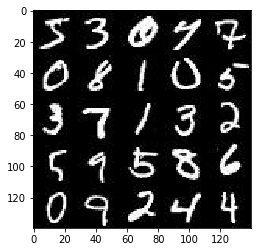

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

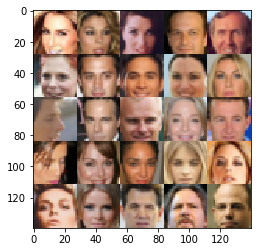

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

C:\Users\deepai\Anaconda3\envs\u2\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


TensorFlow Version: 1.8.0
Default GPU Device: /device:GPU:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_input_images = tf.placeholder(tf.float32, [None, image_width,image_height,image_channels])
    tensor_of_z_data = tf.placeholder(tf.float32,[None, z_dim])
    learning_rate = tf.placeholder(tf.float32)
    
    return real_input_images, tensor_of_z_data, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    #print("rimages", images.shape, "rreuse", reuse)
    with tf.variable_scope("discriminator", reuse=reuse):
        #     rconv1 (?, 14, 14, 64)
        #     rconv2 (?, 7, 7, 128)
        #     rconv3 (?, 4, 4, 256)  
        #     rlogits (?, 1)
        alpha = 0.1
        rconv1 = tf.layers.conv2d(images,64,3,strides=2,padding='same')
        rconv1 = tf.nn.leaky_relu(rconv1)
        #print("rconv1", rconv1.shape)
        
        rconv2 = tf.layers.conv2d(rconv1,128,3,strides=2,padding='same')
        rconv2 = tf.layers.batch_normalization(rconv2,training=True)
        rconv2 = tf.nn.leaky_relu(rconv2)
        #print("rconv2", rconv2.shape)

        rconv3 = tf.layers.conv2d(rconv2,256,2,strides=2,padding='same')
        rconv3 = tf.layers.batch_normalization(rconv3,training=True)
        rconv3 = tf.nn.leaky_relu(rconv3)
        #print("rconv3", rconv3.shape)

        
        rflattened = tf.reshape(rconv3,(-1,4*4*256))
        rlogits = tf.layers.dense(rflattened,1)
        rlogits = tf.layers.dropout(rlogits, rate=0.3)
        #print("rlogits", rlogits.shape)

        routput = tf.nn.sigmoid(rlogits)
        #print("output ", output.shape, "logits ",logits.shape)
    return routput, rlogits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function 
    #print("z", z.shape,"zout_channel_dim", out_channel_dim, "zis_train", is_train)
    with tf.variable_scope("generator", reuse=not is_train):
#         z (?, 100) out_channel_dim 5 is_train True
#         dense1 (?, 7, 7, 256)
#         zconv1 (?, 7, 7, 256)
#         zconv2 (?, 14, 14, 128)
#         zconv3 (?, 28, 28, 64)
#         logits (?, 28, 28, 5)
        alpha = 0.1
 
        zdense1 = tf.layers.dense(z,7*7*256)
        zdense1 = tf.reshape(zdense1,(-1,7,7,256))
        #print("zdense1", zdense1.shape)

        
        zconv1 = zdense1  
        zconv1 = tf.layers.batch_normalization(zconv1,training = is_train)
        zconv1 = tf.nn.leaky_relu(zconv1)
        #print("zconv1", zconv1.shape)

        
        zconv2 = tf.layers.conv2d_transpose(zconv1,128,3,strides=2,padding='same')
        zconv2 = tf.layers.batch_normalization(zconv2,training=is_train)
        zconv2 = tf.nn.leaky_relu(zconv2)
        #print("zconv2", zconv2.shape)

        zconv3 = tf.layers.conv2d_transpose(zconv2,64,3,strides=2,padding='same')
        zconv3 = tf.layers.batch_normalization(zconv3,training = is_train)
        zconv3 = tf.nn.leaky_relu(zconv3)
        #print("zconv3", zconv3.shape)

        zlogits = tf.layers.conv2d_transpose(zconv3,out_channel_dim,3,strides=1,padding='same')
        #print("zlogits", zlogits.shape)

        zout = tf.tanh(zlogits)
    return zout


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    smooth = 0.1
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real) * (1 - smooth)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    d_updates = [opt for opt in update_ops if opt.name.startswith('discriminator')]
    g_updates = [opt for opt in update_ops if opt.name.startswith('generator')]

    with tf.control_dependencies(d_updates):
        d_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)

    with tf.control_dependencies(g_updates):
        g_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
            
    return d_opt, g_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    


    print_every=10
    show_every=200
    losses = []
    n_images_to_show=20
    
    real_inputs, fake_inputs, lr_tensor  = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(real_inputs, fake_inputs, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        n_steps=sum(1 for x in get_batches(batch_size))
        for counter_epoch in range(epoch_count): 
            print("STARTING epoch:",counter_epoch,", steps:", n_steps, "........")
            for step, img_batch_real in enumerate(get_batches(batch_size)):
                img_batch_real = img_batch_real*2.0
                # G:random noise 
                img_batch_fake = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # Run optimizers
                sess.run(d_opt, feed_dict={real_inputs: img_batch_real, 
                                                 fake_inputs: img_batch_fake, 
                                                 lr_tensor: learning_rate})
                
                sess.run(g_opt, feed_dict={real_inputs: img_batch_real, 
                                                 fake_inputs: img_batch_fake, 
                                                 lr_tensor: learning_rate})
                
                if step % print_every == 0: 
                    percent_step = (step / n_steps)*100
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({real_inputs: img_batch_real, fake_inputs: img_batch_fake})
                    train_loss_g = g_loss.eval({fake_inputs: img_batch_fake})
                    #run it twice http://bamos.github.io/2016/08/09/deep-completion/
                    train_loss_g = g_loss.eval({fake_inputs: img_batch_fake})

                    print("Epoch {}/{}...progress:{:.2f}%....step:{}/{}...".format(counter_epoch+1, epochs, percent_step, step,n_steps),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))
                
                if step % show_every == 0:
                    show_generator_output(sess, n_images_to_show, fake_inputs, data_shape[3], data_image_mode)
        show_generator_output(sess, n_images_to_show, fake_inputs, data_shape[3], data_image_mode)
        print("Last train discriminator Loss: {:.4f}\nLast train generator Loss: {:.4f}".format(losses[-1][0], losses[-1][1]))

                
 

                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

STARTING epoch: 0 , steps: 937 ........
Epoch 1/25...progress:0.00%....step:0/937... Discriminator Loss: 5.6959... Generator Loss: 0.0080


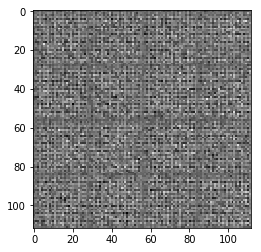

Epoch 1/25...progress:1.07%....step:10/937... Discriminator Loss: 3.3735... Generator Loss: 0.0676
Epoch 1/25...progress:2.13%....step:20/937... Discriminator Loss: 3.6612... Generator Loss: 0.0401
Epoch 1/25...progress:3.20%....step:30/937... Discriminator Loss: 2.5097... Generator Loss: 0.1376
Epoch 1/25...progress:4.27%....step:40/937... Discriminator Loss: 2.2156... Generator Loss: 0.1899
Epoch 1/25...progress:5.34%....step:50/937... Discriminator Loss: 2.0229... Generator Loss: 0.2477
Epoch 1/25...progress:6.40%....step:60/937... Discriminator Loss: 1.9186... Generator Loss: 0.2745
Epoch 1/25...progress:7.47%....step:70/937... Discriminator Loss: 2.0419... Generator Loss: 0.2259
Epoch 1/25...progress:8.54%....step:80/937... Discriminator Loss: 1.6845... Generator Loss: 0.3639
Epoch 1/25...progress:9.61%....step:90/937... Discriminator Loss: 1.9078... Generator Loss: 0.2769
Epoch 1/25...progress:10.67%....step:100/937... Discriminator Loss: 1.4096... Generator Loss: 0.6966
Epoch 1/

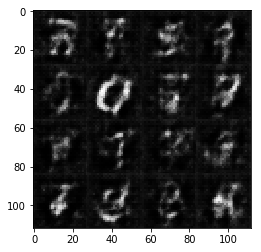

Epoch 1/25...progress:22.41%....step:210/937... Discriminator Loss: 1.1326... Generator Loss: 1.0597
Epoch 1/25...progress:23.48%....step:220/937... Discriminator Loss: 1.4462... Generator Loss: 1.2798
Epoch 1/25...progress:24.55%....step:230/937... Discriminator Loss: 1.2068... Generator Loss: 1.3516
Epoch 1/25...progress:25.61%....step:240/937... Discriminator Loss: 1.2249... Generator Loss: 1.2480
Epoch 1/25...progress:26.68%....step:250/937... Discriminator Loss: 1.2182... Generator Loss: 0.8471
Epoch 1/25...progress:27.75%....step:260/937... Discriminator Loss: 1.1555... Generator Loss: 1.3633
Epoch 1/25...progress:28.82%....step:270/937... Discriminator Loss: 1.2213... Generator Loss: 1.0607
Epoch 1/25...progress:29.88%....step:280/937... Discriminator Loss: 1.2657... Generator Loss: 1.5607
Epoch 1/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1959... Generator Loss: 1.4690
Epoch 1/25...progress:32.02%....step:300/937... Discriminator Loss: 1.1427... Generator Los

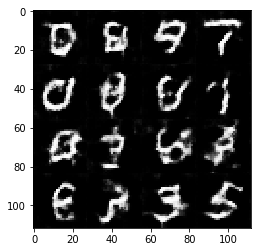

Epoch 1/25...progress:43.76%....step:410/937... Discriminator Loss: 1.1957... Generator Loss: 0.9969
Epoch 1/25...progress:44.82%....step:420/937... Discriminator Loss: 1.2030... Generator Loss: 0.9835
Epoch 1/25...progress:45.89%....step:430/937... Discriminator Loss: 1.3444... Generator Loss: 0.8093
Epoch 1/25...progress:46.96%....step:440/937... Discriminator Loss: 1.2898... Generator Loss: 1.4431
Epoch 1/25...progress:48.03%....step:450/937... Discriminator Loss: 1.5418... Generator Loss: 0.4208
Epoch 1/25...progress:49.09%....step:460/937... Discriminator Loss: 1.6447... Generator Loss: 0.3540
Epoch 1/25...progress:50.16%....step:470/937... Discriminator Loss: 1.8748... Generator Loss: 0.2920
Epoch 1/25...progress:51.23%....step:480/937... Discriminator Loss: 1.1960... Generator Loss: 0.8502
Epoch 1/25...progress:52.29%....step:490/937... Discriminator Loss: 1.2485... Generator Loss: 0.7397
Epoch 1/25...progress:53.36%....step:500/937... Discriminator Loss: 1.3224... Generator Los

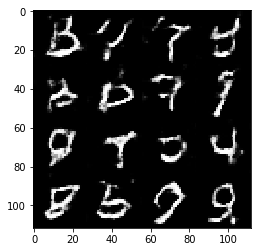

Epoch 1/25...progress:65.10%....step:610/937... Discriminator Loss: 1.1247... Generator Loss: 1.2818
Epoch 1/25...progress:66.17%....step:620/937... Discriminator Loss: 1.3354... Generator Loss: 0.5425
Epoch 1/25...progress:67.24%....step:630/937... Discriminator Loss: 1.1652... Generator Loss: 1.3732
Epoch 1/25...progress:68.30%....step:640/937... Discriminator Loss: 1.3576... Generator Loss: 1.4561
Epoch 1/25...progress:69.37%....step:650/937... Discriminator Loss: 1.1809... Generator Loss: 0.7860
Epoch 1/25...progress:70.44%....step:660/937... Discriminator Loss: 1.5806... Generator Loss: 0.3845
Epoch 1/25...progress:71.50%....step:670/937... Discriminator Loss: 1.4439... Generator Loss: 0.4601
Epoch 1/25...progress:72.57%....step:680/937... Discriminator Loss: 1.0374... Generator Loss: 1.0947
Epoch 1/25...progress:73.64%....step:690/937... Discriminator Loss: 0.9474... Generator Loss: 1.0454
Epoch 1/25...progress:74.71%....step:700/937... Discriminator Loss: 1.5626... Generator Los

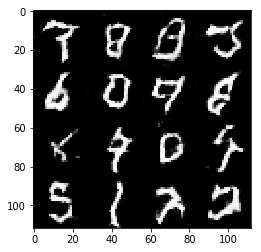

Epoch 1/25...progress:86.45%....step:810/937... Discriminator Loss: 1.2081... Generator Loss: 0.6357
Epoch 1/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9908... Generator Loss: 1.0606
Epoch 1/25...progress:88.58%....step:830/937... Discriminator Loss: 1.0706... Generator Loss: 1.7000
Epoch 1/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9505... Generator Loss: 1.8927
Epoch 1/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9565... Generator Loss: 1.0164
Epoch 1/25...progress:91.78%....step:860/937... Discriminator Loss: 1.1485... Generator Loss: 1.9571
Epoch 1/25...progress:92.85%....step:870/937... Discriminator Loss: 1.3340... Generator Loss: 0.5233
Epoch 1/25...progress:93.92%....step:880/937... Discriminator Loss: 1.0215... Generator Loss: 0.8186
Epoch 1/25...progress:94.98%....step:890/937... Discriminator Loss: 0.8656... Generator Loss: 1.0711
Epoch 1/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2737... Generator Los

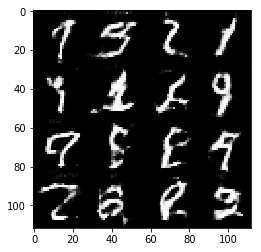

Epoch 2/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8142... Generator Loss: 1.1417
Epoch 2/25...progress:2.13%....step:20/937... Discriminator Loss: 0.8526... Generator Loss: 1.1372
Epoch 2/25...progress:3.20%....step:30/937... Discriminator Loss: 1.6947... Generator Loss: 0.3727
Epoch 2/25...progress:4.27%....step:40/937... Discriminator Loss: 1.7169... Generator Loss: 0.3478
Epoch 2/25...progress:5.34%....step:50/937... Discriminator Loss: 1.1435... Generator Loss: 0.7117
Epoch 2/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0801... Generator Loss: 1.4584
Epoch 2/25...progress:7.47%....step:70/937... Discriminator Loss: 1.2051... Generator Loss: 0.6827
Epoch 2/25...progress:8.54%....step:80/937... Discriminator Loss: 0.9125... Generator Loss: 1.2656
Epoch 2/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1060... Generator Loss: 0.7251
Epoch 2/25...progress:10.67%....step:100/937... Discriminator Loss: 1.2935... Generator Loss: 2.3245
Epoch 2/

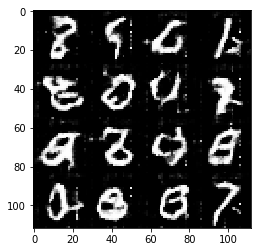

Epoch 2/25...progress:22.41%....step:210/937... Discriminator Loss: 1.7807... Generator Loss: 0.4325
Epoch 2/25...progress:23.48%....step:220/937... Discriminator Loss: 1.8329... Generator Loss: 0.2985
Epoch 2/25...progress:24.55%....step:230/937... Discriminator Loss: 0.9650... Generator Loss: 1.0532
Epoch 2/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8787... Generator Loss: 1.1139
Epoch 2/25...progress:26.68%....step:250/937... Discriminator Loss: 1.0581... Generator Loss: 0.9184
Epoch 2/25...progress:27.75%....step:260/937... Discriminator Loss: 1.6335... Generator Loss: 0.3888
Epoch 2/25...progress:28.82%....step:270/937... Discriminator Loss: 1.5138... Generator Loss: 0.4858
Epoch 2/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7792... Generator Loss: 1.4907
Epoch 2/25...progress:30.95%....step:290/937... Discriminator Loss: 0.8625... Generator Loss: 1.1765
Epoch 2/25...progress:32.02%....step:300/937... Discriminator Loss: 0.9514... Generator Los

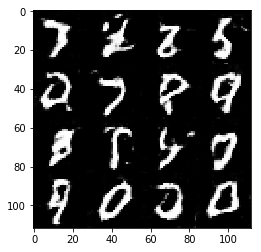

Epoch 2/25...progress:43.76%....step:410/937... Discriminator Loss: 0.7814... Generator Loss: 1.1891
Epoch 2/25...progress:44.82%....step:420/937... Discriminator Loss: 0.8847... Generator Loss: 1.0404
Epoch 2/25...progress:45.89%....step:430/937... Discriminator Loss: 2.1620... Generator Loss: 0.2456
Epoch 2/25...progress:46.96%....step:440/937... Discriminator Loss: 1.4828... Generator Loss: 0.4399
Epoch 2/25...progress:48.03%....step:450/937... Discriminator Loss: 1.5082... Generator Loss: 0.4734
Epoch 2/25...progress:49.09%....step:460/937... Discriminator Loss: 1.0412... Generator Loss: 1.2437
Epoch 2/25...progress:50.16%....step:470/937... Discriminator Loss: 1.3228... Generator Loss: 0.8736
Epoch 2/25...progress:51.23%....step:480/937... Discriminator Loss: 1.0464... Generator Loss: 0.8714
Epoch 2/25...progress:52.29%....step:490/937... Discriminator Loss: 1.0945... Generator Loss: 0.7886
Epoch 2/25...progress:53.36%....step:500/937... Discriminator Loss: 1.6366... Generator Los

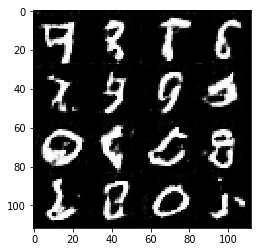

Epoch 2/25...progress:65.10%....step:610/937... Discriminator Loss: 1.2327... Generator Loss: 2.8328
Epoch 2/25...progress:66.17%....step:620/937... Discriminator Loss: 0.9134... Generator Loss: 1.0148
Epoch 2/25...progress:67.24%....step:630/937... Discriminator Loss: 1.0210... Generator Loss: 1.5658
Epoch 2/25...progress:68.30%....step:640/937... Discriminator Loss: 1.2377... Generator Loss: 1.8374
Epoch 2/25...progress:69.37%....step:650/937... Discriminator Loss: 1.1628... Generator Loss: 0.7841
Epoch 2/25...progress:70.44%....step:660/937... Discriminator Loss: 1.1072... Generator Loss: 1.2381
Epoch 2/25...progress:71.50%....step:670/937... Discriminator Loss: 1.1794... Generator Loss: 1.8041
Epoch 2/25...progress:72.57%....step:680/937... Discriminator Loss: 1.0088... Generator Loss: 1.4264
Epoch 2/25...progress:73.64%....step:690/937... Discriminator Loss: 0.8217... Generator Loss: 1.2710
Epoch 2/25...progress:74.71%....step:700/937... Discriminator Loss: 1.1296... Generator Los

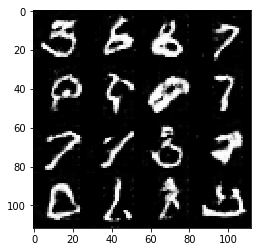

Epoch 2/25...progress:86.45%....step:810/937... Discriminator Loss: 1.1684... Generator Loss: 0.7431
Epoch 2/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8348... Generator Loss: 1.2361
Epoch 2/25...progress:88.58%....step:830/937... Discriminator Loss: 0.8755... Generator Loss: 1.0614
Epoch 2/25...progress:89.65%....step:840/937... Discriminator Loss: 1.7768... Generator Loss: 0.3297
Epoch 2/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9363... Generator Loss: 0.9616
Epoch 2/25...progress:91.78%....step:860/937... Discriminator Loss: 0.7874... Generator Loss: 1.6965
Epoch 2/25...progress:92.85%....step:870/937... Discriminator Loss: 1.0141... Generator Loss: 1.1135
Epoch 2/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8873... Generator Loss: 1.2617
Epoch 2/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9030... Generator Loss: 0.9686
Epoch 2/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0923... Generator Los

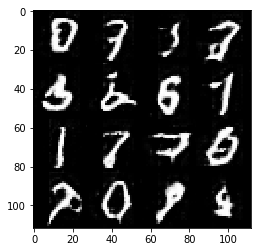

Epoch 3/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9612... Generator Loss: 0.9401
Epoch 3/25...progress:2.13%....step:20/937... Discriminator Loss: 1.2134... Generator Loss: 0.6678
Epoch 3/25...progress:3.20%....step:30/937... Discriminator Loss: 0.8353... Generator Loss: 1.3199
Epoch 3/25...progress:4.27%....step:40/937... Discriminator Loss: 1.5577... Generator Loss: 2.6999
Epoch 3/25...progress:5.34%....step:50/937... Discriminator Loss: 1.1478... Generator Loss: 1.0152
Epoch 3/25...progress:6.40%....step:60/937... Discriminator Loss: 0.8678... Generator Loss: 1.4340
Epoch 3/25...progress:7.47%....step:70/937... Discriminator Loss: 1.0424... Generator Loss: 0.9314
Epoch 3/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8306... Generator Loss: 1.2403
Epoch 3/25...progress:9.61%....step:90/937... Discriminator Loss: 0.6883... Generator Loss: 1.4797
Epoch 3/25...progress:10.67%....step:100/937... Discriminator Loss: 2.4079... Generator Loss: 0.1793
Epoch 3/

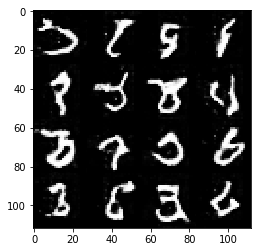

Epoch 3/25...progress:22.41%....step:210/937... Discriminator Loss: 1.1791... Generator Loss: 0.6891
Epoch 3/25...progress:23.48%....step:220/937... Discriminator Loss: 1.7845... Generator Loss: 0.3442
Epoch 3/25...progress:24.55%....step:230/937... Discriminator Loss: 1.1133... Generator Loss: 0.8069
Epoch 3/25...progress:25.61%....step:240/937... Discriminator Loss: 1.5789... Generator Loss: 0.4170
Epoch 3/25...progress:26.68%....step:250/937... Discriminator Loss: 1.7306... Generator Loss: 0.3721
Epoch 3/25...progress:27.75%....step:260/937... Discriminator Loss: 1.7051... Generator Loss: 0.3468
Epoch 3/25...progress:28.82%....step:270/937... Discriminator Loss: 0.8515... Generator Loss: 2.0555
Epoch 3/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7940... Generator Loss: 1.6105
Epoch 3/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0441... Generator Loss: 1.6777
Epoch 3/25...progress:32.02%....step:300/937... Discriminator Loss: 1.2301... Generator Los

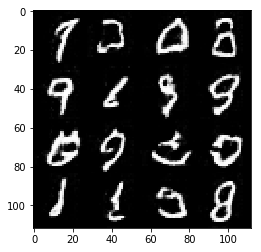

Epoch 3/25...progress:43.76%....step:410/937... Discriminator Loss: 1.1708... Generator Loss: 0.7553
Epoch 3/25...progress:44.82%....step:420/937... Discriminator Loss: 1.2668... Generator Loss: 0.6205
Epoch 3/25...progress:45.89%....step:430/937... Discriminator Loss: 0.9972... Generator Loss: 1.3136
Epoch 3/25...progress:46.96%....step:440/937... Discriminator Loss: 0.7685... Generator Loss: 1.6160
Epoch 3/25...progress:48.03%....step:450/937... Discriminator Loss: 1.0663... Generator Loss: 0.7624
Epoch 3/25...progress:49.09%....step:460/937... Discriminator Loss: 1.4535... Generator Loss: 2.0487
Epoch 3/25...progress:50.16%....step:470/937... Discriminator Loss: 1.2440... Generator Loss: 1.9108
Epoch 3/25...progress:51.23%....step:480/937... Discriminator Loss: 1.0829... Generator Loss: 0.8212
Epoch 3/25...progress:52.29%....step:490/937... Discriminator Loss: 1.0544... Generator Loss: 0.8095
Epoch 3/25...progress:53.36%....step:500/937... Discriminator Loss: 1.2954... Generator Los

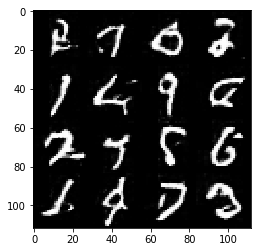

Epoch 3/25...progress:65.10%....step:610/937... Discriminator Loss: 1.4117... Generator Loss: 2.5155
Epoch 3/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0533... Generator Loss: 0.8301
Epoch 3/25...progress:67.24%....step:630/937... Discriminator Loss: 0.9912... Generator Loss: 1.0585
Epoch 3/25...progress:68.30%....step:640/937... Discriminator Loss: 1.1018... Generator Loss: 0.8031
Epoch 3/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8395... Generator Loss: 1.5326
Epoch 3/25...progress:70.44%....step:660/937... Discriminator Loss: 1.2020... Generator Loss: 2.3280
Epoch 3/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0206... Generator Loss: 1.2012
Epoch 3/25...progress:72.57%....step:680/937... Discriminator Loss: 0.9863... Generator Loss: 1.8673
Epoch 3/25...progress:73.64%....step:690/937... Discriminator Loss: 1.0218... Generator Loss: 0.8524
Epoch 3/25...progress:74.71%....step:700/937... Discriminator Loss: 1.4550... Generator Los

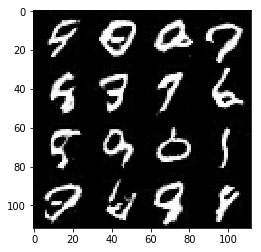

Epoch 3/25...progress:86.45%....step:810/937... Discriminator Loss: 0.8266... Generator Loss: 1.1618
Epoch 3/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8887... Generator Loss: 1.0444
Epoch 3/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6831... Generator Loss: 1.4575
Epoch 3/25...progress:89.65%....step:840/937... Discriminator Loss: 1.6439... Generator Loss: 0.5086
Epoch 3/25...progress:90.72%....step:850/937... Discriminator Loss: 1.6541... Generator Loss: 0.4195
Epoch 3/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6858... Generator Loss: 1.9406
Epoch 3/25...progress:92.85%....step:870/937... Discriminator Loss: 1.0843... Generator Loss: 0.8366
Epoch 3/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8684... Generator Loss: 1.1107
Epoch 3/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9567... Generator Loss: 0.9378
Epoch 3/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0421... Generator Los

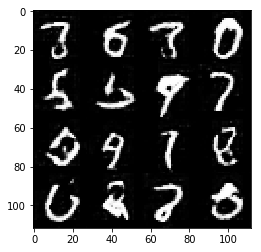

Epoch 4/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8448... Generator Loss: 1.1328
Epoch 4/25...progress:2.13%....step:20/937... Discriminator Loss: 0.7879... Generator Loss: 1.2512
Epoch 4/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9050... Generator Loss: 1.3735
Epoch 4/25...progress:4.27%....step:40/937... Discriminator Loss: 1.2452... Generator Loss: 1.9892
Epoch 4/25...progress:5.34%....step:50/937... Discriminator Loss: 1.1989... Generator Loss: 0.6554
Epoch 4/25...progress:6.40%....step:60/937... Discriminator Loss: 0.8310... Generator Loss: 1.4616
Epoch 4/25...progress:7.47%....step:70/937... Discriminator Loss: 1.1040... Generator Loss: 0.8415
Epoch 4/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7955... Generator Loss: 1.3266
Epoch 4/25...progress:9.61%....step:90/937... Discriminator Loss: 1.3952... Generator Loss: 0.5323
Epoch 4/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8298... Generator Loss: 1.2230
Epoch 4/

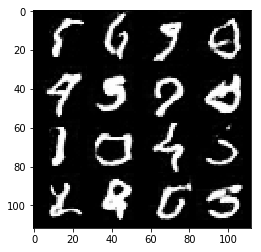

Epoch 4/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7335... Generator Loss: 1.3162
Epoch 4/25...progress:23.48%....step:220/937... Discriminator Loss: 1.3239... Generator Loss: 0.7252
Epoch 4/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8404... Generator Loss: 1.6324
Epoch 4/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8637... Generator Loss: 2.0979
Epoch 4/25...progress:26.68%....step:250/937... Discriminator Loss: 1.6398... Generator Loss: 2.6354
Epoch 4/25...progress:27.75%....step:260/937... Discriminator Loss: 0.8387... Generator Loss: 1.1963
Epoch 4/25...progress:28.82%....step:270/937... Discriminator Loss: 1.7991... Generator Loss: 2.8775
Epoch 4/25...progress:29.88%....step:280/937... Discriminator Loss: 0.9056... Generator Loss: 1.7873
Epoch 4/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0130... Generator Loss: 1.0177
Epoch 4/25...progress:32.02%....step:300/937... Discriminator Loss: 1.2120... Generator Los

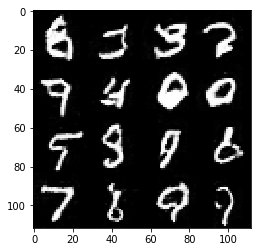

Epoch 4/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8513... Generator Loss: 2.1702
Epoch 4/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7214... Generator Loss: 1.4472
Epoch 4/25...progress:45.89%....step:430/937... Discriminator Loss: 1.1747... Generator Loss: 2.1699
Epoch 4/25...progress:46.96%....step:440/937... Discriminator Loss: 1.0684... Generator Loss: 0.8965
Epoch 4/25...progress:48.03%....step:450/937... Discriminator Loss: 1.0863... Generator Loss: 0.8365
Epoch 4/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8544... Generator Loss: 1.0835
Epoch 4/25...progress:50.16%....step:470/937... Discriminator Loss: 1.9457... Generator Loss: 0.3184
Epoch 4/25...progress:51.23%....step:480/937... Discriminator Loss: 1.0814... Generator Loss: 0.8321
Epoch 4/25...progress:52.29%....step:490/937... Discriminator Loss: 0.8255... Generator Loss: 1.3307
Epoch 4/25...progress:53.36%....step:500/937... Discriminator Loss: 1.0449... Generator Los

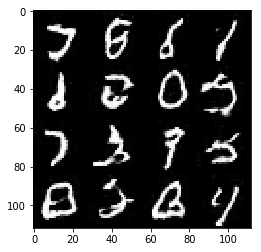

Epoch 4/25...progress:65.10%....step:610/937... Discriminator Loss: 1.5363... Generator Loss: 0.5138
Epoch 4/25...progress:66.17%....step:620/937... Discriminator Loss: 1.4405... Generator Loss: 0.5018
Epoch 4/25...progress:67.24%....step:630/937... Discriminator Loss: 0.9248... Generator Loss: 1.0701
Epoch 4/25...progress:68.30%....step:640/937... Discriminator Loss: 1.2201... Generator Loss: 0.7068
Epoch 4/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8749... Generator Loss: 1.0736
Epoch 4/25...progress:70.44%....step:660/937... Discriminator Loss: 0.8984... Generator Loss: 1.0785
Epoch 4/25...progress:71.50%....step:670/937... Discriminator Loss: 1.2555... Generator Loss: 2.6326
Epoch 4/25...progress:72.57%....step:680/937... Discriminator Loss: 1.2462... Generator Loss: 2.6842
Epoch 4/25...progress:73.64%....step:690/937... Discriminator Loss: 1.2664... Generator Loss: 0.6295
Epoch 4/25...progress:74.71%....step:700/937... Discriminator Loss: 0.9401... Generator Los

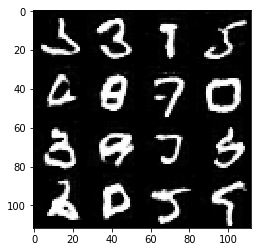

Epoch 4/25...progress:86.45%....step:810/937... Discriminator Loss: 0.8000... Generator Loss: 1.3036
Epoch 4/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8685... Generator Loss: 1.0696
Epoch 4/25...progress:88.58%....step:830/937... Discriminator Loss: 1.0863... Generator Loss: 2.7623
Epoch 4/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9218... Generator Loss: 0.3029
Epoch 4/25...progress:90.72%....step:850/937... Discriminator Loss: 1.1224... Generator Loss: 0.8330
Epoch 4/25...progress:91.78%....step:860/937... Discriminator Loss: 1.1347... Generator Loss: 3.3030
Epoch 4/25...progress:92.85%....step:870/937... Discriminator Loss: 1.2571... Generator Loss: 0.6259
Epoch 4/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8534... Generator Loss: 1.3820
Epoch 4/25...progress:94.98%....step:890/937... Discriminator Loss: 1.0275... Generator Loss: 0.8938
Epoch 4/25...progress:96.05%....step:900/937... Discriminator Loss: 1.1418... Generator Los

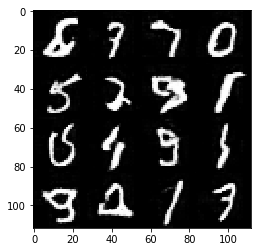

Epoch 5/25...progress:1.07%....step:10/937... Discriminator Loss: 0.7158... Generator Loss: 1.6858
Epoch 5/25...progress:2.13%....step:20/937... Discriminator Loss: 1.1940... Generator Loss: 0.7015
Epoch 5/25...progress:3.20%....step:30/937... Discriminator Loss: 0.8865... Generator Loss: 1.1103
Epoch 5/25...progress:4.27%....step:40/937... Discriminator Loss: 1.2696... Generator Loss: 0.6292
Epoch 5/25...progress:5.34%....step:50/937... Discriminator Loss: 1.4914... Generator Loss: 0.4756
Epoch 5/25...progress:6.40%....step:60/937... Discriminator Loss: 0.9652... Generator Loss: 0.9123
Epoch 5/25...progress:7.47%....step:70/937... Discriminator Loss: 1.9391... Generator Loss: 0.3475
Epoch 5/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8324... Generator Loss: 1.2086
Epoch 5/25...progress:9.61%....step:90/937... Discriminator Loss: 0.9324... Generator Loss: 0.9943
Epoch 5/25...progress:10.67%....step:100/937... Discriminator Loss: 0.7604... Generator Loss: 1.3903
Epoch 5/

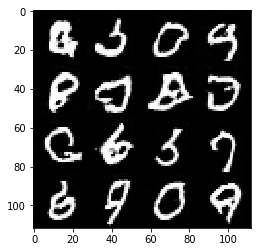

Epoch 5/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7871... Generator Loss: 1.3063
Epoch 5/25...progress:23.48%....step:220/937... Discriminator Loss: 0.9147... Generator Loss: 0.9931
Epoch 5/25...progress:24.55%....step:230/937... Discriminator Loss: 2.5011... Generator Loss: 3.2009
Epoch 5/25...progress:25.61%....step:240/937... Discriminator Loss: 0.9689... Generator Loss: 1.7189
Epoch 5/25...progress:26.68%....step:250/937... Discriminator Loss: 1.5054... Generator Loss: 0.4694
Epoch 5/25...progress:27.75%....step:260/937... Discriminator Loss: 1.1615... Generator Loss: 0.8048
Epoch 5/25...progress:28.82%....step:270/937... Discriminator Loss: 0.8207... Generator Loss: 1.4922
Epoch 5/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7468... Generator Loss: 2.0943
Epoch 5/25...progress:30.95%....step:290/937... Discriminator Loss: 0.9112... Generator Loss: 1.3580
Epoch 5/25...progress:32.02%....step:300/937... Discriminator Loss: 0.9027... Generator Los

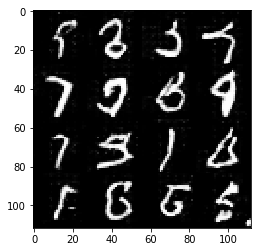

Epoch 5/25...progress:43.76%....step:410/937... Discriminator Loss: 1.6723... Generator Loss: 0.5490
Epoch 5/25...progress:44.82%....step:420/937... Discriminator Loss: 1.3528... Generator Loss: 0.5736
Epoch 5/25...progress:45.89%....step:430/937... Discriminator Loss: 1.0600... Generator Loss: 1.8655
Epoch 5/25...progress:46.96%....step:440/937... Discriminator Loss: 0.9845... Generator Loss: 0.9169
Epoch 5/25...progress:48.03%....step:450/937... Discriminator Loss: 0.7898... Generator Loss: 1.1800
Epoch 5/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8629... Generator Loss: 1.2646
Epoch 5/25...progress:50.16%....step:470/937... Discriminator Loss: 2.1564... Generator Loss: 0.3413
Epoch 5/25...progress:51.23%....step:480/937... Discriminator Loss: 0.9133... Generator Loss: 1.0336
Epoch 5/25...progress:52.29%....step:490/937... Discriminator Loss: 0.8000... Generator Loss: 1.4049
Epoch 5/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8638... Generator Los

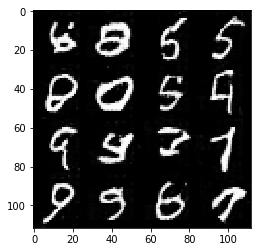

Epoch 5/25...progress:65.10%....step:610/937... Discriminator Loss: 1.0720... Generator Loss: 0.8256
Epoch 5/25...progress:66.17%....step:620/937... Discriminator Loss: 1.8865... Generator Loss: 0.3248
Epoch 5/25...progress:67.24%....step:630/937... Discriminator Loss: 0.6707... Generator Loss: 1.5896
Epoch 5/25...progress:68.30%....step:640/937... Discriminator Loss: 1.4700... Generator Loss: 0.5441
Epoch 5/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8645... Generator Loss: 1.5013
Epoch 5/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9987... Generator Loss: 0.8967
Epoch 5/25...progress:71.50%....step:670/937... Discriminator Loss: 0.9264... Generator Loss: 1.1979
Epoch 5/25...progress:72.57%....step:680/937... Discriminator Loss: 0.8813... Generator Loss: 2.0972
Epoch 5/25...progress:73.64%....step:690/937... Discriminator Loss: 1.0121... Generator Loss: 0.9129
Epoch 5/25...progress:74.71%....step:700/937... Discriminator Loss: 1.2871... Generator Los

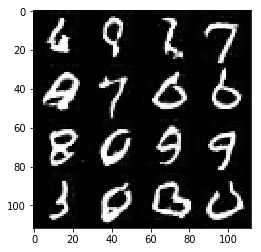

Epoch 5/25...progress:86.45%....step:810/937... Discriminator Loss: 0.6813... Generator Loss: 1.4170
Epoch 5/25...progress:87.51%....step:820/937... Discriminator Loss: 0.7376... Generator Loss: 1.3965
Epoch 5/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6310... Generator Loss: 1.6906
Epoch 5/25...progress:89.65%....step:840/937... Discriminator Loss: 1.7684... Generator Loss: 0.4673
Epoch 5/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7746... Generator Loss: 1.2820
Epoch 5/25...progress:91.78%....step:860/937... Discriminator Loss: 2.2569... Generator Loss: 5.2668
Epoch 5/25...progress:92.85%....step:870/937... Discriminator Loss: 1.2069... Generator Loss: 0.6838
Epoch 5/25...progress:93.92%....step:880/937... Discriminator Loss: 1.3877... Generator Loss: 0.5593
Epoch 5/25...progress:94.98%....step:890/937... Discriminator Loss: 1.0981... Generator Loss: 0.8417
Epoch 5/25...progress:96.05%....step:900/937... Discriminator Loss: 1.7289... Generator Los

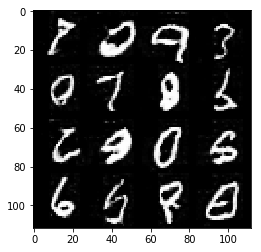

Epoch 6/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9127... Generator Loss: 0.9669
Epoch 6/25...progress:2.13%....step:20/937... Discriminator Loss: 1.4800... Generator Loss: 0.4765
Epoch 6/25...progress:3.20%....step:30/937... Discriminator Loss: 1.7149... Generator Loss: 0.3730
Epoch 6/25...progress:4.27%....step:40/937... Discriminator Loss: 1.2998... Generator Loss: 3.0000
Epoch 6/25...progress:5.34%....step:50/937... Discriminator Loss: 1.8044... Generator Loss: 0.3236
Epoch 6/25...progress:6.40%....step:60/937... Discriminator Loss: 1.4189... Generator Loss: 0.5406
Epoch 6/25...progress:7.47%....step:70/937... Discriminator Loss: 1.4110... Generator Loss: 0.6448
Epoch 6/25...progress:8.54%....step:80/937... Discriminator Loss: 0.9091... Generator Loss: 1.1082
Epoch 6/25...progress:9.61%....step:90/937... Discriminator Loss: 1.0467... Generator Loss: 0.8961
Epoch 6/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6873... Generator Loss: 2.3376
Epoch 6/

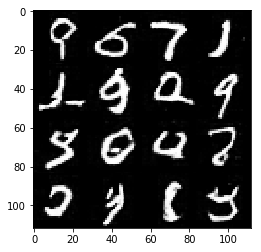

Epoch 6/25...progress:22.41%....step:210/937... Discriminator Loss: 1.2545... Generator Loss: 0.7287
Epoch 6/25...progress:23.48%....step:220/937... Discriminator Loss: 1.8235... Generator Loss: 3.0732
Epoch 6/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8600... Generator Loss: 1.6320
Epoch 6/25...progress:25.61%....step:240/937... Discriminator Loss: 0.9741... Generator Loss: 1.0746
Epoch 6/25...progress:26.68%....step:250/937... Discriminator Loss: 2.0089... Generator Loss: 0.2642
Epoch 6/25...progress:27.75%....step:260/937... Discriminator Loss: 0.9466... Generator Loss: 1.0580
Epoch 6/25...progress:28.82%....step:270/937... Discriminator Loss: 0.7999... Generator Loss: 2.1615
Epoch 6/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7491... Generator Loss: 1.3985
Epoch 6/25...progress:30.95%....step:290/937... Discriminator Loss: 1.4677... Generator Loss: 0.5227
Epoch 6/25...progress:32.02%....step:300/937... Discriminator Loss: 1.1345... Generator Los

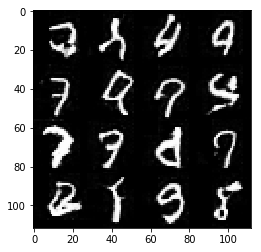

Epoch 6/25...progress:43.76%....step:410/937... Discriminator Loss: 0.9455... Generator Loss: 0.9907
Epoch 6/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7210... Generator Loss: 1.4172
Epoch 6/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8314... Generator Loss: 1.5592
Epoch 6/25...progress:46.96%....step:440/937... Discriminator Loss: 0.7224... Generator Loss: 1.4768
Epoch 6/25...progress:48.03%....step:450/937... Discriminator Loss: 1.4248... Generator Loss: 0.5525
Epoch 6/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8709... Generator Loss: 2.1602
Epoch 6/25...progress:50.16%....step:470/937... Discriminator Loss: 0.8220... Generator Loss: 1.8807
Epoch 6/25...progress:51.23%....step:480/937... Discriminator Loss: 0.9594... Generator Loss: 0.9995
Epoch 6/25...progress:52.29%....step:490/937... Discriminator Loss: 1.0873... Generator Loss: 0.8131
Epoch 6/25...progress:53.36%....step:500/937... Discriminator Loss: 0.6989... Generator Los

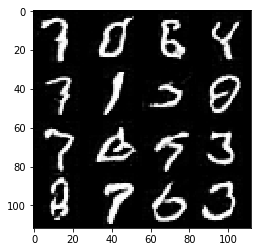

Epoch 6/25...progress:65.10%....step:610/937... Discriminator Loss: 0.9998... Generator Loss: 0.8949
Epoch 6/25...progress:66.17%....step:620/937... Discriminator Loss: 1.2410... Generator Loss: 0.6305
Epoch 6/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8579... Generator Loss: 1.1010
Epoch 6/25...progress:68.30%....step:640/937... Discriminator Loss: 1.2545... Generator Loss: 0.6871
Epoch 6/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8093... Generator Loss: 1.6476
Epoch 6/25...progress:70.44%....step:660/937... Discriminator Loss: 0.7413... Generator Loss: 1.3160
Epoch 6/25...progress:71.50%....step:670/937... Discriminator Loss: 0.9206... Generator Loss: 1.1187
Epoch 6/25...progress:72.57%....step:680/937... Discriminator Loss: 1.3003... Generator Loss: 0.6925
Epoch 6/25...progress:73.64%....step:690/937... Discriminator Loss: 0.8964... Generator Loss: 1.0103
Epoch 6/25...progress:74.71%....step:700/937... Discriminator Loss: 1.2994... Generator Los

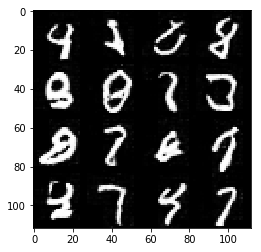

Epoch 6/25...progress:86.45%....step:810/937... Discriminator Loss: 0.7941... Generator Loss: 1.1948
Epoch 6/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9960... Generator Loss: 0.9370
Epoch 6/25...progress:88.58%....step:830/937... Discriminator Loss: 0.9479... Generator Loss: 1.0188
Epoch 6/25...progress:89.65%....step:840/937... Discriminator Loss: 2.4710... Generator Loss: 0.1977
Epoch 6/25...progress:90.72%....step:850/937... Discriminator Loss: 1.6461... Generator Loss: 0.5287
Epoch 6/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6056... Generator Loss: 1.9924
Epoch 6/25...progress:92.85%....step:870/937... Discriminator Loss: 1.0557... Generator Loss: 0.8596
Epoch 6/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8035... Generator Loss: 1.6081
Epoch 6/25...progress:94.98%....step:890/937... Discriminator Loss: 0.8918... Generator Loss: 1.2251
Epoch 6/25...progress:96.05%....step:900/937... Discriminator Loss: 0.9542... Generator Los

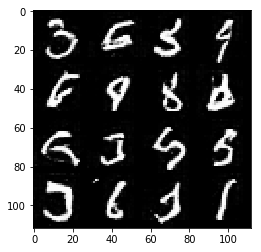

Epoch 7/25...progress:1.07%....step:10/937... Discriminator Loss: 1.2629... Generator Loss: 2.9900
Epoch 7/25...progress:2.13%....step:20/937... Discriminator Loss: 0.8826... Generator Loss: 1.2455
Epoch 7/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9349... Generator Loss: 1.6568
Epoch 7/25...progress:4.27%....step:40/937... Discriminator Loss: 0.8365... Generator Loss: 1.6110
Epoch 7/25...progress:5.34%....step:50/937... Discriminator Loss: 1.3107... Generator Loss: 0.5782
Epoch 7/25...progress:6.40%....step:60/937... Discriminator Loss: 0.9708... Generator Loss: 1.4520
Epoch 7/25...progress:7.47%....step:70/937... Discriminator Loss: 0.9356... Generator Loss: 1.0262
Epoch 7/25...progress:8.54%....step:80/937... Discriminator Loss: 0.9865... Generator Loss: 0.9817
Epoch 7/25...progress:9.61%....step:90/937... Discriminator Loss: 1.0227... Generator Loss: 0.8842
Epoch 7/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6711... Generator Loss: 1.9938
Epoch 7/

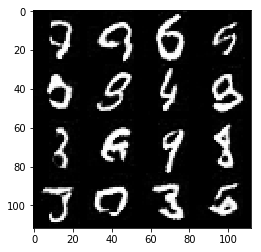

Epoch 7/25...progress:22.41%....step:210/937... Discriminator Loss: 0.8302... Generator Loss: 1.2663
Epoch 7/25...progress:23.48%....step:220/937... Discriminator Loss: 1.0707... Generator Loss: 0.8444
Epoch 7/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6709... Generator Loss: 2.0318
Epoch 7/25...progress:25.61%....step:240/937... Discriminator Loss: 0.6494... Generator Loss: 2.1937
Epoch 7/25...progress:26.68%....step:250/937... Discriminator Loss: 2.2349... Generator Loss: 0.2494
Epoch 7/25...progress:27.75%....step:260/937... Discriminator Loss: 1.2648... Generator Loss: 0.6928
Epoch 7/25...progress:28.82%....step:270/937... Discriminator Loss: 0.7995... Generator Loss: 1.8831
Epoch 7/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7379... Generator Loss: 1.8796
Epoch 7/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1388... Generator Loss: 0.8162
Epoch 7/25...progress:32.02%....step:300/937... Discriminator Loss: 1.1857... Generator Los

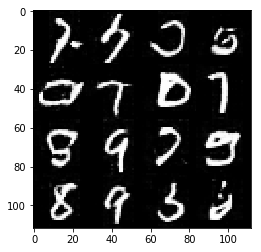

Epoch 7/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8529... Generator Loss: 1.3114
Epoch 7/25...progress:44.82%....step:420/937... Discriminator Loss: 0.8299... Generator Loss: 1.2303
Epoch 7/25...progress:45.89%....step:430/937... Discriminator Loss: 1.0336... Generator Loss: 0.8681
Epoch 7/25...progress:46.96%....step:440/937... Discriminator Loss: 0.8555... Generator Loss: 1.1573
Epoch 7/25...progress:48.03%....step:450/937... Discriminator Loss: 1.5071... Generator Loss: 0.5289
Epoch 7/25...progress:49.09%....step:460/937... Discriminator Loss: 0.5657... Generator Loss: 2.4751
Epoch 7/25...progress:50.16%....step:470/937... Discriminator Loss: 2.2846... Generator Loss: 0.2975
Epoch 7/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8463... Generator Loss: 1.1488
Epoch 7/25...progress:52.29%....step:490/937... Discriminator Loss: 0.8581... Generator Loss: 1.1660
Epoch 7/25...progress:53.36%....step:500/937... Discriminator Loss: 0.9065... Generator Los

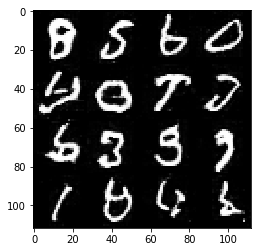

Epoch 7/25...progress:65.10%....step:610/937... Discriminator Loss: 0.9026... Generator Loss: 1.2427
Epoch 7/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0804... Generator Loss: 0.9366
Epoch 7/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8099... Generator Loss: 1.4666
Epoch 7/25...progress:68.30%....step:640/937... Discriminator Loss: 1.4052... Generator Loss: 0.5928
Epoch 7/25...progress:69.37%....step:650/937... Discriminator Loss: 2.4842... Generator Loss: 3.7644
Epoch 7/25...progress:70.44%....step:660/937... Discriminator Loss: 0.7843... Generator Loss: 1.9297
Epoch 7/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0440... Generator Loss: 0.9241
Epoch 7/25...progress:72.57%....step:680/937... Discriminator Loss: 1.4488... Generator Loss: 3.0318
Epoch 7/25...progress:73.64%....step:690/937... Discriminator Loss: 1.3710... Generator Loss: 0.5728
Epoch 7/25...progress:74.71%....step:700/937... Discriminator Loss: 1.2707... Generator Los

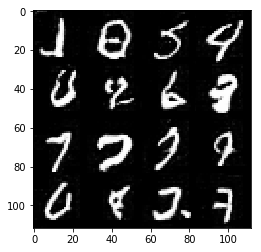

Epoch 7/25...progress:86.45%....step:810/937... Discriminator Loss: 1.2159... Generator Loss: 0.6891
Epoch 7/25...progress:87.51%....step:820/937... Discriminator Loss: 0.6637... Generator Loss: 1.5422
Epoch 7/25...progress:88.58%....step:830/937... Discriminator Loss: 0.8990... Generator Loss: 1.1482
Epoch 7/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9752... Generator Loss: 0.3707
Epoch 7/25...progress:90.72%....step:850/937... Discriminator Loss: 0.8381... Generator Loss: 1.2500
Epoch 7/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6250... Generator Loss: 2.8564
Epoch 7/25...progress:92.85%....step:870/937... Discriminator Loss: 0.8684... Generator Loss: 1.6319
Epoch 7/25...progress:93.92%....step:880/937... Discriminator Loss: 0.9360... Generator Loss: 1.0372
Epoch 7/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9451... Generator Loss: 1.1420
Epoch 7/25...progress:96.05%....step:900/937... Discriminator Loss: 0.8338... Generator Los

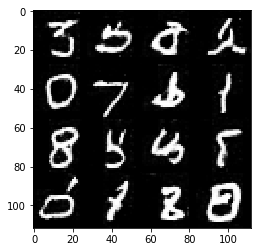

Epoch 8/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8039... Generator Loss: 1.1864
Epoch 8/25...progress:2.13%....step:20/937... Discriminator Loss: 1.0363... Generator Loss: 0.8516
Epoch 8/25...progress:3.20%....step:30/937... Discriminator Loss: 1.4670... Generator Loss: 0.5759
Epoch 8/25...progress:4.27%....step:40/937... Discriminator Loss: 0.8470... Generator Loss: 1.1986
Epoch 8/25...progress:5.34%....step:50/937... Discriminator Loss: 0.8626... Generator Loss: 1.1764
Epoch 8/25...progress:6.40%....step:60/937... Discriminator Loss: 1.1842... Generator Loss: 2.3538
Epoch 8/25...progress:7.47%....step:70/937... Discriminator Loss: 1.3638... Generator Loss: 0.6744
Epoch 8/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7190... Generator Loss: 1.4273
Epoch 8/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1527... Generator Loss: 0.7431
Epoch 8/25...progress:10.67%....step:100/937... Discriminator Loss: 0.9320... Generator Loss: 2.1284
Epoch 8/

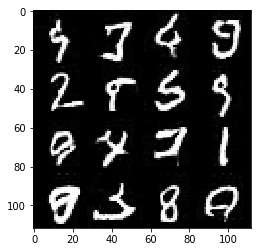

Epoch 8/25...progress:22.41%....step:210/937... Discriminator Loss: 1.0362... Generator Loss: 0.9727
Epoch 8/25...progress:23.48%....step:220/937... Discriminator Loss: 1.6337... Generator Loss: 0.4959
Epoch 8/25...progress:24.55%....step:230/937... Discriminator Loss: 0.7129... Generator Loss: 2.0112
Epoch 8/25...progress:25.61%....step:240/937... Discriminator Loss: 1.1063... Generator Loss: 0.8372
Epoch 8/25...progress:26.68%....step:250/937... Discriminator Loss: 1.6112... Generator Loss: 0.4400
Epoch 8/25...progress:27.75%....step:260/937... Discriminator Loss: 0.8565... Generator Loss: 1.1260
Epoch 8/25...progress:28.82%....step:270/937... Discriminator Loss: 0.9442... Generator Loss: 1.0950
Epoch 8/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7650... Generator Loss: 2.3908
Epoch 8/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1749... Generator Loss: 0.8099
Epoch 8/25...progress:32.02%....step:300/937... Discriminator Loss: 1.0178... Generator Los

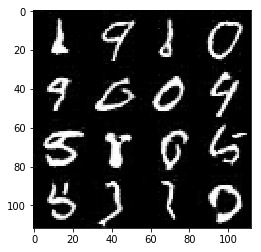

Epoch 8/25...progress:43.76%....step:410/937... Discriminator Loss: 1.1575... Generator Loss: 0.7496
Epoch 8/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6393... Generator Loss: 1.6657
Epoch 8/25...progress:45.89%....step:430/937... Discriminator Loss: 1.1796... Generator Loss: 2.1623
Epoch 8/25...progress:46.96%....step:440/937... Discriminator Loss: 0.8612... Generator Loss: 1.1834
Epoch 8/25...progress:48.03%....step:450/937... Discriminator Loss: 0.8186... Generator Loss: 1.2419
Epoch 8/25...progress:49.09%....step:460/937... Discriminator Loss: 0.6667... Generator Loss: 1.8880
Epoch 8/25...progress:50.16%....step:470/937... Discriminator Loss: 1.5521... Generator Loss: 0.5045
Epoch 8/25...progress:51.23%....step:480/937... Discriminator Loss: 0.7381... Generator Loss: 1.4507
Epoch 8/25...progress:52.29%....step:490/937... Discriminator Loss: 1.1297... Generator Loss: 0.8275
Epoch 8/25...progress:53.36%....step:500/937... Discriminator Loss: 0.5497... Generator Los

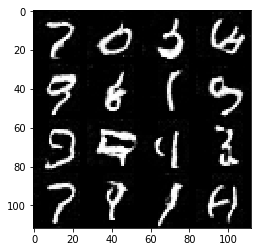

Epoch 8/25...progress:65.10%....step:610/937... Discriminator Loss: 1.2401... Generator Loss: 0.7030
Epoch 8/25...progress:66.17%....step:620/937... Discriminator Loss: 0.9198... Generator Loss: 1.0193
Epoch 8/25...progress:67.24%....step:630/937... Discriminator Loss: 1.0527... Generator Loss: 2.7023
Epoch 8/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8696... Generator Loss: 1.1261
Epoch 8/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8132... Generator Loss: 1.5589
Epoch 8/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9791... Generator Loss: 0.9362
Epoch 8/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0770... Generator Loss: 0.8747
Epoch 8/25...progress:72.57%....step:680/937... Discriminator Loss: 1.8276... Generator Loss: 3.6074
Epoch 8/25...progress:73.64%....step:690/937... Discriminator Loss: 0.9974... Generator Loss: 0.9802
Epoch 8/25...progress:74.71%....step:700/937... Discriminator Loss: 1.1151... Generator Los

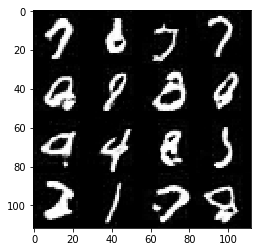

Epoch 8/25...progress:86.45%....step:810/937... Discriminator Loss: 1.0462... Generator Loss: 0.8334
Epoch 8/25...progress:87.51%....step:820/937... Discriminator Loss: 0.5876... Generator Loss: 2.0110
Epoch 8/25...progress:88.58%....step:830/937... Discriminator Loss: 0.9104... Generator Loss: 1.1790
Epoch 8/25...progress:89.65%....step:840/937... Discriminator Loss: 2.3657... Generator Loss: 0.2831
Epoch 8/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9600... Generator Loss: 2.6650
Epoch 8/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6261... Generator Loss: 3.2579
Epoch 8/25...progress:92.85%....step:870/937... Discriminator Loss: 0.8772... Generator Loss: 1.1510
Epoch 8/25...progress:93.92%....step:880/937... Discriminator Loss: 0.6504... Generator Loss: 1.8403
Epoch 8/25...progress:94.98%....step:890/937... Discriminator Loss: 1.4878... Generator Loss: 0.5167
Epoch 8/25...progress:96.05%....step:900/937... Discriminator Loss: 1.4453... Generator Los

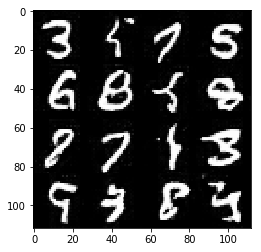

Epoch 9/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8488... Generator Loss: 1.1688
Epoch 9/25...progress:2.13%....step:20/937... Discriminator Loss: 1.6711... Generator Loss: 0.4822
Epoch 9/25...progress:3.20%....step:30/937... Discriminator Loss: 0.7912... Generator Loss: 1.4115
Epoch 9/25...progress:4.27%....step:40/937... Discriminator Loss: 0.7977... Generator Loss: 1.2890
Epoch 9/25...progress:5.34%....step:50/937... Discriminator Loss: 1.5010... Generator Loss: 0.4831
Epoch 9/25...progress:6.40%....step:60/937... Discriminator Loss: 1.2342... Generator Loss: 2.1808
Epoch 9/25...progress:7.47%....step:70/937... Discriminator Loss: 1.3611... Generator Loss: 0.5666
Epoch 9/25...progress:8.54%....step:80/937... Discriminator Loss: 0.9125... Generator Loss: 1.1056
Epoch 9/25...progress:9.61%....step:90/937... Discriminator Loss: 1.5309... Generator Loss: 0.4827
Epoch 9/25...progress:10.67%....step:100/937... Discriminator Loss: 0.9532... Generator Loss: 2.8669
Epoch 9/

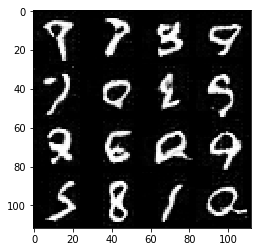

Epoch 9/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7568... Generator Loss: 1.3772
Epoch 9/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6070... Generator Loss: 2.4078
Epoch 9/25...progress:24.55%....step:230/937... Discriminator Loss: 1.0736... Generator Loss: 0.8165
Epoch 9/25...progress:25.61%....step:240/937... Discriminator Loss: 0.7500... Generator Loss: 2.2005
Epoch 9/25...progress:26.68%....step:250/937... Discriminator Loss: 2.3737... Generator Loss: 0.2200
Epoch 9/25...progress:27.75%....step:260/937... Discriminator Loss: 1.1715... Generator Loss: 0.7628
Epoch 9/25...progress:28.82%....step:270/937... Discriminator Loss: 1.2613... Generator Loss: 3.2013
Epoch 9/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7482... Generator Loss: 1.6874
Epoch 9/25...progress:30.95%....step:290/937... Discriminator Loss: 0.9886... Generator Loss: 0.9083
Epoch 9/25...progress:32.02%....step:300/937... Discriminator Loss: 1.5551... Generator Los

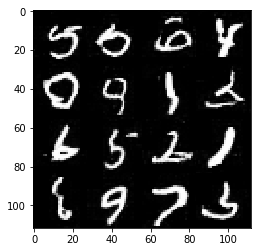

Epoch 9/25...progress:43.76%....step:410/937... Discriminator Loss: 1.2032... Generator Loss: 0.7460
Epoch 9/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7134... Generator Loss: 1.5236
Epoch 9/25...progress:45.89%....step:430/937... Discriminator Loss: 0.5879... Generator Loss: 2.4748
Epoch 9/25...progress:46.96%....step:440/937... Discriminator Loss: 0.9208... Generator Loss: 1.0865
Epoch 9/25...progress:48.03%....step:450/937... Discriminator Loss: 1.0727... Generator Loss: 0.8394
Epoch 9/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8391... Generator Loss: 1.1178
Epoch 9/25...progress:50.16%....step:470/937... Discriminator Loss: 2.5250... Generator Loss: 0.1955
Epoch 9/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8803... Generator Loss: 1.2055
Epoch 9/25...progress:52.29%....step:490/937... Discriminator Loss: 1.1508... Generator Loss: 0.7512
Epoch 9/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8683... Generator Los

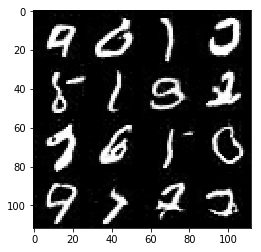

Epoch 9/25...progress:65.10%....step:610/937... Discriminator Loss: 1.2510... Generator Loss: 0.8129
Epoch 9/25...progress:66.17%....step:620/937... Discriminator Loss: 1.1089... Generator Loss: 0.7706
Epoch 9/25...progress:67.24%....step:630/937... Discriminator Loss: 0.9197... Generator Loss: 1.1531
Epoch 9/25...progress:68.30%....step:640/937... Discriminator Loss: 1.2019... Generator Loss: 0.8009
Epoch 9/25...progress:69.37%....step:650/937... Discriminator Loss: 0.9972... Generator Loss: 1.8374
Epoch 9/25...progress:70.44%....step:660/937... Discriminator Loss: 0.5747... Generator Loss: 2.0377
Epoch 9/25...progress:71.50%....step:670/937... Discriminator Loss: 0.7950... Generator Loss: 1.7568
Epoch 9/25...progress:72.57%....step:680/937... Discriminator Loss: 0.7334... Generator Loss: 2.7117
Epoch 9/25...progress:73.64%....step:690/937... Discriminator Loss: 1.2055... Generator Loss: 0.7479
Epoch 9/25...progress:74.71%....step:700/937... Discriminator Loss: 1.6362... Generator Los

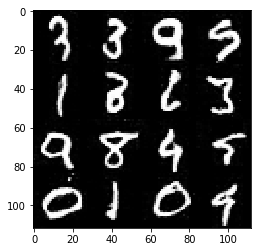

Epoch 9/25...progress:86.45%....step:810/937... Discriminator Loss: 0.8644... Generator Loss: 1.2703
Epoch 9/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8357... Generator Loss: 1.4042
Epoch 9/25...progress:88.58%....step:830/937... Discriminator Loss: 0.7956... Generator Loss: 1.2880
Epoch 9/25...progress:89.65%....step:840/937... Discriminator Loss: 1.8729... Generator Loss: 0.3370
Epoch 9/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9251... Generator Loss: 1.1437
Epoch 9/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5976... Generator Loss: 2.4397
Epoch 9/25...progress:92.85%....step:870/937... Discriminator Loss: 1.1945... Generator Loss: 0.7561
Epoch 9/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7144... Generator Loss: 1.6739
Epoch 9/25...progress:94.98%....step:890/937... Discriminator Loss: 1.0464... Generator Loss: 0.8841
Epoch 9/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2406... Generator Los

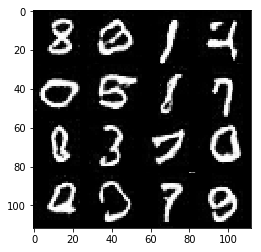

Epoch 10/25...progress:1.07%....step:10/937... Discriminator Loss: 1.2578... Generator Loss: 0.6978
Epoch 10/25...progress:2.13%....step:20/937... Discriminator Loss: 1.1562... Generator Loss: 0.7650
Epoch 10/25...progress:3.20%....step:30/937... Discriminator Loss: 1.0108... Generator Loss: 0.9542
Epoch 10/25...progress:4.27%....step:40/937... Discriminator Loss: 1.0746... Generator Loss: 0.9154
Epoch 10/25...progress:5.34%....step:50/937... Discriminator Loss: 2.0641... Generator Loss: 0.3488
Epoch 10/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0592... Generator Loss: 0.8723
Epoch 10/25...progress:7.47%....step:70/937... Discriminator Loss: 2.6653... Generator Loss: 0.1946
Epoch 10/25...progress:8.54%....step:80/937... Discriminator Loss: 1.7770... Generator Loss: 0.5616
Epoch 10/25...progress:9.61%....step:90/937... Discriminator Loss: 0.8627... Generator Loss: 1.1478
Epoch 10/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8311... Generator Loss: 1.405

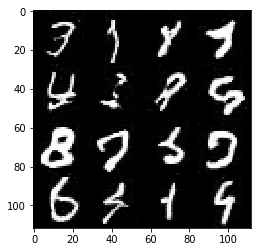

Epoch 10/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7073... Generator Loss: 1.5187
Epoch 10/25...progress:23.48%....step:220/937... Discriminator Loss: 0.8802... Generator Loss: 1.1538
Epoch 10/25...progress:24.55%....step:230/937... Discriminator Loss: 0.9697... Generator Loss: 2.5402
Epoch 10/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8583... Generator Loss: 2.0795
Epoch 10/25...progress:26.68%....step:250/937... Discriminator Loss: 1.1351... Generator Loss: 0.8313
Epoch 10/25...progress:27.75%....step:260/937... Discriminator Loss: 1.0206... Generator Loss: 0.9232
Epoch 10/25...progress:28.82%....step:270/937... Discriminator Loss: 0.8745... Generator Loss: 1.4920
Epoch 10/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7200... Generator Loss: 1.4456
Epoch 10/25...progress:30.95%....step:290/937... Discriminator Loss: 1.3409... Generator Loss: 0.6553
Epoch 10/25...progress:32.02%....step:300/937... Discriminator Loss: 1.5793... Gen

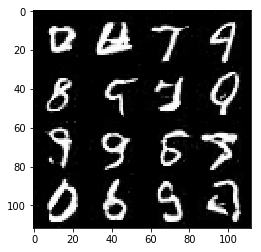

Epoch 10/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8828... Generator Loss: 1.1486
Epoch 10/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7067... Generator Loss: 2.0302
Epoch 10/25...progress:45.89%....step:430/937... Discriminator Loss: 0.7679... Generator Loss: 2.1201
Epoch 10/25...progress:46.96%....step:440/937... Discriminator Loss: 1.1206... Generator Loss: 0.8456
Epoch 10/25...progress:48.03%....step:450/937... Discriminator Loss: 0.9616... Generator Loss: 0.9908
Epoch 10/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8447... Generator Loss: 1.3457
Epoch 10/25...progress:50.16%....step:470/937... Discriminator Loss: 1.4216... Generator Loss: 0.6024
Epoch 10/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8410... Generator Loss: 1.1634
Epoch 10/25...progress:52.29%....step:490/937... Discriminator Loss: 0.9928... Generator Loss: 0.9716
Epoch 10/25...progress:53.36%....step:500/937... Discriminator Loss: 0.7212... Gen

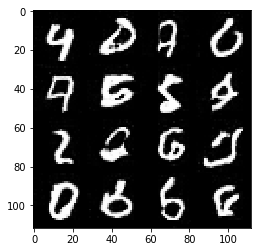

Epoch 10/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8625... Generator Loss: 1.2640
Epoch 10/25...progress:66.17%....step:620/937... Discriminator Loss: 1.4252... Generator Loss: 0.5731
Epoch 10/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8293... Generator Loss: 1.6315
Epoch 10/25...progress:68.30%....step:640/937... Discriminator Loss: 0.9672... Generator Loss: 0.9587
Epoch 10/25...progress:69.37%....step:650/937... Discriminator Loss: 0.9694... Generator Loss: 1.9255
Epoch 10/25...progress:70.44%....step:660/937... Discriminator Loss: 0.6490... Generator Loss: 1.6115
Epoch 10/25...progress:71.50%....step:670/937... Discriminator Loss: 0.9187... Generator Loss: 1.1586
Epoch 10/25...progress:72.57%....step:680/937... Discriminator Loss: 2.4996... Generator Loss: 4.7163
Epoch 10/25...progress:73.64%....step:690/937... Discriminator Loss: 0.8828... Generator Loss: 1.6980
Epoch 10/25...progress:74.71%....step:700/937... Discriminator Loss: 1.9136... Gen

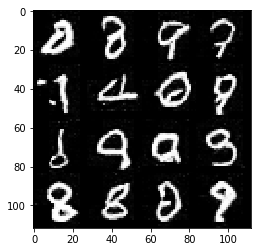

Epoch 10/25...progress:86.45%....step:810/937... Discriminator Loss: 0.8720... Generator Loss: 1.3196
Epoch 10/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8912... Generator Loss: 1.2008
Epoch 10/25...progress:88.58%....step:830/937... Discriminator Loss: 0.8138... Generator Loss: 1.2203
Epoch 10/25...progress:89.65%....step:840/937... Discriminator Loss: 1.8475... Generator Loss: 0.4621
Epoch 10/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9743... Generator Loss: 1.0583
Epoch 10/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5406... Generator Loss: 2.5813
Epoch 10/25...progress:92.85%....step:870/937... Discriminator Loss: 1.0186... Generator Loss: 0.9611
Epoch 10/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7510... Generator Loss: 1.6901
Epoch 10/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9367... Generator Loss: 1.2310
Epoch 10/25...progress:96.05%....step:900/937... Discriminator Loss: 0.8218... Gen

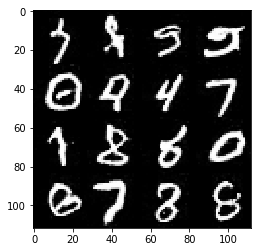

Epoch 11/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9087... Generator Loss: 1.0752
Epoch 11/25...progress:2.13%....step:20/937... Discriminator Loss: 1.1940... Generator Loss: 0.6918
Epoch 11/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9430... Generator Loss: 1.0245
Epoch 11/25...progress:4.27%....step:40/937... Discriminator Loss: 0.7356... Generator Loss: 1.6161
Epoch 11/25...progress:5.34%....step:50/937... Discriminator Loss: 1.3191... Generator Loss: 0.6038
Epoch 11/25...progress:6.40%....step:60/937... Discriminator Loss: 1.4927... Generator Loss: 2.9524
Epoch 11/25...progress:7.47%....step:70/937... Discriminator Loss: 1.5797... Generator Loss: 0.5171
Epoch 11/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8513... Generator Loss: 1.3227
Epoch 11/25...progress:9.61%....step:90/937... Discriminator Loss: 0.8485... Generator Loss: 1.1159
Epoch 11/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8378... Generator Loss: 1.881

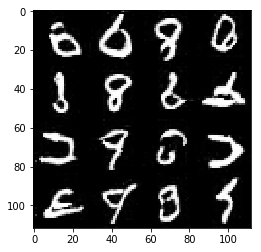

Epoch 11/25...progress:22.41%....step:210/937... Discriminator Loss: 1.0034... Generator Loss: 0.9412
Epoch 11/25...progress:23.48%....step:220/937... Discriminator Loss: 1.0156... Generator Loss: 0.9332
Epoch 11/25...progress:24.55%....step:230/937... Discriminator Loss: 0.7066... Generator Loss: 1.4889
Epoch 11/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8699... Generator Loss: 1.5843
Epoch 11/25...progress:26.68%....step:250/937... Discriminator Loss: 1.8504... Generator Loss: 0.3901
Epoch 11/25...progress:27.75%....step:260/937... Discriminator Loss: 1.0629... Generator Loss: 0.8773
Epoch 11/25...progress:28.82%....step:270/937... Discriminator Loss: 0.7773... Generator Loss: 2.6066
Epoch 11/25...progress:29.88%....step:280/937... Discriminator Loss: 1.1120... Generator Loss: 3.6798
Epoch 11/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0983... Generator Loss: 0.8279
Epoch 11/25...progress:32.02%....step:300/937... Discriminator Loss: 0.9933... Gen

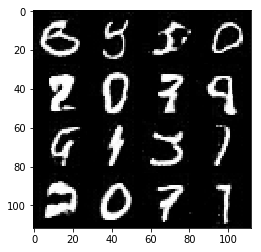

Epoch 11/25...progress:43.76%....step:410/937... Discriminator Loss: 0.9799... Generator Loss: 1.0152
Epoch 11/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6914... Generator Loss: 1.5057
Epoch 11/25...progress:45.89%....step:430/937... Discriminator Loss: 1.5866... Generator Loss: 0.4449
Epoch 11/25...progress:46.96%....step:440/937... Discriminator Loss: 0.8594... Generator Loss: 1.2014
Epoch 11/25...progress:48.03%....step:450/937... Discriminator Loss: 0.8220... Generator Loss: 1.2523
Epoch 11/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8628... Generator Loss: 1.7630
Epoch 11/25...progress:50.16%....step:470/937... Discriminator Loss: 2.2141... Generator Loss: 0.3399
Epoch 11/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8065... Generator Loss: 1.2747
Epoch 11/25...progress:52.29%....step:490/937... Discriminator Loss: 0.9022... Generator Loss: 1.2224
Epoch 11/25...progress:53.36%....step:500/937... Discriminator Loss: 0.6457... Gen

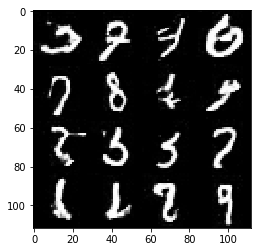

Epoch 11/25...progress:65.10%....step:610/937... Discriminator Loss: 1.1979... Generator Loss: 0.7795
Epoch 11/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0126... Generator Loss: 0.8850
Epoch 11/25...progress:67.24%....step:630/937... Discriminator Loss: 0.6826... Generator Loss: 1.8962
Epoch 11/25...progress:68.30%....step:640/937... Discriminator Loss: 1.0555... Generator Loss: 0.9126
Epoch 11/25...progress:69.37%....step:650/937... Discriminator Loss: 1.1750... Generator Loss: 2.4660
Epoch 11/25...progress:70.44%....step:660/937... Discriminator Loss: 0.6268... Generator Loss: 1.7553
Epoch 11/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0953... Generator Loss: 3.0814
Epoch 11/25...progress:72.57%....step:680/937... Discriminator Loss: 0.9048... Generator Loss: 3.5606
Epoch 11/25...progress:73.64%....step:690/937... Discriminator Loss: 1.1171... Generator Loss: 0.7707
Epoch 11/25...progress:74.71%....step:700/937... Discriminator Loss: 1.6675... Gen

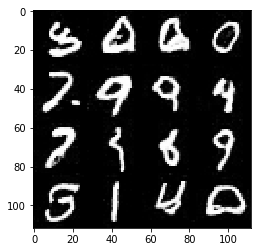

Epoch 11/25...progress:86.45%....step:810/937... Discriminator Loss: 1.1523... Generator Loss: 0.9016
Epoch 11/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9872... Generator Loss: 0.9129
Epoch 11/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6838... Generator Loss: 1.5362
Epoch 11/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9299... Generator Loss: 0.3873
Epoch 11/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7144... Generator Loss: 1.7925
Epoch 11/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6246... Generator Loss: 3.4204
Epoch 11/25...progress:92.85%....step:870/937... Discriminator Loss: 1.1736... Generator Loss: 0.7892
Epoch 11/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7204... Generator Loss: 1.5772
Epoch 11/25...progress:94.98%....step:890/937... Discriminator Loss: 1.4783... Generator Loss: 0.4984
Epoch 11/25...progress:96.05%....step:900/937... Discriminator Loss: 0.9357... Gen

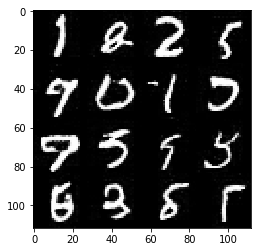

Epoch 12/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9110... Generator Loss: 1.1032
Epoch 12/25...progress:2.13%....step:20/937... Discriminator Loss: 1.8300... Generator Loss: 0.3618
Epoch 12/25...progress:3.20%....step:30/937... Discriminator Loss: 0.8299... Generator Loss: 1.4602
Epoch 12/25...progress:4.27%....step:40/937... Discriminator Loss: 1.2364... Generator Loss: 2.7485
Epoch 12/25...progress:5.34%....step:50/937... Discriminator Loss: 1.7259... Generator Loss: 0.4345
Epoch 12/25...progress:6.40%....step:60/937... Discriminator Loss: 1.7842... Generator Loss: 0.4169
Epoch 12/25...progress:7.47%....step:70/937... Discriminator Loss: 1.7897... Generator Loss: 0.4082
Epoch 12/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7182... Generator Loss: 1.4839
Epoch 12/25...progress:9.61%....step:90/937... Discriminator Loss: 0.9759... Generator Loss: 1.0086
Epoch 12/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6801... Generator Loss: 1.821

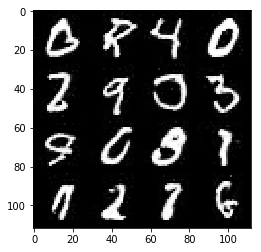

Epoch 12/25...progress:22.41%....step:210/937... Discriminator Loss: 0.5951... Generator Loss: 1.8075
Epoch 12/25...progress:23.48%....step:220/937... Discriminator Loss: 1.1091... Generator Loss: 0.8942
Epoch 12/25...progress:24.55%....step:230/937... Discriminator Loss: 1.3049... Generator Loss: 2.9129
Epoch 12/25...progress:25.61%....step:240/937... Discriminator Loss: 0.9818... Generator Loss: 1.3647
Epoch 12/25...progress:26.68%....step:250/937... Discriminator Loss: 1.4391... Generator Loss: 0.5659
Epoch 12/25...progress:27.75%....step:260/937... Discriminator Loss: 0.9765... Generator Loss: 0.9667
Epoch 12/25...progress:28.82%....step:270/937... Discriminator Loss: 0.5985... Generator Loss: 1.8833
Epoch 12/25...progress:29.88%....step:280/937... Discriminator Loss: 0.8315... Generator Loss: 1.3794
Epoch 12/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0678... Generator Loss: 0.8690
Epoch 12/25...progress:32.02%....step:300/937... Discriminator Loss: 1.1699... Gen

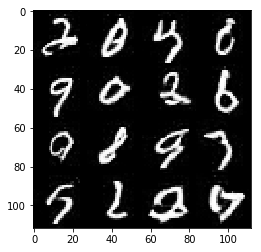

Epoch 12/25...progress:43.76%....step:410/937... Discriminator Loss: 1.3485... Generator Loss: 0.6159
Epoch 12/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7510... Generator Loss: 1.3927
Epoch 12/25...progress:45.89%....step:430/937... Discriminator Loss: 0.7385... Generator Loss: 1.4432
Epoch 12/25...progress:46.96%....step:440/937... Discriminator Loss: 1.1498... Generator Loss: 0.7780
Epoch 12/25...progress:48.03%....step:450/937... Discriminator Loss: 1.7047... Generator Loss: 0.4795
Epoch 12/25...progress:49.09%....step:460/937... Discriminator Loss: 0.5899... Generator Loss: 1.9764
Epoch 12/25...progress:50.16%....step:470/937... Discriminator Loss: 2.2245... Generator Loss: 0.2564
Epoch 12/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8337... Generator Loss: 1.2482
Epoch 12/25...progress:52.29%....step:490/937... Discriminator Loss: 0.7997... Generator Loss: 1.2949
Epoch 12/25...progress:53.36%....step:500/937... Discriminator Loss: 0.6950... Gen

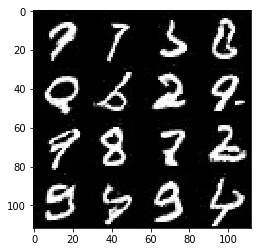

Epoch 12/25...progress:65.10%....step:610/937... Discriminator Loss: 0.7103... Generator Loss: 1.9541
Epoch 12/25...progress:66.17%....step:620/937... Discriminator Loss: 1.2072... Generator Loss: 0.7649
Epoch 12/25...progress:67.24%....step:630/937... Discriminator Loss: 0.7985... Generator Loss: 1.3109
Epoch 12/25...progress:68.30%....step:640/937... Discriminator Loss: 1.5491... Generator Loss: 0.5152
Epoch 12/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8840... Generator Loss: 2.1699
Epoch 12/25...progress:70.44%....step:660/937... Discriminator Loss: 1.7045... Generator Loss: 0.5268
Epoch 12/25...progress:71.50%....step:670/937... Discriminator Loss: 1.3815... Generator Loss: 3.5212
Epoch 12/25...progress:72.57%....step:680/937... Discriminator Loss: 1.0322... Generator Loss: 2.7650
Epoch 12/25...progress:73.64%....step:690/937... Discriminator Loss: 0.8448... Generator Loss: 2.2689
Epoch 12/25...progress:74.71%....step:700/937... Discriminator Loss: 0.9544... Gen

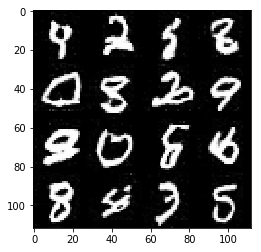

Epoch 12/25...progress:86.45%....step:810/937... Discriminator Loss: 1.1088... Generator Loss: 0.8107
Epoch 12/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8039... Generator Loss: 1.3164
Epoch 12/25...progress:88.58%....step:830/937... Discriminator Loss: 1.6242... Generator Loss: 0.4539
Epoch 12/25...progress:89.65%....step:840/937... Discriminator Loss: 1.5916... Generator Loss: 0.5623
Epoch 12/25...progress:90.72%....step:850/937... Discriminator Loss: 0.6952... Generator Loss: 1.5808
Epoch 12/25...progress:91.78%....step:860/937... Discriminator Loss: 1.7041... Generator Loss: 4.8258
Epoch 12/25...progress:92.85%....step:870/937... Discriminator Loss: 1.0802... Generator Loss: 0.8606
Epoch 12/25...progress:93.92%....step:880/937... Discriminator Loss: 0.9857... Generator Loss: 2.4948
Epoch 12/25...progress:94.98%....step:890/937... Discriminator Loss: 0.8483... Generator Loss: 1.2806
Epoch 12/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2049... Gen

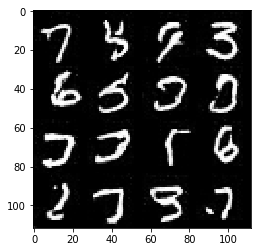

Epoch 13/25...progress:1.07%....step:10/937... Discriminator Loss: 0.7569... Generator Loss: 1.7164
Epoch 13/25...progress:2.13%....step:20/937... Discriminator Loss: 1.6349... Generator Loss: 0.4794
Epoch 13/25...progress:3.20%....step:30/937... Discriminator Loss: 1.2129... Generator Loss: 0.7128
Epoch 13/25...progress:4.27%....step:40/937... Discriminator Loss: 1.0980... Generator Loss: 2.8819
Epoch 13/25...progress:5.34%....step:50/937... Discriminator Loss: 1.2134... Generator Loss: 0.6801
Epoch 13/25...progress:6.40%....step:60/937... Discriminator Loss: 0.9441... Generator Loss: 1.3905
Epoch 13/25...progress:7.47%....step:70/937... Discriminator Loss: 0.8767... Generator Loss: 1.2890
Epoch 13/25...progress:8.54%....step:80/937... Discriminator Loss: 0.6786... Generator Loss: 1.7257
Epoch 13/25...progress:9.61%....step:90/937... Discriminator Loss: 0.8615... Generator Loss: 1.2304
Epoch 13/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6494... Generator Loss: 2.321

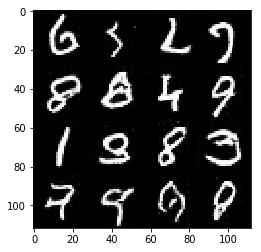

Epoch 13/25...progress:22.41%....step:210/937... Discriminator Loss: 1.1585... Generator Loss: 0.8360
Epoch 13/25...progress:23.48%....step:220/937... Discriminator Loss: 1.0029... Generator Loss: 0.9963
Epoch 13/25...progress:24.55%....step:230/937... Discriminator Loss: 0.7385... Generator Loss: 1.3497
Epoch 13/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8108... Generator Loss: 1.5337
Epoch 13/25...progress:26.68%....step:250/937... Discriminator Loss: 1.9718... Generator Loss: 0.5139
Epoch 13/25...progress:27.75%....step:260/937... Discriminator Loss: 1.3808... Generator Loss: 0.6421
Epoch 13/25...progress:28.82%....step:270/937... Discriminator Loss: 0.8211... Generator Loss: 2.2413
Epoch 13/25...progress:29.88%....step:280/937... Discriminator Loss: 0.8426... Generator Loss: 2.1428
Epoch 13/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1477... Generator Loss: 0.8520
Epoch 13/25...progress:32.02%....step:300/937... Discriminator Loss: 1.0049... Gen

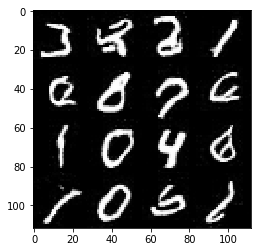

Epoch 13/25...progress:43.76%....step:410/937... Discriminator Loss: 1.6663... Generator Loss: 0.5527
Epoch 13/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6363... Generator Loss: 1.6955
Epoch 13/25...progress:45.89%....step:430/937... Discriminator Loss: 0.6792... Generator Loss: 1.9180
Epoch 13/25...progress:46.96%....step:440/937... Discriminator Loss: 1.2207... Generator Loss: 0.7321
Epoch 13/25...progress:48.03%....step:450/937... Discriminator Loss: 0.7462... Generator Loss: 1.3540
Epoch 13/25...progress:49.09%....step:460/937... Discriminator Loss: 0.9692... Generator Loss: 2.2657
Epoch 13/25...progress:50.16%....step:470/937... Discriminator Loss: 1.5995... Generator Loss: 3.5523
Epoch 13/25...progress:51.23%....step:480/937... Discriminator Loss: 0.9017... Generator Loss: 1.1032
Epoch 13/25...progress:52.29%....step:490/937... Discriminator Loss: 1.3812... Generator Loss: 0.6035
Epoch 13/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8259... Gen

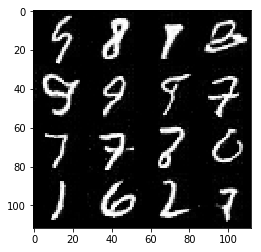

Epoch 13/25...progress:65.10%....step:610/937... Discriminator Loss: 0.6852... Generator Loss: 1.5685
Epoch 13/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0564... Generator Loss: 0.9067
Epoch 13/25...progress:67.24%....step:630/937... Discriminator Loss: 1.2817... Generator Loss: 0.6870
Epoch 13/25...progress:68.30%....step:640/937... Discriminator Loss: 0.9202... Generator Loss: 1.1233
Epoch 13/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8602... Generator Loss: 1.7317
Epoch 13/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9493... Generator Loss: 0.9922
Epoch 13/25...progress:71.50%....step:670/937... Discriminator Loss: 1.5029... Generator Loss: 3.6753
Epoch 13/25...progress:72.57%....step:680/937... Discriminator Loss: 1.6132... Generator Loss: 3.4962
Epoch 13/25...progress:73.64%....step:690/937... Discriminator Loss: 1.2347... Generator Loss: 0.6837
Epoch 13/25...progress:74.71%....step:700/937... Discriminator Loss: 1.5426... Gen

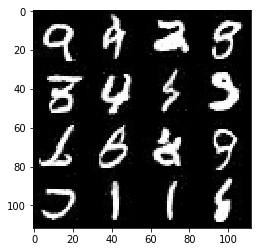

Epoch 13/25...progress:86.45%....step:810/937... Discriminator Loss: 1.6819... Generator Loss: 0.5247
Epoch 13/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9444... Generator Loss: 0.9945
Epoch 13/25...progress:88.58%....step:830/937... Discriminator Loss: 0.7870... Generator Loss: 1.3024
Epoch 13/25...progress:89.65%....step:840/937... Discriminator Loss: 2.4311... Generator Loss: 0.2374
Epoch 13/25...progress:90.72%....step:850/937... Discriminator Loss: 1.0534... Generator Loss: 0.8761
Epoch 13/25...progress:91.78%....step:860/937... Discriminator Loss: 0.4280... Generator Loss: 2.9558
Epoch 13/25...progress:92.85%....step:870/937... Discriminator Loss: 1.4999... Generator Loss: 0.5753
Epoch 13/25...progress:93.92%....step:880/937... Discriminator Loss: 1.1967... Generator Loss: 0.8712
Epoch 13/25...progress:94.98%....step:890/937... Discriminator Loss: 1.2968... Generator Loss: 0.6659
Epoch 13/25...progress:96.05%....step:900/937... Discriminator Loss: 0.8171... Gen

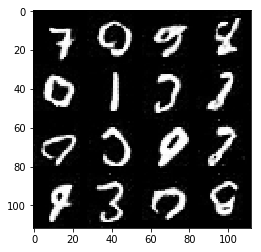

Epoch 14/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8503... Generator Loss: 1.2342
Epoch 14/25...progress:2.13%....step:20/937... Discriminator Loss: 1.0394... Generator Loss: 1.1879
Epoch 14/25...progress:3.20%....step:30/937... Discriminator Loss: 1.2495... Generator Loss: 0.7038
Epoch 14/25...progress:4.27%....step:40/937... Discriminator Loss: 0.8067... Generator Loss: 1.3095
Epoch 14/25...progress:5.34%....step:50/937... Discriminator Loss: 2.0157... Generator Loss: 0.3249
Epoch 14/25...progress:6.40%....step:60/937... Discriminator Loss: 1.4133... Generator Loss: 0.5368
Epoch 14/25...progress:7.47%....step:70/937... Discriminator Loss: 1.1860... Generator Loss: 0.7146
Epoch 14/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7172... Generator Loss: 1.5552
Epoch 14/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1931... Generator Loss: 0.7522
Epoch 14/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8737... Generator Loss: 1.692

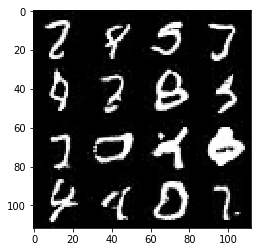

Epoch 14/25...progress:22.41%....step:210/937... Discriminator Loss: 0.8434... Generator Loss: 1.2762
Epoch 14/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6641... Generator Loss: 1.7241
Epoch 14/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8513... Generator Loss: 3.0681
Epoch 14/25...progress:25.61%....step:240/937... Discriminator Loss: 1.1287... Generator Loss: 2.0049
Epoch 14/25...progress:26.68%....step:250/937... Discriminator Loss: 1.1053... Generator Loss: 0.9963
Epoch 14/25...progress:27.75%....step:260/937... Discriminator Loss: 0.8856... Generator Loss: 1.1556
Epoch 14/25...progress:28.82%....step:270/937... Discriminator Loss: 0.6200... Generator Loss: 1.7268
Epoch 14/25...progress:29.88%....step:280/937... Discriminator Loss: 0.5102... Generator Loss: 3.0756
Epoch 14/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0147... Generator Loss: 0.9898
Epoch 14/25...progress:32.02%....step:300/937... Discriminator Loss: 0.8360... Gen

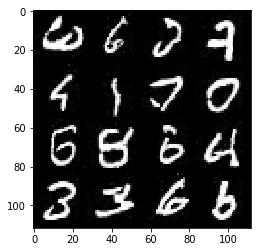

Epoch 14/25...progress:43.76%....step:410/937... Discriminator Loss: 1.6408... Generator Loss: 0.5644
Epoch 14/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6292... Generator Loss: 1.7054
Epoch 14/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8588... Generator Loss: 1.1401
Epoch 14/25...progress:46.96%....step:440/937... Discriminator Loss: 1.3231... Generator Loss: 0.6624
Epoch 14/25...progress:48.03%....step:450/937... Discriminator Loss: 1.5938... Generator Loss: 0.5664
Epoch 14/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7407... Generator Loss: 1.6909
Epoch 14/25...progress:50.16%....step:470/937... Discriminator Loss: 1.0306... Generator Loss: 0.9966
Epoch 14/25...progress:51.23%....step:480/937... Discriminator Loss: 0.6759... Generator Loss: 1.9564
Epoch 14/25...progress:52.29%....step:490/937... Discriminator Loss: 0.7872... Generator Loss: 1.5206
Epoch 14/25...progress:53.36%....step:500/937... Discriminator Loss: 0.9430... Gen

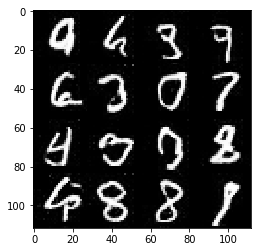

Epoch 14/25...progress:65.10%....step:610/937... Discriminator Loss: 0.7028... Generator Loss: 1.5341
Epoch 14/25...progress:66.17%....step:620/937... Discriminator Loss: 0.8106... Generator Loss: 1.2240
Epoch 14/25...progress:67.24%....step:630/937... Discriminator Loss: 0.7653... Generator Loss: 1.7504
Epoch 14/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8659... Generator Loss: 1.2362
Epoch 14/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8934... Generator Loss: 2.3179
Epoch 14/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9201... Generator Loss: 1.0381
Epoch 14/25...progress:71.50%....step:670/937... Discriminator Loss: 1.9532... Generator Loss: 4.5204
Epoch 14/25...progress:72.57%....step:680/937... Discriminator Loss: 0.8602... Generator Loss: 2.3416
Epoch 14/25...progress:73.64%....step:690/937... Discriminator Loss: 0.9181... Generator Loss: 1.1263
Epoch 14/25...progress:74.71%....step:700/937... Discriminator Loss: 1.9371... Gen

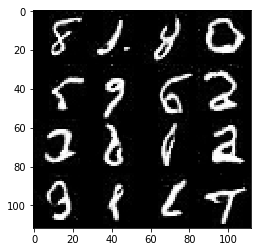

Epoch 14/25...progress:86.45%....step:810/937... Discriminator Loss: 0.7473... Generator Loss: 1.4273
Epoch 14/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9359... Generator Loss: 1.0182
Epoch 14/25...progress:88.58%....step:830/937... Discriminator Loss: 0.7830... Generator Loss: 1.4137
Epoch 14/25...progress:89.65%....step:840/937... Discriminator Loss: 2.2739... Generator Loss: 0.2980
Epoch 14/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7292... Generator Loss: 2.3542
Epoch 14/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5666... Generator Loss: 1.9552
Epoch 14/25...progress:92.85%....step:870/937... Discriminator Loss: 1.2270... Generator Loss: 0.7923
Epoch 14/25...progress:93.92%....step:880/937... Discriminator Loss: 0.9998... Generator Loss: 0.9230
Epoch 14/25...progress:94.98%....step:890/937... Discriminator Loss: 1.0320... Generator Loss: 0.9015
Epoch 14/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0632... Gen

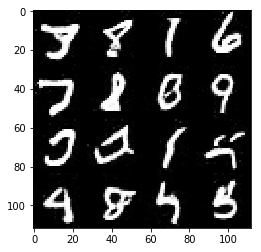

Epoch 15/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8601... Generator Loss: 1.1826
Epoch 15/25...progress:2.13%....step:20/937... Discriminator Loss: 2.3466... Generator Loss: 0.2192
Epoch 15/25...progress:3.20%....step:30/937... Discriminator Loss: 2.0673... Generator Loss: 0.3739
Epoch 15/25...progress:4.27%....step:40/937... Discriminator Loss: 0.7896... Generator Loss: 1.7200
Epoch 15/25...progress:5.34%....step:50/937... Discriminator Loss: 1.0943... Generator Loss: 0.8711
Epoch 15/25...progress:6.40%....step:60/937... Discriminator Loss: 1.1869... Generator Loss: 0.7950
Epoch 15/25...progress:7.47%....step:70/937... Discriminator Loss: 1.7694... Generator Loss: 0.4317
Epoch 15/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7077... Generator Loss: 1.5586
Epoch 15/25...progress:9.61%....step:90/937... Discriminator Loss: 1.2192... Generator Loss: 0.7472
Epoch 15/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6517... Generator Loss: 1.996

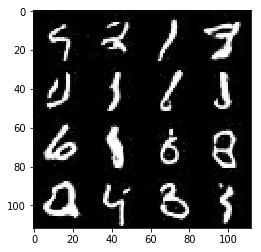

Epoch 15/25...progress:22.41%....step:210/937... Discriminator Loss: 0.8041... Generator Loss: 1.3152
Epoch 15/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6620... Generator Loss: 1.6443
Epoch 15/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6613... Generator Loss: 1.5133
Epoch 15/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8722... Generator Loss: 1.2447
Epoch 15/25...progress:26.68%....step:250/937... Discriminator Loss: 0.9314... Generator Loss: 1.1132
Epoch 15/25...progress:27.75%....step:260/937... Discriminator Loss: 1.1779... Generator Loss: 0.8212
Epoch 15/25...progress:28.82%....step:270/937... Discriminator Loss: 1.0247... Generator Loss: 2.1027
Epoch 15/25...progress:29.88%....step:280/937... Discriminator Loss: 0.6851... Generator Loss: 1.5508
Epoch 15/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1755... Generator Loss: 0.7353
Epoch 15/25...progress:32.02%....step:300/937... Discriminator Loss: 0.7157... Gen

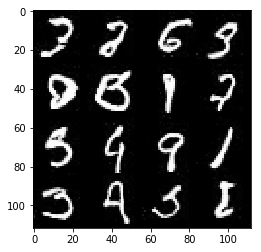

Epoch 15/25...progress:43.76%....step:410/937... Discriminator Loss: 0.9087... Generator Loss: 1.1148
Epoch 15/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6203... Generator Loss: 1.7550
Epoch 15/25...progress:45.89%....step:430/937... Discriminator Loss: 1.6972... Generator Loss: 0.5053
Epoch 15/25...progress:46.96%....step:440/937... Discriminator Loss: 0.9705... Generator Loss: 1.0366
Epoch 15/25...progress:48.03%....step:450/937... Discriminator Loss: 0.8138... Generator Loss: 1.3164
Epoch 15/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8235... Generator Loss: 1.1478
Epoch 15/25...progress:50.16%....step:470/937... Discriminator Loss: 2.2618... Generator Loss: 0.3019
Epoch 15/25...progress:51.23%....step:480/937... Discriminator Loss: 1.1827... Generator Loss: 0.7653
Epoch 15/25...progress:52.29%....step:490/937... Discriminator Loss: 0.7105... Generator Loss: 1.7441
Epoch 15/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8688... Gen

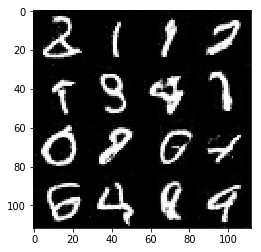

Epoch 15/25...progress:65.10%....step:610/937... Discriminator Loss: 0.6204... Generator Loss: 1.9368
Epoch 15/25...progress:66.17%....step:620/937... Discriminator Loss: 1.2817... Generator Loss: 0.6477
Epoch 15/25...progress:67.24%....step:630/937... Discriminator Loss: 0.9268... Generator Loss: 1.0678
Epoch 15/25...progress:68.30%....step:640/937... Discriminator Loss: 0.9276... Generator Loss: 1.1106
Epoch 15/25...progress:69.37%....step:650/937... Discriminator Loss: 0.7524... Generator Loss: 2.4764
Epoch 15/25...progress:70.44%....step:660/937... Discriminator Loss: 1.2332... Generator Loss: 0.7337
Epoch 15/25...progress:71.50%....step:670/937... Discriminator Loss: 0.8017... Generator Loss: 1.2565
Epoch 15/25...progress:72.57%....step:680/937... Discriminator Loss: 1.6220... Generator Loss: 3.4790
Epoch 15/25...progress:73.64%....step:690/937... Discriminator Loss: 1.8328... Generator Loss: 0.4141
Epoch 15/25...progress:74.71%....step:700/937... Discriminator Loss: 1.3640... Gen

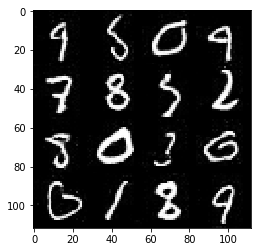

Epoch 15/25...progress:86.45%....step:810/937... Discriminator Loss: 1.5941... Generator Loss: 3.5425
Epoch 15/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8197... Generator Loss: 1.2325
Epoch 15/25...progress:88.58%....step:830/937... Discriminator Loss: 1.4540... Generator Loss: 0.5725
Epoch 15/25...progress:89.65%....step:840/937... Discriminator Loss: 2.0529... Generator Loss: 0.3459
Epoch 15/25...progress:90.72%....step:850/937... Discriminator Loss: 0.6141... Generator Loss: 1.9691
Epoch 15/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6307... Generator Loss: 1.6613
Epoch 15/25...progress:92.85%....step:870/937... Discriminator Loss: 1.4100... Generator Loss: 0.5955
Epoch 15/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7521... Generator Loss: 1.4327
Epoch 15/25...progress:94.98%....step:890/937... Discriminator Loss: 1.5980... Generator Loss: 0.4692
Epoch 15/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0234... Gen

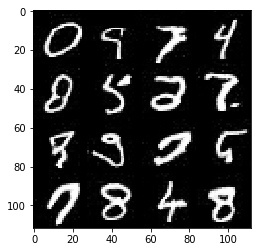

Epoch 16/25...progress:1.07%....step:10/937... Discriminator Loss: 0.6707... Generator Loss: 1.5986
Epoch 16/25...progress:2.13%....step:20/937... Discriminator Loss: 1.1121... Generator Loss: 0.8024
Epoch 16/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9061... Generator Loss: 1.1172
Epoch 16/25...progress:4.27%....step:40/937... Discriminator Loss: 1.2595... Generator Loss: 0.8022
Epoch 16/25...progress:5.34%....step:50/937... Discriminator Loss: 2.3421... Generator Loss: 0.2423
Epoch 16/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0612... Generator Loss: 0.8743
Epoch 16/25...progress:7.47%....step:70/937... Discriminator Loss: 1.5141... Generator Loss: 0.4890
Epoch 16/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8416... Generator Loss: 1.2257
Epoch 16/25...progress:9.61%....step:90/937... Discriminator Loss: 1.2444... Generator Loss: 0.7591
Epoch 16/25...progress:10.67%....step:100/937... Discriminator Loss: 0.6973... Generator Loss: 2.084

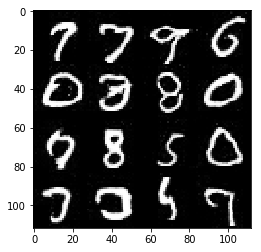

Epoch 16/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7965... Generator Loss: 1.3481
Epoch 16/25...progress:23.48%....step:220/937... Discriminator Loss: 0.8865... Generator Loss: 1.1016
Epoch 16/25...progress:24.55%....step:230/937... Discriminator Loss: 0.5031... Generator Loss: 2.3182
Epoch 16/25...progress:25.61%....step:240/937... Discriminator Loss: 1.6935... Generator Loss: 0.4395
Epoch 16/25...progress:26.68%....step:250/937... Discriminator Loss: 2.0477... Generator Loss: 0.3347
Epoch 16/25...progress:27.75%....step:260/937... Discriminator Loss: 1.4613... Generator Loss: 0.5623
Epoch 16/25...progress:28.82%....step:270/937... Discriminator Loss: 0.7827... Generator Loss: 1.2684
Epoch 16/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7434... Generator Loss: 2.3198
Epoch 16/25...progress:30.95%....step:290/937... Discriminator Loss: 1.1041... Generator Loss: 0.8394
Epoch 16/25...progress:32.02%....step:300/937... Discriminator Loss: 0.6350... Gen

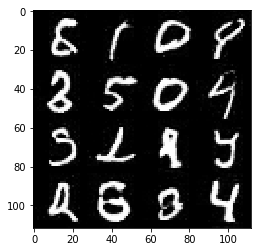

Epoch 16/25...progress:43.76%....step:410/937... Discriminator Loss: 0.6838... Generator Loss: 1.6373
Epoch 16/25...progress:44.82%....step:420/937... Discriminator Loss: 1.1599... Generator Loss: 0.8486
Epoch 16/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8959... Generator Loss: 2.5487
Epoch 16/25...progress:46.96%....step:440/937... Discriminator Loss: 0.9355... Generator Loss: 1.0179
Epoch 16/25...progress:48.03%....step:450/937... Discriminator Loss: 1.1180... Generator Loss: 0.8072
Epoch 16/25...progress:49.09%....step:460/937... Discriminator Loss: 1.3063... Generator Loss: 0.6293
Epoch 16/25...progress:50.16%....step:470/937... Discriminator Loss: 2.1855... Generator Loss: 0.3214
Epoch 16/25...progress:51.23%....step:480/937... Discriminator Loss: 0.9349... Generator Loss: 1.1019
Epoch 16/25...progress:52.29%....step:490/937... Discriminator Loss: 2.1957... Generator Loss: 0.2612
Epoch 16/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8089... Gen

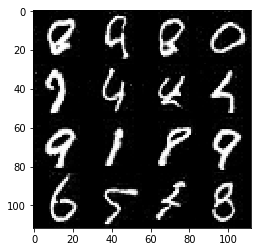

Epoch 16/25...progress:65.10%....step:610/937... Discriminator Loss: 1.6887... Generator Loss: 0.4813
Epoch 16/25...progress:66.17%....step:620/937... Discriminator Loss: 1.5405... Generator Loss: 0.5766
Epoch 16/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8784... Generator Loss: 1.1221
Epoch 16/25...progress:68.30%....step:640/937... Discriminator Loss: 0.9090... Generator Loss: 1.1010
Epoch 16/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8691... Generator Loss: 2.0721
Epoch 16/25...progress:70.44%....step:660/937... Discriminator Loss: 0.8574... Generator Loss: 1.2082
Epoch 16/25...progress:71.50%....step:670/937... Discriminator Loss: 0.9103... Generator Loss: 1.0546
Epoch 16/25...progress:72.57%....step:680/937... Discriminator Loss: 0.8972... Generator Loss: 3.3893
Epoch 16/25...progress:73.64%....step:690/937... Discriminator Loss: 1.4786... Generator Loss: 0.6524
Epoch 16/25...progress:74.71%....step:700/937... Discriminator Loss: 1.9435... Gen

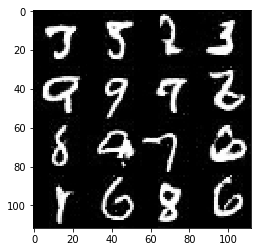

Epoch 16/25...progress:86.45%....step:810/937... Discriminator Loss: 1.0696... Generator Loss: 0.9007
Epoch 16/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8227... Generator Loss: 1.1379
Epoch 16/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6088... Generator Loss: 1.9932
Epoch 16/25...progress:89.65%....step:840/937... Discriminator Loss: 2.7776... Generator Loss: 0.2027
Epoch 16/25...progress:90.72%....step:850/937... Discriminator Loss: 1.4485... Generator Loss: 0.7759
Epoch 16/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5110... Generator Loss: 2.4097
Epoch 16/25...progress:92.85%....step:870/937... Discriminator Loss: 1.3499... Generator Loss: 0.8635
Epoch 16/25...progress:93.92%....step:880/937... Discriminator Loss: 1.3323... Generator Loss: 0.6440
Epoch 16/25...progress:94.98%....step:890/937... Discriminator Loss: 0.7407... Generator Loss: 1.4274
Epoch 16/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0271... Gen

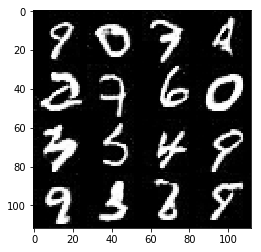

Epoch 17/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8501... Generator Loss: 2.7324
Epoch 17/25...progress:2.13%....step:20/937... Discriminator Loss: 1.7812... Generator Loss: 0.4502
Epoch 17/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9232... Generator Loss: 1.3158
Epoch 17/25...progress:4.27%....step:40/937... Discriminator Loss: 0.8101... Generator Loss: 1.7387
Epoch 17/25...progress:5.34%....step:50/937... Discriminator Loss: 0.9993... Generator Loss: 0.9587
Epoch 17/25...progress:6.40%....step:60/937... Discriminator Loss: 1.4637... Generator Loss: 3.4110
Epoch 17/25...progress:7.47%....step:70/937... Discriminator Loss: 1.7235... Generator Loss: 0.4922
Epoch 17/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8118... Generator Loss: 1.5331
Epoch 17/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1656... Generator Loss: 0.7559
Epoch 17/25...progress:10.67%....step:100/937... Discriminator Loss: 0.7246... Generator Loss: 1.510

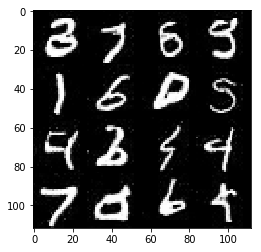

Epoch 17/25...progress:22.41%....step:210/937... Discriminator Loss: 1.3736... Generator Loss: 0.6702
Epoch 17/25...progress:23.48%....step:220/937... Discriminator Loss: 1.2976... Generator Loss: 0.6954
Epoch 17/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6505... Generator Loss: 1.8181
Epoch 17/25...progress:25.61%....step:240/937... Discriminator Loss: 0.7218... Generator Loss: 1.4882
Epoch 17/25...progress:26.68%....step:250/937... Discriminator Loss: 0.9451... Generator Loss: 1.0734
Epoch 17/25...progress:27.75%....step:260/937... Discriminator Loss: 1.4264... Generator Loss: 0.6429
Epoch 17/25...progress:28.82%....step:270/937... Discriminator Loss: 1.5376... Generator Loss: 0.5718
Epoch 17/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7914... Generator Loss: 1.4127
Epoch 17/25...progress:30.95%....step:290/937... Discriminator Loss: 0.7629... Generator Loss: 1.5022
Epoch 17/25...progress:32.02%....step:300/937... Discriminator Loss: 1.8122... Gen

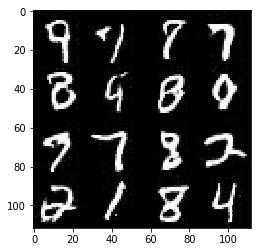

Epoch 17/25...progress:43.76%....step:410/937... Discriminator Loss: 1.2138... Generator Loss: 0.8064
Epoch 17/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6856... Generator Loss: 1.5515
Epoch 17/25...progress:45.89%....step:430/937... Discriminator Loss: 0.7320... Generator Loss: 1.5676
Epoch 17/25...progress:46.96%....step:440/937... Discriminator Loss: 1.1944... Generator Loss: 0.7662
Epoch 17/25...progress:48.03%....step:450/937... Discriminator Loss: 1.1254... Generator Loss: 0.7875
Epoch 17/25...progress:49.09%....step:460/937... Discriminator Loss: 0.8821... Generator Loss: 1.1165
Epoch 17/25...progress:50.16%....step:470/937... Discriminator Loss: 0.6592... Generator Loss: 1.9583
Epoch 17/25...progress:51.23%....step:480/937... Discriminator Loss: 0.7404... Generator Loss: 1.6167
Epoch 17/25...progress:52.29%....step:490/937... Discriminator Loss: 0.7573... Generator Loss: 2.6031
Epoch 17/25...progress:53.36%....step:500/937... Discriminator Loss: 1.0137... Gen

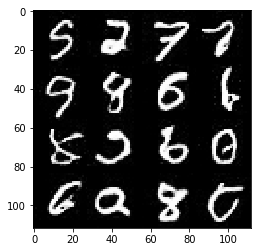

Epoch 17/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8078... Generator Loss: 1.3768
Epoch 17/25...progress:66.17%....step:620/937... Discriminator Loss: 0.7249... Generator Loss: 1.4134
Epoch 17/25...progress:67.24%....step:630/937... Discriminator Loss: 0.9550... Generator Loss: 2.6868
Epoch 17/25...progress:68.30%....step:640/937... Discriminator Loss: 0.7298... Generator Loss: 2.1875
Epoch 17/25...progress:69.37%....step:650/937... Discriminator Loss: 1.3756... Generator Loss: 2.9351
Epoch 17/25...progress:70.44%....step:660/937... Discriminator Loss: 1.3006... Generator Loss: 0.6962
Epoch 17/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0129... Generator Loss: 0.9217
Epoch 17/25...progress:72.57%....step:680/937... Discriminator Loss: 1.0221... Generator Loss: 3.3080
Epoch 17/25...progress:73.64%....step:690/937... Discriminator Loss: 1.6530... Generator Loss: 2.8522
Epoch 17/25...progress:74.71%....step:700/937... Discriminator Loss: 0.9189... Gen

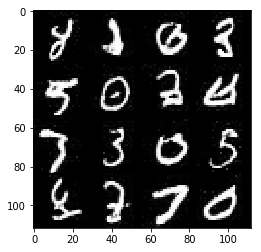

Epoch 17/25...progress:86.45%....step:810/937... Discriminator Loss: 1.4862... Generator Loss: 0.5051
Epoch 17/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8429... Generator Loss: 1.3931
Epoch 17/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6451... Generator Loss: 1.7928
Epoch 17/25...progress:89.65%....step:840/937... Discriminator Loss: 2.3266... Generator Loss: 0.3058
Epoch 17/25...progress:90.72%....step:850/937... Discriminator Loss: 0.9580... Generator Loss: 2.0631
Epoch 17/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5955... Generator Loss: 3.3838
Epoch 17/25...progress:92.85%....step:870/937... Discriminator Loss: 1.2213... Generator Loss: 0.8253
Epoch 17/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7929... Generator Loss: 2.0329
Epoch 17/25...progress:94.98%....step:890/937... Discriminator Loss: 1.5001... Generator Loss: 0.5869
Epoch 17/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2820... Gen

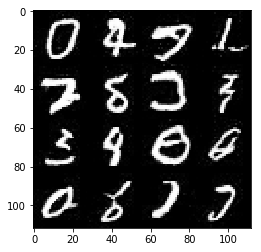

Epoch 18/25...progress:1.07%....step:10/937... Discriminator Loss: 1.0796... Generator Loss: 0.8717
Epoch 18/25...progress:2.13%....step:20/937... Discriminator Loss: 0.8713... Generator Loss: 1.6993
Epoch 18/25...progress:3.20%....step:30/937... Discriminator Loss: 1.4471... Generator Loss: 0.6122
Epoch 18/25...progress:4.27%....step:40/937... Discriminator Loss: 1.3324... Generator Loss: 0.6620
Epoch 18/25...progress:5.34%....step:50/937... Discriminator Loss: 1.1628... Generator Loss: 0.7149
Epoch 18/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0109... Generator Loss: 1.9628
Epoch 18/25...progress:7.47%....step:70/937... Discriminator Loss: 1.0538... Generator Loss: 0.9076
Epoch 18/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7205... Generator Loss: 1.4650
Epoch 18/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1262... Generator Loss: 0.7622
Epoch 18/25...progress:10.67%....step:100/937... Discriminator Loss: 0.7321... Generator Loss: 2.144

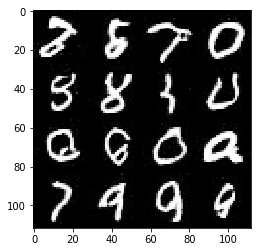

Epoch 18/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7689... Generator Loss: 1.3946
Epoch 18/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6016... Generator Loss: 2.2010
Epoch 18/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6482... Generator Loss: 1.7609
Epoch 18/25...progress:25.61%....step:240/937... Discriminator Loss: 0.9782... Generator Loss: 0.9710
Epoch 18/25...progress:26.68%....step:250/937... Discriminator Loss: 1.6544... Generator Loss: 0.4960
Epoch 18/25...progress:27.75%....step:260/937... Discriminator Loss: 1.0996... Generator Loss: 0.7837
Epoch 18/25...progress:28.82%....step:270/937... Discriminator Loss: 0.6125... Generator Loss: 2.6275
Epoch 18/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7227... Generator Loss: 2.2353
Epoch 18/25...progress:30.95%....step:290/937... Discriminator Loss: 1.3619... Generator Loss: 0.8084
Epoch 18/25...progress:32.02%....step:300/937... Discriminator Loss: 1.9098... Gen

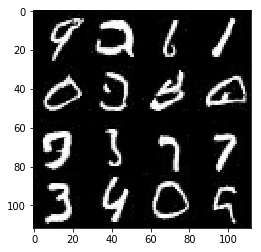

Epoch 18/25...progress:43.76%....step:410/937... Discriminator Loss: 1.5555... Generator Loss: 0.5652
Epoch 18/25...progress:44.82%....step:420/937... Discriminator Loss: 0.8191... Generator Loss: 1.2799
Epoch 18/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8460... Generator Loss: 1.3378
Epoch 18/25...progress:46.96%....step:440/937... Discriminator Loss: 1.1595... Generator Loss: 0.7738
Epoch 18/25...progress:48.03%....step:450/937... Discriminator Loss: 1.2776... Generator Loss: 0.7418
Epoch 18/25...progress:49.09%....step:460/937... Discriminator Loss: 1.1824... Generator Loss: 0.8845
Epoch 18/25...progress:50.16%....step:470/937... Discriminator Loss: 1.1260... Generator Loss: 0.8600
Epoch 18/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8416... Generator Loss: 1.2606
Epoch 18/25...progress:52.29%....step:490/937... Discriminator Loss: 0.8147... Generator Loss: 1.3366
Epoch 18/25...progress:53.36%....step:500/937... Discriminator Loss: 0.7677... Gen

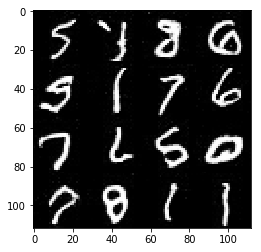

Epoch 18/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8061... Generator Loss: 1.3114
Epoch 18/25...progress:66.17%....step:620/937... Discriminator Loss: 1.4137... Generator Loss: 0.6912
Epoch 18/25...progress:67.24%....step:630/937... Discriminator Loss: 0.7790... Generator Loss: 1.7467
Epoch 18/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8849... Generator Loss: 1.2250
Epoch 18/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8540... Generator Loss: 2.2225
Epoch 18/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9742... Generator Loss: 1.0094
Epoch 18/25...progress:71.50%....step:670/937... Discriminator Loss: 0.8651... Generator Loss: 2.3248
Epoch 18/25...progress:72.57%....step:680/937... Discriminator Loss: 1.5719... Generator Loss: 4.1544
Epoch 18/25...progress:73.64%....step:690/937... Discriminator Loss: 1.0617... Generator Loss: 2.6900
Epoch 18/25...progress:74.71%....step:700/937... Discriminator Loss: 1.9844... Gen

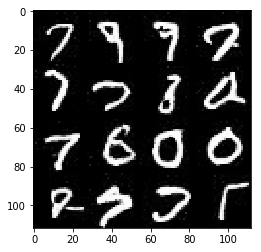

Epoch 18/25...progress:86.45%....step:810/937... Discriminator Loss: 0.9356... Generator Loss: 1.0769
Epoch 18/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9098... Generator Loss: 1.0704
Epoch 18/25...progress:88.58%....step:830/937... Discriminator Loss: 0.6377... Generator Loss: 1.7277
Epoch 18/25...progress:89.65%....step:840/937... Discriminator Loss: 2.4778... Generator Loss: 0.2580
Epoch 18/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7217... Generator Loss: 1.4439
Epoch 18/25...progress:91.78%....step:860/937... Discriminator Loss: 0.4657... Generator Loss: 2.6308
Epoch 18/25...progress:92.85%....step:870/937... Discriminator Loss: 0.6946... Generator Loss: 1.7088
Epoch 18/25...progress:93.92%....step:880/937... Discriminator Loss: 0.6147... Generator Loss: 1.8797
Epoch 18/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9160... Generator Loss: 1.3998
Epoch 18/25...progress:96.05%....step:900/937... Discriminator Loss: 1.4250... Gen

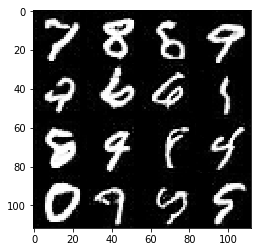

Epoch 19/25...progress:1.07%....step:10/937... Discriminator Loss: 1.0857... Generator Loss: 0.9709
Epoch 19/25...progress:2.13%....step:20/937... Discriminator Loss: 1.0061... Generator Loss: 0.9021
Epoch 19/25...progress:3.20%....step:30/937... Discriminator Loss: 1.6509... Generator Loss: 0.5174
Epoch 19/25...progress:4.27%....step:40/937... Discriminator Loss: 1.5210... Generator Loss: 0.4995
Epoch 19/25...progress:5.34%....step:50/937... Discriminator Loss: 1.3557... Generator Loss: 0.6033
Epoch 19/25...progress:6.40%....step:60/937... Discriminator Loss: 1.7289... Generator Loss: 0.4209
Epoch 19/25...progress:7.47%....step:70/937... Discriminator Loss: 0.9408... Generator Loss: 1.0534
Epoch 19/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8332... Generator Loss: 1.3899
Epoch 19/25...progress:9.61%....step:90/937... Discriminator Loss: 0.7913... Generator Loss: 1.2608
Epoch 19/25...progress:10.67%....step:100/937... Discriminator Loss: 1.4567... Generator Loss: 4.037

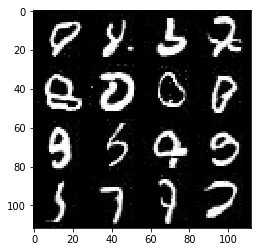

Epoch 19/25...progress:22.41%....step:210/937... Discriminator Loss: 1.1114... Generator Loss: 0.9424
Epoch 19/25...progress:23.48%....step:220/937... Discriminator Loss: 0.8299... Generator Loss: 1.3474
Epoch 19/25...progress:24.55%....step:230/937... Discriminator Loss: 1.0556... Generator Loss: 3.5623
Epoch 19/25...progress:25.61%....step:240/937... Discriminator Loss: 0.7017... Generator Loss: 2.1102
Epoch 19/25...progress:26.68%....step:250/937... Discriminator Loss: 1.9257... Generator Loss: 0.3058
Epoch 19/25...progress:27.75%....step:260/937... Discriminator Loss: 1.5280... Generator Loss: 0.5395
Epoch 19/25...progress:28.82%....step:270/937... Discriminator Loss: 0.8877... Generator Loss: 1.8592
Epoch 19/25...progress:29.88%....step:280/937... Discriminator Loss: 0.9168... Generator Loss: 2.3089
Epoch 19/25...progress:30.95%....step:290/937... Discriminator Loss: 0.9155... Generator Loss: 1.0451
Epoch 19/25...progress:32.02%....step:300/937... Discriminator Loss: 1.5502... Gen

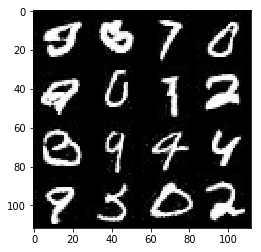

Epoch 19/25...progress:43.76%....step:410/937... Discriminator Loss: 1.1292... Generator Loss: 0.7975
Epoch 19/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7673... Generator Loss: 1.4079
Epoch 19/25...progress:45.89%....step:430/937... Discriminator Loss: 1.1788... Generator Loss: 0.7473
Epoch 19/25...progress:46.96%....step:440/937... Discriminator Loss: 1.3624... Generator Loss: 0.6350
Epoch 19/25...progress:48.03%....step:450/937... Discriminator Loss: 1.9036... Generator Loss: 0.5041
Epoch 19/25...progress:49.09%....step:460/937... Discriminator Loss: 0.9136... Generator Loss: 1.1370
Epoch 19/25...progress:50.16%....step:470/937... Discriminator Loss: 1.2582... Generator Loss: 0.6954
Epoch 19/25...progress:51.23%....step:480/937... Discriminator Loss: 0.7610... Generator Loss: 1.4451
Epoch 19/25...progress:52.29%....step:490/937... Discriminator Loss: 0.9813... Generator Loss: 0.9850
Epoch 19/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8101... Gen

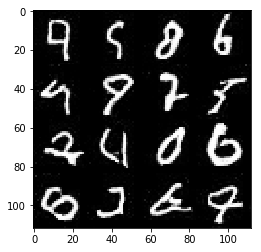

Epoch 19/25...progress:65.10%....step:610/937... Discriminator Loss: 1.5546... Generator Loss: 0.5441
Epoch 19/25...progress:66.17%....step:620/937... Discriminator Loss: 1.4704... Generator Loss: 0.6239
Epoch 19/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8479... Generator Loss: 1.3329
Epoch 19/25...progress:68.30%....step:640/937... Discriminator Loss: 1.0352... Generator Loss: 1.0285
Epoch 19/25...progress:69.37%....step:650/937... Discriminator Loss: 0.8834... Generator Loss: 1.6169
Epoch 19/25...progress:70.44%....step:660/937... Discriminator Loss: 0.7313... Generator Loss: 1.7388
Epoch 19/25...progress:71.50%....step:670/937... Discriminator Loss: 2.5670... Generator Loss: 4.7032
Epoch 19/25...progress:72.57%....step:680/937... Discriminator Loss: 1.4604... Generator Loss: 3.3796
Epoch 19/25...progress:73.64%....step:690/937... Discriminator Loss: 1.0062... Generator Loss: 0.9427
Epoch 19/25...progress:74.71%....step:700/937... Discriminator Loss: 1.8123... Gen

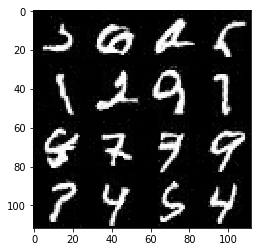

Epoch 19/25...progress:86.45%....step:810/937... Discriminator Loss: 1.9987... Generator Loss: 0.3640
Epoch 19/25...progress:87.51%....step:820/937... Discriminator Loss: 1.5174... Generator Loss: 0.5979
Epoch 19/25...progress:88.58%....step:830/937... Discriminator Loss: 0.7467... Generator Loss: 1.6411
Epoch 19/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9427... Generator Loss: 0.4151
Epoch 19/25...progress:90.72%....step:850/937... Discriminator Loss: 0.8047... Generator Loss: 1.4402
Epoch 19/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5898... Generator Loss: 1.9088
Epoch 19/25...progress:92.85%....step:870/937... Discriminator Loss: 1.2074... Generator Loss: 0.7112
Epoch 19/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8173... Generator Loss: 1.3129
Epoch 19/25...progress:94.98%....step:890/937... Discriminator Loss: 1.7760... Generator Loss: 0.4079
Epoch 19/25...progress:96.05%....step:900/937... Discriminator Loss: 1.0384... Gen

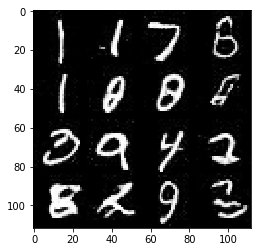

Epoch 20/25...progress:1.07%....step:10/937... Discriminator Loss: 0.8963... Generator Loss: 1.0235
Epoch 20/25...progress:2.13%....step:20/937... Discriminator Loss: 1.2232... Generator Loss: 0.6834
Epoch 20/25...progress:3.20%....step:30/937... Discriminator Loss: 0.8899... Generator Loss: 1.1455
Epoch 20/25...progress:4.27%....step:40/937... Discriminator Loss: 1.5187... Generator Loss: 0.5508
Epoch 20/25...progress:5.34%....step:50/937... Discriminator Loss: 2.0656... Generator Loss: 0.2812
Epoch 20/25...progress:6.40%....step:60/937... Discriminator Loss: 3.5688... Generator Loss: 0.0942
Epoch 20/25...progress:7.47%....step:70/937... Discriminator Loss: 1.3697... Generator Loss: 0.6533
Epoch 20/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7441... Generator Loss: 1.6045
Epoch 20/25...progress:9.61%....step:90/937... Discriminator Loss: 1.4356... Generator Loss: 0.5813
Epoch 20/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8329... Generator Loss: 1.700

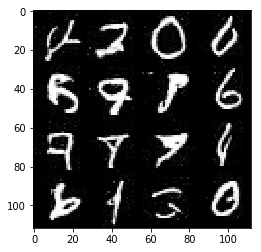

Epoch 20/25...progress:22.41%....step:210/937... Discriminator Loss: 0.8288... Generator Loss: 1.2784
Epoch 20/25...progress:23.48%....step:220/937... Discriminator Loss: 0.9612... Generator Loss: 0.9603
Epoch 20/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8937... Generator Loss: 1.1045
Epoch 20/25...progress:25.61%....step:240/937... Discriminator Loss: 1.2448... Generator Loss: 0.6753
Epoch 20/25...progress:26.68%....step:250/937... Discriminator Loss: 2.2518... Generator Loss: 0.3364
Epoch 20/25...progress:27.75%....step:260/937... Discriminator Loss: 1.4535... Generator Loss: 0.6094
Epoch 20/25...progress:28.82%....step:270/937... Discriminator Loss: 0.9068... Generator Loss: 2.4621
Epoch 20/25...progress:29.88%....step:280/937... Discriminator Loss: 0.7633... Generator Loss: 1.8767
Epoch 20/25...progress:30.95%....step:290/937... Discriminator Loss: 1.3755... Generator Loss: 0.6381
Epoch 20/25...progress:32.02%....step:300/937... Discriminator Loss: 1.2332... Gen

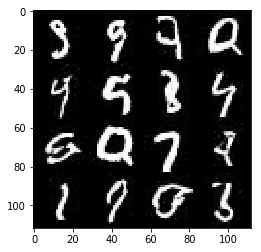

Epoch 20/25...progress:43.76%....step:410/937... Discriminator Loss: 1.0156... Generator Loss: 0.8739
Epoch 20/25...progress:44.82%....step:420/937... Discriminator Loss: 0.5500... Generator Loss: 2.0596
Epoch 20/25...progress:45.89%....step:430/937... Discriminator Loss: 0.7956... Generator Loss: 1.2704
Epoch 20/25...progress:46.96%....step:440/937... Discriminator Loss: 1.2673... Generator Loss: 0.7095
Epoch 20/25...progress:48.03%....step:450/937... Discriminator Loss: 1.0418... Generator Loss: 0.9651
Epoch 20/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7792... Generator Loss: 1.4390
Epoch 20/25...progress:50.16%....step:470/937... Discriminator Loss: 1.4337... Generator Loss: 0.5752
Epoch 20/25...progress:51.23%....step:480/937... Discriminator Loss: 0.6836... Generator Loss: 1.6667
Epoch 20/25...progress:52.29%....step:490/937... Discriminator Loss: 0.7422... Generator Loss: 1.4729
Epoch 20/25...progress:53.36%....step:500/937... Discriminator Loss: 0.7021... Gen

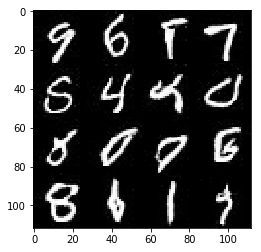

Epoch 20/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8151... Generator Loss: 1.2515
Epoch 20/25...progress:66.17%....step:620/937... Discriminator Loss: 1.2765... Generator Loss: 0.7237
Epoch 20/25...progress:67.24%....step:630/937... Discriminator Loss: 1.3206... Generator Loss: 0.7424
Epoch 20/25...progress:68.30%....step:640/937... Discriminator Loss: 1.8018... Generator Loss: 0.4365
Epoch 20/25...progress:69.37%....step:650/937... Discriminator Loss: 1.0322... Generator Loss: 1.8897
Epoch 20/25...progress:70.44%....step:660/937... Discriminator Loss: 1.3207... Generator Loss: 0.6968
Epoch 20/25...progress:71.50%....step:670/937... Discriminator Loss: 1.2197... Generator Loss: 3.1841
Epoch 20/25...progress:72.57%....step:680/937... Discriminator Loss: 0.8406... Generator Loss: 2.8908
Epoch 20/25...progress:73.64%....step:690/937... Discriminator Loss: 1.0381... Generator Loss: 0.9869
Epoch 20/25...progress:74.71%....step:700/937... Discriminator Loss: 1.9295... Gen

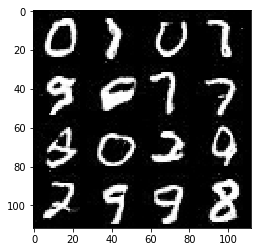

Epoch 20/25...progress:86.45%....step:810/937... Discriminator Loss: 1.4305... Generator Loss: 0.7152
Epoch 20/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8666... Generator Loss: 1.1364
Epoch 20/25...progress:88.58%....step:830/937... Discriminator Loss: 0.9518... Generator Loss: 1.0717
Epoch 20/25...progress:89.65%....step:840/937... Discriminator Loss: 1.9849... Generator Loss: 0.4053
Epoch 20/25...progress:90.72%....step:850/937... Discriminator Loss: 0.6948... Generator Loss: 1.5956
Epoch 20/25...progress:91.78%....step:860/937... Discriminator Loss: 0.5535... Generator Loss: 2.1464
Epoch 20/25...progress:92.85%....step:870/937... Discriminator Loss: 1.5190... Generator Loss: 0.6092
Epoch 20/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7653... Generator Loss: 1.3967
Epoch 20/25...progress:94.98%....step:890/937... Discriminator Loss: 1.3888... Generator Loss: 0.5884
Epoch 20/25...progress:96.05%....step:900/937... Discriminator Loss: 0.9514... Gen

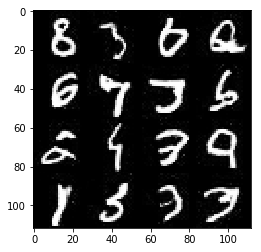

Epoch 21/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9618... Generator Loss: 1.0445
Epoch 21/25...progress:2.13%....step:20/937... Discriminator Loss: 1.7444... Generator Loss: 0.4195
Epoch 21/25...progress:3.20%....step:30/937... Discriminator Loss: 0.8185... Generator Loss: 1.2541
Epoch 21/25...progress:4.27%....step:40/937... Discriminator Loss: 0.7882... Generator Loss: 1.2946
Epoch 21/25...progress:5.34%....step:50/937... Discriminator Loss: 0.8925... Generator Loss: 1.8151
Epoch 21/25...progress:6.40%....step:60/937... Discriminator Loss: 1.3782... Generator Loss: 0.6277
Epoch 21/25...progress:7.47%....step:70/937... Discriminator Loss: 2.1265... Generator Loss: 0.3274
Epoch 21/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8342... Generator Loss: 1.3806
Epoch 21/25...progress:9.61%....step:90/937... Discriminator Loss: 1.3710... Generator Loss: 0.6038
Epoch 21/25...progress:10.67%....step:100/937... Discriminator Loss: 0.9551... Generator Loss: 1.014

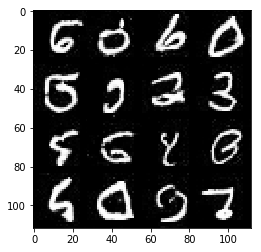

Epoch 21/25...progress:22.41%....step:210/937... Discriminator Loss: 1.2866... Generator Loss: 0.8055
Epoch 21/25...progress:23.48%....step:220/937... Discriminator Loss: 0.8193... Generator Loss: 1.2966
Epoch 21/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8561... Generator Loss: 2.6578
Epoch 21/25...progress:25.61%....step:240/937... Discriminator Loss: 1.5963... Generator Loss: 0.4445
Epoch 21/25...progress:26.68%....step:250/937... Discriminator Loss: 2.5806... Generator Loss: 0.2533
Epoch 21/25...progress:27.75%....step:260/937... Discriminator Loss: 2.0582... Generator Loss: 0.3587
Epoch 21/25...progress:28.82%....step:270/937... Discriminator Loss: 0.7610... Generator Loss: 1.3120
Epoch 21/25...progress:29.88%....step:280/937... Discriminator Loss: 0.6042... Generator Loss: 2.5494
Epoch 21/25...progress:30.95%....step:290/937... Discriminator Loss: 1.0029... Generator Loss: 0.9779
Epoch 21/25...progress:32.02%....step:300/937... Discriminator Loss: 2.0881... Gen

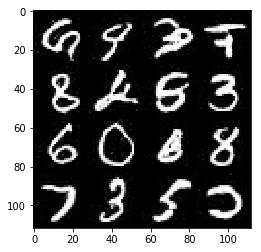

Epoch 21/25...progress:43.76%....step:410/937... Discriminator Loss: 1.1208... Generator Loss: 0.8009
Epoch 21/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6983... Generator Loss: 1.5554
Epoch 21/25...progress:45.89%....step:430/937... Discriminator Loss: 1.1592... Generator Loss: 0.7711
Epoch 21/25...progress:46.96%....step:440/937... Discriminator Loss: 1.2904... Generator Loss: 0.6175
Epoch 21/25...progress:48.03%....step:450/937... Discriminator Loss: 1.1254... Generator Loss: 0.8439
Epoch 21/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7947... Generator Loss: 1.4889
Epoch 21/25...progress:50.16%....step:470/937... Discriminator Loss: 0.7168... Generator Loss: 2.1560
Epoch 21/25...progress:51.23%....step:480/937... Discriminator Loss: 0.9117... Generator Loss: 3.1791
Epoch 21/25...progress:52.29%....step:490/937... Discriminator Loss: 1.0500... Generator Loss: 2.6479
Epoch 21/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8345... Gen

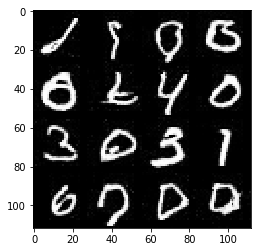

Epoch 21/25...progress:65.10%....step:610/937... Discriminator Loss: 0.9858... Generator Loss: 0.9714
Epoch 21/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0349... Generator Loss: 0.9837
Epoch 21/25...progress:67.24%....step:630/937... Discriminator Loss: 1.0744... Generator Loss: 0.9097
Epoch 21/25...progress:68.30%....step:640/937... Discriminator Loss: 0.9878... Generator Loss: 0.9500
Epoch 21/25...progress:69.37%....step:650/937... Discriminator Loss: 0.7455... Generator Loss: 1.4239
Epoch 21/25...progress:70.44%....step:660/937... Discriminator Loss: 1.0086... Generator Loss: 1.0465
Epoch 21/25...progress:71.50%....step:670/937... Discriminator Loss: 2.8085... Generator Loss: 0.2224
Epoch 21/25...progress:72.57%....step:680/937... Discriminator Loss: 1.2664... Generator Loss: 0.7047
Epoch 21/25...progress:73.64%....step:690/937... Discriminator Loss: 0.9406... Generator Loss: 1.9599
Epoch 21/25...progress:74.71%....step:700/937... Discriminator Loss: 0.9412... Gen

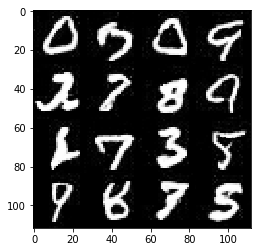

Epoch 21/25...progress:86.45%....step:810/937... Discriminator Loss: 0.8861... Generator Loss: 1.1339
Epoch 21/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9345... Generator Loss: 1.0458
Epoch 21/25...progress:88.58%....step:830/937... Discriminator Loss: 0.8689... Generator Loss: 1.2710
Epoch 21/25...progress:89.65%....step:840/937... Discriminator Loss: 2.4482... Generator Loss: 0.2703
Epoch 21/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7169... Generator Loss: 1.4878
Epoch 21/25...progress:91.78%....step:860/937... Discriminator Loss: 1.1152... Generator Loss: 1.1037
Epoch 21/25...progress:92.85%....step:870/937... Discriminator Loss: 0.6056... Generator Loss: 2.3939
Epoch 21/25...progress:93.92%....step:880/937... Discriminator Loss: 0.6439... Generator Loss: 1.8645
Epoch 21/25...progress:94.98%....step:890/937... Discriminator Loss: 0.9346... Generator Loss: 1.0585
Epoch 21/25...progress:96.05%....step:900/937... Discriminator Loss: 0.7774... Gen

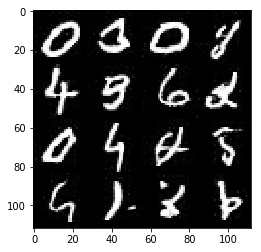

Epoch 22/25...progress:1.07%....step:10/937... Discriminator Loss: 1.1155... Generator Loss: 0.9370
Epoch 22/25...progress:2.13%....step:20/937... Discriminator Loss: 1.3850... Generator Loss: 0.6478
Epoch 22/25...progress:3.20%....step:30/937... Discriminator Loss: 1.3372... Generator Loss: 0.8064
Epoch 22/25...progress:4.27%....step:40/937... Discriminator Loss: 0.8621... Generator Loss: 1.2066
Epoch 22/25...progress:5.34%....step:50/937... Discriminator Loss: 2.0456... Generator Loss: 0.2967
Epoch 22/25...progress:6.40%....step:60/937... Discriminator Loss: 2.0210... Generator Loss: 0.3292
Epoch 22/25...progress:7.47%....step:70/937... Discriminator Loss: 1.4761... Generator Loss: 0.5832
Epoch 22/25...progress:8.54%....step:80/937... Discriminator Loss: 0.6701... Generator Loss: 1.6467
Epoch 22/25...progress:9.61%....step:90/937... Discriminator Loss: 1.5501... Generator Loss: 0.5219
Epoch 22/25...progress:10.67%....step:100/937... Discriminator Loss: 0.7993... Generator Loss: 1.306

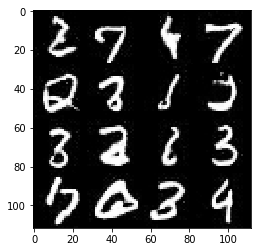

Epoch 22/25...progress:22.41%....step:210/937... Discriminator Loss: 0.7835... Generator Loss: 1.2794
Epoch 22/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6718... Generator Loss: 1.6380
Epoch 22/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6132... Generator Loss: 2.5598
Epoch 22/25...progress:25.61%....step:240/937... Discriminator Loss: 0.8464... Generator Loss: 1.4621
Epoch 22/25...progress:26.68%....step:250/937... Discriminator Loss: 1.5529... Generator Loss: 0.5178
Epoch 22/25...progress:27.75%....step:260/937... Discriminator Loss: 1.5599... Generator Loss: 0.4673
Epoch 22/25...progress:28.82%....step:270/937... Discriminator Loss: 0.6680... Generator Loss: 1.8569
Epoch 22/25...progress:29.88%....step:280/937... Discriminator Loss: 0.6963... Generator Loss: 2.0341
Epoch 22/25...progress:30.95%....step:290/937... Discriminator Loss: 1.5833... Generator Loss: 0.5577
Epoch 22/25...progress:32.02%....step:300/937... Discriminator Loss: 0.7632... Gen

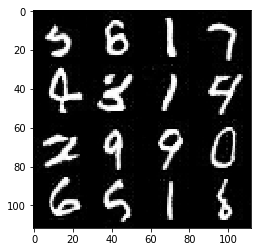

Epoch 22/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8842... Generator Loss: 1.2218
Epoch 22/25...progress:44.82%....step:420/937... Discriminator Loss: 0.6068... Generator Loss: 1.8280
Epoch 22/25...progress:45.89%....step:430/937... Discriminator Loss: 0.7854... Generator Loss: 1.4131
Epoch 22/25...progress:46.96%....step:440/937... Discriminator Loss: 1.0565... Generator Loss: 0.8675
Epoch 22/25...progress:48.03%....step:450/937... Discriminator Loss: 0.7190... Generator Loss: 1.4486
Epoch 22/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7942... Generator Loss: 1.2614
Epoch 22/25...progress:50.16%....step:470/937... Discriminator Loss: 2.6161... Generator Loss: 0.2184
Epoch 22/25...progress:51.23%....step:480/937... Discriminator Loss: 2.4198... Generator Loss: 0.3469
Epoch 22/25...progress:52.29%....step:490/937... Discriminator Loss: 1.6537... Generator Loss: 0.4421
Epoch 22/25...progress:53.36%....step:500/937... Discriminator Loss: 0.8341... Gen

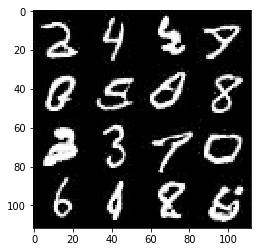

Epoch 22/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8830... Generator Loss: 1.0939
Epoch 22/25...progress:66.17%....step:620/937... Discriminator Loss: 0.9349... Generator Loss: 1.1223
Epoch 22/25...progress:67.24%....step:630/937... Discriminator Loss: 0.8835... Generator Loss: 1.1413
Epoch 22/25...progress:68.30%....step:640/937... Discriminator Loss: 1.0186... Generator Loss: 0.9530
Epoch 22/25...progress:69.37%....step:650/937... Discriminator Loss: 0.6791... Generator Loss: 2.4609
Epoch 22/25...progress:70.44%....step:660/937... Discriminator Loss: 1.3509... Generator Loss: 0.7628
Epoch 22/25...progress:71.50%....step:670/937... Discriminator Loss: 0.7941... Generator Loss: 1.2755
Epoch 22/25...progress:72.57%....step:680/937... Discriminator Loss: 2.1989... Generator Loss: 5.1190
Epoch 22/25...progress:73.64%....step:690/937... Discriminator Loss: 1.5535... Generator Loss: 0.5198
Epoch 22/25...progress:74.71%....step:700/937... Discriminator Loss: 1.7866... Gen

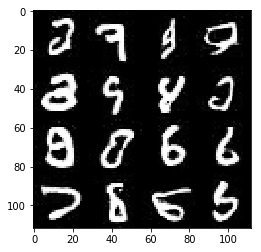

Epoch 22/25...progress:86.45%....step:810/937... Discriminator Loss: 1.7788... Generator Loss: 0.4219
Epoch 22/25...progress:87.51%....step:820/937... Discriminator Loss: 1.1009... Generator Loss: 0.8332
Epoch 22/25...progress:88.58%....step:830/937... Discriminator Loss: 0.8297... Generator Loss: 2.3921
Epoch 22/25...progress:89.65%....step:840/937... Discriminator Loss: 2.2870... Generator Loss: 0.2847
Epoch 22/25...progress:90.72%....step:850/937... Discriminator Loss: 0.8822... Generator Loss: 1.2054
Epoch 22/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6141... Generator Loss: 1.8600
Epoch 22/25...progress:92.85%....step:870/937... Discriminator Loss: 1.1039... Generator Loss: 0.8256
Epoch 22/25...progress:93.92%....step:880/937... Discriminator Loss: 0.8717... Generator Loss: 1.0872
Epoch 22/25...progress:94.98%....step:890/937... Discriminator Loss: 0.7142... Generator Loss: 2.0681
Epoch 22/25...progress:96.05%....step:900/937... Discriminator Loss: 0.6852... Gen

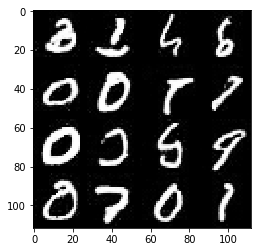

Epoch 23/25...progress:1.07%....step:10/937... Discriminator Loss: 0.6662... Generator Loss: 2.1556
Epoch 23/25...progress:2.13%....step:20/937... Discriminator Loss: 2.2379... Generator Loss: 0.2868
Epoch 23/25...progress:3.20%....step:30/937... Discriminator Loss: 0.7874... Generator Loss: 1.7133
Epoch 23/25...progress:4.27%....step:40/937... Discriminator Loss: 0.9041... Generator Loss: 1.0721
Epoch 23/25...progress:5.34%....step:50/937... Discriminator Loss: 1.9365... Generator Loss: 0.3446
Epoch 23/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0963... Generator Loss: 0.8633
Epoch 23/25...progress:7.47%....step:70/937... Discriminator Loss: 1.2449... Generator Loss: 0.7036
Epoch 23/25...progress:8.54%....step:80/937... Discriminator Loss: 0.7849... Generator Loss: 1.3446
Epoch 23/25...progress:9.61%....step:90/937... Discriminator Loss: 1.1315... Generator Loss: 0.8345
Epoch 23/25...progress:10.67%....step:100/937... Discriminator Loss: 0.7993... Generator Loss: 1.405

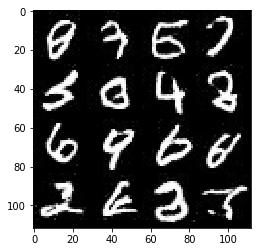

Epoch 23/25...progress:22.41%....step:210/937... Discriminator Loss: 1.0910... Generator Loss: 0.8710
Epoch 23/25...progress:23.48%....step:220/937... Discriminator Loss: 0.6797... Generator Loss: 1.6021
Epoch 23/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6612... Generator Loss: 1.6797
Epoch 23/25...progress:25.61%....step:240/937... Discriminator Loss: 0.7427... Generator Loss: 1.6339
Epoch 23/25...progress:26.68%....step:250/937... Discriminator Loss: 0.7871... Generator Loss: 1.3311
Epoch 23/25...progress:27.75%....step:260/937... Discriminator Loss: 1.1879... Generator Loss: 0.7535
Epoch 23/25...progress:28.82%....step:270/937... Discriminator Loss: 0.6731... Generator Loss: 1.6433
Epoch 23/25...progress:29.88%....step:280/937... Discriminator Loss: 0.8487... Generator Loss: 2.4625
Epoch 23/25...progress:30.95%....step:290/937... Discriminator Loss: 0.7920... Generator Loss: 1.3576
Epoch 23/25...progress:32.02%....step:300/937... Discriminator Loss: 0.9782... Gen

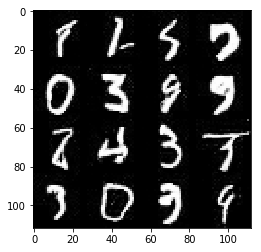

Epoch 23/25...progress:43.76%....step:410/937... Discriminator Loss: 0.7254... Generator Loss: 1.5088
Epoch 23/25...progress:44.82%....step:420/937... Discriminator Loss: 1.5028... Generator Loss: 0.6248
Epoch 23/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8143... Generator Loss: 1.5127
Epoch 23/25...progress:46.96%....step:440/937... Discriminator Loss: 1.3303... Generator Loss: 0.7035
Epoch 23/25...progress:48.03%....step:450/937... Discriminator Loss: 1.3626... Generator Loss: 0.6376
Epoch 23/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7541... Generator Loss: 1.3682
Epoch 23/25...progress:50.16%....step:470/937... Discriminator Loss: 1.9068... Generator Loss: 0.4148
Epoch 23/25...progress:51.23%....step:480/937... Discriminator Loss: 0.8441... Generator Loss: 1.1669
Epoch 23/25...progress:52.29%....step:490/937... Discriminator Loss: 1.2086... Generator Loss: 0.7236
Epoch 23/25...progress:53.36%....step:500/937... Discriminator Loss: 0.6892... Gen

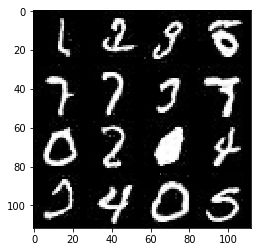

Epoch 23/25...progress:65.10%....step:610/937... Discriminator Loss: 0.8499... Generator Loss: 1.2447
Epoch 23/25...progress:66.17%....step:620/937... Discriminator Loss: 1.1013... Generator Loss: 0.8487
Epoch 23/25...progress:67.24%....step:630/937... Discriminator Loss: 1.3742... Generator Loss: 0.6922
Epoch 23/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8250... Generator Loss: 1.4354
Epoch 23/25...progress:69.37%....step:650/937... Discriminator Loss: 1.0768... Generator Loss: 2.2001
Epoch 23/25...progress:70.44%....step:660/937... Discriminator Loss: 1.5555... Generator Loss: 0.6392
Epoch 23/25...progress:71.50%....step:670/937... Discriminator Loss: 1.0164... Generator Loss: 3.0658
Epoch 23/25...progress:72.57%....step:680/937... Discriminator Loss: 0.9583... Generator Loss: 3.1823
Epoch 23/25...progress:73.64%....step:690/937... Discriminator Loss: 1.5893... Generator Loss: 0.5969
Epoch 23/25...progress:74.71%....step:700/937... Discriminator Loss: 2.5028... Gen

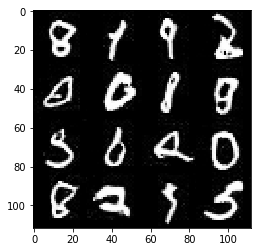

Epoch 23/25...progress:86.45%....step:810/937... Discriminator Loss: 1.5857... Generator Loss: 0.5741
Epoch 23/25...progress:87.51%....step:820/937... Discriminator Loss: 1.1430... Generator Loss: 0.8308
Epoch 23/25...progress:88.58%....step:830/937... Discriminator Loss: 0.7294... Generator Loss: 1.5517
Epoch 23/25...progress:89.65%....step:840/937... Discriminator Loss: 2.8111... Generator Loss: 0.1961
Epoch 23/25...progress:90.72%....step:850/937... Discriminator Loss: 0.8116... Generator Loss: 1.3012
Epoch 23/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6326... Generator Loss: 1.7241
Epoch 23/25...progress:92.85%....step:870/937... Discriminator Loss: 0.7283... Generator Loss: 1.5428
Epoch 23/25...progress:93.92%....step:880/937... Discriminator Loss: 1.2640... Generator Loss: 0.7037
Epoch 23/25...progress:94.98%....step:890/937... Discriminator Loss: 1.9262... Generator Loss: 0.3813
Epoch 23/25...progress:96.05%....step:900/937... Discriminator Loss: 1.1207... Gen

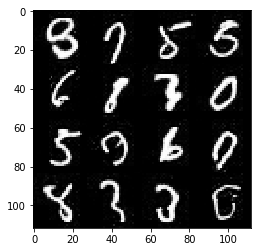

Epoch 24/25...progress:1.07%....step:10/937... Discriminator Loss: 0.7235... Generator Loss: 2.0469
Epoch 24/25...progress:2.13%....step:20/937... Discriminator Loss: 1.9833... Generator Loss: 0.3706
Epoch 24/25...progress:3.20%....step:30/937... Discriminator Loss: 0.9311... Generator Loss: 1.1276
Epoch 24/25...progress:4.27%....step:40/937... Discriminator Loss: 1.3462... Generator Loss: 0.6104
Epoch 24/25...progress:5.34%....step:50/937... Discriminator Loss: 1.2530... Generator Loss: 0.7877
Epoch 24/25...progress:6.40%....step:60/937... Discriminator Loss: 0.7374... Generator Loss: 1.6160
Epoch 24/25...progress:7.47%....step:70/937... Discriminator Loss: 1.0015... Generator Loss: 1.0012
Epoch 24/25...progress:8.54%....step:80/937... Discriminator Loss: 0.8937... Generator Loss: 1.2136
Epoch 24/25...progress:9.61%....step:90/937... Discriminator Loss: 0.9132... Generator Loss: 1.1820
Epoch 24/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8896... Generator Loss: 1.160

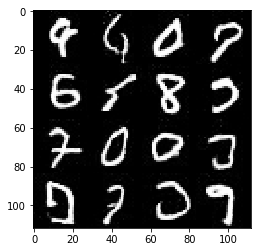

Epoch 24/25...progress:22.41%....step:210/937... Discriminator Loss: 0.8291... Generator Loss: 1.2125
Epoch 24/25...progress:23.48%....step:220/937... Discriminator Loss: 1.2311... Generator Loss: 0.7251
Epoch 24/25...progress:24.55%....step:230/937... Discriminator Loss: 0.8966... Generator Loss: 1.0790
Epoch 24/25...progress:25.61%....step:240/937... Discriminator Loss: 1.0998... Generator Loss: 0.8560
Epoch 24/25...progress:26.68%....step:250/937... Discriminator Loss: 1.1163... Generator Loss: 0.8075
Epoch 24/25...progress:27.75%....step:260/937... Discriminator Loss: 1.5281... Generator Loss: 0.5101
Epoch 24/25...progress:28.82%....step:270/937... Discriminator Loss: 0.9168... Generator Loss: 1.0984
Epoch 24/25...progress:29.88%....step:280/937... Discriminator Loss: 1.7091... Generator Loss: 3.9878
Epoch 24/25...progress:30.95%....step:290/937... Discriminator Loss: 0.8860... Generator Loss: 1.1650
Epoch 24/25...progress:32.02%....step:300/937... Discriminator Loss: 1.0502... Gen

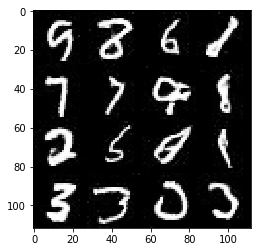

Epoch 24/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8964... Generator Loss: 1.1967
Epoch 24/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7759... Generator Loss: 1.5335
Epoch 24/25...progress:45.89%....step:430/937... Discriminator Loss: 0.8647... Generator Loss: 1.2045
Epoch 24/25...progress:46.96%....step:440/937... Discriminator Loss: 0.8905... Generator Loss: 1.2953
Epoch 24/25...progress:48.03%....step:450/937... Discriminator Loss: 1.3774... Generator Loss: 0.6759
Epoch 24/25...progress:49.09%....step:460/937... Discriminator Loss: 1.0480... Generator Loss: 0.9464
Epoch 24/25...progress:50.16%....step:470/937... Discriminator Loss: 1.1866... Generator Loss: 0.7944
Epoch 24/25...progress:51.23%....step:480/937... Discriminator Loss: 1.3752... Generator Loss: 0.6836
Epoch 24/25...progress:52.29%....step:490/937... Discriminator Loss: 0.8173... Generator Loss: 1.5655
Epoch 24/25...progress:53.36%....step:500/937... Discriminator Loss: 0.7513... Gen

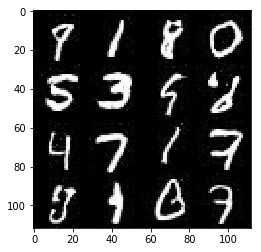

Epoch 24/25...progress:65.10%....step:610/937... Discriminator Loss: 0.7530... Generator Loss: 1.4176
Epoch 24/25...progress:66.17%....step:620/937... Discriminator Loss: 0.9872... Generator Loss: 0.9384
Epoch 24/25...progress:67.24%....step:630/937... Discriminator Loss: 0.7171... Generator Loss: 1.8699
Epoch 24/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8855... Generator Loss: 1.1166
Epoch 24/25...progress:69.37%....step:650/937... Discriminator Loss: 0.9547... Generator Loss: 2.8932
Epoch 24/25...progress:70.44%....step:660/937... Discriminator Loss: 1.0134... Generator Loss: 0.9042
Epoch 24/25...progress:71.50%....step:670/937... Discriminator Loss: 1.2985... Generator Loss: 3.5323
Epoch 24/25...progress:72.57%....step:680/937... Discriminator Loss: 1.3669... Generator Loss: 4.0542
Epoch 24/25...progress:73.64%....step:690/937... Discriminator Loss: 0.9343... Generator Loss: 1.0047
Epoch 24/25...progress:74.71%....step:700/937... Discriminator Loss: 1.6098... Gen

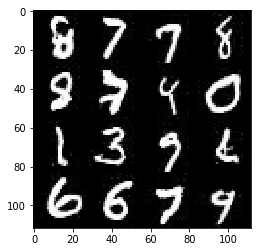

Epoch 24/25...progress:86.45%....step:810/937... Discriminator Loss: 0.7626... Generator Loss: 1.4728
Epoch 24/25...progress:87.51%....step:820/937... Discriminator Loss: 0.8939... Generator Loss: 1.1061
Epoch 24/25...progress:88.58%....step:830/937... Discriminator Loss: 1.2309... Generator Loss: 0.8726
Epoch 24/25...progress:89.65%....step:840/937... Discriminator Loss: 2.4990... Generator Loss: 0.2339
Epoch 24/25...progress:90.72%....step:850/937... Discriminator Loss: 0.7664... Generator Loss: 1.4265
Epoch 24/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6781... Generator Loss: 1.6128
Epoch 24/25...progress:92.85%....step:870/937... Discriminator Loss: 0.7220... Generator Loss: 2.0546
Epoch 24/25...progress:93.92%....step:880/937... Discriminator Loss: 0.9551... Generator Loss: 1.0575
Epoch 24/25...progress:94.98%....step:890/937... Discriminator Loss: 1.4291... Generator Loss: 0.5860
Epoch 24/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2046... Gen

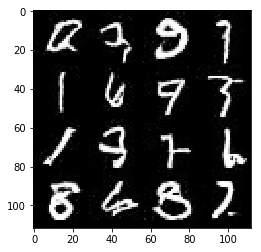

Epoch 25/25...progress:1.07%....step:10/937... Discriminator Loss: 0.9415... Generator Loss: 2.3221
Epoch 25/25...progress:2.13%....step:20/937... Discriminator Loss: 1.2320... Generator Loss: 0.6936
Epoch 25/25...progress:3.20%....step:30/937... Discriminator Loss: 1.2332... Generator Loss: 0.7254
Epoch 25/25...progress:4.27%....step:40/937... Discriminator Loss: 1.0582... Generator Loss: 0.8847
Epoch 25/25...progress:5.34%....step:50/937... Discriminator Loss: 1.9591... Generator Loss: 0.3941
Epoch 25/25...progress:6.40%....step:60/937... Discriminator Loss: 1.0397... Generator Loss: 0.9365
Epoch 25/25...progress:7.47%....step:70/937... Discriminator Loss: 1.4533... Generator Loss: 0.6651
Epoch 25/25...progress:8.54%....step:80/937... Discriminator Loss: 0.9390... Generator Loss: 1.1690
Epoch 25/25...progress:9.61%....step:90/937... Discriminator Loss: 1.7308... Generator Loss: 0.4341
Epoch 25/25...progress:10.67%....step:100/937... Discriminator Loss: 0.8612... Generator Loss: 1.199

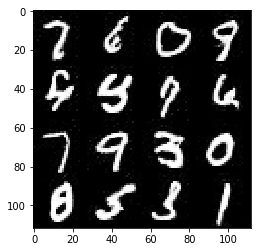

Epoch 25/25...progress:22.41%....step:210/937... Discriminator Loss: 1.3379... Generator Loss: 0.7001
Epoch 25/25...progress:23.48%....step:220/937... Discriminator Loss: 0.8720... Generator Loss: 1.0510
Epoch 25/25...progress:24.55%....step:230/937... Discriminator Loss: 0.6734... Generator Loss: 1.5600
Epoch 25/25...progress:25.61%....step:240/937... Discriminator Loss: 1.5211... Generator Loss: 0.5284
Epoch 25/25...progress:26.68%....step:250/937... Discriminator Loss: 2.5021... Generator Loss: 0.2746
Epoch 25/25...progress:27.75%....step:260/937... Discriminator Loss: 1.2037... Generator Loss: 0.7245
Epoch 25/25...progress:28.82%....step:270/937... Discriminator Loss: 1.4563... Generator Loss: 0.5758
Epoch 25/25...progress:29.88%....step:280/937... Discriminator Loss: 1.3392... Generator Loss: 3.4990
Epoch 25/25...progress:30.95%....step:290/937... Discriminator Loss: 0.8741... Generator Loss: 1.2639
Epoch 25/25...progress:32.02%....step:300/937... Discriminator Loss: 1.5986... Gen

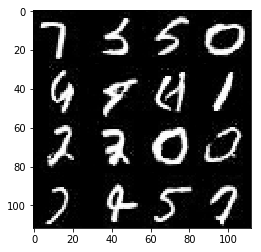

Epoch 25/25...progress:43.76%....step:410/937... Discriminator Loss: 0.8661... Generator Loss: 1.1755
Epoch 25/25...progress:44.82%....step:420/937... Discriminator Loss: 0.7544... Generator Loss: 1.4385
Epoch 25/25...progress:45.89%....step:430/937... Discriminator Loss: 1.4129... Generator Loss: 0.5926
Epoch 25/25...progress:46.96%....step:440/937... Discriminator Loss: 0.8961... Generator Loss: 1.0657
Epoch 25/25...progress:48.03%....step:450/937... Discriminator Loss: 0.8261... Generator Loss: 1.2812
Epoch 25/25...progress:49.09%....step:460/937... Discriminator Loss: 0.7821... Generator Loss: 1.4198
Epoch 25/25...progress:50.16%....step:470/937... Discriminator Loss: 0.6255... Generator Loss: 2.6003
Epoch 25/25...progress:51.23%....step:480/937... Discriminator Loss: 0.6847... Generator Loss: 2.3177
Epoch 25/25...progress:52.29%....step:490/937... Discriminator Loss: 0.9355... Generator Loss: 1.8782
Epoch 25/25...progress:53.36%....step:500/937... Discriminator Loss: 0.7468... Gen

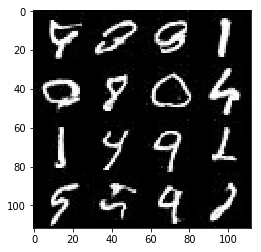

Epoch 25/25...progress:65.10%....step:610/937... Discriminator Loss: 1.5463... Generator Loss: 0.5794
Epoch 25/25...progress:66.17%....step:620/937... Discriminator Loss: 1.0170... Generator Loss: 0.8918
Epoch 25/25...progress:67.24%....step:630/937... Discriminator Loss: 1.1496... Generator Loss: 0.8238
Epoch 25/25...progress:68.30%....step:640/937... Discriminator Loss: 0.8244... Generator Loss: 1.2325
Epoch 25/25...progress:69.37%....step:650/937... Discriminator Loss: 0.9082... Generator Loss: 1.0663
Epoch 25/25...progress:70.44%....step:660/937... Discriminator Loss: 0.9346... Generator Loss: 1.0291
Epoch 25/25...progress:71.50%....step:670/937... Discriminator Loss: 2.3519... Generator Loss: 0.2385
Epoch 25/25...progress:72.57%....step:680/937... Discriminator Loss: 0.8173... Generator Loss: 1.3116
Epoch 25/25...progress:73.64%....step:690/937... Discriminator Loss: 1.6640... Generator Loss: 0.4153
Epoch 25/25...progress:74.71%....step:700/937... Discriminator Loss: 2.1092... Gen

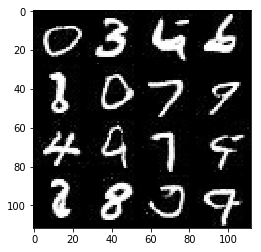

Epoch 25/25...progress:86.45%....step:810/937... Discriminator Loss: 2.5329... Generator Loss: 0.2157
Epoch 25/25...progress:87.51%....step:820/937... Discriminator Loss: 0.9522... Generator Loss: 1.0326
Epoch 25/25...progress:88.58%....step:830/937... Discriminator Loss: 0.5304... Generator Loss: 2.1934
Epoch 25/25...progress:89.65%....step:840/937... Discriminator Loss: 2.5519... Generator Loss: 0.2255
Epoch 25/25...progress:90.72%....step:850/937... Discriminator Loss: 0.8580... Generator Loss: 1.2079
Epoch 25/25...progress:91.78%....step:860/937... Discriminator Loss: 0.6187... Generator Loss: 1.7602
Epoch 25/25...progress:92.85%....step:870/937... Discriminator Loss: 0.6316... Generator Loss: 2.1800
Epoch 25/25...progress:93.92%....step:880/937... Discriminator Loss: 0.7696... Generator Loss: 2.7276
Epoch 25/25...progress:94.98%....step:890/937... Discriminator Loss: 1.7062... Generator Loss: 0.4304
Epoch 25/25...progress:96.05%....step:900/937... Discriminator Loss: 1.2658... Gen

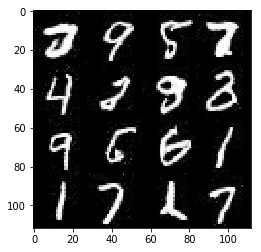

Last train discriminator Loss: 0.8983
Last train generator Loss: 1.0715


In [12]:
batch_size = 64
z_dim = 200
learning_rate = 0.0005
beta1 = 0.1
#epochs = 25



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

STARTING epoch: 0 , steps: 3780 ........
Epoch 1/25...progress:0.00%....step:0/3780... Discriminator Loss: 8.7570... Generator Loss: 0.0005


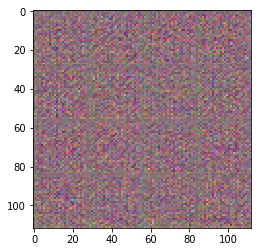

Epoch 1/25...progress:0.26%....step:10/3780... Discriminator Loss: 5.0758... Generator Loss: 0.0127
Epoch 1/25...progress:0.53%....step:20/3780... Discriminator Loss: 3.6278... Generator Loss: 0.0493
Epoch 1/25...progress:0.79%....step:30/3780... Discriminator Loss: 4.9574... Generator Loss: 0.0131
Epoch 1/25...progress:1.06%....step:40/3780... Discriminator Loss: 3.1103... Generator Loss: 0.0888
Epoch 1/25...progress:1.32%....step:50/3780... Discriminator Loss: 3.1505... Generator Loss: 0.0748
Epoch 1/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.1760... Generator Loss: 0.2407
Epoch 1/25...progress:1.85%....step:70/3780... Discriminator Loss: 0.9888... Generator Loss: 1.1586
Epoch 1/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.6730... Generator Loss: 1.4916
Epoch 1/25...progress:2.38%....step:90/3780... Discriminator Loss: 2.0094... Generator Loss: 3.3070
Epoch 1/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.5014... Generator Loss: 2.6742

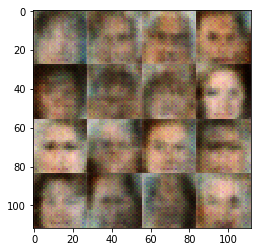

Epoch 1/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.7747... Generator Loss: 1.0451
Epoch 1/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.9540... Generator Loss: 1.6863
Epoch 1/25...progress:6.08%....step:230/3780... Discriminator Loss: 0.9758... Generator Loss: 1.9432
Epoch 1/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.0862... Generator Loss: 2.6369
Epoch 1/25...progress:6.61%....step:250/3780... Discriminator Loss: 0.6774... Generator Loss: 2.2326
Epoch 1/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.6624... Generator Loss: 2.1989
Epoch 1/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.2372... Generator Loss: 1.0685
Epoch 1/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7065... Generator Loss: 0.6369
Epoch 1/25...progress:7.67%....step:290/3780... Discriminator Loss: 0.8377... Generator Loss: 1.5820
Epoch 1/25...progress:7.94%....step:300/3780... Discriminator Loss: 0.8913... Generator Los

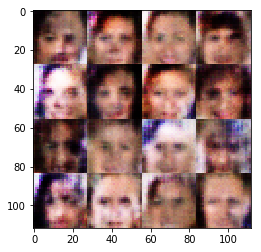

Epoch 1/25...progress:10.85%....step:410/3780... Discriminator Loss: 0.9440... Generator Loss: 2.3991
Epoch 1/25...progress:11.11%....step:420/3780... Discriminator Loss: 0.8168... Generator Loss: 2.0876
Epoch 1/25...progress:11.38%....step:430/3780... Discriminator Loss: 0.8455... Generator Loss: 1.0280
Epoch 1/25...progress:11.64%....step:440/3780... Discriminator Loss: 2.2358... Generator Loss: 0.1792
Epoch 1/25...progress:11.90%....step:450/3780... Discriminator Loss: 2.1000... Generator Loss: 0.2152
Epoch 1/25...progress:12.17%....step:460/3780... Discriminator Loss: 0.7925... Generator Loss: 1.4258
Epoch 1/25...progress:12.43%....step:470/3780... Discriminator Loss: 2.1785... Generator Loss: 1.2142
Epoch 1/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.8376... Generator Loss: 1.5873
Epoch 1/25...progress:12.96%....step:490/3780... Discriminator Loss: 0.8985... Generator Loss: 2.5251
Epoch 1/25...progress:13.23%....step:500/3780... Discriminator Loss: 0.8211... Gen

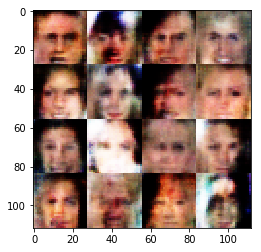

Epoch 1/25...progress:16.14%....step:610/3780... Discriminator Loss: 0.9234... Generator Loss: 2.4267
Epoch 1/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.8460... Generator Loss: 0.0922
Epoch 1/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.1839... Generator Loss: 0.6369
Epoch 1/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.6901... Generator Loss: 0.3321
Epoch 1/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.4853... Generator Loss: 0.4731
Epoch 1/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.7443... Generator Loss: 0.3586
Epoch 1/25...progress:17.72%....step:670/3780... Discriminator Loss: 0.9020... Generator Loss: 1.6566
Epoch 1/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.6857... Generator Loss: 1.4632
Epoch 1/25...progress:18.25%....step:690/3780... Discriminator Loss: 0.8633... Generator Loss: 1.7218
Epoch 1/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.8965... Gen

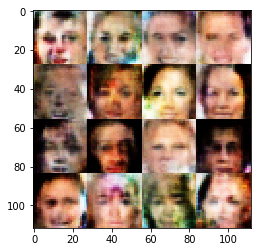

Epoch 1/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7853... Generator Loss: 0.3171
Epoch 1/25...progress:21.69%....step:820/3780... Discriminator Loss: 0.8858... Generator Loss: 1.0936
Epoch 1/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.6532... Generator Loss: 2.6104
Epoch 1/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.5463... Generator Loss: 1.3285
Epoch 1/25...progress:22.49%....step:850/3780... Discriminator Loss: 0.7612... Generator Loss: 1.4031
Epoch 1/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.6828... Generator Loss: 0.3768
Epoch 1/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.1383... Generator Loss: 2.6189
Epoch 1/25...progress:23.28%....step:880/3780... Discriminator Loss: 0.9578... Generator Loss: 1.2157
Epoch 1/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.1439... Generator Loss: 0.6777
Epoch 1/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.7220... Gen

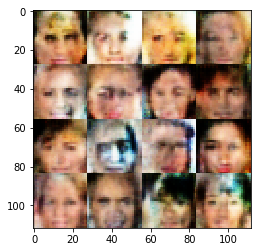

Epoch 1/25...progress:26.72%....step:1010/3780... Discriminator Loss: 0.8298... Generator Loss: 1.2450
Epoch 1/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.8139... Generator Loss: 0.2783
Epoch 1/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.8288... Generator Loss: 0.2788
Epoch 1/25...progress:27.51%....step:1040/3780... Discriminator Loss: 0.7185... Generator Loss: 1.2765
Epoch 1/25...progress:27.78%....step:1050/3780... Discriminator Loss: 0.7038... Generator Loss: 1.9092
Epoch 1/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.6458... Generator Loss: 0.3796
Epoch 1/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.6736... Generator Loss: 0.3247
Epoch 1/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.9654... Generator Loss: 0.8919
Epoch 1/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.9084... Generator Loss: 0.2589
Epoch 1/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.0

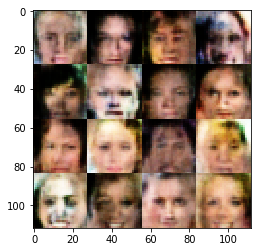

Epoch 1/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.1240... Generator Loss: 0.6717
Epoch 1/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.0239... Generator Loss: 1.1555
Epoch 1/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.6955... Generator Loss: 0.3233
Epoch 1/25...progress:32.80%....step:1240/3780... Discriminator Loss: 0.9675... Generator Loss: 1.3141
Epoch 1/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.6199... Generator Loss: 0.3793
Epoch 1/25...progress:33.33%....step:1260/3780... Discriminator Loss: 0.7565... Generator Loss: 1.3829
Epoch 1/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.6385... Generator Loss: 0.3699
Epoch 1/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.6718... Generator Loss: 0.3544
Epoch 1/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.4263... Generator Loss: 0.4690
Epoch 1/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.0

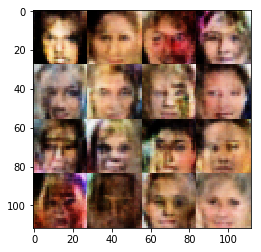

Epoch 1/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.1416... Generator Loss: 0.7930
Epoch 1/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2138... Generator Loss: 2.2894
Epoch 1/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.1276... Generator Loss: 1.3225
Epoch 1/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.7343... Generator Loss: 0.3159
Epoch 1/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.2907... Generator Loss: 0.7114
Epoch 1/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.5751... Generator Loss: 0.4393
Epoch 1/25...progress:38.89%....step:1470/3780... Discriminator Loss: 0.9115... Generator Loss: 1.4774
Epoch 1/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.2858... Generator Loss: 0.5638
Epoch 1/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2207... Generator Loss: 0.8748
Epoch 1/25...progress:39.68%....step:1500/3780... Discriminator Loss: 1.6

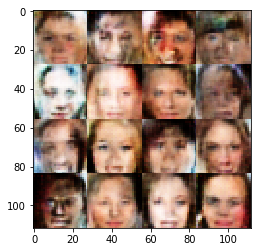

Epoch 1/25...progress:42.59%....step:1610/3780... Discriminator Loss: 0.9065... Generator Loss: 1.0810
Epoch 1/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.6616... Generator Loss: 0.3443
Epoch 1/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.6801... Generator Loss: 0.3365
Epoch 1/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.4040... Generator Loss: 0.4979
Epoch 1/25...progress:43.65%....step:1650/3780... Discriminator Loss: 0.9746... Generator Loss: 0.9584
Epoch 1/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.8837... Generator Loss: 0.2569
Epoch 1/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.9480... Generator Loss: 0.8874
Epoch 1/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.2285... Generator Loss: 1.1653
Epoch 1/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.5255... Generator Loss: 0.4187
Epoch 1/25...progress:44.97%....step:1700/3780... Discriminator Loss: 2.1

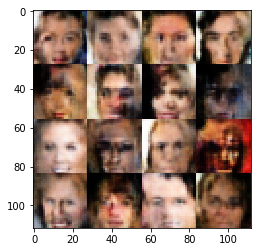

Epoch 1/25...progress:47.88%....step:1810/3780... Discriminator Loss: 0.7049... Generator Loss: 1.4238
Epoch 1/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8866... Generator Loss: 1.1862
Epoch 1/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.2584... Generator Loss: 2.7205
Epoch 1/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.2725... Generator Loss: 0.5823
Epoch 1/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.7580... Generator Loss: 1.3441
Epoch 1/25...progress:49.21%....step:1860/3780... Discriminator Loss: 0.9124... Generator Loss: 1.6883
Epoch 1/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.0951... Generator Loss: 1.0170
Epoch 1/25...progress:49.74%....step:1880/3780... Discriminator Loss: 0.9383... Generator Loss: 0.9902
Epoch 1/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6274... Generator Loss: 0.3580
Epoch 1/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.3

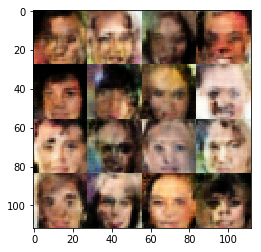

Epoch 1/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.4359... Generator Loss: 0.6565
Epoch 1/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.1647... Generator Loss: 1.3946
Epoch 1/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.0464... Generator Loss: 0.7825
Epoch 1/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.3728... Generator Loss: 1.1678
Epoch 1/25...progress:54.23%....step:2050/3780... Discriminator Loss: 0.8740... Generator Loss: 1.0488
Epoch 1/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.1429... Generator Loss: 1.1002
Epoch 1/25...progress:54.76%....step:2070/3780... Discriminator Loss: 2.3732... Generator Loss: 0.1631
Epoch 1/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.1409... Generator Loss: 1.2015
Epoch 1/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.1610... Generator Loss: 1.2168
Epoch 1/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.6

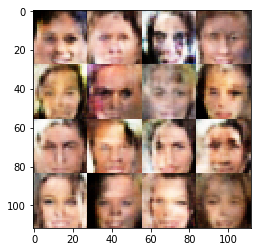

Epoch 1/25...progress:58.47%....step:2210/3780... Discriminator Loss: 1.5545... Generator Loss: 0.3852
Epoch 1/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.0398... Generator Loss: 1.6131
Epoch 1/25...progress:58.99%....step:2230/3780... Discriminator Loss: 0.8088... Generator Loss: 1.6782
Epoch 1/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.6802... Generator Loss: 0.3427
Epoch 1/25...progress:59.52%....step:2250/3780... Discriminator Loss: 0.8168... Generator Loss: 1.1785
Epoch 1/25...progress:59.79%....step:2260/3780... Discriminator Loss: 0.9325... Generator Loss: 1.0572
Epoch 1/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.3351... Generator Loss: 0.5158
Epoch 1/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.0731... Generator Loss: 1.5825
Epoch 1/25...progress:60.58%....step:2290/3780... Discriminator Loss: 0.8458... Generator Loss: 1.1201
Epoch 1/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.3

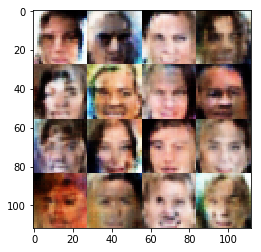

Epoch 1/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.4323... Generator Loss: 0.4368
Epoch 1/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.1978... Generator Loss: 0.6626
Epoch 1/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.8434... Generator Loss: 0.2807
Epoch 1/25...progress:64.55%....step:2440/3780... Discriminator Loss: 0.9832... Generator Loss: 1.1947
Epoch 1/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.6027... Generator Loss: 0.3717
Epoch 1/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.8778... Generator Loss: 0.2673
Epoch 1/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.7647... Generator Loss: 0.3194
Epoch 1/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.3556... Generator Loss: 0.4938
Epoch 1/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.2163... Generator Loss: 2.1694
Epoch 1/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.0

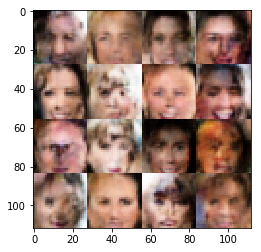

Epoch 1/25...progress:69.05%....step:2610/3780... Discriminator Loss: 0.9267... Generator Loss: 1.1001
Epoch 1/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5782... Generator Loss: 1.4438
Epoch 1/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.6740... Generator Loss: 0.3422
Epoch 1/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.0589... Generator Loss: 0.8236
Epoch 1/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.2071... Generator Loss: 0.5989
Epoch 1/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.0377... Generator Loss: 1.0792
Epoch 1/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.3159... Generator Loss: 1.0674
Epoch 1/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.5270... Generator Loss: 0.4232
Epoch 1/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.2550... Generator Loss: 1.3809
Epoch 1/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.1

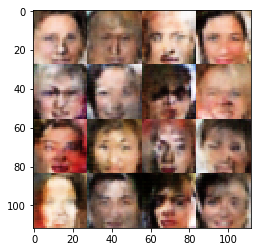

Epoch 1/25...progress:74.34%....step:2810/3780... Discriminator Loss: 0.7973... Generator Loss: 2.2050
Epoch 1/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.2525... Generator Loss: 1.0287
Epoch 1/25...progress:74.87%....step:2830/3780... Discriminator Loss: 0.7755... Generator Loss: 1.5544
Epoch 1/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.3942... Generator Loss: 0.5271
Epoch 1/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.7774... Generator Loss: 0.3216
Epoch 1/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.8022... Generator Loss: 0.2912
Epoch 1/25...progress:75.93%....step:2870/3780... Discriminator Loss: 0.8366... Generator Loss: 1.9166
Epoch 1/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.8509... Generator Loss: 0.2678
Epoch 1/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.5806... Generator Loss: 0.3915
Epoch 1/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.3

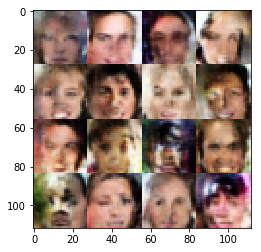

Epoch 1/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0983... Generator Loss: 0.7521
Epoch 1/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.8452... Generator Loss: 0.2724
Epoch 1/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.6560... Generator Loss: 0.3515
Epoch 1/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.4007... Generator Loss: 0.4638
Epoch 1/25...progress:80.69%....step:3050/3780... Discriminator Loss: 0.9555... Generator Loss: 0.8646
Epoch 1/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.2390... Generator Loss: 0.6640
Epoch 1/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.6473... Generator Loss: 0.3579
Epoch 1/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0703... Generator Loss: 0.2129
Epoch 1/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.2958... Generator Loss: 0.7577
Epoch 1/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.2

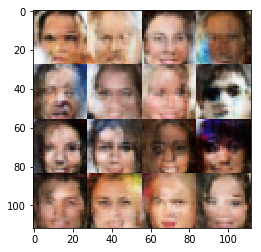

Epoch 1/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.7373... Generator Loss: 0.3131
Epoch 1/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.4090... Generator Loss: 0.7269
Epoch 1/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.2359... Generator Loss: 0.6438
Epoch 1/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.6292... Generator Loss: 0.3633
Epoch 1/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.6226... Generator Loss: 0.3646
Epoch 1/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.0794... Generator Loss: 0.8646
Epoch 1/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.1569... Generator Loss: 0.6813
Epoch 1/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.0168... Generator Loss: 1.4106
Epoch 1/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.5442... Generator Loss: 1.4495
Epoch 1/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.0

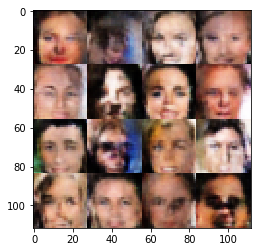

Epoch 1/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.1339... Generator Loss: 0.8136
Epoch 1/25...progress:90.48%....step:3420/3780... Discriminator Loss: 2.8555... Generator Loss: 0.0983
Epoch 1/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5157... Generator Loss: 0.4172
Epoch 1/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.2850... Generator Loss: 0.6061
Epoch 1/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.6271... Generator Loss: 0.3470
Epoch 1/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.0305... Generator Loss: 1.5341
Epoch 1/25...progress:91.80%....step:3470/3780... Discriminator Loss: 2.0293... Generator Loss: 0.2296
Epoch 1/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.2278... Generator Loss: 0.6871
Epoch 1/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.4176... Generator Loss: 1.0242
Epoch 1/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.2

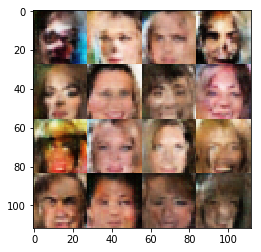

Epoch 1/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.1593... Generator Loss: 0.7673
Epoch 1/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.3646... Generator Loss: 0.5126
Epoch 1/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.7246... Generator Loss: 0.3419
Epoch 1/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.0972... Generator Loss: 0.8231
Epoch 1/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9184... Generator Loss: 0.9042
Epoch 1/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.4100... Generator Loss: 0.5256
Epoch 1/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.5640... Generator Loss: 0.1234
Epoch 1/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.0147... Generator Loss: 0.2371
Epoch 1/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.4945... Generator Loss: 0.4373
Epoch 1/25...progress:97.88%....step:3700/3780... Discriminator Loss: 1.3

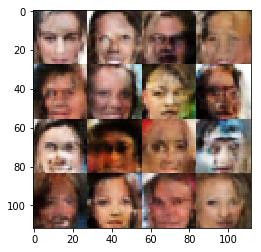

Epoch 2/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.6622... Generator Loss: 0.3370
Epoch 2/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.2314... Generator Loss: 0.1787
Epoch 2/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.3497... Generator Loss: 0.5220
Epoch 2/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.1824... Generator Loss: 0.6071
Epoch 2/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.5362... Generator Loss: 1.2777
Epoch 2/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.4095... Generator Loss: 0.6002
Epoch 2/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.3333... Generator Loss: 0.7799
Epoch 2/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.5861... Generator Loss: 0.3894
Epoch 2/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.0193... Generator Loss: 1.0632
Epoch 2/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.1142... Generator Loss: 1.0928

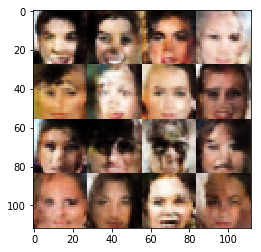

Epoch 2/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.8197... Generator Loss: 0.3185
Epoch 2/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.4837... Generator Loss: 0.4807
Epoch 2/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.1966... Generator Loss: 0.7361
Epoch 2/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.4888... Generator Loss: 0.4508
Epoch 2/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0108... Generator Loss: 0.8249
Epoch 2/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.4535... Generator Loss: 0.7597
Epoch 2/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.3072... Generator Loss: 0.5255
Epoch 2/25...progress:7.41%....step:280/3780... Discriminator Loss: 2.4919... Generator Loss: 0.1336
Epoch 2/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.5813... Generator Loss: 0.3905
Epoch 2/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.6102... Generator Los

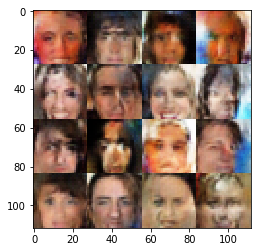

Epoch 2/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.2802... Generator Loss: 0.6454
Epoch 2/25...progress:11.11%....step:420/3780... Discriminator Loss: 2.0991... Generator Loss: 0.2023
Epoch 2/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.8431... Generator Loss: 0.2778
Epoch 2/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.6691... Generator Loss: 0.3474
Epoch 2/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.5769... Generator Loss: 0.3954
Epoch 2/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.4053... Generator Loss: 0.8917
Epoch 2/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2928... Generator Loss: 0.5993
Epoch 2/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.5200... Generator Loss: 0.4175
Epoch 2/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.4261... Generator Loss: 0.4750
Epoch 2/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.2482... Gen

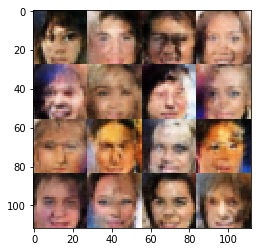

Epoch 2/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4995... Generator Loss: 1.3702
Epoch 2/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.3954... Generator Loss: 0.4951
Epoch 2/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.0750... Generator Loss: 0.9284
Epoch 2/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.1128... Generator Loss: 0.8157
Epoch 2/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.4222... Generator Loss: 0.4942
Epoch 2/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.4319... Generator Loss: 0.8628
Epoch 2/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.4702... Generator Loss: 0.5806
Epoch 2/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.8127... Generator Loss: 0.2896
Epoch 2/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.6861... Generator Loss: 0.3438
Epoch 2/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.5908... Gen

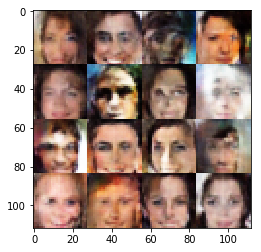

Epoch 2/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.9426... Generator Loss: 0.2619
Epoch 2/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.6931... Generator Loss: 0.3667
Epoch 2/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.3413... Generator Loss: 1.1965
Epoch 2/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.3347... Generator Loss: 0.5800
Epoch 2/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.6836... Generator Loss: 0.4049
Epoch 2/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.4128... Generator Loss: 0.5057
Epoch 2/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.2541... Generator Loss: 0.6340
Epoch 2/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.4183... Generator Loss: 0.7746
Epoch 2/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.7662... Generator Loss: 0.2990
Epoch 2/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.6087... Gen

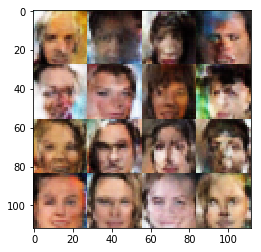

Epoch 2/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.1133... Generator Loss: 0.2058
Epoch 2/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.0442... Generator Loss: 0.2319
Epoch 2/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.2804... Generator Loss: 0.5714
Epoch 2/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.3330... Generator Loss: 0.6723
Epoch 2/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.4678... Generator Loss: 0.4554
Epoch 2/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.9927... Generator Loss: 0.2381
Epoch 2/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2916... Generator Loss: 0.8432
Epoch 2/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.8647... Generator Loss: 1.4737
Epoch 2/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3638... Generator Loss: 0.5414
Epoch 2/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.9

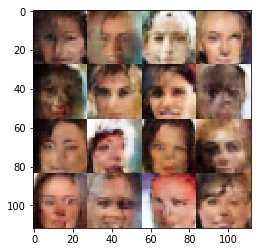

Epoch 2/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.1192... Generator Loss: 1.5230
Epoch 2/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3491... Generator Loss: 0.5946
Epoch 2/25...progress:32.54%....step:1230/3780... Discriminator Loss: 2.1002... Generator Loss: 0.2169
Epoch 2/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.5585... Generator Loss: 0.3839
Epoch 2/25...progress:33.07%....step:1250/3780... Discriminator Loss: 0.9215... Generator Loss: 1.0296
Epoch 2/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.5683... Generator Loss: 0.3929
Epoch 2/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.2517... Generator Loss: 0.7199
Epoch 2/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1956... Generator Loss: 0.6627
Epoch 2/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3637... Generator Loss: 0.6538
Epoch 2/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.9

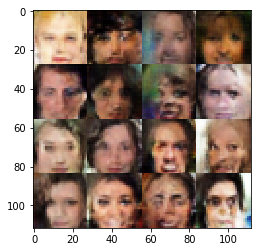

Epoch 2/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.2037... Generator Loss: 0.8231
Epoch 2/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2257... Generator Loss: 1.1591
Epoch 2/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.4412... Generator Loss: 0.6014
Epoch 2/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.2531... Generator Loss: 0.1740
Epoch 2/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.2917... Generator Loss: 0.5622
Epoch 2/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.2178... Generator Loss: 0.5953
Epoch 2/25...progress:38.89%....step:1470/3780... Discriminator Loss: 2.2325... Generator Loss: 2.4230
Epoch 2/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.4093... Generator Loss: 0.5781
Epoch 2/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2552... Generator Loss: 0.7306
Epoch 2/25...progress:39.68%....step:1500/3780... Discriminator Loss: 1.9

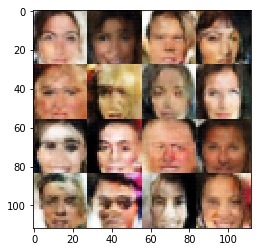

Epoch 2/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.6432... Generator Loss: 1.3446
Epoch 2/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.4219... Generator Loss: 1.2548
Epoch 2/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.2355... Generator Loss: 0.7173
Epoch 2/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.7782... Generator Loss: 0.4150
Epoch 2/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3007... Generator Loss: 1.0468
Epoch 2/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.5599... Generator Loss: 0.4355
Epoch 2/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.1125... Generator Loss: 0.8052
Epoch 2/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.3072... Generator Loss: 0.8528
Epoch 2/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.7675... Generator Loss: 0.3167
Epoch 2/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.1

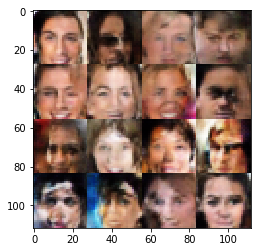

Epoch 2/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.8103... Generator Loss: 0.3064
Epoch 2/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8809... Generator Loss: 0.2673
Epoch 2/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.2477... Generator Loss: 0.7637
Epoch 2/25...progress:48.68%....step:1840/3780... Discriminator Loss: 2.2647... Generator Loss: 0.1732
Epoch 2/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.3732... Generator Loss: 0.5303
Epoch 2/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.7721... Generator Loss: 0.3454
Epoch 2/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.2683... Generator Loss: 0.5847
Epoch 2/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.4360... Generator Loss: 0.1528
Epoch 2/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.4469... Generator Loss: 0.8026
Epoch 2/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.3

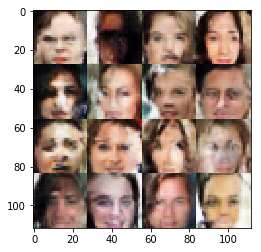

Epoch 2/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.1620... Generator Loss: 0.7266
Epoch 2/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6127... Generator Loss: 0.3805
Epoch 2/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.6107... Generator Loss: 1.3803
Epoch 2/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.2976... Generator Loss: 0.5266
Epoch 2/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6817... Generator Loss: 0.5588
Epoch 2/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.6242... Generator Loss: 0.3865
Epoch 2/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.3351... Generator Loss: 0.5855
Epoch 2/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.3643... Generator Loss: 0.5540
Epoch 2/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2401... Generator Loss: 0.9489
Epoch 2/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.2

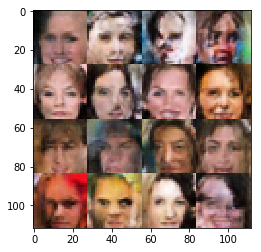

Epoch 2/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.5827... Generator Loss: 0.1303
Epoch 2/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.4224... Generator Loss: 0.6912
Epoch 2/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.2006... Generator Loss: 1.2894
Epoch 2/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.9494... Generator Loss: 0.2483
Epoch 2/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.5504... Generator Loss: 0.5399
Epoch 2/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.7329... Generator Loss: 0.7397
Epoch 2/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.3915... Generator Loss: 0.5443
Epoch 2/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.4472... Generator Loss: 0.4876
Epoch 2/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.0984... Generator Loss: 0.7884
Epoch 2/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.0

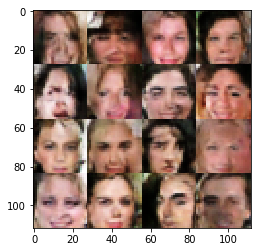

Epoch 2/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.1987... Generator Loss: 0.7937
Epoch 2/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.3573... Generator Loss: 0.4936
Epoch 2/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.3730... Generator Loss: 0.7313
Epoch 2/25...progress:64.55%....step:2440/3780... Discriminator Loss: 2.4716... Generator Loss: 1.4515
Epoch 2/25...progress:64.81%....step:2450/3780... Discriminator Loss: 2.3182... Generator Loss: 0.1631
Epoch 2/25...progress:65.08%....step:2460/3780... Discriminator Loss: 2.0015... Generator Loss: 0.2422
Epoch 2/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.4083... Generator Loss: 0.5511
Epoch 2/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.5845... Generator Loss: 0.3902
Epoch 2/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.0861... Generator Loss: 1.2795
Epoch 2/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.7

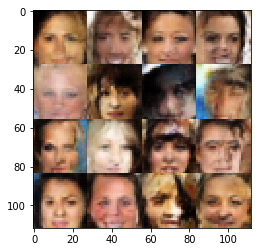

Epoch 2/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.5261... Generator Loss: 0.4124
Epoch 2/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.4297... Generator Loss: 0.4536
Epoch 2/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.4012... Generator Loss: 0.5047
Epoch 2/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.6075... Generator Loss: 0.3852
Epoch 2/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7362... Generator Loss: 0.3109
Epoch 2/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.6297... Generator Loss: 0.3763
Epoch 2/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5721... Generator Loss: 0.3906
Epoch 2/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6207... Generator Loss: 0.5992
Epoch 2/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.2943... Generator Loss: 0.5889
Epoch 2/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.6

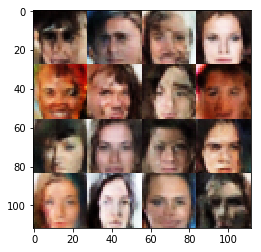

Epoch 2/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.5402... Generator Loss: 0.4683
Epoch 2/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.5404... Generator Loss: 0.5562
Epoch 2/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.3518... Generator Loss: 0.5094
Epoch 2/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2343... Generator Loss: 0.6588
Epoch 2/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.0015... Generator Loss: 0.2382
Epoch 2/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.4834... Generator Loss: 0.5804
Epoch 2/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.9943... Generator Loss: 0.2346
Epoch 2/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.5016... Generator Loss: 0.4482
Epoch 2/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.8236... Generator Loss: 0.3150
Epoch 2/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.4

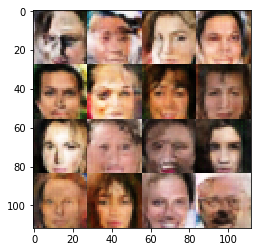

Epoch 2/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9315... Generator Loss: 1.0763
Epoch 2/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.1355... Generator Loss: 0.6785
Epoch 2/25...progress:80.16%....step:3030/3780... Discriminator Loss: 2.0467... Generator Loss: 0.2274
Epoch 2/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.5758... Generator Loss: 0.4088
Epoch 2/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.3527... Generator Loss: 0.5103
Epoch 2/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.6500... Generator Loss: 0.6455
Epoch 2/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1791... Generator Loss: 0.7694
Epoch 2/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.1481... Generator Loss: 0.1935
Epoch 2/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.2621... Generator Loss: 0.9183
Epoch 2/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.9

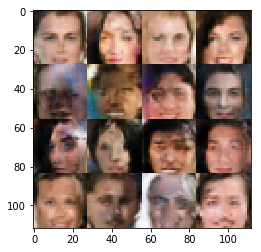

Epoch 2/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.7880... Generator Loss: 0.3190
Epoch 2/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.6222... Generator Loss: 0.3857
Epoch 2/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.4282... Generator Loss: 0.6047
Epoch 2/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.8331... Generator Loss: 0.3092
Epoch 2/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.2232... Generator Loss: 0.7503
Epoch 2/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.2910... Generator Loss: 0.1728
Epoch 2/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.2266... Generator Loss: 0.6877
Epoch 2/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.3149... Generator Loss: 0.6538
Epoch 2/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.4947... Generator Loss: 0.5472
Epoch 2/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.1

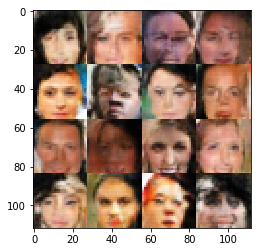

Epoch 2/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.2558... Generator Loss: 0.6476
Epoch 2/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.7304... Generator Loss: 0.3188
Epoch 2/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5093... Generator Loss: 0.4158
Epoch 2/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.4607... Generator Loss: 0.5163
Epoch 2/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.1166... Generator Loss: 1.0592
Epoch 2/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.1003... Generator Loss: 0.7835
Epoch 2/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.8758... Generator Loss: 0.2855
Epoch 2/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.3568... Generator Loss: 0.6739
Epoch 2/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.4780... Generator Loss: 0.5063
Epoch 2/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.3

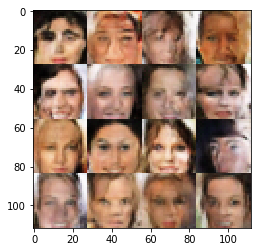

Epoch 2/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.7126... Generator Loss: 0.3257
Epoch 2/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.3333... Generator Loss: 0.5416
Epoch 2/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.3677... Generator Loss: 0.1645
Epoch 2/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.3661... Generator Loss: 0.5608
Epoch 2/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.3068... Generator Loss: 0.5400
Epoch 2/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.5171... Generator Loss: 0.4428
Epoch 2/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.3763... Generator Loss: 0.5136
Epoch 2/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.4452... Generator Loss: 0.1396
Epoch 2/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.7687... Generator Loss: 0.3217
Epoch 2/25...progress:97.88%....step:3700/3780... Discriminator Loss: 1.6

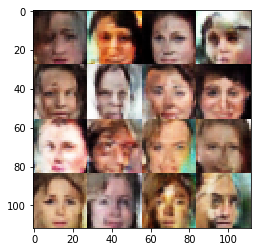

Epoch 3/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.3621... Generator Loss: 0.6517
Epoch 3/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.0932... Generator Loss: 0.2127
Epoch 3/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.4991... Generator Loss: 0.4422
Epoch 3/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.8141... Generator Loss: 0.2854
Epoch 3/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.2223... Generator Loss: 0.7798
Epoch 3/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.6118... Generator Loss: 0.3557
Epoch 3/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.2117... Generator Loss: 0.6782
Epoch 3/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.4616... Generator Loss: 0.1622
Epoch 3/25...progress:2.38%....step:90/3780... Discriminator Loss: 2.2563... Generator Loss: 0.1839
Epoch 3/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.7980... Generator Loss: 0.2880

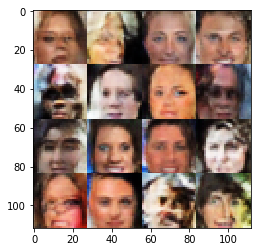

Epoch 3/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.3805... Generator Loss: 0.9734
Epoch 3/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.3635... Generator Loss: 0.8690
Epoch 3/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.2917... Generator Loss: 1.0543
Epoch 3/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.4827... Generator Loss: 0.7762
Epoch 3/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.4323... Generator Loss: 0.5190
Epoch 3/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.5067... Generator Loss: 1.4503
Epoch 3/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.0040... Generator Loss: 0.2485
Epoch 3/25...progress:7.41%....step:280/3780... Discriminator Loss: 2.0486... Generator Loss: 0.2307
Epoch 3/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2173... Generator Loss: 0.8040
Epoch 3/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.2473... Generator Los

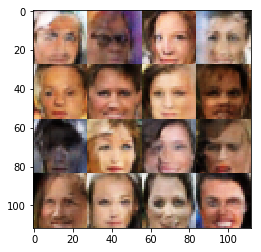

Epoch 3/25...progress:10.85%....step:410/3780... Discriminator Loss: 2.2272... Generator Loss: 1.2206
Epoch 3/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.3145... Generator Loss: 0.5770
Epoch 3/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.6595... Generator Loss: 0.3749
Epoch 3/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.2574... Generator Loss: 0.5823
Epoch 3/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.3306... Generator Loss: 0.5820
Epoch 3/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.1220... Generator Loss: 0.8219
Epoch 3/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.9248... Generator Loss: 0.2547
Epoch 3/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.1048... Generator Loss: 0.7886
Epoch 3/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.2404... Generator Loss: 0.9809
Epoch 3/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.5081... Gen

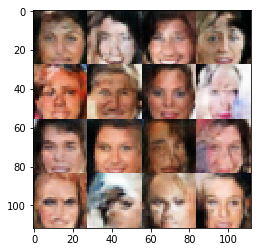

Epoch 3/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.8022... Generator Loss: 0.9541
Epoch 3/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.6115... Generator Loss: 0.3724
Epoch 3/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.6148... Generator Loss: 0.7539
Epoch 3/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.6899... Generator Loss: 0.3520
Epoch 3/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.5175... Generator Loss: 0.4568
Epoch 3/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.9744... Generator Loss: 0.2437
Epoch 3/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5532... Generator Loss: 0.4222
Epoch 3/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.4415... Generator Loss: 0.4821
Epoch 3/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9888... Generator Loss: 0.2652
Epoch 3/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.3231... Gen

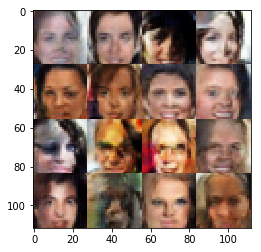

Epoch 3/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5836... Generator Loss: 0.4160
Epoch 3/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.4750... Generator Loss: 0.7001
Epoch 3/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.0662... Generator Loss: 0.8639
Epoch 3/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.3533... Generator Loss: 0.5591
Epoch 3/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.9728... Generator Loss: 0.2532
Epoch 3/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.8602... Generator Loss: 0.2890
Epoch 3/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.4654... Generator Loss: 0.4526
Epoch 3/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.8168... Generator Loss: 0.3134
Epoch 3/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.8376... Generator Loss: 0.2989
Epoch 3/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3752... Gen

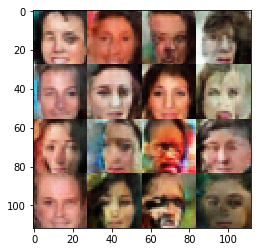

Epoch 3/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.1798... Generator Loss: 0.2002
Epoch 3/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.2559... Generator Loss: 0.6672
Epoch 3/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.2206... Generator Loss: 0.6346
Epoch 3/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2804... Generator Loss: 1.0302
Epoch 3/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.5946... Generator Loss: 0.3710
Epoch 3/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.2869... Generator Loss: 0.5268
Epoch 3/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.4829... Generator Loss: 0.5116
Epoch 3/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.2537... Generator Loss: 0.5571
Epoch 3/25...progress:28.84%....step:1090/3780... Discriminator Loss: 2.1161... Generator Loss: 0.2043
Epoch 3/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.4

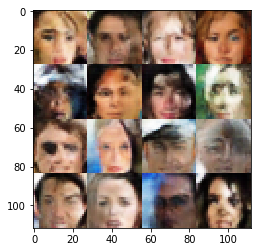

Epoch 3/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.2674... Generator Loss: 0.8621
Epoch 3/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3249... Generator Loss: 0.5718
Epoch 3/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.2041... Generator Loss: 0.7128
Epoch 3/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.2048... Generator Loss: 0.6197
Epoch 3/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.3860... Generator Loss: 0.5561
Epoch 3/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.7796... Generator Loss: 0.3740
Epoch 3/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.4941... Generator Loss: 0.5275
Epoch 3/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.4253... Generator Loss: 0.5250
Epoch 3/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.4023... Generator Loss: 0.6759
Epoch 3/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.8

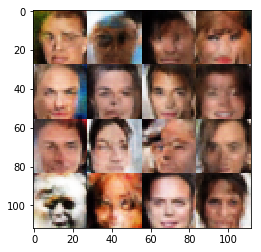

Epoch 3/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.1889... Generator Loss: 0.7904
Epoch 3/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0501... Generator Loss: 1.0353
Epoch 3/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.4488... Generator Loss: 0.4509
Epoch 3/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.1975... Generator Loss: 0.2029
Epoch 3/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.6479... Generator Loss: 0.3856
Epoch 3/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.0055... Generator Loss: 0.2323
Epoch 3/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1281... Generator Loss: 0.9654
Epoch 3/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.7296... Generator Loss: 0.3442
Epoch 3/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4980... Generator Loss: 0.8546
Epoch 3/25...progress:39.68%....step:1500/3780... Discriminator Loss: 2.0

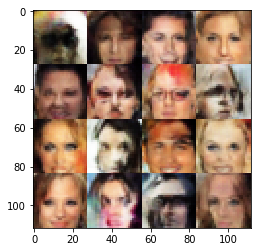

Epoch 3/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.3442... Generator Loss: 0.6839
Epoch 3/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1097... Generator Loss: 0.8041
Epoch 3/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.4052... Generator Loss: 0.5286
Epoch 3/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.1908... Generator Loss: 0.8089
Epoch 3/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.8481... Generator Loss: 0.2721
Epoch 3/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.8236... Generator Loss: 0.2972
Epoch 3/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.5140... Generator Loss: 0.4658
Epoch 3/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4370... Generator Loss: 0.5469
Epoch 3/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.2946... Generator Loss: 0.1712
Epoch 3/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.2

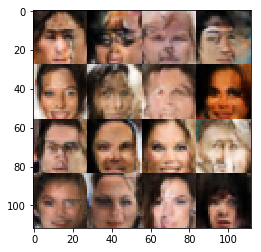

Epoch 3/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.6082... Generator Loss: 0.3974
Epoch 3/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.6708... Generator Loss: 0.4196
Epoch 3/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.0275... Generator Loss: 0.8942
Epoch 3/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4647... Generator Loss: 0.4358
Epoch 3/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.5100... Generator Loss: 0.4314
Epoch 3/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.6874... Generator Loss: 0.3785
Epoch 3/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.1799... Generator Loss: 0.8540
Epoch 3/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.3332... Generator Loss: 0.1897
Epoch 3/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.9515... Generator Loss: 0.2822
Epoch 3/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.7

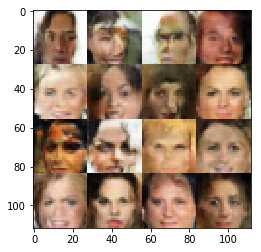

Epoch 3/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.3016... Generator Loss: 0.8607
Epoch 3/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.3764... Generator Loss: 0.5579
Epoch 3/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.0058... Generator Loss: 1.0698
Epoch 3/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.6025... Generator Loss: 0.3761
Epoch 3/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.3855... Generator Loss: 0.5339
Epoch 3/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3037... Generator Loss: 0.6153
Epoch 3/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.3645... Generator Loss: 0.6059
Epoch 3/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.1195... Generator Loss: 1.2358
Epoch 3/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.3770... Generator Loss: 0.7068
Epoch 3/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.5

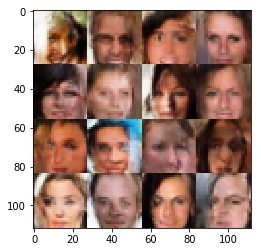

Epoch 3/25...progress:58.47%....step:2210/3780... Discriminator Loss: 1.7236... Generator Loss: 0.3356
Epoch 3/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.1963... Generator Loss: 0.8627
Epoch 3/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.1538... Generator Loss: 0.8786
Epoch 3/25...progress:59.26%....step:2240/3780... Discriminator Loss: 2.0230... Generator Loss: 0.2301
Epoch 3/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.4980... Generator Loss: 0.7631
Epoch 3/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5476... Generator Loss: 0.6418
Epoch 3/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.5821... Generator Loss: 0.3924
Epoch 3/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.4605... Generator Loss: 0.4566
Epoch 3/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4439... Generator Loss: 0.4809
Epoch 3/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.7

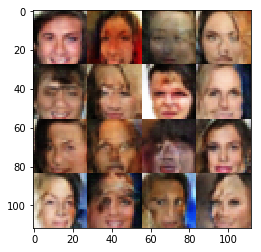

Epoch 3/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.1921... Generator Loss: 0.6755
Epoch 3/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.6675... Generator Loss: 0.3485
Epoch 3/25...progress:64.29%....step:2430/3780... Discriminator Loss: 2.6934... Generator Loss: 0.1275
Epoch 3/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4253... Generator Loss: 0.5636
Epoch 3/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.4874... Generator Loss: 0.4500
Epoch 3/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.6537... Generator Loss: 0.3934
Epoch 3/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.1169... Generator Loss: 0.2115
Epoch 3/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.4886... Generator Loss: 0.4738
Epoch 3/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8229... Generator Loss: 1.5248
Epoch 3/25...progress:66.14%....step:2500/3780... Discriminator Loss: 0.9

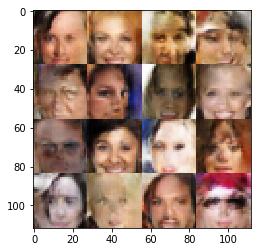

Epoch 3/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9537... Generator Loss: 0.2653
Epoch 3/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5619... Generator Loss: 0.4764
Epoch 3/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.3475... Generator Loss: 0.1621
Epoch 3/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.6207... Generator Loss: 0.3679
Epoch 3/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.5154... Generator Loss: 0.1298
Epoch 3/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9024... Generator Loss: 0.2867
Epoch 3/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.1883... Generator Loss: 0.7249
Epoch 3/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6783... Generator Loss: 0.3840
Epoch 3/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.6343... Generator Loss: 1.3139
Epoch 3/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.8

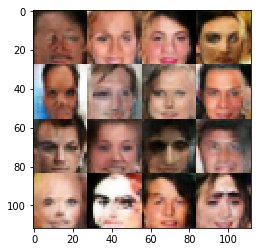

Epoch 3/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.7927... Generator Loss: 0.3071
Epoch 3/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.3301... Generator Loss: 0.5769
Epoch 3/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.9072... Generator Loss: 0.2621
Epoch 3/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.4666... Generator Loss: 0.5014
Epoch 3/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.5646... Generator Loss: 0.3902
Epoch 3/25...progress:75.66%....step:2860/3780... Discriminator Loss: 2.0005... Generator Loss: 0.2438
Epoch 3/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.8050... Generator Loss: 0.3149
Epoch 3/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.6089... Generator Loss: 0.5367
Epoch 3/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.6036... Generator Loss: 0.4841
Epoch 3/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.3

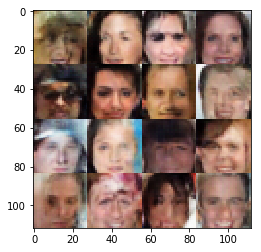

Epoch 3/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.2026... Generator Loss: 0.6883
Epoch 3/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.1833... Generator Loss: 0.7787
Epoch 3/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.4562... Generator Loss: 0.5184
Epoch 3/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8117... Generator Loss: 0.3097
Epoch 3/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.5998... Generator Loss: 0.3981
Epoch 3/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.7927... Generator Loss: 0.3058
Epoch 3/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1278... Generator Loss: 0.8026
Epoch 3/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.7401... Generator Loss: 0.3367
Epoch 3/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3672... Generator Loss: 0.5707
Epoch 3/25...progress:82.01%....step:3100/3780... Discriminator Loss: 2.2

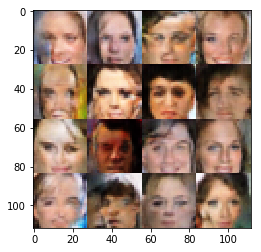

Epoch 3/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.6575... Generator Loss: 0.3581
Epoch 3/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.6788... Generator Loss: 0.3432
Epoch 3/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.0578... Generator Loss: 0.2294
Epoch 3/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.9477... Generator Loss: 0.2504
Epoch 3/25...progress:85.98%....step:3250/3780... Discriminator Loss: 2.0131... Generator Loss: 0.2637
Epoch 3/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.0830... Generator Loss: 0.2263
Epoch 3/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.3194... Generator Loss: 0.5881
Epoch 3/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2725... Generator Loss: 0.6628
Epoch 3/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.2521... Generator Loss: 0.6251
Epoch 3/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.2

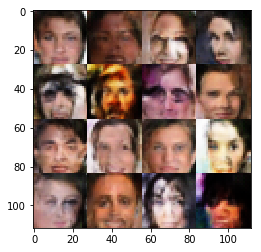

Epoch 3/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.1380... Generator Loss: 0.2109
Epoch 3/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.8356... Generator Loss: 0.2882
Epoch 3/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.4700... Generator Loss: 0.5032
Epoch 3/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.4125... Generator Loss: 0.6083
Epoch 3/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.2291... Generator Loss: 0.7226
Epoch 3/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.0061... Generator Loss: 1.2274
Epoch 3/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.5797... Generator Loss: 0.4051
Epoch 3/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.7291... Generator Loss: 0.3550
Epoch 3/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.4220... Generator Loss: 0.4916
Epoch 3/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.4

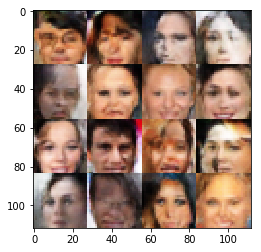

Epoch 3/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.1277... Generator Loss: 0.7863
Epoch 3/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.1337... Generator Loss: 0.8123
Epoch 3/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.2648... Generator Loss: 0.1763
Epoch 3/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.2976... Generator Loss: 0.6567
Epoch 3/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.6036... Generator Loss: 0.4271
Epoch 3/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.3103... Generator Loss: 0.6360
Epoch 3/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.7245... Generator Loss: 0.3188
Epoch 3/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.1823... Generator Loss: 0.2025
Epoch 3/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.2040... Generator Loss: 0.6125
Epoch 3/25...progress:97.88%....step:3700/3780... Discriminator Loss: 2.4

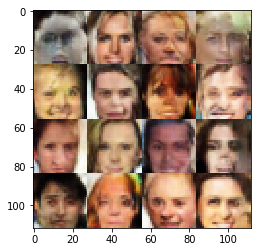

Epoch 4/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.7818... Generator Loss: 0.3103
Epoch 4/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.2583... Generator Loss: 0.1781
Epoch 4/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.3049... Generator Loss: 0.8531
Epoch 4/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.5772... Generator Loss: 0.3795
Epoch 4/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.6785... Generator Loss: 0.3596
Epoch 4/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.7052... Generator Loss: 0.3341
Epoch 4/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.1722... Generator Loss: 0.6474
Epoch 4/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.1547... Generator Loss: 0.2086
Epoch 4/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.7250... Generator Loss: 0.5125
Epoch 4/25...progress:2.65%....step:100/3780... Discriminator Loss: 2.1816... Generator Loss: 0.2012

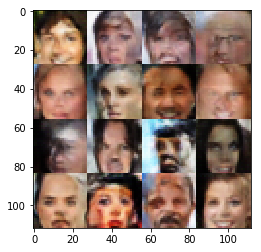

Epoch 4/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4854... Generator Loss: 0.5475
Epoch 4/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.5637... Generator Loss: 0.4254
Epoch 4/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.3986... Generator Loss: 0.6441
Epoch 4/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.9554... Generator Loss: 1.2038
Epoch 4/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.4895... Generator Loss: 0.4489
Epoch 4/25...progress:6.88%....step:260/3780... Discriminator Loss: 0.9854... Generator Loss: 1.1409
Epoch 4/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.1466... Generator Loss: 0.1957
Epoch 4/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.4569... Generator Loss: 0.4938
Epoch 4/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2235... Generator Loss: 0.7350
Epoch 4/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.6267... Generator Los

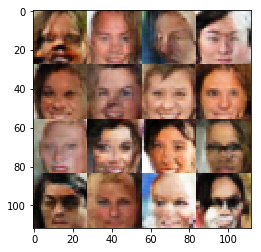

Epoch 4/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.7834... Generator Loss: 1.0813
Epoch 4/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2623... Generator Loss: 0.5870
Epoch 4/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4122... Generator Loss: 0.5581
Epoch 4/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1172... Generator Loss: 1.1380
Epoch 4/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.7701... Generator Loss: 0.3005
Epoch 4/25...progress:12.17%....step:460/3780... Discriminator Loss: 2.7611... Generator Loss: 0.1456
Epoch 4/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.7004... Generator Loss: 0.3458
Epoch 4/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.2579... Generator Loss: 0.7861
Epoch 4/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.3353... Generator Loss: 0.5539
Epoch 4/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.4329... Gen

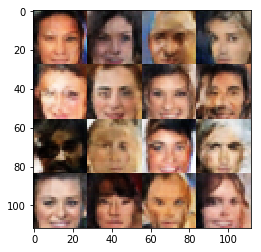

Epoch 4/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.6569... Generator Loss: 0.3524
Epoch 4/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.9620... Generator Loss: 0.2554
Epoch 4/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.3165... Generator Loss: 0.5490
Epoch 4/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.6674... Generator Loss: 0.3661
Epoch 4/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.0558... Generator Loss: 0.2313
Epoch 4/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.6993... Generator Loss: 0.3367
Epoch 4/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.7462... Generator Loss: 0.6394
Epoch 4/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.6094... Generator Loss: 0.4483
Epoch 4/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.8666... Generator Loss: 0.3020
Epoch 4/25...progress:18.52%....step:700/3780... Discriminator Loss: 0.9827... Gen

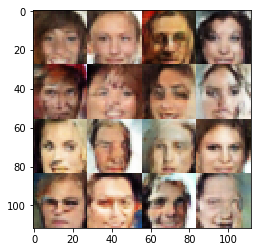

Epoch 4/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7152... Generator Loss: 0.3881
Epoch 4/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.6433... Generator Loss: 0.3645
Epoch 4/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.0399... Generator Loss: 0.8867
Epoch 4/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7002... Generator Loss: 0.4089
Epoch 4/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.4973... Generator Loss: 0.4225
Epoch 4/25...progress:22.75%....step:860/3780... Discriminator Loss: 2.0584... Generator Loss: 0.2378
Epoch 4/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.5900... Generator Loss: 0.3874
Epoch 4/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.4470... Generator Loss: 0.6190
Epoch 4/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.8794... Generator Loss: 0.2774
Epoch 4/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.1765... Gen

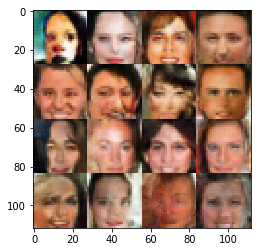

Epoch 4/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.9481... Generator Loss: 0.2543
Epoch 4/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.5194... Generator Loss: 0.4526
Epoch 4/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.7056... Generator Loss: 0.3485
Epoch 4/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.4558... Generator Loss: 0.6561
Epoch 4/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.1351... Generator Loss: 0.2050
Epoch 4/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.1787... Generator Loss: 0.6424
Epoch 4/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.3327... Generator Loss: 0.5734
Epoch 4/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.1100... Generator Loss: 0.6881
Epoch 4/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.7616... Generator Loss: 0.3351
Epoch 4/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.6

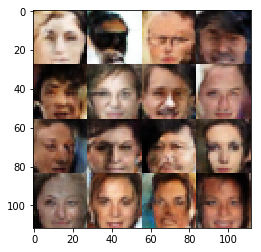

Epoch 4/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.2974... Generator Loss: 0.7740
Epoch 4/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.2044... Generator Loss: 0.6220
Epoch 4/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.6941... Generator Loss: 0.4002
Epoch 4/25...progress:32.80%....step:1240/3780... Discriminator Loss: 2.3698... Generator Loss: 0.1660
Epoch 4/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.5604... Generator Loss: 0.3974
Epoch 4/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.0945... Generator Loss: 1.2020
Epoch 4/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.6044... Generator Loss: 0.3755
Epoch 4/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.4367... Generator Loss: 0.4973
Epoch 4/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3942... Generator Loss: 0.6683
Epoch 4/25...progress:34.39%....step:1300/3780... Discriminator Loss: 2.0

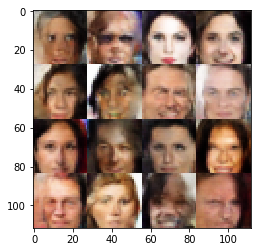

Epoch 4/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.3223... Generator Loss: 0.5747
Epoch 4/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0322... Generator Loss: 1.0170
Epoch 4/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.1424... Generator Loss: 0.7924
Epoch 4/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.6755... Generator Loss: 1.0986
Epoch 4/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.2520... Generator Loss: 0.5982
Epoch 4/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.7987... Generator Loss: 0.1149
Epoch 4/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.5067... Generator Loss: 0.4775
Epoch 4/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.9367... Generator Loss: 0.2546
Epoch 4/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4962... Generator Loss: 0.5430
Epoch 4/25...progress:39.68%....step:1500/3780... Discriminator Loss: 2.0

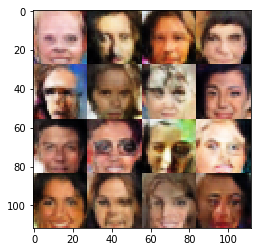

Epoch 4/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.6245... Generator Loss: 0.5103
Epoch 4/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1439... Generator Loss: 0.8545
Epoch 4/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.0359... Generator Loss: 1.0017
Epoch 4/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.6090... Generator Loss: 0.4387
Epoch 4/25...progress:43.65%....step:1650/3780... Discriminator Loss: 2.4082... Generator Loss: 0.1638
Epoch 4/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.6912... Generator Loss: 0.4376
Epoch 4/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.0324... Generator Loss: 0.8110
Epoch 4/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.2028... Generator Loss: 0.8158
Epoch 4/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.3181... Generator Loss: 0.6319
Epoch 4/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.3

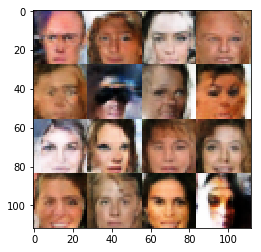

Epoch 4/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5553... Generator Loss: 0.4396
Epoch 4/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.6626... Generator Loss: 0.3472
Epoch 4/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.1789... Generator Loss: 0.6897
Epoch 4/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4542... Generator Loss: 0.4641
Epoch 4/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.2088... Generator Loss: 0.7706
Epoch 4/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.8548... Generator Loss: 0.2733
Epoch 4/25...progress:49.47%....step:1870/3780... Discriminator Loss: 2.2326... Generator Loss: 0.2063
Epoch 4/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.0875... Generator Loss: 0.2884
Epoch 4/25...progress:50.00%....step:1890/3780... Discriminator Loss: 2.1742... Generator Loss: 0.1987
Epoch 4/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.4

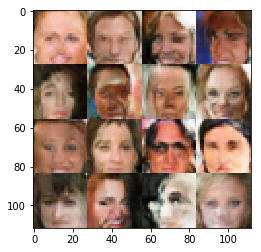

Epoch 4/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.2075... Generator Loss: 0.7256
Epoch 4/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.5890... Generator Loss: 0.4581
Epoch 4/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.3360... Generator Loss: 1.6682
Epoch 4/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.3629... Generator Loss: 0.5611
Epoch 4/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6043... Generator Loss: 0.4120
Epoch 4/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.0959... Generator Loss: 1.3453
Epoch 4/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.6379... Generator Loss: 0.4342
Epoch 4/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.5867... Generator Loss: 0.4724
Epoch 4/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.4611... Generator Loss: 1.1903
Epoch 4/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.9

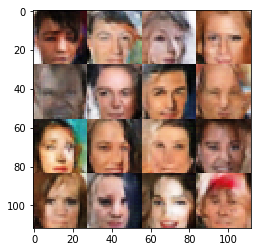

Epoch 4/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.2760... Generator Loss: 0.1898
Epoch 4/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.1697... Generator Loss: 0.7794
Epoch 4/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3533... Generator Loss: 1.6403
Epoch 4/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.4823... Generator Loss: 0.5614
Epoch 4/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.1455... Generator Loss: 1.0688
Epoch 4/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.8476... Generator Loss: 1.0240
Epoch 4/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.4494... Generator Loss: 0.5010
Epoch 4/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.5759... Generator Loss: 0.4241
Epoch 4/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.1704... Generator Loss: 0.7150
Epoch 4/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.2

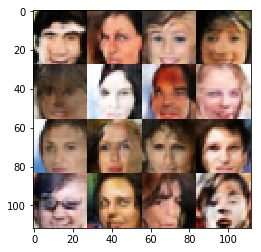

Epoch 4/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.2483... Generator Loss: 0.6360
Epoch 4/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.0514... Generator Loss: 1.0247
Epoch 4/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4472... Generator Loss: 0.7212
Epoch 4/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.7941... Generator Loss: 2.1775
Epoch 4/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5138... Generator Loss: 0.4485
Epoch 4/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.4978... Generator Loss: 0.4594
Epoch 4/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.6398... Generator Loss: 0.3783
Epoch 4/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.3295... Generator Loss: 0.5100
Epoch 4/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.1948... Generator Loss: 1.3373
Epoch 4/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.4

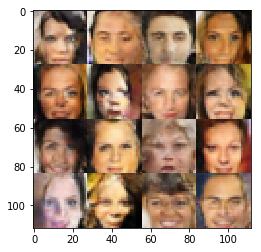

Epoch 4/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.8422... Generator Loss: 0.2988
Epoch 4/25...progress:69.31%....step:2620/3780... Discriminator Loss: 2.1037... Generator Loss: 0.2204
Epoch 4/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.9373... Generator Loss: 0.2667
Epoch 4/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.3351... Generator Loss: 0.8227
Epoch 4/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.1457... Generator Loss: 0.2170
Epoch 4/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.8750... Generator Loss: 0.2922
Epoch 4/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.3778... Generator Loss: 0.5501
Epoch 4/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.8111... Generator Loss: 0.2942
Epoch 4/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1375... Generator Loss: 0.9366
Epoch 4/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.9

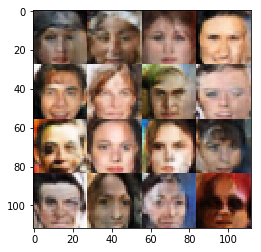

Epoch 4/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.9352... Generator Loss: 0.2600
Epoch 4/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.7642... Generator Loss: 0.3796
Epoch 4/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.2670... Generator Loss: 0.5790
Epoch 4/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.1852... Generator Loss: 0.8364
Epoch 4/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.2447... Generator Loss: 0.1841
Epoch 4/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.3171... Generator Loss: 0.5965
Epoch 4/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.7940... Generator Loss: 0.3251
Epoch 4/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.5822... Generator Loss: 0.4464
Epoch 4/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.6904... Generator Loss: 0.6435
Epoch 4/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.7

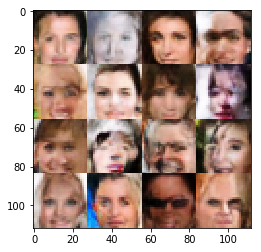

Epoch 4/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9585... Generator Loss: 0.9007
Epoch 4/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0774... Generator Loss: 0.7933
Epoch 4/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.9713... Generator Loss: 0.2670
Epoch 4/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.6978... Generator Loss: 0.3392
Epoch 4/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.6640... Generator Loss: 0.3817
Epoch 4/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.7881... Generator Loss: 0.3083
Epoch 4/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.3406... Generator Loss: 0.6632
Epoch 4/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.7345... Generator Loss: 0.3220
Epoch 4/25...progress:81.75%....step:3090/3780... Discriminator Loss: 2.1524... Generator Loss: 0.2359
Epoch 4/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.5

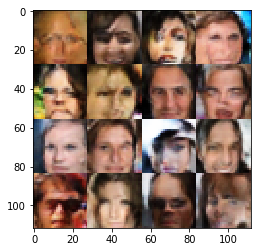

Epoch 4/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.5208... Generator Loss: 0.4287
Epoch 4/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.7321... Generator Loss: 0.3313
Epoch 4/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.2729... Generator Loss: 0.6487
Epoch 4/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.6627... Generator Loss: 0.3796
Epoch 4/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.3999... Generator Loss: 0.6219
Epoch 4/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.4040... Generator Loss: 0.6337
Epoch 4/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.2226... Generator Loss: 0.6228
Epoch 4/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.3873... Generator Loss: 0.5090
Epoch 4/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.2506... Generator Loss: 0.6236
Epoch 4/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.2

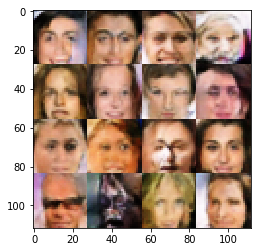

Epoch 4/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.2830... Generator Loss: 0.2053
Epoch 4/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.4785... Generator Loss: 0.4722
Epoch 4/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5330... Generator Loss: 0.4204
Epoch 4/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.3489... Generator Loss: 0.5803
Epoch 4/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.2002... Generator Loss: 0.7272
Epoch 4/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.4610... Generator Loss: 0.5479
Epoch 4/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.3999... Generator Loss: 0.8978
Epoch 4/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.3872... Generator Loss: 1.3264
Epoch 4/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.3227... Generator Loss: 0.5586
Epoch 4/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.2

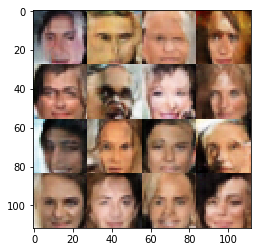

Epoch 4/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.4826... Generator Loss: 0.4504
Epoch 4/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.2991... Generator Loss: 0.5338
Epoch 4/25...progress:96.03%....step:3630/3780... Discriminator Loss: 3.1361... Generator Loss: 0.0719
Epoch 4/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.4181... Generator Loss: 0.4623
Epoch 4/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.1612... Generator Loss: 0.6862
Epoch 4/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.8784... Generator Loss: 0.1554
Epoch 4/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.2530... Generator Loss: 0.9481
Epoch 4/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.4977... Generator Loss: 0.4462
Epoch 4/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.2866... Generator Loss: 0.5840
Epoch 4/25...progress:97.88%....step:3700/3780... Discriminator Loss: 1.9

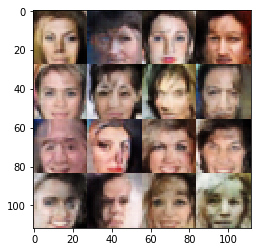

Epoch 5/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.5093... Generator Loss: 0.4498
Epoch 5/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8659... Generator Loss: 0.2724
Epoch 5/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.1691... Generator Loss: 0.6803
Epoch 5/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.3546... Generator Loss: 0.5472
Epoch 5/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.5788... Generator Loss: 0.9242
Epoch 5/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.3068... Generator Loss: 0.6442
Epoch 5/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.1114... Generator Loss: 0.8812
Epoch 5/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.6417... Generator Loss: 0.3807
Epoch 5/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.3205... Generator Loss: 0.5555
Epoch 5/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.4107... Generator Loss: 0.5935

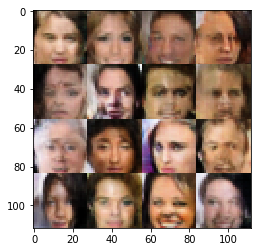

Epoch 5/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.1750... Generator Loss: 0.9821
Epoch 5/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.1574... Generator Loss: 1.0432
Epoch 5/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.3596... Generator Loss: 1.6168
Epoch 5/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.9394... Generator Loss: 0.2561
Epoch 5/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.3750... Generator Loss: 0.5341
Epoch 5/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3017... Generator Loss: 0.7102
Epoch 5/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.8917... Generator Loss: 0.2656
Epoch 5/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5770... Generator Loss: 0.4452
Epoch 5/25...progress:7.67%....step:290/3780... Discriminator Loss: 2.0416... Generator Loss: 0.2373
Epoch 5/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.3176... Generator Los

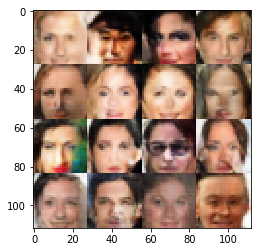

Epoch 5/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.3292... Generator Loss: 0.7003
Epoch 5/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.1142... Generator Loss: 0.8357
Epoch 5/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.8135... Generator Loss: 0.2843
Epoch 5/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.7922... Generator Loss: 2.4705
Epoch 5/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.7869... Generator Loss: 0.3269
Epoch 5/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.3364... Generator Loss: 1.0460
Epoch 5/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2023... Generator Loss: 0.6899
Epoch 5/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0002... Generator Loss: 0.8819
Epoch 5/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.1440... Generator Loss: 0.2146
Epoch 5/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.4509... Gen

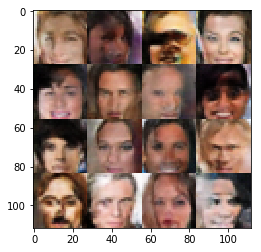

Epoch 5/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.6423... Generator Loss: 1.2030
Epoch 5/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.9373... Generator Loss: 0.2923
Epoch 5/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.2378... Generator Loss: 0.6005
Epoch 5/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.8227... Generator Loss: 0.2971
Epoch 5/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.7538... Generator Loss: 0.3051
Epoch 5/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.8283... Generator Loss: 0.3395
Epoch 5/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.7419... Generator Loss: 0.4229
Epoch 5/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.5162... Generator Loss: 0.5469
Epoch 5/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.5584... Generator Loss: 0.4333
Epoch 5/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.4626... Gen

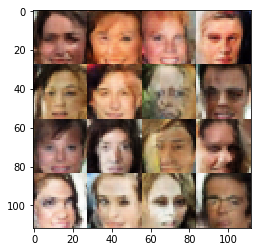

Epoch 5/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.8084... Generator Loss: 0.4444
Epoch 5/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.6240... Generator Loss: 0.4121
Epoch 5/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.9250... Generator Loss: 1.1952
Epoch 5/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.6310... Generator Loss: 0.3650
Epoch 5/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.7398... Generator Loss: 0.3183
Epoch 5/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7532... Generator Loss: 0.3360
Epoch 5/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.6199... Generator Loss: 0.3892
Epoch 5/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.3812... Generator Loss: 0.6478
Epoch 5/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.6192... Generator Loss: 0.3830
Epoch 5/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.4351... Gen

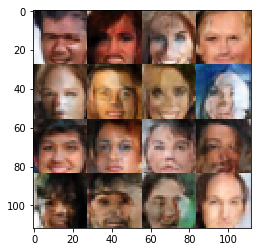

Epoch 5/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.9779... Generator Loss: 0.2776
Epoch 5/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.5316... Generator Loss: 0.4976
Epoch 5/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.1111... Generator Loss: 0.7201
Epoch 5/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.5801... Generator Loss: 0.4313
Epoch 5/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.8214... Generator Loss: 0.2837
Epoch 5/25...progress:28.04%....step:1060/3780... Discriminator Loss: 2.0914... Generator Loss: 0.2443
Epoch 5/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2307... Generator Loss: 0.9677
Epoch 5/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.5058... Generator Loss: 0.4490
Epoch 5/25...progress:28.84%....step:1090/3780... Discriminator Loss: 2.2695... Generator Loss: 0.1885
Epoch 5/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.6

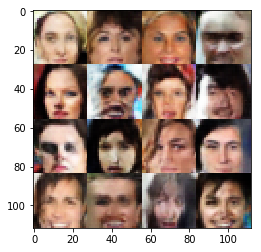

Epoch 5/25...progress:32.01%....step:1210/3780... Discriminator Loss: 0.9773... Generator Loss: 1.0059
Epoch 5/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.8204... Generator Loss: 0.2869
Epoch 5/25...progress:32.54%....step:1230/3780... Discriminator Loss: 0.9538... Generator Loss: 1.1842
Epoch 5/25...progress:32.80%....step:1240/3780... Discriminator Loss: 2.0094... Generator Loss: 0.2543
Epoch 5/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.3197... Generator Loss: 0.7002
Epoch 5/25...progress:33.33%....step:1260/3780... Discriminator Loss: 2.1405... Generator Loss: 0.2154
Epoch 5/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.7049... Generator Loss: 0.3536
Epoch 5/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1686... Generator Loss: 0.9110
Epoch 5/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.6564... Generator Loss: 0.4062
Epoch 5/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.7

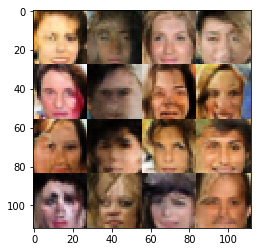

Epoch 5/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.6260... Generator Loss: 0.4859
Epoch 5/25...progress:37.57%....step:1420/3780... Discriminator Loss: 0.9632... Generator Loss: 1.2066
Epoch 5/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.1733... Generator Loss: 0.7611
Epoch 5/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.6668... Generator Loss: 0.3670
Epoch 5/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.2725... Generator Loss: 0.9947
Epoch 5/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.4652... Generator Loss: 0.5373
Epoch 5/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.7148... Generator Loss: 0.3891
Epoch 5/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.7689... Generator Loss: 0.3253
Epoch 5/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4438... Generator Loss: 0.4460
Epoch 5/25...progress:39.68%....step:1500/3780... Discriminator Loss: 1.9

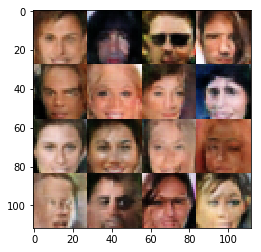

Epoch 5/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2175... Generator Loss: 0.8158
Epoch 5/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.4448... Generator Loss: 0.4844
Epoch 5/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1757... Generator Loss: 0.6987
Epoch 5/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.0133... Generator Loss: 0.9161
Epoch 5/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3345... Generator Loss: 0.5442
Epoch 5/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.7503... Generator Loss: 0.3517
Epoch 5/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.8279... Generator Loss: 1.0984
Epoch 5/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4343... Generator Loss: 0.5287
Epoch 5/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.2320... Generator Loss: 0.2081
Epoch 5/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.2

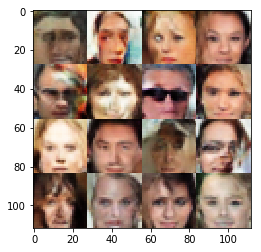

Epoch 5/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5555... Generator Loss: 0.4540
Epoch 5/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.0397... Generator Loss: 0.2330
Epoch 5/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.7918... Generator Loss: 0.3272
Epoch 5/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5054... Generator Loss: 0.4163
Epoch 5/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.1989... Generator Loss: 0.7406
Epoch 5/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.9334... Generator Loss: 0.2676
Epoch 5/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.1306... Generator Loss: 0.8561
Epoch 5/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.6305... Generator Loss: 0.3966
Epoch 5/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5786... Generator Loss: 0.4494
Epoch 5/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.6

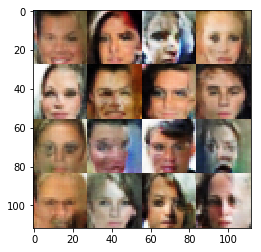

Epoch 5/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.2574... Generator Loss: 0.6541
Epoch 5/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.7182... Generator Loss: 0.3260
Epoch 5/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.4949... Generator Loss: 0.8642
Epoch 5/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.5124... Generator Loss: 0.4616
Epoch 5/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.4115... Generator Loss: 0.6664
Epoch 5/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.2027... Generator Loss: 1.3217
Epoch 5/25...progress:54.76%....step:2070/3780... Discriminator Loss: 2.0562... Generator Loss: 0.2257
Epoch 5/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.7436... Generator Loss: 0.3355
Epoch 5/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.1084... Generator Loss: 0.8161
Epoch 5/25...progress:55.56%....step:2100/3780... Discriminator Loss: 2.0

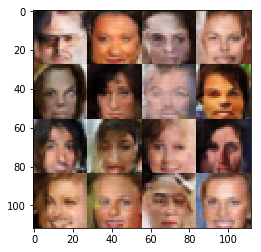

Epoch 5/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.0544... Generator Loss: 0.2338
Epoch 5/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.0770... Generator Loss: 1.0312
Epoch 5/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.5634... Generator Loss: 0.4405
Epoch 5/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.1796... Generator Loss: 0.9984
Epoch 5/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.2243... Generator Loss: 0.7670
Epoch 5/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5574... Generator Loss: 0.7856
Epoch 5/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9949... Generator Loss: 0.2423
Epoch 5/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.4890... Generator Loss: 0.6404
Epoch 5/25...progress:60.58%....step:2290/3780... Discriminator Loss: 0.9386... Generator Loss: 1.3941
Epoch 5/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.2

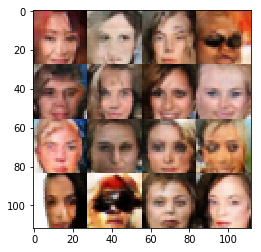

Epoch 5/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.9956... Generator Loss: 0.8667
Epoch 5/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.6949... Generator Loss: 0.3529
Epoch 5/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4683... Generator Loss: 0.4992
Epoch 5/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.2781... Generator Loss: 0.6866
Epoch 5/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.4186... Generator Loss: 0.4967
Epoch 5/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5147... Generator Loss: 0.4491
Epoch 5/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.2273... Generator Loss: 0.6385
Epoch 5/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.0142... Generator Loss: 1.1606
Epoch 5/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8203... Generator Loss: 1.1704
Epoch 5/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.6

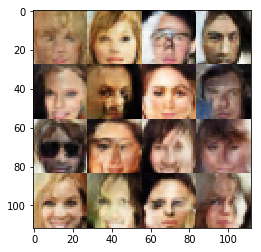

Epoch 5/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.7788... Generator Loss: 0.3158
Epoch 5/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5926... Generator Loss: 0.4417
Epoch 5/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.1403... Generator Loss: 0.2147
Epoch 5/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.5987... Generator Loss: 0.4600
Epoch 5/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.2051... Generator Loss: 0.2095
Epoch 5/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.7104... Generator Loss: 0.3593
Epoch 5/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.8092... Generator Loss: 0.2934
Epoch 5/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6504... Generator Loss: 0.3932
Epoch 5/25...progress:71.16%....step:2690/3780... Discriminator Loss: 0.7416... Generator Loss: 1.5036
Epoch 5/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.7

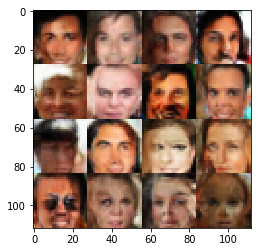

Epoch 5/25...progress:74.34%....step:2810/3780... Discriminator Loss: 2.6053... Generator Loss: 0.1411
Epoch 5/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.6932... Generator Loss: 0.3534
Epoch 5/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.0890... Generator Loss: 0.8529
Epoch 5/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2585... Generator Loss: 0.7481
Epoch 5/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.1490... Generator Loss: 0.2344
Epoch 5/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.2463... Generator Loss: 0.7883
Epoch 5/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.9231... Generator Loss: 0.2725
Epoch 5/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.5579... Generator Loss: 0.4022
Epoch 5/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.2381... Generator Loss: 1.5820
Epoch 5/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.2

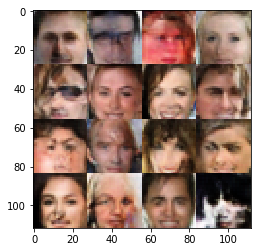

Epoch 5/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0204... Generator Loss: 0.9953
Epoch 5/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0959... Generator Loss: 0.8127
Epoch 5/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.8543... Generator Loss: 0.3113
Epoch 5/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8124... Generator Loss: 0.3801
Epoch 5/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.6821... Generator Loss: 0.3669
Epoch 5/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.0493... Generator Loss: 0.9499
Epoch 5/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.3522... Generator Loss: 0.9237
Epoch 5/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0452... Generator Loss: 0.2275
Epoch 5/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.6335... Generator Loss: 0.3996
Epoch 5/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.3

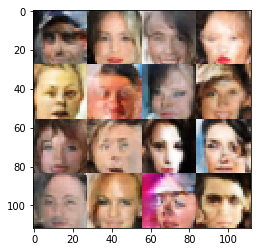

Epoch 5/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.6149... Generator Loss: 0.3974
Epoch 5/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.3865... Generator Loss: 0.6338
Epoch 5/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.5627... Generator Loss: 0.4475
Epoch 5/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.2513... Generator Loss: 0.7415
Epoch 5/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.5733... Generator Loss: 0.4816
Epoch 5/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.1454... Generator Loss: 0.2021
Epoch 5/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4445... Generator Loss: 0.4559
Epoch 5/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.0516... Generator Loss: 0.8378
Epoch 5/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.4723... Generator Loss: 0.5039
Epoch 5/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.1

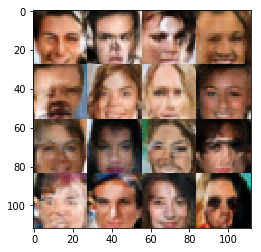

Epoch 5/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.1150... Generator Loss: 0.2366
Epoch 5/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.4884... Generator Loss: 0.4686
Epoch 5/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5799... Generator Loss: 0.4039
Epoch 5/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.6552... Generator Loss: 0.3918
Epoch 5/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.3396... Generator Loss: 0.6273
Epoch 5/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.5375... Generator Loss: 0.4445
Epoch 5/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.9385... Generator Loss: 0.3888
Epoch 5/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.5980... Generator Loss: 0.3821
Epoch 5/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.6913... Generator Loss: 0.3505
Epoch 5/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.4

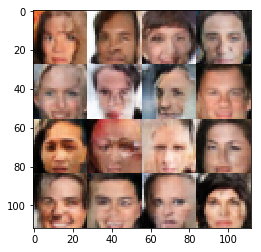

Epoch 5/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.5691... Generator Loss: 0.3910
Epoch 5/25...progress:95.77%....step:3620/3780... Discriminator Loss: 2.3464... Generator Loss: 0.1907
Epoch 5/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.9496... Generator Loss: 0.2563
Epoch 5/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.0799... Generator Loss: 0.2286
Epoch 5/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9308... Generator Loss: 0.9698
Epoch 5/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.4649... Generator Loss: 0.4509
Epoch 5/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.0939... Generator Loss: 0.2370
Epoch 5/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.0320... Generator Loss: 0.2370
Epoch 5/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.3134... Generator Loss: 0.6102
Epoch 5/25...progress:97.88%....step:3700/3780... Discriminator Loss: 2.0

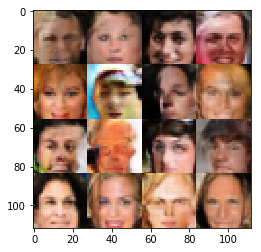

Epoch 6/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.7815... Generator Loss: 0.3172
Epoch 6/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.7204... Generator Loss: 0.3756
Epoch 6/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.5064... Generator Loss: 0.4738
Epoch 6/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.4009... Generator Loss: 0.4954
Epoch 6/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.5211... Generator Loss: 0.5228
Epoch 6/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.8137... Generator Loss: 0.3275
Epoch 6/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.7206... Generator Loss: 0.4048
Epoch 6/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.7017... Generator Loss: 0.3934
Epoch 6/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.0475... Generator Loss: 1.0363
Epoch 6/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.5119... Generator Loss: 0.5849

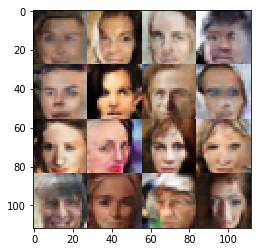

Epoch 6/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.0364... Generator Loss: 0.9284
Epoch 6/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.2880... Generator Loss: 0.6246
Epoch 6/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.3238... Generator Loss: 0.6098
Epoch 6/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.3762... Generator Loss: 0.1687
Epoch 6/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.6808... Generator Loss: 0.3584
Epoch 6/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3616... Generator Loss: 0.6106
Epoch 6/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.0577... Generator Loss: 0.2332
Epoch 6/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.2234... Generator Loss: 0.6827
Epoch 6/25...progress:7.67%....step:290/3780... Discriminator Loss: 0.9887... Generator Loss: 1.0459
Epoch 6/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.4448... Generator Los

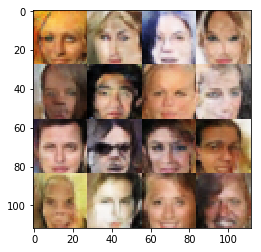

Epoch 6/25...progress:10.85%....step:410/3780... Discriminator Loss: 2.8420... Generator Loss: 0.8339
Epoch 6/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2521... Generator Loss: 0.6591
Epoch 6/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.1812... Generator Loss: 0.2195
Epoch 6/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.5484... Generator Loss: 1.3483
Epoch 6/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.7382... Generator Loss: 0.3545
Epoch 6/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.0233... Generator Loss: 1.0901
Epoch 6/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.9623... Generator Loss: 0.4160
Epoch 6/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.9570... Generator Loss: 1.1475
Epoch 6/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.3857... Generator Loss: 0.4896
Epoch 6/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.7741... Gen

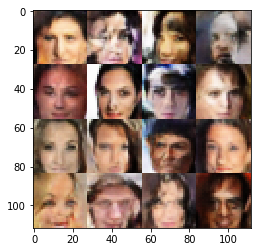

Epoch 6/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.5173... Generator Loss: 0.5053
Epoch 6/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.0343... Generator Loss: 0.2334
Epoch 6/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.2141... Generator Loss: 0.8538
Epoch 6/25...progress:16.93%....step:640/3780... Discriminator Loss: 2.2005... Generator Loss: 0.1980
Epoch 6/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.1622... Generator Loss: 0.2074
Epoch 6/25...progress:17.46%....step:660/3780... Discriminator Loss: 2.0389... Generator Loss: 0.2316
Epoch 6/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5796... Generator Loss: 0.4376
Epoch 6/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.9984... Generator Loss: 0.2783
Epoch 6/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.6981... Generator Loss: 0.3420
Epoch 6/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.6389... Gen

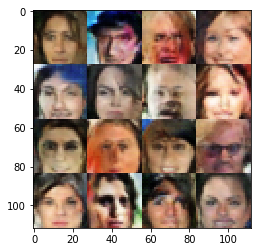

Epoch 6/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.8303... Generator Loss: 0.3367
Epoch 6/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.9244... Generator Loss: 0.3012
Epoch 6/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1088... Generator Loss: 0.7648
Epoch 6/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.3934... Generator Loss: 0.5758
Epoch 6/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.5813... Generator Loss: 0.4796
Epoch 6/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.5550... Generator Loss: 0.4271
Epoch 6/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.5088... Generator Loss: 0.4614
Epoch 6/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.9512... Generator Loss: 0.2999
Epoch 6/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.3708... Generator Loss: 0.5195
Epoch 6/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.2211... Gen

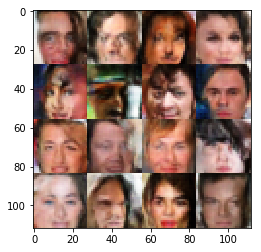

Epoch 6/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.6897... Generator Loss: 0.4162
Epoch 6/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.9868... Generator Loss: 0.3535
Epoch 6/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.6259... Generator Loss: 0.3737
Epoch 6/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2277... Generator Loss: 0.8654
Epoch 6/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.8149... Generator Loss: 0.3010
Epoch 6/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.9833... Generator Loss: 0.9492
Epoch 6/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2850... Generator Loss: 1.7687
Epoch 6/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.0111... Generator Loss: 0.8611
Epoch 6/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.6444... Generator Loss: 0.4166
Epoch 6/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.3

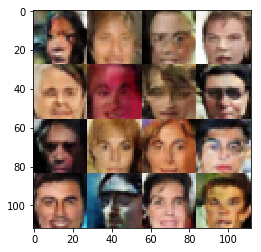

Epoch 6/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.6409... Generator Loss: 0.3683
Epoch 6/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3615... Generator Loss: 0.5079
Epoch 6/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.3140... Generator Loss: 0.5561
Epoch 6/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.5892... Generator Loss: 0.3876
Epoch 6/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.0965... Generator Loss: 0.8020
Epoch 6/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.6017... Generator Loss: 0.4567
Epoch 6/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.7282... Generator Loss: 0.3838
Epoch 6/25...progress:33.86%....step:1280/3780... Discriminator Loss: 0.9937... Generator Loss: 0.9808
Epoch 6/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.2885... Generator Loss: 0.6359
Epoch 6/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.8

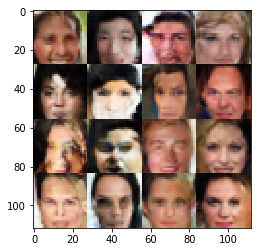

Epoch 6/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.0196... Generator Loss: 1.1310
Epoch 6/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.1099... Generator Loss: 0.7963
Epoch 6/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.1677... Generator Loss: 0.8608
Epoch 6/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.9194... Generator Loss: 0.2826
Epoch 6/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.2471... Generator Loss: 1.3851
Epoch 6/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.7487... Generator Loss: 0.1182
Epoch 6/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.4648... Generator Loss: 0.4940
Epoch 6/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.3826... Generator Loss: 0.6599
Epoch 6/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4513... Generator Loss: 0.4691
Epoch 6/25...progress:39.68%....step:1500/3780... Discriminator Loss: 2.0

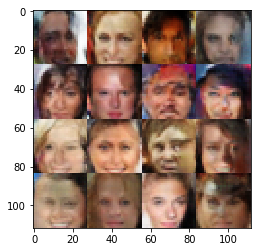

Epoch 6/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.4492... Generator Loss: 0.5689
Epoch 6/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.0550... Generator Loss: 1.0216
Epoch 6/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1544... Generator Loss: 1.0257
Epoch 6/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.3254... Generator Loss: 1.1825
Epoch 6/25...progress:43.65%....step:1650/3780... Discriminator Loss: 0.9788... Generator Loss: 0.8999
Epoch 6/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.2597... Generator Loss: 0.6290
Epoch 6/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.8103... Generator Loss: 1.1491
Epoch 6/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.6463... Generator Loss: 0.6750
Epoch 6/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.5491... Generator Loss: 1.1136
Epoch 6/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.4

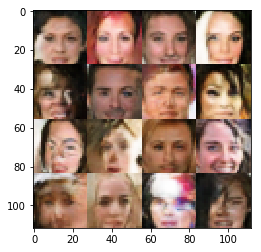

Epoch 6/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.0232... Generator Loss: 0.2350
Epoch 6/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.4161... Generator Loss: 0.1701
Epoch 6/25...progress:48.41%....step:1830/3780... Discriminator Loss: 0.9760... Generator Loss: 1.0557
Epoch 6/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.6908... Generator Loss: 0.3916
Epoch 6/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.2728... Generator Loss: 0.6633
Epoch 6/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.6869... Generator Loss: 0.3470
Epoch 6/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3321... Generator Loss: 0.6620
Epoch 6/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.3264... Generator Loss: 0.5885
Epoch 6/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6902... Generator Loss: 0.3958
Epoch 6/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.5

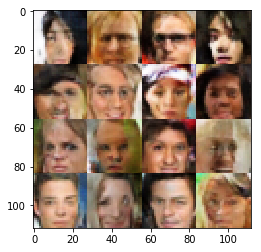

Epoch 6/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.2962... Generator Loss: 0.5725
Epoch 6/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.4973... Generator Loss: 0.5007
Epoch 6/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.2609... Generator Loss: 1.0090
Epoch 6/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.0996... Generator Loss: 0.7870
Epoch 6/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.3442... Generator Loss: 0.5601
Epoch 6/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.5407... Generator Loss: 1.1457
Epoch 6/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.0988... Generator Loss: 0.8048
Epoch 6/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.3542... Generator Loss: 0.6114
Epoch 6/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.1950... Generator Loss: 0.9875
Epoch 6/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.5

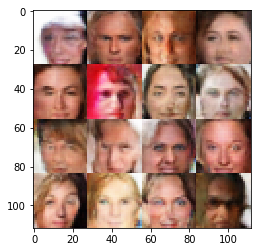

Epoch 6/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.0679... Generator Loss: 0.2418
Epoch 6/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.1557... Generator Loss: 0.9564
Epoch 6/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.0419... Generator Loss: 0.9862
Epoch 6/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.2581... Generator Loss: 0.6671
Epoch 6/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.7623... Generator Loss: 0.3919
Epoch 6/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5677... Generator Loss: 0.9178
Epoch 6/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.4478... Generator Loss: 0.1605
Epoch 6/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.7847... Generator Loss: 0.3203
Epoch 6/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.5014... Generator Loss: 0.5125
Epoch 6/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.3

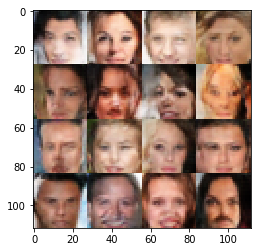

Epoch 6/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.8717... Generator Loss: 1.0995
Epoch 6/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.3314... Generator Loss: 0.5344
Epoch 6/25...progress:64.29%....step:2430/3780... Discriminator Loss: 2.7851... Generator Loss: 0.1191
Epoch 6/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.3808... Generator Loss: 0.7512
Epoch 6/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.3629... Generator Loss: 0.5942
Epoch 6/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.6378... Generator Loss: 0.3691
Epoch 6/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.1995... Generator Loss: 0.1976
Epoch 6/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.2023... Generator Loss: 0.7051
Epoch 6/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8971... Generator Loss: 1.5600
Epoch 6/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.6

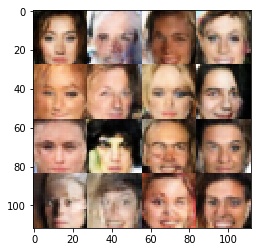

Epoch 6/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.3457... Generator Loss: 0.7191
Epoch 6/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.2959... Generator Loss: 0.7665
Epoch 6/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.8038... Generator Loss: 0.3420
Epoch 6/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.2586... Generator Loss: 0.9974
Epoch 6/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.4113... Generator Loss: 0.1657
Epoch 6/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.8064... Generator Loss: 0.3079
Epoch 6/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5073... Generator Loss: 0.4309
Epoch 6/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.7907... Generator Loss: 0.3029
Epoch 6/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.3848... Generator Loss: 0.5131
Epoch 6/25...progress:71.43%....step:2700/3780... Discriminator Loss: 2.3

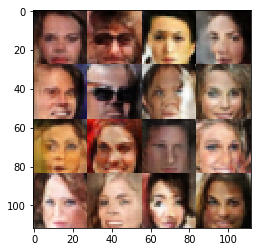

Epoch 6/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.8628... Generator Loss: 0.3041
Epoch 6/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.1365... Generator Loss: 0.8563
Epoch 6/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.1826... Generator Loss: 0.6650
Epoch 6/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.0585... Generator Loss: 0.9068
Epoch 6/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.4404... Generator Loss: 0.1667
Epoch 6/25...progress:75.66%....step:2860/3780... Discriminator Loss: 2.0725... Generator Loss: 0.2414
Epoch 6/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.5099... Generator Loss: 0.4341
Epoch 6/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.2441... Generator Loss: 1.4382
Epoch 6/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.4861... Generator Loss: 0.5448
Epoch 6/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.7

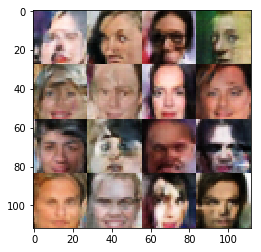

Epoch 6/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9908... Generator Loss: 1.0751
Epoch 6/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0364... Generator Loss: 0.9304
Epoch 6/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.5804... Generator Loss: 0.4506
Epoch 6/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.2343... Generator Loss: 0.7417
Epoch 6/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.2663... Generator Loss: 0.9352
Epoch 6/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.9877... Generator Loss: 0.2669
Epoch 6/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2427... Generator Loss: 0.6788
Epoch 6/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.2900... Generator Loss: 0.1777
Epoch 6/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3573... Generator Loss: 0.5247
Epoch 6/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.6

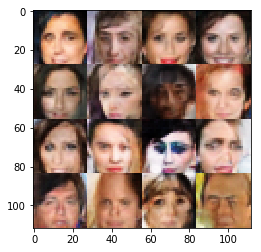

Epoch 6/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.7806... Generator Loss: 0.3202
Epoch 6/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.6327... Generator Loss: 0.3964
Epoch 6/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.3947... Generator Loss: 0.4931
Epoch 6/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.6192... Generator Loss: 0.3844
Epoch 6/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.4480... Generator Loss: 0.6863
Epoch 6/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.3857... Generator Loss: 0.1829
Epoch 6/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.3402... Generator Loss: 0.5643
Epoch 6/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2248... Generator Loss: 0.6376
Epoch 6/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.7932... Generator Loss: 0.3564
Epoch 6/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.2

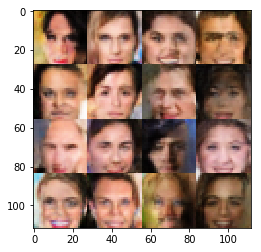

Epoch 6/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.4059... Generator Loss: 0.6236
Epoch 6/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.3417... Generator Loss: 0.6088
Epoch 6/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5731... Generator Loss: 0.4074
Epoch 6/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.1149... Generator Loss: 1.0939
Epoch 6/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.0612... Generator Loss: 0.2471
Epoch 6/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.6826... Generator Loss: 0.3740
Epoch 6/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.4218... Generator Loss: 0.6755
Epoch 6/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.3604... Generator Loss: 0.7508
Epoch 6/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.7735... Generator Loss: 1.2072
Epoch 6/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.6

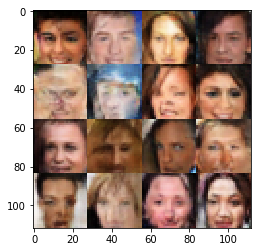

Epoch 6/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.2983... Generator Loss: 1.1727
Epoch 6/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.5536... Generator Loss: 0.4661
Epoch 6/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.9805... Generator Loss: 0.2527
Epoch 6/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.0552... Generator Loss: 0.8563
Epoch 6/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.0146... Generator Loss: 0.8512
Epoch 6/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.3805... Generator Loss: 0.1854
Epoch 6/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.8109... Generator Loss: 0.2908
Epoch 6/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.6501... Generator Loss: 0.3913
Epoch 6/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.3829... Generator Loss: 0.6381
Epoch 6/25...progress:97.88%....step:3700/3780... Discriminator Loss: 2.0

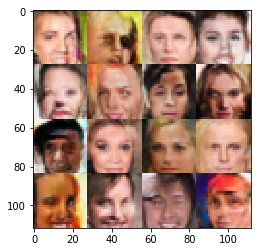

Epoch 7/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.3020... Generator Loss: 0.6217
Epoch 7/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8578... Generator Loss: 0.2884
Epoch 7/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.2502... Generator Loss: 0.7108
Epoch 7/25...progress:1.06%....step:40/3780... Discriminator Loss: 2.3818... Generator Loss: 0.1768
Epoch 7/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3324... Generator Loss: 0.5675
Epoch 7/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.9486... Generator Loss: 0.2865
Epoch 7/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.5753... Generator Loss: 0.3776
Epoch 7/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.4594... Generator Loss: 0.1722
Epoch 7/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.6500... Generator Loss: 0.3720
Epoch 7/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.7249... Generator Loss: 0.3344

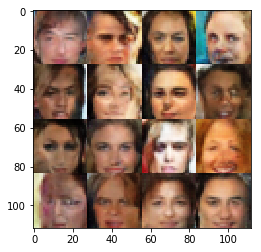

Epoch 7/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.3736... Generator Loss: 0.5904
Epoch 7/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.2897... Generator Loss: 1.0054
Epoch 7/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.6836... Generator Loss: 0.5085
Epoch 7/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.3401... Generator Loss: 0.1852
Epoch 7/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0336... Generator Loss: 0.8162
Epoch 7/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.1399... Generator Loss: 0.8664
Epoch 7/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.2256... Generator Loss: 0.2238
Epoch 7/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.8117... Generator Loss: 0.2944
Epoch 7/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2305... Generator Loss: 0.5963
Epoch 7/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.9637... Generator Los

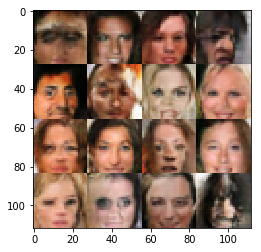

Epoch 7/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.1917... Generator Loss: 0.8177
Epoch 7/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.9990... Generator Loss: 0.2782
Epoch 7/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.5324... Generator Loss: 0.4506
Epoch 7/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1004... Generator Loss: 1.3102
Epoch 7/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.5077... Generator Loss: 0.4625
Epoch 7/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.5069... Generator Loss: 1.8541
Epoch 7/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.3492... Generator Loss: 0.5224
Epoch 7/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.3507... Generator Loss: 0.5447
Epoch 7/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.3401... Generator Loss: 0.1793
Epoch 7/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.4062... Gen

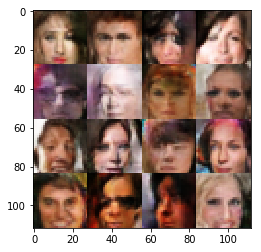

Epoch 7/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.5315... Generator Loss: 0.4468
Epoch 7/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.8495... Generator Loss: 0.3165
Epoch 7/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.4947... Generator Loss: 0.4301
Epoch 7/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.5303... Generator Loss: 0.4141
Epoch 7/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.0241... Generator Loss: 0.2469
Epoch 7/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.5859... Generator Loss: 0.4296
Epoch 7/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.3706... Generator Loss: 0.5188
Epoch 7/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.2796... Generator Loss: 0.1954
Epoch 7/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9044... Generator Loss: 0.2691
Epoch 7/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.8236... Gen

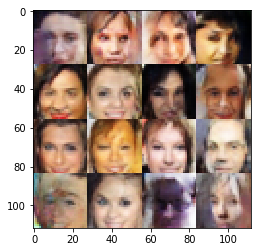

Epoch 7/25...progress:21.43%....step:810/3780... Discriminator Loss: 2.0746... Generator Loss: 0.2331
Epoch 7/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.8534... Generator Loss: 0.3244
Epoch 7/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1755... Generator Loss: 1.5180
Epoch 7/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7887... Generator Loss: 0.3447
Epoch 7/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.6077... Generator Loss: 0.3887
Epoch 7/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.4398... Generator Loss: 0.4920
Epoch 7/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.7283... Generator Loss: 0.3514
Epoch 7/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.2781... Generator Loss: 1.1271
Epoch 7/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.0740... Generator Loss: 0.2677
Epoch 7/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.4802... Gen

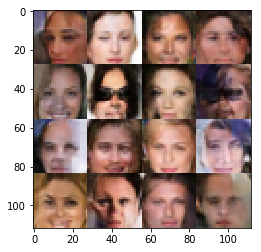

Epoch 7/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.6031... Generator Loss: 0.3996
Epoch 7/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.1120... Generator Loss: 0.2118
Epoch 7/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.7579... Generator Loss: 0.3027
Epoch 7/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2276... Generator Loss: 1.3059
Epoch 7/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.9084... Generator Loss: 0.2997
Epoch 7/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8309... Generator Loss: 1.1751
Epoch 7/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2317... Generator Loss: 1.5980
Epoch 7/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.4467... Generator Loss: 0.4776
Epoch 7/25...progress:28.84%....step:1090/3780... Discriminator Loss: 2.0861... Generator Loss: 0.2482
Epoch 7/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.3

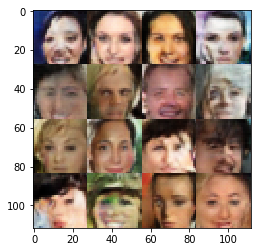

Epoch 7/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.4453... Generator Loss: 0.4886
Epoch 7/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.4562... Generator Loss: 0.4764
Epoch 7/25...progress:32.54%....step:1230/3780... Discriminator Loss: 0.9884... Generator Loss: 0.8909
Epoch 7/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.3294... Generator Loss: 0.5679
Epoch 7/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.5755... Generator Loss: 0.4069
Epoch 7/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.1783... Generator Loss: 0.6394
Epoch 7/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.5338... Generator Loss: 0.4152
Epoch 7/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1956... Generator Loss: 0.7009
Epoch 7/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3696... Generator Loss: 0.5277
Epoch 7/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.5

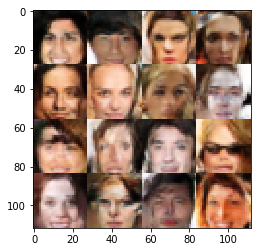

Epoch 7/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.9427... Generator Loss: 0.2604
Epoch 7/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.3590... Generator Loss: 0.6445
Epoch 7/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.2949... Generator Loss: 0.8220
Epoch 7/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.0973... Generator Loss: 0.2157
Epoch 7/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.0047... Generator Loss: 0.9608
Epoch 7/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.9367... Generator Loss: 0.2848
Epoch 7/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1646... Generator Loss: 0.7360
Epoch 7/25...progress:39.15%....step:1480/3780... Discriminator Loss: 2.1657... Generator Loss: 0.1965
Epoch 7/25...progress:39.42%....step:1490/3780... Discriminator Loss: 2.3357... Generator Loss: 2.1644
Epoch 7/25...progress:39.68%....step:1500/3780... Discriminator Loss: 1.4

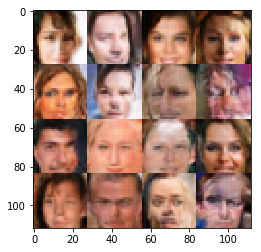

Epoch 7/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.1905... Generator Loss: 0.8428
Epoch 7/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.3901... Generator Loss: 0.6668
Epoch 7/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1251... Generator Loss: 0.8586
Epoch 7/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.4615... Generator Loss: 0.6044
Epoch 7/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.2933... Generator Loss: 0.6058
Epoch 7/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.3622... Generator Loss: 0.5902
Epoch 7/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.7950... Generator Loss: 1.2834
Epoch 7/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.0430... Generator Loss: 0.9833
Epoch 7/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.3994... Generator Loss: 0.1525
Epoch 7/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.2

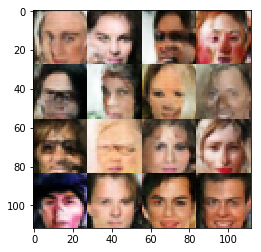

Epoch 7/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.4876... Generator Loss: 0.1604
Epoch 7/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.9118... Generator Loss: 0.2761
Epoch 7/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.8220... Generator Loss: 0.3064
Epoch 7/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4048... Generator Loss: 0.5804
Epoch 7/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.2875... Generator Loss: 0.6799
Epoch 7/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0010... Generator Loss: 0.2690
Epoch 7/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3437... Generator Loss: 0.7392
Epoch 7/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.8901... Generator Loss: 0.2853
Epoch 7/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5386... Generator Loss: 0.4057
Epoch 7/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.4

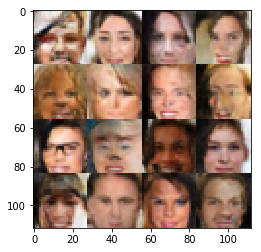

Epoch 7/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.7815... Generator Loss: 0.3330
Epoch 7/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.4958... Generator Loss: 0.4962
Epoch 7/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.2881... Generator Loss: 0.8504
Epoch 7/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.4406... Generator Loss: 0.5733
Epoch 7/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6957... Generator Loss: 0.4262
Epoch 7/25...progress:54.50%....step:2060/3780... Discriminator Loss: 2.0780... Generator Loss: 1.5036
Epoch 7/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.2213... Generator Loss: 0.7348
Epoch 7/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.6494... Generator Loss: 0.3864
Epoch 7/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.5101... Generator Loss: 0.5057
Epoch 7/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.5

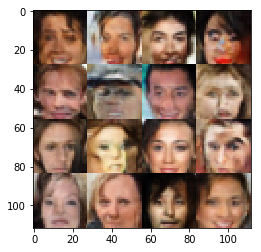

Epoch 7/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.0611... Generator Loss: 0.2375
Epoch 7/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.1749... Generator Loss: 0.8326
Epoch 7/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.0819... Generator Loss: 0.8906
Epoch 7/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.0425... Generator Loss: 1.3960
Epoch 7/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.4963... Generator Loss: 0.5083
Epoch 7/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5521... Generator Loss: 0.5279
Epoch 7/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9301... Generator Loss: 0.2945
Epoch 7/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.2950... Generator Loss: 0.5767
Epoch 7/25...progress:60.58%....step:2290/3780... Discriminator Loss: 0.9357... Generator Loss: 1.2217
Epoch 7/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.2

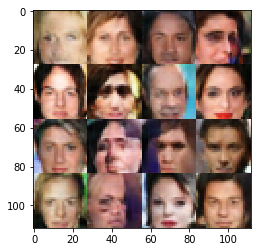

Epoch 7/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.5989... Generator Loss: 0.3959
Epoch 7/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.8050... Generator Loss: 0.3022
Epoch 7/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.2004... Generator Loss: 0.8961
Epoch 7/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4540... Generator Loss: 1.3928
Epoch 7/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5648... Generator Loss: 0.6761
Epoch 7/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.3071... Generator Loss: 0.5658
Epoch 7/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.0212... Generator Loss: 1.6427
Epoch 7/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.1593... Generator Loss: 0.7620
Epoch 7/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.0572... Generator Loss: 0.9438
Epoch 7/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.1

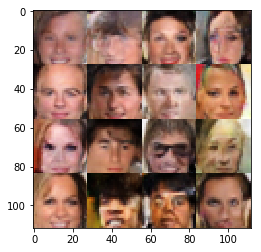

Epoch 7/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.4201... Generator Loss: 0.5153
Epoch 7/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5987... Generator Loss: 0.4043
Epoch 7/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.7555... Generator Loss: 0.3307
Epoch 7/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4806... Generator Loss: 0.7845
Epoch 7/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.3224... Generator Loss: 0.1880
Epoch 7/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.2621... Generator Loss: 0.1915
Epoch 7/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.8025... Generator Loss: 0.3097
Epoch 7/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.7851... Generator Loss: 0.3373
Epoch 7/25...progress:71.16%....step:2690/3780... Discriminator Loss: 0.9191... Generator Loss: 1.0707
Epoch 7/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.9

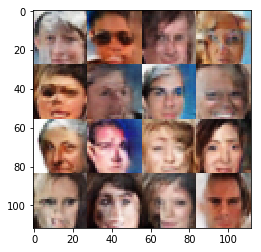

Epoch 7/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.9951... Generator Loss: 0.2477
Epoch 7/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.6146... Generator Loss: 0.3819
Epoch 7/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.4664... Generator Loss: 0.4748
Epoch 7/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2732... Generator Loss: 0.7037
Epoch 7/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.9630... Generator Loss: 0.2549
Epoch 7/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.5049... Generator Loss: 0.5118
Epoch 7/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.4095... Generator Loss: 0.9373
Epoch 7/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.2253... Generator Loss: 0.7067
Epoch 7/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.7973... Generator Loss: 0.3489
Epoch 7/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.7

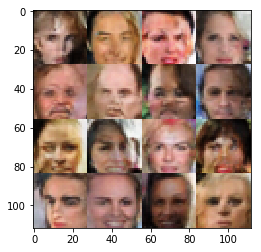

Epoch 7/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9706... Generator Loss: 1.1829
Epoch 7/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0858... Generator Loss: 0.8943
Epoch 7/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.7558... Generator Loss: 0.3394
Epoch 7/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.5976... Generator Loss: 0.4779
Epoch 7/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.0022... Generator Loss: 0.2590
Epoch 7/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.4235... Generator Loss: 1.2462
Epoch 7/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.7238... Generator Loss: 0.3610
Epoch 7/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.7602... Generator Loss: 0.3280
Epoch 7/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.0451... Generator Loss: 1.1127
Epoch 7/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.5

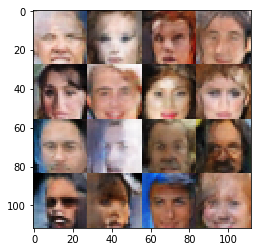

Epoch 7/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.8608... Generator Loss: 0.2893
Epoch 7/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.3465... Generator Loss: 0.5944
Epoch 7/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.0026... Generator Loss: 0.2559
Epoch 7/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.2014... Generator Loss: 0.8504
Epoch 7/25...progress:85.98%....step:3250/3780... Discriminator Loss: 2.1095... Generator Loss: 0.2384
Epoch 7/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.1197... Generator Loss: 0.2221
Epoch 7/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.0248... Generator Loss: 0.9713
Epoch 7/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.0758... Generator Loss: 0.8984
Epoch 7/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.0909... Generator Loss: 0.9351
Epoch 7/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.0

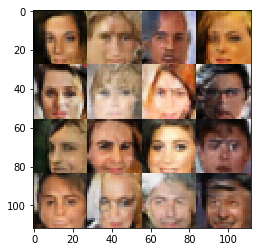

Epoch 7/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.4931... Generator Loss: 0.5178
Epoch 7/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.2899... Generator Loss: 0.6140
Epoch 7/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.7026... Generator Loss: 0.4388
Epoch 7/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.0468... Generator Loss: 1.1963
Epoch 7/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.9706... Generator Loss: 0.2747
Epoch 7/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.9700... Generator Loss: 0.2642
Epoch 7/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.6874... Generator Loss: 0.3686
Epoch 7/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.9270... Generator Loss: 0.2839
Epoch 7/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.3025... Generator Loss: 0.8673
Epoch 7/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.5

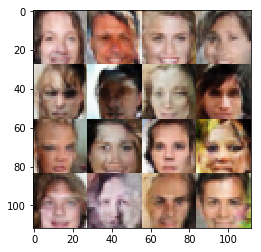

Epoch 7/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.6667... Generator Loss: 0.3657
Epoch 7/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.3378... Generator Loss: 0.5956
Epoch 7/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.6911... Generator Loss: 0.3733
Epoch 7/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.4711... Generator Loss: 0.5676
Epoch 7/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.0256... Generator Loss: 0.9427
Epoch 7/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.8428... Generator Loss: 0.3057
Epoch 7/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.7339... Generator Loss: 0.3210
Epoch 7/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.9310... Generator Loss: 0.3361
Epoch 7/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.2245... Generator Loss: 0.7675
Epoch 7/25...progress:97.88%....step:3700/3780... Discriminator Loss: 1.8

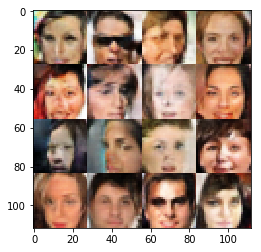

Epoch 8/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.6782... Generator Loss: 0.4136
Epoch 8/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.6137... Generator Loss: 0.3930
Epoch 8/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.0590... Generator Loss: 0.8090
Epoch 8/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.8886... Generator Loss: 0.2749
Epoch 8/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3598... Generator Loss: 0.6348
Epoch 8/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.3580... Generator Loss: 0.5934
Epoch 8/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.0909... Generator Loss: 0.9713
Epoch 8/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.9776... Generator Loss: 0.2685
Epoch 8/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.0330... Generator Loss: 1.1467
Epoch 8/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.6539... Generator Loss: 0.3768

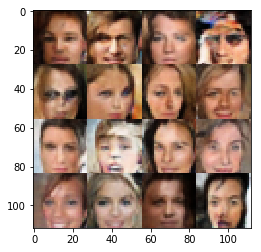

Epoch 8/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.5344... Generator Loss: 0.6877
Epoch 8/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.2890... Generator Loss: 1.1807
Epoch 8/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.4561... Generator Loss: 0.6571
Epoch 8/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.7829... Generator Loss: 0.3127
Epoch 8/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.5358... Generator Loss: 0.4779
Epoch 8/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3594... Generator Loss: 0.5890
Epoch 8/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.1299... Generator Loss: 0.2218
Epoch 8/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5135... Generator Loss: 0.4412
Epoch 8/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2160... Generator Loss: 0.7882
Epoch 8/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.7839... Generator Los

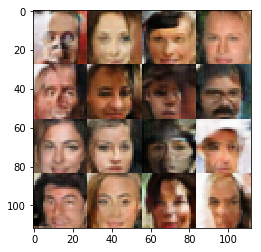

Epoch 8/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.3915... Generator Loss: 1.3375
Epoch 8/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.4839... Generator Loss: 0.7457
Epoch 8/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.1587... Generator Loss: 0.2173
Epoch 8/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.2765... Generator Loss: 0.6479
Epoch 8/25...progress:11.90%....step:450/3780... Discriminator Loss: 2.1862... Generator Loss: 0.2292
Epoch 8/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.4909... Generator Loss: 0.5482
Epoch 8/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.5313... Generator Loss: 0.4664
Epoch 8/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0077... Generator Loss: 1.0048
Epoch 8/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.9349... Generator Loss: 0.2856
Epoch 8/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.4160... Gen

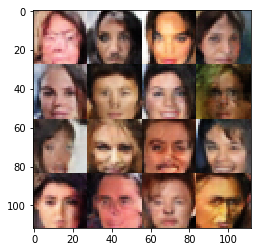

Epoch 8/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4511... Generator Loss: 0.6309
Epoch 8/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.6452... Generator Loss: 0.4256
Epoch 8/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.0779... Generator Loss: 0.9419
Epoch 8/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.8830... Generator Loss: 0.3073
Epoch 8/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.6049... Generator Loss: 0.3722
Epoch 8/25...progress:17.46%....step:660/3780... Discriminator Loss: 2.4022... Generator Loss: 0.1762
Epoch 8/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.6307... Generator Loss: 0.3781
Epoch 8/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.0538... Generator Loss: 0.2294
Epoch 8/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9030... Generator Loss: 0.2809
Epoch 8/25...progress:18.52%....step:700/3780... Discriminator Loss: 0.9972... Gen

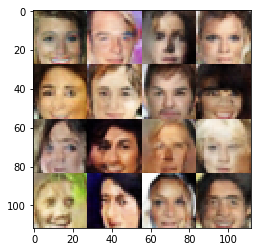

Epoch 8/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7990... Generator Loss: 0.3471
Epoch 8/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.7985... Generator Loss: 0.3364
Epoch 8/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.5721... Generator Loss: 1.2781
Epoch 8/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7332... Generator Loss: 0.3736
Epoch 8/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.4068... Generator Loss: 0.5113
Epoch 8/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7935... Generator Loss: 0.3094
Epoch 8/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.6439... Generator Loss: 0.4049
Epoch 8/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.3662... Generator Loss: 1.0775
Epoch 8/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.2567... Generator Loss: 0.1969
Epoch 8/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.6132... Gen

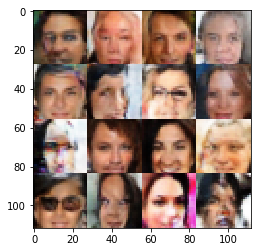

Epoch 8/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.8730... Generator Loss: 0.3025
Epoch 8/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.6883... Generator Loss: 0.3623
Epoch 8/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.9741... Generator Loss: 0.2755
Epoch 8/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2981... Generator Loss: 0.8893
Epoch 8/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.9461... Generator Loss: 0.2638
Epoch 8/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.9212... Generator Loss: 1.0118
Epoch 8/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.0652... Generator Loss: 0.8497
Epoch 8/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.9842... Generator Loss: 0.9484
Epoch 8/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.5284... Generator Loss: 0.4448
Epoch 8/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.3

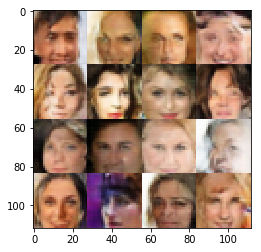

Epoch 8/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.3578... Generator Loss: 0.5423
Epoch 8/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.1769... Generator Loss: 0.7185
Epoch 8/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.0887... Generator Loss: 0.7545
Epoch 8/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.3391... Generator Loss: 0.5526
Epoch 8/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.1640... Generator Loss: 0.6907
Epoch 8/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.8324... Generator Loss: 0.2922
Epoch 8/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.8842... Generator Loss: 0.2873
Epoch 8/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.5646... Generator Loss: 0.4159
Epoch 8/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.4830... Generator Loss: 0.5054
Epoch 8/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.8

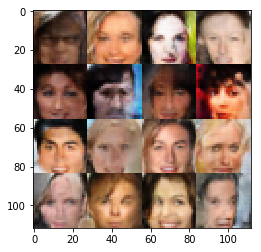

Epoch 8/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.3739... Generator Loss: 0.6022
Epoch 8/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0810... Generator Loss: 1.1251
Epoch 8/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.2710... Generator Loss: 0.7193
Epoch 8/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.6328... Generator Loss: 0.4507
Epoch 8/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.3430... Generator Loss: 0.5352
Epoch 8/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.9179... Generator Loss: 0.2873
Epoch 8/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.0877... Generator Loss: 0.8652
Epoch 8/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.6260... Generator Loss: 0.4178
Epoch 8/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2541... Generator Loss: 0.6027
Epoch 8/25...progress:39.68%....step:1500/3780... Discriminator Loss: 1.8

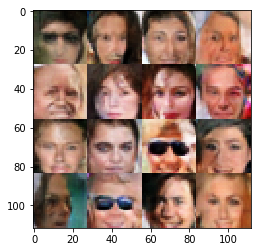

Epoch 8/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.1810... Generator Loss: 0.9800
Epoch 8/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1520... Generator Loss: 1.2553
Epoch 8/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1771... Generator Loss: 0.8830
Epoch 8/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.1135... Generator Loss: 0.7570
Epoch 8/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.8152... Generator Loss: 0.3146
Epoch 8/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.1062... Generator Loss: 1.0643
Epoch 8/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.9525... Generator Loss: 1.0066
Epoch 8/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.0968... Generator Loss: 0.9182
Epoch 8/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.0146... Generator Loss: 0.2517
Epoch 8/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.4

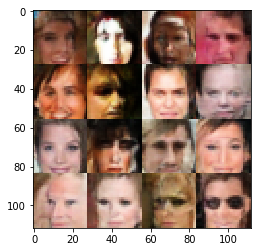

Epoch 8/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5068... Generator Loss: 0.4679
Epoch 8/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.4561... Generator Loss: 0.1490
Epoch 8/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.3811... Generator Loss: 0.5600
Epoch 8/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5673... Generator Loss: 0.4271
Epoch 8/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.1127... Generator Loss: 0.8322
Epoch 8/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.9473... Generator Loss: 0.2679
Epoch 8/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.4271... Generator Loss: 0.9565
Epoch 8/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.4119... Generator Loss: 0.5006
Epoch 8/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5706... Generator Loss: 0.8518
Epoch 8/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.8

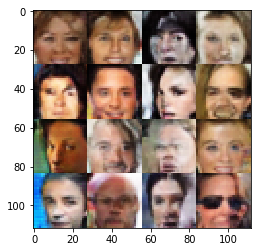

Epoch 8/25...progress:53.17%....step:2010/3780... Discriminator Loss: 2.2125... Generator Loss: 0.1923
Epoch 8/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.4490... Generator Loss: 0.5144
Epoch 8/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.3911... Generator Loss: 0.9540
Epoch 8/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.2314... Generator Loss: 0.6382
Epoch 8/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.4066... Generator Loss: 0.5489
Epoch 8/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3273... Generator Loss: 0.6420
Epoch 8/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.5745... Generator Loss: 0.4741
Epoch 8/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.3143... Generator Loss: 0.6690
Epoch 8/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2782... Generator Loss: 1.2918
Epoch 8/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.3

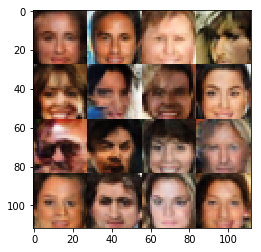

Epoch 8/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.2159... Generator Loss: 0.2235
Epoch 8/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.4092... Generator Loss: 0.5106
Epoch 8/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.4876... Generator Loss: 0.4696
Epoch 8/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.7809... Generator Loss: 0.3235
Epoch 8/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.4513... Generator Loss: 0.4866
Epoch 8/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5094... Generator Loss: 0.6356
Epoch 8/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.2504... Generator Loss: 0.7155
Epoch 8/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.5158... Generator Loss: 0.4998
Epoch 8/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.3599... Generator Loss: 1.1349
Epoch 8/25...progress:60.85%....step:2300/3780... Discriminator Loss: 0.9

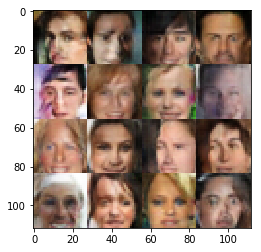

Epoch 8/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.9134... Generator Loss: 0.9676
Epoch 8/25...progress:64.02%....step:2420/3780... Discriminator Loss: 2.4085... Generator Loss: 0.1555
Epoch 8/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.7235... Generator Loss: 0.3430
Epoch 8/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.9007... Generator Loss: 0.6865
Epoch 8/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.4329... Generator Loss: 0.4884
Epoch 8/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.2301... Generator Loss: 0.6533
Epoch 8/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.1086... Generator Loss: 0.2166
Epoch 8/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.5841... Generator Loss: 0.4237
Epoch 8/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8030... Generator Loss: 2.0044
Epoch 8/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.8

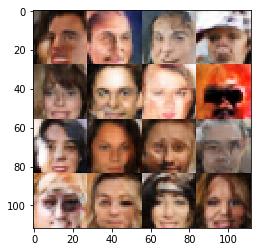

Epoch 8/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.5193... Generator Loss: 0.4743
Epoch 8/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.6989... Generator Loss: 0.6267
Epoch 8/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.8201... Generator Loss: 0.3205
Epoch 8/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.5529... Generator Loss: 0.7517
Epoch 8/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.1892... Generator Loss: 0.7481
Epoch 8/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9397... Generator Loss: 0.2590
Epoch 8/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.6889... Generator Loss: 0.3554
Epoch 8/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.7921... Generator Loss: 0.3710
Epoch 8/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.0168... Generator Loss: 1.0127
Epoch 8/25...progress:71.43%....step:2700/3780... Discriminator Loss: 1.7

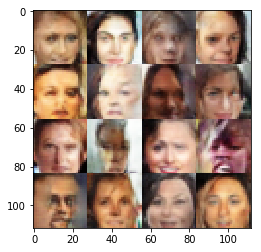

Epoch 8/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.7564... Generator Loss: 0.3317
Epoch 8/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.6708... Generator Loss: 0.4646
Epoch 8/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.2807... Generator Loss: 0.6136
Epoch 8/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2259... Generator Loss: 0.8038
Epoch 8/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.4541... Generator Loss: 0.1527
Epoch 8/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.7161... Generator Loss: 0.3424
Epoch 8/25...progress:75.93%....step:2870/3780... Discriminator Loss: 2.0272... Generator Loss: 0.2518
Epoch 8/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.1391... Generator Loss: 1.2705
Epoch 8/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.5124... Generator Loss: 0.5746
Epoch 8/25...progress:76.72%....step:2900/3780... Discriminator Loss: 1.6

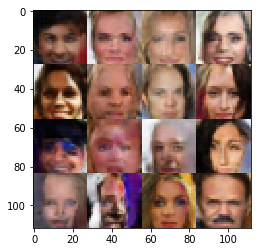

Epoch 8/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9764... Generator Loss: 1.4081
Epoch 8/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.3387... Generator Loss: 0.5788
Epoch 8/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.7056... Generator Loss: 0.3667
Epoch 8/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.6231... Generator Loss: 0.4946
Epoch 8/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.7733... Generator Loss: 0.3765
Epoch 8/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.4091... Generator Loss: 0.6801
Epoch 8/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.3694... Generator Loss: 0.5938
Epoch 8/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0468... Generator Loss: 0.2374
Epoch 8/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3620... Generator Loss: 0.5414
Epoch 8/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.3

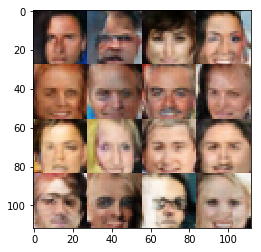

Epoch 8/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.0554... Generator Loss: 0.2596
Epoch 8/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.4330... Generator Loss: 0.4930
Epoch 8/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.9942... Generator Loss: 0.2426
Epoch 8/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.2917... Generator Loss: 0.1810
Epoch 8/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.7369... Generator Loss: 0.3477
Epoch 8/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.1681... Generator Loss: 0.2048
Epoch 8/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.5333... Generator Loss: 0.4631
Epoch 8/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.1931... Generator Loss: 0.7179
Epoch 8/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.3612... Generator Loss: 0.5931
Epoch 8/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.1

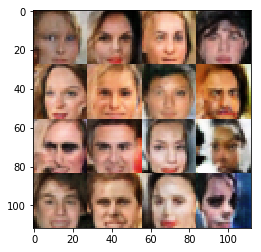

Epoch 8/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.4949... Generator Loss: 0.4992
Epoch 8/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.6269... Generator Loss: 0.4093
Epoch 8/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.1054... Generator Loss: 0.8743
Epoch 8/25...progress:91.01%....step:3440/3780... Discriminator Loss: 2.0357... Generator Loss: 0.2889
Epoch 8/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.5856... Generator Loss: 0.3815
Epoch 8/25...progress:91.53%....step:3460/3780... Discriminator Loss: 2.2587... Generator Loss: 0.1881
Epoch 8/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2986... Generator Loss: 0.6842
Epoch 8/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.4059... Generator Loss: 0.7355
Epoch 8/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.9223... Generator Loss: 0.2559
Epoch 8/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.6

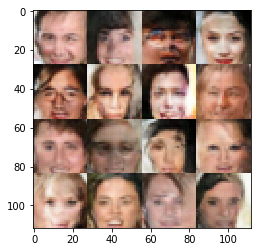

Epoch 8/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.5061... Generator Loss: 0.5343
Epoch 8/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.5987... Generator Loss: 0.4355
Epoch 8/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.7607... Generator Loss: 0.3461
Epoch 8/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.3909... Generator Loss: 2.5353
Epoch 8/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.2130... Generator Loss: 0.8427
Epoch 8/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.3503... Generator Loss: 0.1701
Epoch 8/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.6793... Generator Loss: 0.4025
Epoch 8/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.8943... Generator Loss: 0.3153
Epoch 8/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.5998... Generator Loss: 0.4903
Epoch 8/25...progress:97.88%....step:3700/3780... Discriminator Loss: 2.2

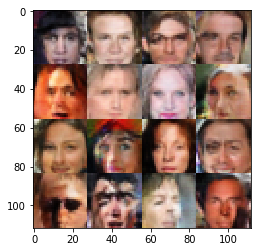

Epoch 9/25...progress:0.26%....step:10/3780... Discriminator Loss: 2.0335... Generator Loss: 0.2506
Epoch 9/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.2622... Generator Loss: 0.2163
Epoch 9/25...progress:0.79%....step:30/3780... Discriminator Loss: 2.2834... Generator Loss: 0.1934
Epoch 9/25...progress:1.06%....step:40/3780... Discriminator Loss: 2.1876... Generator Loss: 0.2085
Epoch 9/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.1699... Generator Loss: 0.9186
Epoch 9/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.7643... Generator Loss: 0.3512
Epoch 9/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.6144... Generator Loss: 0.4192
Epoch 9/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.0034... Generator Loss: 0.2434
Epoch 9/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.8663... Generator Loss: 0.3308
Epoch 9/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.8662... Generator Loss: 0.3197

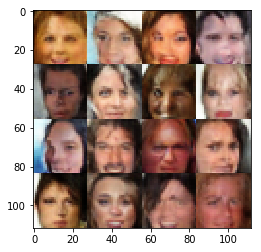

Epoch 9/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4881... Generator Loss: 0.4640
Epoch 9/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.4935... Generator Loss: 0.4623
Epoch 9/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.7436... Generator Loss: 0.3421
Epoch 9/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.3278... Generator Loss: 0.1640
Epoch 9/25...progress:6.61%....step:250/3780... Discriminator Loss: 0.8668... Generator Loss: 1.0173
Epoch 9/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3313... Generator Loss: 1.6506
Epoch 9/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.1098... Generator Loss: 0.2207
Epoch 9/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5985... Generator Loss: 0.7312
Epoch 9/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.5674... Generator Loss: 0.4589
Epoch 9/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.0364... Generator Los

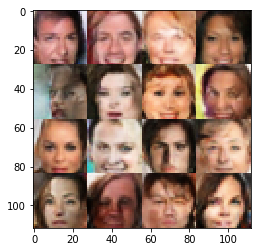

Epoch 9/25...progress:10.85%....step:410/3780... Discriminator Loss: 2.2899... Generator Loss: 2.1540
Epoch 9/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.3394... Generator Loss: 0.7216
Epoch 9/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.0229... Generator Loss: 0.2409
Epoch 9/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.2437... Generator Loss: 0.9068
Epoch 9/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.9804... Generator Loss: 0.2642
Epoch 9/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.2401... Generator Loss: 0.8519
Epoch 9/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2861... Generator Loss: 0.6853
Epoch 9/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0548... Generator Loss: 0.8823
Epoch 9/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.6940... Generator Loss: 0.1317
Epoch 9/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.7032... Gen

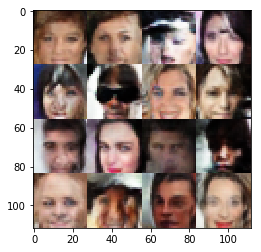

Epoch 9/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4392... Generator Loss: 0.6171
Epoch 9/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.1441... Generator Loss: 0.2109
Epoch 9/25...progress:16.67%....step:630/3780... Discriminator Loss: 0.8344... Generator Loss: 1.1764
Epoch 9/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.9834... Generator Loss: 0.2805
Epoch 9/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.8660... Generator Loss: 0.2860
Epoch 9/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.9399... Generator Loss: 0.2926
Epoch 9/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.2813... Generator Loss: 1.2505
Epoch 9/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.1806... Generator Loss: 0.2328
Epoch 9/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.5217... Generator Loss: 0.4731
Epoch 9/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.0299... Gen

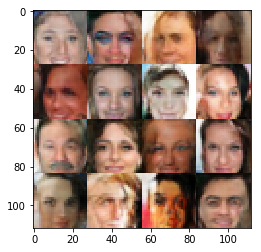

Epoch 9/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.9647... Generator Loss: 0.3602
Epoch 9/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.7347... Generator Loss: 0.3827
Epoch 9/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.2695... Generator Loss: 0.6415
Epoch 9/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.9293... Generator Loss: 0.2962
Epoch 9/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.1994... Generator Loss: 0.6807
Epoch 9/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7106... Generator Loss: 0.3603
Epoch 9/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.0812... Generator Loss: 0.9130
Epoch 9/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.7963... Generator Loss: 0.3710
Epoch 9/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.5653... Generator Loss: 0.1479
Epoch 9/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.4985... Gen

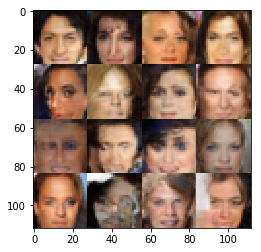

Epoch 9/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.0298... Generator Loss: 0.2526
Epoch 9/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.2428... Generator Loss: 0.2101
Epoch 9/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.7849... Generator Loss: 0.3638
Epoch 9/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.7546... Generator Loss: 0.3534
Epoch 9/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.6313... Generator Loss: 0.3927
Epoch 9/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.0956... Generator Loss: 0.7952
Epoch 9/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1216... Generator Loss: 1.3152
Epoch 9/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.3218... Generator Loss: 0.5758
Epoch 9/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.7623... Generator Loss: 0.3563
Epoch 9/25...progress:29.10%....step:1100/3780... Discriminator Loss: 1.6

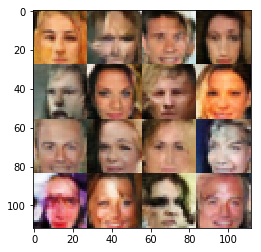

Epoch 9/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.4407... Generator Loss: 0.4851
Epoch 9/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.7797... Generator Loss: 0.3116
Epoch 9/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.2435... Generator Loss: 0.7293
Epoch 9/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.5957... Generator Loss: 0.4701
Epoch 9/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.3377... Generator Loss: 0.5733
Epoch 9/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.5395... Generator Loss: 0.4152
Epoch 9/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.8254... Generator Loss: 0.2983
Epoch 9/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.0911... Generator Loss: 0.8483
Epoch 9/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.6867... Generator Loss: 0.3718
Epoch 9/25...progress:34.39%....step:1300/3780... Discriminator Loss: 1.7

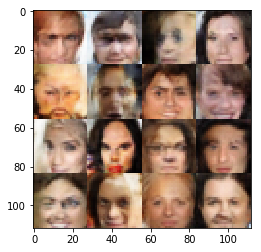

Epoch 9/25...progress:37.30%....step:1410/3780... Discriminator Loss: 2.1515... Generator Loss: 0.2159
Epoch 9/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0570... Generator Loss: 0.8965
Epoch 9/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.5551... Generator Loss: 0.4530
Epoch 9/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.8542... Generator Loss: 0.3403
Epoch 9/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.0370... Generator Loss: 1.1220
Epoch 9/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.5370... Generator Loss: 0.4362
Epoch 9/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1777... Generator Loss: 0.7245
Epoch 9/25...progress:39.15%....step:1480/3780... Discriminator Loss: 2.1799... Generator Loss: 0.2251
Epoch 9/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2677... Generator Loss: 0.7097
Epoch 9/25...progress:39.68%....step:1500/3780... Discriminator Loss: 2.1

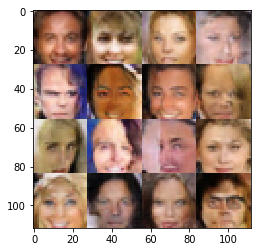

Epoch 9/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.1998... Generator Loss: 0.9635
Epoch 9/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.3377... Generator Loss: 0.9695
Epoch 9/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.3438... Generator Loss: 0.5737
Epoch 9/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.3701... Generator Loss: 0.5466
Epoch 9/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3308... Generator Loss: 0.5845
Epoch 9/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.6986... Generator Loss: 0.3461
Epoch 9/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.1297... Generator Loss: 0.7063
Epoch 9/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4246... Generator Loss: 0.4952
Epoch 9/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.3916... Generator Loss: 0.1569
Epoch 9/25...progress:44.97%....step:1700/3780... Discriminator Loss: 1.1

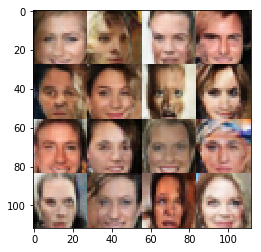

Epoch 9/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.6872... Generator Loss: 0.3760
Epoch 9/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.9370... Generator Loss: 0.2629
Epoch 9/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.7419... Generator Loss: 0.3726
Epoch 9/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.8269... Generator Loss: 0.2957
Epoch 9/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0998... Generator Loss: 0.7798
Epoch 9/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0542... Generator Loss: 0.2644
Epoch 9/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.1959... Generator Loss: 0.8325
Epoch 9/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.2735... Generator Loss: 0.1911
Epoch 9/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5720... Generator Loss: 0.4576
Epoch 9/25...progress:50.26%....step:1900/3780... Discriminator Loss: 1.3

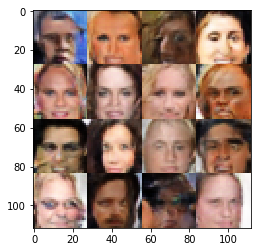

Epoch 9/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.3593... Generator Loss: 1.2209
Epoch 9/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6334... Generator Loss: 0.4257
Epoch 9/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.3463... Generator Loss: 0.7481
Epoch 9/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.6404... Generator Loss: 0.3992
Epoch 9/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6803... Generator Loss: 0.3746
Epoch 9/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3475... Generator Loss: 1.6891
Epoch 9/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.4115... Generator Loss: 0.5229
Epoch 9/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.4812... Generator Loss: 0.4510
Epoch 9/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2164... Generator Loss: 0.9480
Epoch 9/25...progress:55.56%....step:2100/3780... Discriminator Loss: 1.9

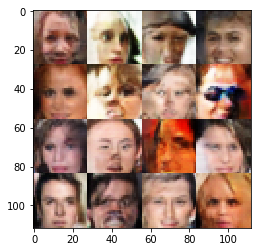

Epoch 9/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.3111... Generator Loss: 0.2158
Epoch 9/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.3946... Generator Loss: 0.9300
Epoch 9/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.6541... Generator Loss: 0.4831
Epoch 9/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.3729... Generator Loss: 0.5931
Epoch 9/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.2471... Generator Loss: 0.6435
Epoch 9/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.3447... Generator Loss: 0.8653
Epoch 9/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9099... Generator Loss: 0.3169
Epoch 9/25...progress:60.32%....step:2280/3780... Discriminator Loss: 2.0487... Generator Loss: 0.2505
Epoch 9/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.2125... Generator Loss: 0.9299
Epoch 9/25...progress:60.85%....step:2300/3780... Discriminator Loss: 1.0

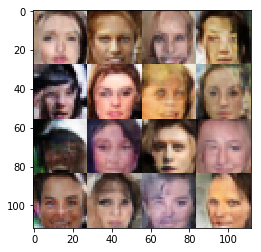

Epoch 9/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.9897... Generator Loss: 1.3941
Epoch 9/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.5357... Generator Loss: 0.4988
Epoch 9/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.5445... Generator Loss: 0.4430
Epoch 9/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.2132... Generator Loss: 1.0718
Epoch 9/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5724... Generator Loss: 0.4868
Epoch 9/25...progress:65.08%....step:2460/3780... Discriminator Loss: 2.0478... Generator Loss: 0.2399
Epoch 9/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.4114... Generator Loss: 0.1622
Epoch 9/25...progress:65.61%....step:2480/3780... Discriminator Loss: 2.1183... Generator Loss: 0.2368
Epoch 9/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9494... Generator Loss: 1.2703
Epoch 9/25...progress:66.14%....step:2500/3780... Discriminator Loss: 1.0

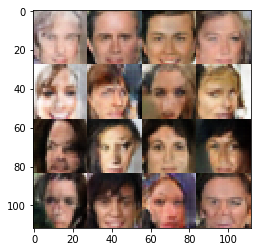

Epoch 9/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.4974... Generator Loss: 0.4518
Epoch 9/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.7615... Generator Loss: 0.3303
Epoch 9/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.2950... Generator Loss: 0.1972
Epoch 9/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4556... Generator Loss: 0.9637
Epoch 9/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.4623... Generator Loss: 0.4920
Epoch 9/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.7504... Generator Loss: 0.3412
Epoch 9/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.8813... Generator Loss: 0.3020
Epoch 9/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6567... Generator Loss: 0.3774
Epoch 9/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.0236... Generator Loss: 0.9716
Epoch 9/25...progress:71.43%....step:2700/3780... Discriminator Loss: 2.1

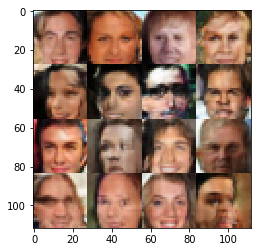

Epoch 9/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.6952... Generator Loss: 0.4376
Epoch 9/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4677... Generator Loss: 0.5290
Epoch 9/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.2043... Generator Loss: 0.6939
Epoch 9/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.8607... Generator Loss: 0.2994
Epoch 9/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.9240... Generator Loss: 0.2581
Epoch 9/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.6330... Generator Loss: 0.4607
Epoch 9/25...progress:75.93%....step:2870/3780... Discriminator Loss: 2.1960... Generator Loss: 0.2125
Epoch 9/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.1710... Generator Loss: 0.7351
Epoch 9/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.2334... Generator Loss: 1.1435
Epoch 9/25...progress:76.72%....step:2900/3780... Discriminator Loss: 2.1

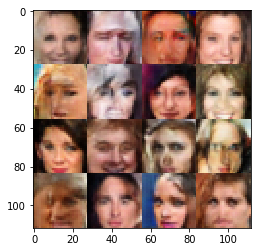

Epoch 9/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.1802... Generator Loss: 1.2433
Epoch 9/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.6745... Generator Loss: 0.4488
Epoch 9/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.4888... Generator Loss: 0.5318
Epoch 9/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8319... Generator Loss: 0.3009
Epoch 9/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.6549... Generator Loss: 0.4375
Epoch 9/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.3273... Generator Loss: 0.7430
Epoch 9/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2173... Generator Loss: 0.7209
Epoch 9/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0925... Generator Loss: 0.2274
Epoch 9/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.4513... Generator Loss: 0.4902
Epoch 9/25...progress:82.01%....step:3100/3780... Discriminator Loss: 1.3

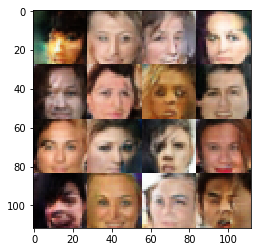

Epoch 9/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.5670... Generator Loss: 0.4341
Epoch 9/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.7836... Generator Loss: 0.3813
Epoch 9/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.2220... Generator Loss: 0.1977
Epoch 9/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.6244... Generator Loss: 0.3857
Epoch 9/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.5388... Generator Loss: 0.5589
Epoch 9/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.2512... Generator Loss: 0.1961
Epoch 9/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.6026... Generator Loss: 0.4111
Epoch 9/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2842... Generator Loss: 0.5545
Epoch 9/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.0395... Generator Loss: 1.1246
Epoch 9/25...progress:87.30%....step:3300/3780... Discriminator Loss: 1.2

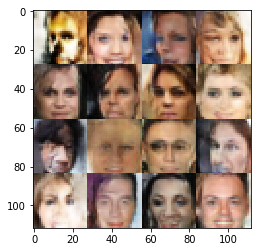

Epoch 9/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.6214... Generator Loss: 0.4084
Epoch 9/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.2706... Generator Loss: 0.5677
Epoch 9/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.3779... Generator Loss: 0.5958
Epoch 9/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.3089... Generator Loss: 0.8277
Epoch 9/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.6257... Generator Loss: 0.3657
Epoch 9/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.5507... Generator Loss: 0.4178
Epoch 9/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.6917... Generator Loss: 0.6295
Epoch 9/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.5831... Generator Loss: 0.5015
Epoch 9/25...progress:92.33%....step:3490/3780... Discriminator Loss: 2.0863... Generator Loss: 0.2947
Epoch 9/25...progress:92.59%....step:3500/3780... Discriminator Loss: 1.3

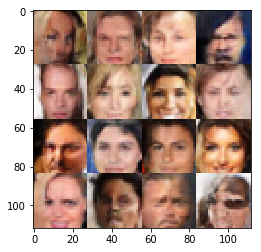

Epoch 9/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.2832... Generator Loss: 0.8264
Epoch 9/25...progress:95.77%....step:3620/3780... Discriminator Loss: 2.1641... Generator Loss: 0.2041
Epoch 9/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.1100... Generator Loss: 0.2300
Epoch 9/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.2392... Generator Loss: 0.7146
Epoch 9/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.8715... Generator Loss: 1.0317
Epoch 9/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.5683... Generator Loss: 0.4729
Epoch 9/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.8626... Generator Loss: 0.3162
Epoch 9/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.8945... Generator Loss: 0.2897
Epoch 9/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.1278... Generator Loss: 0.2346
Epoch 9/25...progress:97.88%....step:3700/3780... Discriminator Loss: 2.3

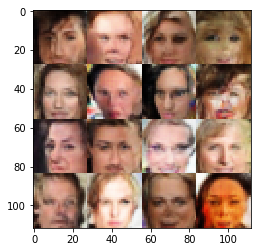

Epoch 10/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.4628... Generator Loss: 0.9789
Epoch 10/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.3743... Generator Loss: 0.1934
Epoch 10/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.8101... Generator Loss: 0.3526
Epoch 10/25...progress:1.06%....step:40/3780... Discriminator Loss: 2.3193... Generator Loss: 0.1914
Epoch 10/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.8030... Generator Loss: 0.9858
Epoch 10/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.8549... Generator Loss: 0.2675
Epoch 10/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.3788... Generator Loss: 0.5638
Epoch 10/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.5165... Generator Loss: 0.4477
Epoch 10/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.2596... Generator Loss: 0.6261
Epoch 10/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.6400... Generator Lo

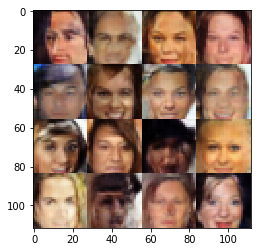

Epoch 10/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4556... Generator Loss: 0.5211
Epoch 10/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.4493... Generator Loss: 0.5095
Epoch 10/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.7112... Generator Loss: 0.4293
Epoch 10/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.7024... Generator Loss: 0.3952
Epoch 10/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0070... Generator Loss: 0.9148
Epoch 10/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.0715... Generator Loss: 1.0139
Epoch 10/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.6754... Generator Loss: 0.3485
Epoch 10/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.8775... Generator Loss: 0.3361
Epoch 10/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.7997... Generator Loss: 0.3368
Epoch 10/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.9045... Gen

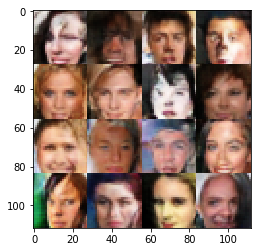

Epoch 10/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.6049... Generator Loss: 0.4684
Epoch 10/25...progress:11.11%....step:420/3780... Discriminator Loss: 0.9975... Generator Loss: 1.3097
Epoch 10/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.8752... Generator Loss: 0.3075
Epoch 10/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.4299... Generator Loss: 1.2160
Epoch 10/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.4391... Generator Loss: 0.4826
Epoch 10/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.5426... Generator Loss: 0.4696
Epoch 10/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.1483... Generator Loss: 0.7073
Epoch 10/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.6550... Generator Loss: 0.4131
Epoch 10/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.8062... Generator Loss: 0.3178
Epoch 10/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.5

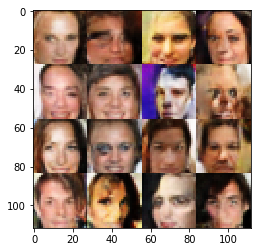

Epoch 10/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4910... Generator Loss: 0.5465
Epoch 10/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.2208... Generator Loss: 0.6664
Epoch 10/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.4619... Generator Loss: 0.4990
Epoch 10/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.4737... Generator Loss: 0.4712
Epoch 10/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.6766... Generator Loss: 0.3507
Epoch 10/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.6783... Generator Loss: 0.3631
Epoch 10/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5853... Generator Loss: 0.4614
Epoch 10/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.5509... Generator Loss: 0.1397
Epoch 10/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.2297... Generator Loss: 0.8700
Epoch 10/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.1

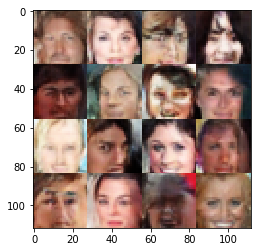

Epoch 10/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5095... Generator Loss: 0.4906
Epoch 10/25...progress:21.69%....step:820/3780... Discriminator Loss: 2.3493... Generator Loss: 0.1869
Epoch 10/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.3767... Generator Loss: 0.6189
Epoch 10/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7911... Generator Loss: 0.3242
Epoch 10/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.3775... Generator Loss: 0.5198
Epoch 10/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.9007... Generator Loss: 0.3192
Epoch 10/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.4860... Generator Loss: 0.4935
Epoch 10/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.3042... Generator Loss: 0.8612
Epoch 10/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.1679... Generator Loss: 0.2359
Epoch 10/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

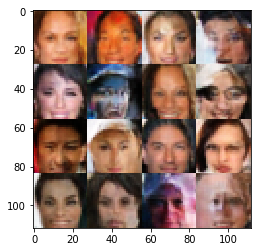

Epoch 10/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.8920... Generator Loss: 0.3240
Epoch 10/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.1324... Generator Loss: 0.2308
Epoch 10/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.8087... Generator Loss: 0.3551
Epoch 10/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.4582... Generator Loss: 0.4744
Epoch 10/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.1000... Generator Loss: 0.2205
Epoch 10/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8497... Generator Loss: 1.1208
Epoch 10/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.7212... Generator Loss: 1.3522
Epoch 10/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.1265... Generator Loss: 0.8915
Epoch 10/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.6008... Generator Loss: 0.4263
Epoch 10/25...progress:29.10%....step:1100/3780... Discriminator

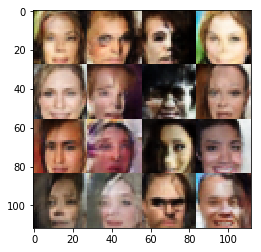

Epoch 10/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.0670... Generator Loss: 0.8192
Epoch 10/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.4238... Generator Loss: 0.5117
Epoch 10/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.0532... Generator Loss: 0.7896
Epoch 10/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.4168... Generator Loss: 0.5710
Epoch 10/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.7175... Generator Loss: 0.3573
Epoch 10/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.3854... Generator Loss: 0.5289
Epoch 10/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.7064... Generator Loss: 0.3947
Epoch 10/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1601... Generator Loss: 0.8358
Epoch 10/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.2283... Generator Loss: 0.6452
Epoch 10/25...progress:34.39%....step:1300/3780... Discriminator

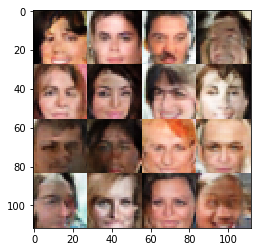

Epoch 10/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.1850... Generator Loss: 0.9925
Epoch 10/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0109... Generator Loss: 0.8837
Epoch 10/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.5157... Generator Loss: 0.4205
Epoch 10/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.9133... Generator Loss: 0.2747
Epoch 10/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.0122... Generator Loss: 0.9738
Epoch 10/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.8443... Generator Loss: 0.3101
Epoch 10/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.5150... Generator Loss: 0.5633
Epoch 10/25...progress:39.15%....step:1480/3780... Discriminator Loss: 2.2075... Generator Loss: 0.2049
Epoch 10/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.3842... Generator Loss: 0.5956
Epoch 10/25...progress:39.68%....step:1500/3780... Discriminator

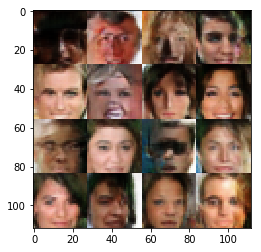

Epoch 10/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.1853... Generator Loss: 0.9693
Epoch 10/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.2252... Generator Loss: 0.9988
Epoch 10/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1670... Generator Loss: 1.2680
Epoch 10/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.5588... Generator Loss: 0.6320
Epoch 10/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3938... Generator Loss: 0.5316
Epoch 10/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.2106... Generator Loss: 0.9484
Epoch 10/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.2040... Generator Loss: 0.8854
Epoch 10/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.1840... Generator Loss: 0.7816
Epoch 10/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.2891... Generator Loss: 0.1849
Epoch 10/25...progress:44.97%....step:1700/3780... Discriminator

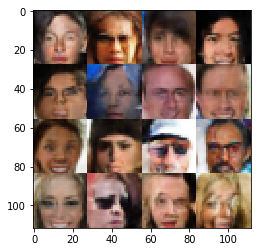

Epoch 10/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5518... Generator Loss: 0.4968
Epoch 10/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.1087... Generator Loss: 0.2257
Epoch 10/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.4305... Generator Loss: 0.4837
Epoch 10/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.8142... Generator Loss: 0.3128
Epoch 10/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0524... Generator Loss: 0.8131
Epoch 10/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0748... Generator Loss: 0.2343
Epoch 10/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.2440... Generator Loss: 0.7561
Epoch 10/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.0151... Generator Loss: 0.2557
Epoch 10/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.2760... Generator Loss: 0.7604
Epoch 10/25...progress:50.26%....step:1900/3780... Discriminator

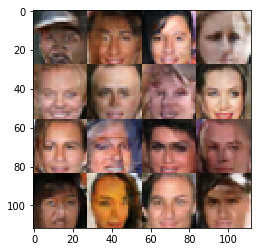

Epoch 10/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.3330... Generator Loss: 0.5837
Epoch 10/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.7430... Generator Loss: 0.4152
Epoch 10/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.4460... Generator Loss: 0.6294
Epoch 10/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.1981... Generator Loss: 0.7785
Epoch 10/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.9816... Generator Loss: 0.2437
Epoch 10/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.1593... Generator Loss: 1.0081
Epoch 10/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.8417... Generator Loss: 0.3104
Epoch 10/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.3540... Generator Loss: 0.5759
Epoch 10/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.5032... Generator Loss: 0.8352
Epoch 10/25...progress:55.56%....step:2100/3780... Discriminator

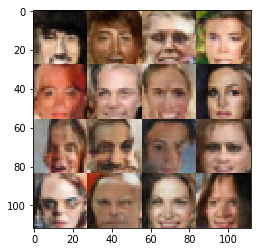

Epoch 10/25...progress:58.47%....step:2210/3780... Discriminator Loss: 1.7005... Generator Loss: 0.3271
Epoch 10/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.4053... Generator Loss: 0.5263
Epoch 10/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.7134... Generator Loss: 0.4183
Epoch 10/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.5129... Generator Loss: 0.4218
Epoch 10/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.5082... Generator Loss: 0.4531
Epoch 10/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5337... Generator Loss: 0.5302
Epoch 10/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.9318... Generator Loss: 0.1157
Epoch 10/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.5431... Generator Loss: 0.5138
Epoch 10/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4106... Generator Loss: 1.4005
Epoch 10/25...progress:60.85%....step:2300/3780... Discriminator

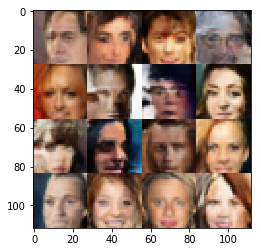

Epoch 10/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.7986... Generator Loss: 1.1519
Epoch 10/25...progress:64.02%....step:2420/3780... Discriminator Loss: 2.1679... Generator Loss: 0.2182
Epoch 10/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.9355... Generator Loss: 0.2826
Epoch 10/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.6379... Generator Loss: 0.4756
Epoch 10/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5454... Generator Loss: 0.4303
Epoch 10/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5346... Generator Loss: 0.4711
Epoch 10/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.0638... Generator Loss: 0.2372
Epoch 10/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.2609... Generator Loss: 0.6172
Epoch 10/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9817... Generator Loss: 0.9862
Epoch 10/25...progress:66.14%....step:2500/3780... Discriminator

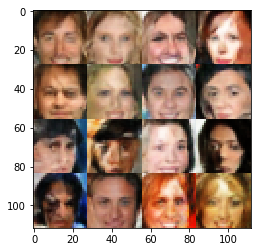

Epoch 10/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.3766... Generator Loss: 0.5474
Epoch 10/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.9077... Generator Loss: 0.3157
Epoch 10/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.9156... Generator Loss: 0.2926
Epoch 10/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.8007... Generator Loss: 0.3898
Epoch 10/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7195... Generator Loss: 0.4790
Epoch 10/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9217... Generator Loss: 0.2704
Epoch 10/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.6113... Generator Loss: 0.4293
Epoch 10/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6603... Generator Loss: 0.4203
Epoch 10/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.7049... Generator Loss: 0.3910
Epoch 10/25...progress:71.43%....step:2700/3780... Discriminator

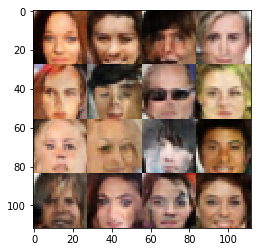

Epoch 10/25...progress:74.34%....step:2810/3780... Discriminator Loss: 2.0697... Generator Loss: 0.2437
Epoch 10/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.2810... Generator Loss: 0.6930
Epoch 10/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.1600... Generator Loss: 0.9295
Epoch 10/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.1670... Generator Loss: 1.1282
Epoch 10/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.8975... Generator Loss: 0.2818
Epoch 10/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.6922... Generator Loss: 0.3410
Epoch 10/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.4072... Generator Loss: 0.4953
Epoch 10/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.7160... Generator Loss: 0.3486
Epoch 10/25...progress:76.46%....step:2890/3780... Discriminator Loss: 2.0416... Generator Loss: 0.2294
Epoch 10/25...progress:76.72%....step:2900/3780... Discriminator

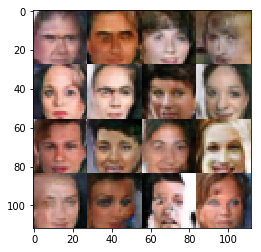

Epoch 10/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0604... Generator Loss: 0.8261
Epoch 10/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.3541... Generator Loss: 0.5336
Epoch 10/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.8045... Generator Loss: 0.3432
Epoch 10/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8973... Generator Loss: 0.2728
Epoch 10/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.4404... Generator Loss: 0.6539
Epoch 10/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.8770... Generator Loss: 0.3113
Epoch 10/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1966... Generator Loss: 0.7263
Epoch 10/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.8635... Generator Loss: 0.2898
Epoch 10/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.5110... Generator Loss: 0.4413
Epoch 10/25...progress:82.01%....step:3100/3780... Discriminator

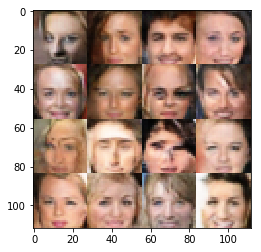

Epoch 10/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.8874... Generator Loss: 0.3025
Epoch 10/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.4905... Generator Loss: 0.4520
Epoch 10/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.4731... Generator Loss: 0.4599
Epoch 10/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.4603... Generator Loss: 0.5286
Epoch 10/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.6909... Generator Loss: 0.7534
Epoch 10/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.5555... Generator Loss: 1.1413
Epoch 10/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.5469... Generator Loss: 0.5053
Epoch 10/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.7339... Generator Loss: 0.3332
Epoch 10/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.1106... Generator Loss: 1.4115
Epoch 10/25...progress:87.30%....step:3300/3780... Discriminator

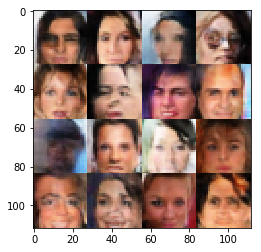

Epoch 10/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.6975... Generator Loss: 0.3674
Epoch 10/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.6758... Generator Loss: 0.3781
Epoch 10/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.6390... Generator Loss: 0.3818
Epoch 10/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.4812... Generator Loss: 0.6363
Epoch 10/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.7102... Generator Loss: 0.3341
Epoch 10/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.5894... Generator Loss: 0.4718
Epoch 10/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.8105... Generator Loss: 0.3860
Epoch 10/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.1680... Generator Loss: 0.8069
Epoch 10/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.6400... Generator Loss: 0.3859
Epoch 10/25...progress:92.59%....step:3500/3780... Discriminator

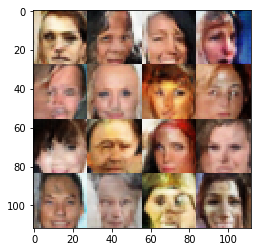

Epoch 10/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.3855... Generator Loss: 0.6037
Epoch 10/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.3104... Generator Loss: 0.5933
Epoch 10/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.7934... Generator Loss: 0.3415
Epoch 10/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.4451... Generator Loss: 0.5146
Epoch 10/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9972... Generator Loss: 0.9478
Epoch 10/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7274... Generator Loss: 0.3769
Epoch 10/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.8778... Generator Loss: 0.1130
Epoch 10/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.4022... Generator Loss: 0.1721
Epoch 10/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.8959... Generator Loss: 0.6936
Epoch 10/25...progress:97.88%....step:3700/3780... Discriminator

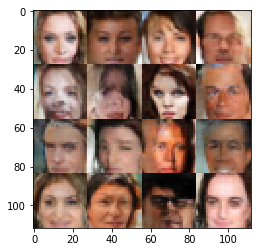

Epoch 11/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.4320... Generator Loss: 0.5655
Epoch 11/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.7382... Generator Loss: 0.3668
Epoch 11/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.9987... Generator Loss: 0.2630
Epoch 11/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9358... Generator Loss: 0.3820
Epoch 11/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.2838... Generator Loss: 0.7788
Epoch 11/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.1139... Generator Loss: 0.2378
Epoch 11/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.2641... Generator Loss: 0.6252
Epoch 11/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.8143... Generator Loss: 0.3076
Epoch 11/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.8252... Generator Loss: 0.3564
Epoch 11/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.9575... Generator Lo

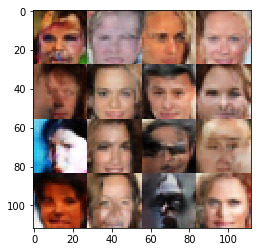

Epoch 11/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.6811... Generator Loss: 0.3961
Epoch 11/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.3018... Generator Loss: 0.6986
Epoch 11/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.6433... Generator Loss: 0.5127
Epoch 11/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.2658... Generator Loss: 0.1812
Epoch 11/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.2241... Generator Loss: 0.6454
Epoch 11/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3223... Generator Loss: 0.6498
Epoch 11/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.6448... Generator Loss: 0.3955
Epoch 11/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.3676... Generator Loss: 0.7611
Epoch 11/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.3212... Generator Loss: 0.5707
Epoch 11/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.3795... Gen

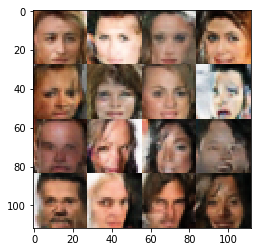

Epoch 11/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.2014... Generator Loss: 1.0086
Epoch 11/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2470... Generator Loss: 0.6952
Epoch 11/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.5086... Generator Loss: 0.4578
Epoch 11/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.3652... Generator Loss: 0.9193
Epoch 11/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.6010... Generator Loss: 0.4096
Epoch 11/25...progress:12.17%....step:460/3780... Discriminator Loss: 0.9247... Generator Loss: 1.2550
Epoch 11/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.4020... Generator Loss: 0.5791
Epoch 11/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.7981... Generator Loss: 0.3395
Epoch 11/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.0478... Generator Loss: 0.2648
Epoch 11/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.6

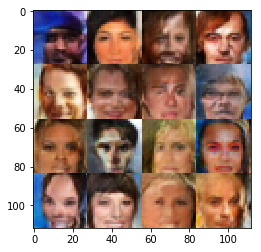

Epoch 11/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4848... Generator Loss: 0.5477
Epoch 11/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.7749... Generator Loss: 0.3375
Epoch 11/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.1146... Generator Loss: 1.0394
Epoch 11/25...progress:16.93%....step:640/3780... Discriminator Loss: 2.3935... Generator Loss: 0.1688
Epoch 11/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.7289... Generator Loss: 0.3360
Epoch 11/25...progress:17.46%....step:660/3780... Discriminator Loss: 2.1487... Generator Loss: 0.2321
Epoch 11/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.4911... Generator Loss: 0.5280
Epoch 11/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.2601... Generator Loss: 0.1982
Epoch 11/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.6846... Generator Loss: 0.3640
Epoch 11/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.3

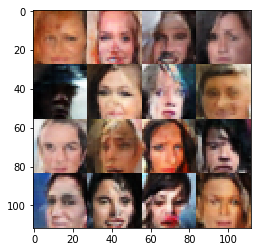

Epoch 11/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5276... Generator Loss: 0.5433
Epoch 11/25...progress:21.69%....step:820/3780... Discriminator Loss: 2.1110... Generator Loss: 0.2359
Epoch 11/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1565... Generator Loss: 1.1869
Epoch 11/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7908... Generator Loss: 0.3187
Epoch 11/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.8672... Generator Loss: 0.3004
Epoch 11/25...progress:22.75%....step:860/3780... Discriminator Loss: 2.0426... Generator Loss: 0.2651
Epoch 11/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.5172... Generator Loss: 0.4943
Epoch 11/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.4141... Generator Loss: 0.6913
Epoch 11/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.2279... Generator Loss: 0.2368
Epoch 11/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

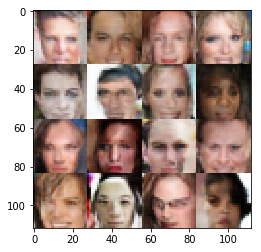

Epoch 11/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.5135... Generator Loss: 0.4514
Epoch 11/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.0321... Generator Loss: 0.2653
Epoch 11/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.7005... Generator Loss: 0.3846
Epoch 11/25...progress:27.51%....step:1040/3780... Discriminator Loss: 2.0646... Generator Loss: 0.2519
Epoch 11/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.0621... Generator Loss: 0.2384
Epoch 11/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.2032... Generator Loss: 0.7154
Epoch 11/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1346... Generator Loss: 0.8730
Epoch 11/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.9828... Generator Loss: 1.2150
Epoch 11/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.8909... Generator Loss: 0.3240
Epoch 11/25...progress:29.10%....step:1100/3780... Discriminator

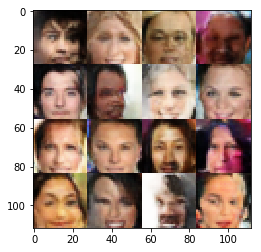

Epoch 11/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.1162... Generator Loss: 0.9257
Epoch 11/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.2989... Generator Loss: 0.5874
Epoch 11/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.2124... Generator Loss: 0.6391
Epoch 11/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.8010... Generator Loss: 0.3334
Epoch 11/25...progress:33.07%....step:1250/3780... Discriminator Loss: 2.1446... Generator Loss: 0.2243
Epoch 11/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.6904... Generator Loss: 0.3644
Epoch 11/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.7053... Generator Loss: 0.4208
Epoch 11/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.9315... Generator Loss: 0.3095
Epoch 11/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.4953... Generator Loss: 0.4591
Epoch 11/25...progress:34.39%....step:1300/3780... Discriminator

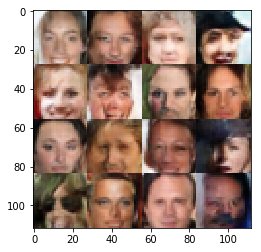

Epoch 11/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.5347... Generator Loss: 0.4690
Epoch 11/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.4585... Generator Loss: 0.6438
Epoch 11/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.7961... Generator Loss: 0.3201
Epoch 11/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.3970... Generator Loss: 0.1907
Epoch 11/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1846... Generator Loss: 0.7602
Epoch 11/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.3967... Generator Loss: 0.1816
Epoch 11/25...progress:38.89%....step:1470/3780... Discriminator Loss: 2.1115... Generator Loss: 0.2279
Epoch 11/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.7130... Generator Loss: 0.3482
Epoch 11/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.3026... Generator Loss: 0.5825
Epoch 11/25...progress:39.68%....step:1500/3780... Discriminator

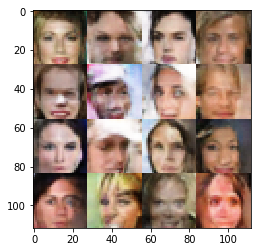

Epoch 11/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.3811... Generator Loss: 0.5674
Epoch 11/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1993... Generator Loss: 0.7064
Epoch 11/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1664... Generator Loss: 0.8108
Epoch 11/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.5285... Generator Loss: 0.7012
Epoch 11/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.8575... Generator Loss: 0.3085
Epoch 11/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.6620... Generator Loss: 0.4122
Epoch 11/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.1207... Generator Loss: 0.7632
Epoch 11/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.2800... Generator Loss: 0.5571
Epoch 11/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.3775... Generator Loss: 0.1698
Epoch 11/25...progress:44.97%....step:1700/3780... Discriminator

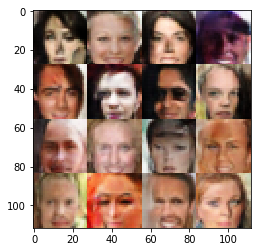

Epoch 11/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.3138... Generator Loss: 0.1749
Epoch 11/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.7947... Generator Loss: 0.3313
Epoch 11/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.3577... Generator Loss: 0.5403
Epoch 11/25...progress:48.68%....step:1840/3780... Discriminator Loss: 2.0105... Generator Loss: 0.2750
Epoch 11/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0356... Generator Loss: 0.8498
Epoch 11/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0751... Generator Loss: 0.2299
Epoch 11/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.0458... Generator Loss: 0.9085
Epoch 11/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.8665... Generator Loss: 0.3411
Epoch 11/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.3601... Generator Loss: 0.6738
Epoch 11/25...progress:50.26%....step:1900/3780... Discriminator

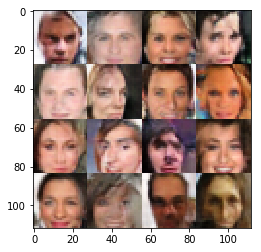

Epoch 11/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.8579... Generator Loss: 0.3272
Epoch 11/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6015... Generator Loss: 0.5883
Epoch 11/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.5991... Generator Loss: 0.9764
Epoch 11/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.6527... Generator Loss: 0.3992
Epoch 11/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.7034... Generator Loss: 0.3851
Epoch 11/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.5639... Generator Loss: 0.5238
Epoch 11/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.5129... Generator Loss: 0.4568
Epoch 11/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.7202... Generator Loss: 0.4163
Epoch 11/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2664... Generator Loss: 0.6113
Epoch 11/25...progress:55.56%....step:2100/3780... Discriminator

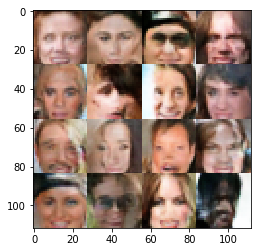

Epoch 11/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.2240... Generator Loss: 0.2026
Epoch 11/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.3872... Generator Loss: 0.5807
Epoch 11/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.1252... Generator Loss: 1.1162
Epoch 11/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.5521... Generator Loss: 0.4581
Epoch 11/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.1635... Generator Loss: 0.6728
Epoch 11/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.4125... Generator Loss: 0.8849
Epoch 11/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.5784... Generator Loss: 0.4170
Epoch 11/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.4332... Generator Loss: 0.5379
Epoch 11/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.1228... Generator Loss: 1.0698
Epoch 11/25...progress:60.85%....step:2300/3780... Discriminator

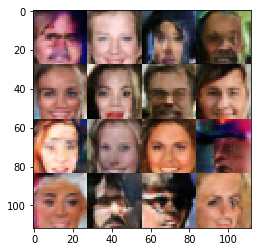

Epoch 11/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.9220... Generator Loss: 0.9296
Epoch 11/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.7351... Generator Loss: 0.3394
Epoch 11/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.6217... Generator Loss: 0.4173
Epoch 11/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4653... Generator Loss: 0.4780
Epoch 11/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5764... Generator Loss: 0.4226
Epoch 11/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5918... Generator Loss: 0.3951
Epoch 11/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.8614... Generator Loss: 0.2891
Epoch 11/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.1895... Generator Loss: 0.6809
Epoch 11/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9341... Generator Loss: 1.0616
Epoch 11/25...progress:66.14%....step:2500/3780... Discriminator

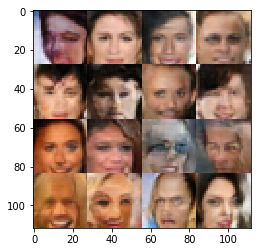

Epoch 11/25...progress:69.05%....step:2610/3780... Discriminator Loss: 2.0671... Generator Loss: 0.2563
Epoch 11/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5396... Generator Loss: 0.4818
Epoch 11/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.9952... Generator Loss: 0.2785
Epoch 11/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.7574... Generator Loss: 0.4046
Epoch 11/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.5372... Generator Loss: 0.1702
Epoch 11/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.4736... Generator Loss: 0.4539
Epoch 11/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.4090... Generator Loss: 0.6605
Epoch 11/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.8389... Generator Loss: 0.3203
Epoch 11/25...progress:71.16%....step:2690/3780... Discriminator Loss: 0.9222... Generator Loss: 1.1364
Epoch 11/25...progress:71.43%....step:2700/3780... Discriminator

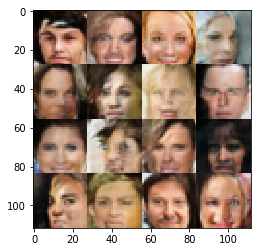

Epoch 11/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.6813... Generator Loss: 0.3781
Epoch 11/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.1667... Generator Loss: 0.8365
Epoch 11/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.8584... Generator Loss: 0.3337
Epoch 11/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.5041... Generator Loss: 0.4739
Epoch 11/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.5415... Generator Loss: 0.4352
Epoch 11/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.9086... Generator Loss: 0.2903
Epoch 11/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.2374... Generator Loss: 0.6110
Epoch 11/25...progress:76.19%....step:2880/3780... Discriminator Loss: 0.9937... Generator Loss: 1.4485
Epoch 11/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.7145... Generator Loss: 0.5992
Epoch 11/25...progress:76.72%....step:2900/3780... Discriminator

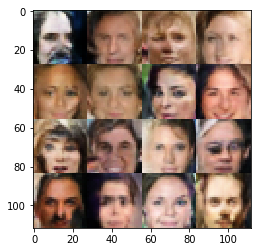

Epoch 11/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.8686... Generator Loss: 1.0627
Epoch 11/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.2439... Generator Loss: 0.6621
Epoch 11/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.5335... Generator Loss: 0.4334
Epoch 11/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.9224... Generator Loss: 0.2877
Epoch 11/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.0190... Generator Loss: 0.3077
Epoch 11/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.8423... Generator Loss: 0.3135
Epoch 11/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1960... Generator Loss: 0.7467
Epoch 11/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.8692... Generator Loss: 0.3095
Epoch 11/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.2223... Generator Loss: 0.6798
Epoch 11/25...progress:82.01%....step:3100/3780... Discriminator

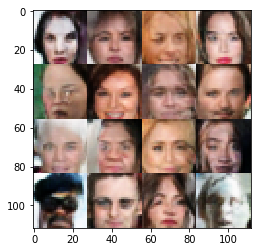

Epoch 11/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.1607... Generator Loss: 0.2312
Epoch 11/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.4854... Generator Loss: 0.4607
Epoch 11/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.8572... Generator Loss: 0.2981
Epoch 11/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.1928... Generator Loss: 0.8147
Epoch 11/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.4022... Generator Loss: 0.6133
Epoch 11/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.6129... Generator Loss: 0.1540
Epoch 11/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.2482... Generator Loss: 0.6262
Epoch 11/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.0285... Generator Loss: 0.9492
Epoch 11/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.4037... Generator Loss: 0.5040
Epoch 11/25...progress:87.30%....step:3300/3780... Discriminator

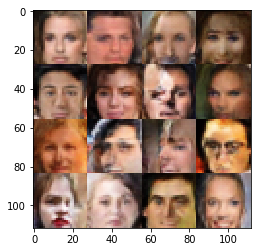

Epoch 11/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.7222... Generator Loss: 0.3570
Epoch 11/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.5808... Generator Loss: 0.4100
Epoch 11/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.8184... Generator Loss: 0.3543
Epoch 11/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.5627... Generator Loss: 0.4907
Epoch 11/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.4873... Generator Loss: 0.4807
Epoch 11/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.2652... Generator Loss: 0.7283
Epoch 11/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.9328... Generator Loss: 0.2695
Epoch 11/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.6581... Generator Loss: 0.3927
Epoch 11/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.6340... Generator Loss: 0.3883
Epoch 11/25...progress:92.59%....step:3500/3780... Discriminator

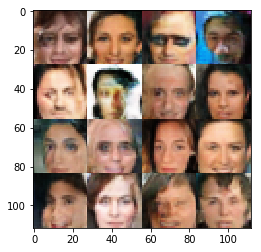

Epoch 11/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.3869... Generator Loss: 0.6310
Epoch 11/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.7257... Generator Loss: 0.3793
Epoch 11/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.5917... Generator Loss: 0.4331
Epoch 11/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.5490... Generator Loss: 0.4108
Epoch 11/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.0987... Generator Loss: 0.9293
Epoch 11/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7399... Generator Loss: 0.3498
Epoch 11/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.2318... Generator Loss: 0.6758
Epoch 11/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.3299... Generator Loss: 0.6202
Epoch 11/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.4439... Generator Loss: 0.5803
Epoch 11/25...progress:97.88%....step:3700/3780... Discriminator

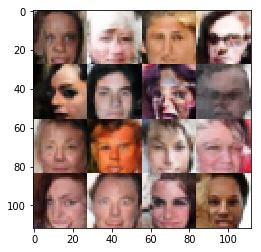

Epoch 12/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.1751... Generator Loss: 0.9698
Epoch 12/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8962... Generator Loss: 0.2939
Epoch 12/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.6938... Generator Loss: 0.3994
Epoch 12/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9133... Generator Loss: 0.2818
Epoch 12/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.1278... Generator Loss: 1.0464
Epoch 12/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.5705... Generator Loss: 0.4160
Epoch 12/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.6253... Generator Loss: 0.4061
Epoch 12/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.5031... Generator Loss: 0.4477
Epoch 12/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.4288... Generator Loss: 0.5087
Epoch 12/25...progress:2.65%....step:100/3780... Discriminator Loss: 2.0201... Generator Lo

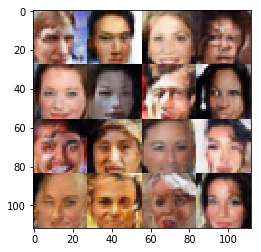

Epoch 12/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.2894... Generator Loss: 0.6595
Epoch 12/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.9247... Generator Loss: 1.2512
Epoch 12/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.3448... Generator Loss: 0.6426
Epoch 12/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.4447... Generator Loss: 0.5439
Epoch 12/25...progress:6.61%....step:250/3780... Discriminator Loss: 0.9682... Generator Loss: 1.0183
Epoch 12/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.6206... Generator Loss: 0.4221
Epoch 12/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.7025... Generator Loss: 0.4227
Epoch 12/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.1443... Generator Loss: 1.1519
Epoch 12/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.5950... Generator Loss: 0.3958
Epoch 12/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.1062... Gen

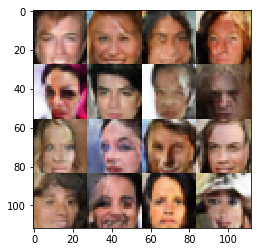

Epoch 12/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.7106... Generator Loss: 0.4008
Epoch 12/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.0617... Generator Loss: 1.1151
Epoch 12/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4009... Generator Loss: 0.7713
Epoch 12/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1636... Generator Loss: 1.0295
Epoch 12/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.8642... Generator Loss: 0.3196
Epoch 12/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.2258... Generator Loss: 1.0256
Epoch 12/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.1305... Generator Loss: 0.8665
Epoch 12/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.3462... Generator Loss: 0.6784
Epoch 12/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.4708... Generator Loss: 0.1633
Epoch 12/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.2

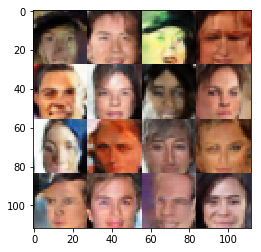

Epoch 12/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.2612... Generator Loss: 0.7209
Epoch 12/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.2616... Generator Loss: 0.2005
Epoch 12/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.8590... Generator Loss: 0.3617
Epoch 12/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.4682... Generator Loss: 0.4852
Epoch 12/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.1806... Generator Loss: 0.2012
Epoch 12/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.2588... Generator Loss: 0.7632
Epoch 12/25...progress:17.72%....step:670/3780... Discriminator Loss: 2.2227... Generator Loss: 0.2087
Epoch 12/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.0305... Generator Loss: 0.2562
Epoch 12/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.8149... Generator Loss: 0.2988
Epoch 12/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.4

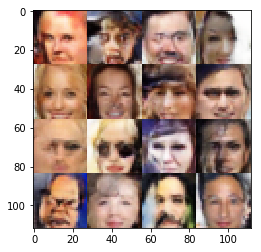

Epoch 12/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5277... Generator Loss: 0.7856
Epoch 12/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.6820... Generator Loss: 0.4101
Epoch 12/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1169... Generator Loss: 0.7986
Epoch 12/25...progress:22.22%....step:840/3780... Discriminator Loss: 2.3808... Generator Loss: 0.1647
Epoch 12/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.3473... Generator Loss: 0.6277
Epoch 12/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.4246... Generator Loss: 0.5310
Epoch 12/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.3070... Generator Loss: 0.6266
Epoch 12/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.7364... Generator Loss: 0.3401
Epoch 12/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.6926... Generator Loss: 0.3497
Epoch 12/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.4

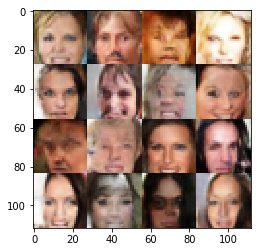

Epoch 12/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.1752... Generator Loss: 0.2208
Epoch 12/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.4079... Generator Loss: 0.1925
Epoch 12/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.1087... Generator Loss: 0.2320
Epoch 12/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.8473... Generator Loss: 0.3677
Epoch 12/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.2538... Generator Loss: 0.2008
Epoch 12/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8130... Generator Loss: 1.2513
Epoch 12/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1461... Generator Loss: 0.9881
Epoch 12/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.4173... Generator Loss: 0.5223
Epoch 12/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3261... Generator Loss: 0.7808
Epoch 12/25...progress:29.10%....step:1100/3780... Discriminator

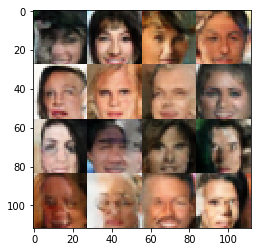

Epoch 12/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.5859... Generator Loss: 0.4239
Epoch 12/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.5031... Generator Loss: 0.4705
Epoch 12/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.5291... Generator Loss: 0.4471
Epoch 12/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.6802... Generator Loss: 0.3982
Epoch 12/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.9754... Generator Loss: 0.3149
Epoch 12/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.9055... Generator Loss: 0.2958
Epoch 12/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.8695... Generator Loss: 0.3269
Epoch 12/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.2523... Generator Loss: 0.6679
Epoch 12/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.5400... Generator Loss: 0.5638
Epoch 12/25...progress:34.39%....step:1300/3780... Discriminator

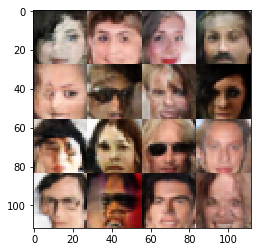

Epoch 12/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.8684... Generator Loss: 0.3269
Epoch 12/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2464... Generator Loss: 0.7279
Epoch 12/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.8448... Generator Loss: 0.3829
Epoch 12/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.9006... Generator Loss: 0.3019
Epoch 12/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.7081... Generator Loss: 0.3969
Epoch 12/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.5011... Generator Loss: 0.1671
Epoch 12/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.7159... Generator Loss: 0.8902
Epoch 12/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.7979... Generator Loss: 0.2890
Epoch 12/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.0837... Generator Loss: 0.8417
Epoch 12/25...progress:39.68%....step:1500/3780... Discriminator

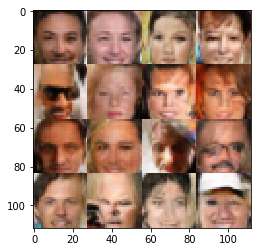

Epoch 12/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2034... Generator Loss: 0.8850
Epoch 12/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.3067... Generator Loss: 0.7884
Epoch 12/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.2307... Generator Loss: 0.8032
Epoch 12/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.0904... Generator Loss: 0.8083
Epoch 12/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.0405... Generator Loss: 0.8570
Epoch 12/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.3765... Generator Loss: 0.5672
Epoch 12/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.8470... Generator Loss: 1.4214
Epoch 12/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.5646... Generator Loss: 0.4336
Epoch 12/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.3333... Generator Loss: 0.1955
Epoch 12/25...progress:44.97%....step:1700/3780... Discriminator

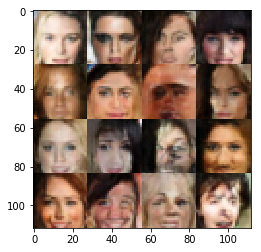

Epoch 12/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5991... Generator Loss: 0.4004
Epoch 12/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8055... Generator Loss: 0.3182
Epoch 12/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.5495... Generator Loss: 0.4142
Epoch 12/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5004... Generator Loss: 0.4991
Epoch 12/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0579... Generator Loss: 0.9154
Epoch 12/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.9735... Generator Loss: 0.2640
Epoch 12/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3684... Generator Loss: 0.7680
Epoch 12/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.8732... Generator Loss: 0.3161
Epoch 12/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5417... Generator Loss: 0.7059
Epoch 12/25...progress:50.26%....step:1900/3780... Discriminator

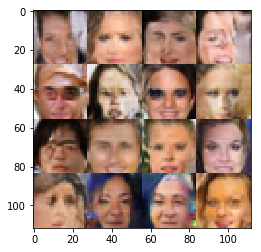

Epoch 12/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.6101... Generator Loss: 0.4201
Epoch 12/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.9392... Generator Loss: 0.2663
Epoch 12/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.8837... Generator Loss: 1.8726
Epoch 12/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.8188... Generator Loss: 0.4343
Epoch 12/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6593... Generator Loss: 0.4692
Epoch 12/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.2291... Generator Loss: 0.7898
Epoch 12/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.5615... Generator Loss: 0.4502
Epoch 12/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.3349... Generator Loss: 0.5755
Epoch 12/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2167... Generator Loss: 0.6901
Epoch 12/25...progress:55.56%....step:2100/3780... Discriminator

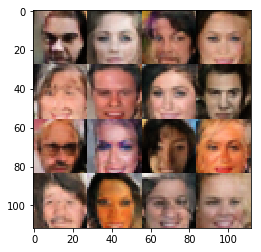

Epoch 12/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.4298... Generator Loss: 0.1629
Epoch 12/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.5934... Generator Loss: 0.4979
Epoch 12/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3581... Generator Loss: 0.7040
Epoch 12/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.4218... Generator Loss: 0.5372
Epoch 12/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.3762... Generator Loss: 0.5964
Epoch 12/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.7228... Generator Loss: 0.3731
Epoch 12/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.1823... Generator Loss: 0.2282
Epoch 12/25...progress:60.32%....step:2280/3780... Discriminator Loss: 2.0984... Generator Loss: 0.2649
Epoch 12/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.1834... Generator Loss: 0.7889
Epoch 12/25...progress:60.85%....step:2300/3780... Discriminator

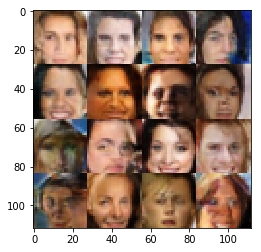

Epoch 12/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.3257... Generator Loss: 0.5994
Epoch 12/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.4265... Generator Loss: 0.5332
Epoch 12/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.5183... Generator Loss: 0.5224
Epoch 12/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.7493... Generator Loss: 0.3655
Epoch 12/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.2195... Generator Loss: 0.6772
Epoch 12/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.3178... Generator Loss: 0.6329
Epoch 12/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.8587... Generator Loss: 0.3282
Epoch 12/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.0832... Generator Loss: 0.7535
Epoch 12/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9817... Generator Loss: 1.0736
Epoch 12/25...progress:66.14%....step:2500/3780... Discriminator

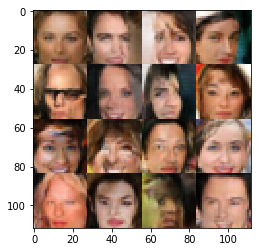

Epoch 12/25...progress:69.05%....step:2610/3780... Discriminator Loss: 2.3311... Generator Loss: 0.1939
Epoch 12/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.8444... Generator Loss: 0.3224
Epoch 12/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.9472... Generator Loss: 0.2837
Epoch 12/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.2237... Generator Loss: 0.6381
Epoch 12/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7998... Generator Loss: 0.3074
Epoch 12/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9399... Generator Loss: 0.2614
Epoch 12/25...progress:70.63%....step:2670/3780... Discriminator Loss: 2.3544... Generator Loss: 0.2101
Epoch 12/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.3642... Generator Loss: 0.5628
Epoch 12/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.5343... Generator Loss: 0.4353
Epoch 12/25...progress:71.43%....step:2700/3780... Discriminator

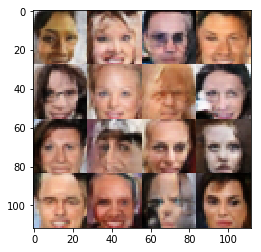

Epoch 12/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.3177... Generator Loss: 0.5679
Epoch 12/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.3252... Generator Loss: 0.5786
Epoch 12/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.1505... Generator Loss: 0.7096
Epoch 12/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2983... Generator Loss: 0.6205
Epoch 12/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.5965... Generator Loss: 0.4396
Epoch 12/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.9412... Generator Loss: 0.3231
Epoch 12/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.6192... Generator Loss: 0.3755
Epoch 12/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.6881... Generator Loss: 0.3875
Epoch 12/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.4554... Generator Loss: 0.5529
Epoch 12/25...progress:76.72%....step:2900/3780... Discriminator

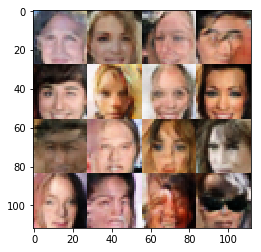

Epoch 12/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.1115... Generator Loss: 0.8787
Epoch 12/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0203... Generator Loss: 0.9232
Epoch 12/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.7193... Generator Loss: 0.3595
Epoch 12/25...progress:80.42%....step:3040/3780... Discriminator Loss: 2.1429... Generator Loss: 0.2363
Epoch 12/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.4546... Generator Loss: 0.5047
Epoch 12/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.8778... Generator Loss: 0.2928
Epoch 12/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.4582... Generator Loss: 0.5053
Epoch 12/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0961... Generator Loss: 0.2282
Epoch 12/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3867... Generator Loss: 0.6028
Epoch 12/25...progress:82.01%....step:3100/3780... Discriminator

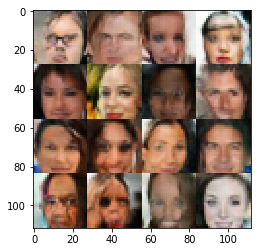

Epoch 12/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.9953... Generator Loss: 0.2724
Epoch 12/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.6026... Generator Loss: 0.4667
Epoch 12/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.2651... Generator Loss: 0.2063
Epoch 12/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.1751... Generator Loss: 0.2177
Epoch 12/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.4743... Generator Loss: 0.7493
Epoch 12/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.4274... Generator Loss: 0.1776
Epoch 12/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.1918... Generator Loss: 0.6804
Epoch 12/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.1419... Generator Loss: 0.8044
Epoch 12/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.5863... Generator Loss: 0.4497
Epoch 12/25...progress:87.30%....step:3300/3780... Discriminator

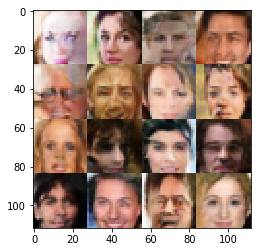

Epoch 12/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.3424... Generator Loss: 0.6567
Epoch 12/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.4776... Generator Loss: 0.5187
Epoch 12/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5890... Generator Loss: 0.3843
Epoch 12/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.7206... Generator Loss: 1.3289
Epoch 12/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.8092... Generator Loss: 0.3574
Epoch 12/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.7917... Generator Loss: 0.3220
Epoch 12/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.9206... Generator Loss: 0.2867
Epoch 12/25...progress:92.06%....step:3480/3780... Discriminator Loss: 2.1477... Generator Loss: 0.2310
Epoch 12/25...progress:92.33%....step:3490/3780... Discriminator Loss: 2.0281... Generator Loss: 0.2530
Epoch 12/25...progress:92.59%....step:3500/3780... Discriminator

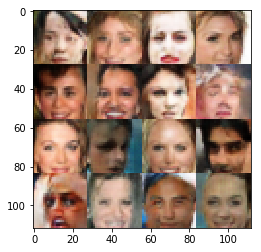

Epoch 12/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.2404... Generator Loss: 1.4275
Epoch 12/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.5460... Generator Loss: 0.4474
Epoch 12/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.9280... Generator Loss: 0.2842
Epoch 12/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.0095... Generator Loss: 0.2608
Epoch 12/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9693... Generator Loss: 0.9901
Epoch 12/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7572... Generator Loss: 0.3715
Epoch 12/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.6001... Generator Loss: 0.5136
Epoch 12/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.0086... Generator Loss: 0.2723
Epoch 12/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.0608... Generator Loss: 0.2421
Epoch 12/25...progress:97.88%....step:3700/3780... Discriminator

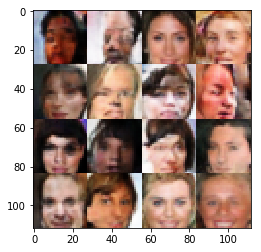

Epoch 13/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.4569... Generator Loss: 0.4925
Epoch 13/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.9553... Generator Loss: 0.2950
Epoch 13/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.3125... Generator Loss: 0.5949
Epoch 13/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9906... Generator Loss: 0.2531
Epoch 13/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.4318... Generator Loss: 0.9234
Epoch 13/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.6466... Generator Loss: 0.4125
Epoch 13/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.4734... Generator Loss: 0.5678
Epoch 13/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.2668... Generator Loss: 0.6203
Epoch 13/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.6060... Generator Loss: 0.3914
Epoch 13/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.2324... Generator Lo

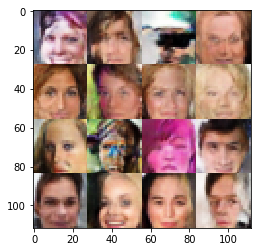

Epoch 13/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4659... Generator Loss: 0.7127
Epoch 13/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.4439... Generator Loss: 0.5850
Epoch 13/25...progress:6.08%....step:230/3780... Discriminator Loss: 2.6166... Generator Loss: 0.1594
Epoch 13/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.2979... Generator Loss: 0.2103
Epoch 13/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.1188... Generator Loss: 0.8196
Epoch 13/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.4174... Generator Loss: 0.7657
Epoch 13/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.2954... Generator Loss: 0.1927
Epoch 13/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7059... Generator Loss: 0.4025
Epoch 13/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.1829... Generator Loss: 0.7317
Epoch 13/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.2253... Gen

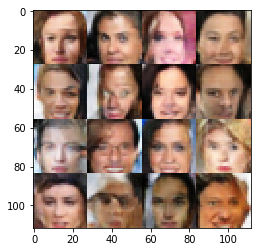

Epoch 13/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.4326... Generator Loss: 0.5282
Epoch 13/25...progress:11.11%....step:420/3780... Discriminator Loss: 0.9642... Generator Loss: 0.9996
Epoch 13/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.5232... Generator Loss: 0.4273
Epoch 13/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.6494... Generator Loss: 2.2620
Epoch 13/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.5891... Generator Loss: 0.4407
Epoch 13/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.3899... Generator Loss: 1.2792
Epoch 13/25...progress:12.43%....step:470/3780... Discriminator Loss: 2.5161... Generator Loss: 0.1502
Epoch 13/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0817... Generator Loss: 0.8908
Epoch 13/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.1116... Generator Loss: 0.2496
Epoch 13/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.0

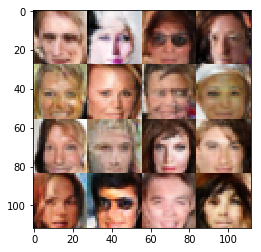

Epoch 13/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4984... Generator Loss: 1.2372
Epoch 13/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.0430... Generator Loss: 0.2598
Epoch 13/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.2220... Generator Loss: 0.6894
Epoch 13/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.5195... Generator Loss: 0.5057
Epoch 13/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.8538... Generator Loss: 0.3277
Epoch 13/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.8171... Generator Loss: 0.3021
Epoch 13/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.6333... Generator Loss: 0.3956
Epoch 13/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.5067... Generator Loss: 0.1439
Epoch 13/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.0348... Generator Loss: 0.2520
Epoch 13/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.2

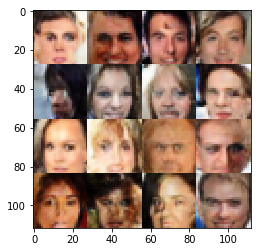

Epoch 13/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.8033... Generator Loss: 0.3174
Epoch 13/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.8848... Generator Loss: 0.3196
Epoch 13/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.0884... Generator Loss: 1.1391
Epoch 13/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7136... Generator Loss: 0.4069
Epoch 13/25...progress:22.49%....step:850/3780... Discriminator Loss: 2.1332... Generator Loss: 0.2368
Epoch 13/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7528... Generator Loss: 0.3446
Epoch 13/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.2080... Generator Loss: 0.6677
Epoch 13/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.4125... Generator Loss: 0.6928
Epoch 13/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.3377... Generator Loss: 0.1821
Epoch 13/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

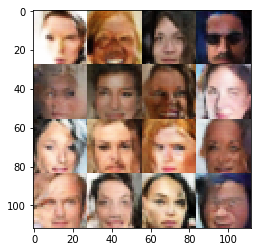

Epoch 13/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.5261... Generator Loss: 0.1489
Epoch 13/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.7498... Generator Loss: 0.3238
Epoch 13/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.9694... Generator Loss: 0.2742
Epoch 13/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.7024... Generator Loss: 0.4620
Epoch 13/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.9010... Generator Loss: 0.2744
Epoch 13/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.7446... Generator Loss: 1.5290
Epoch 13/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.0322... Generator Loss: 0.9016
Epoch 13/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.3414... Generator Loss: 0.7327
Epoch 13/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3048... Generator Loss: 0.9085
Epoch 13/25...progress:29.10%....step:1100/3780... Discriminator

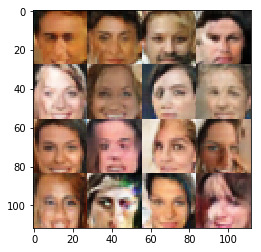

Epoch 13/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.2958... Generator Loss: 0.5899
Epoch 13/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.5723... Generator Loss: 0.4173
Epoch 13/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.2478... Generator Loss: 0.6155
Epoch 13/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.4895... Generator Loss: 0.5063
Epoch 13/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.6662... Generator Loss: 0.4089
Epoch 13/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.4786... Generator Loss: 0.5121
Epoch 13/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.5733... Generator Loss: 0.5712
Epoch 13/25...progress:33.86%....step:1280/3780... Discriminator Loss: 0.9993... Generator Loss: 0.9681
Epoch 13/25...progress:34.13%....step:1290/3780... Discriminator Loss: 2.1839... Generator Loss: 0.2397
Epoch 13/25...progress:34.39%....step:1300/3780... Discriminator

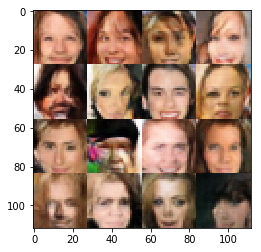

Epoch 13/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.4213... Generator Loss: 0.6035
Epoch 13/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.7285... Generator Loss: 0.4427
Epoch 13/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.6866... Generator Loss: 0.3502
Epoch 13/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.7961... Generator Loss: 0.3575
Epoch 13/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.6321... Generator Loss: 0.3984
Epoch 13/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.8097... Generator Loss: 0.3119
Epoch 13/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.2711... Generator Loss: 1.0956
Epoch 13/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.8098... Generator Loss: 0.3448
Epoch 13/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4179... Generator Loss: 0.6083
Epoch 13/25...progress:39.68%....step:1500/3780... Discriminator

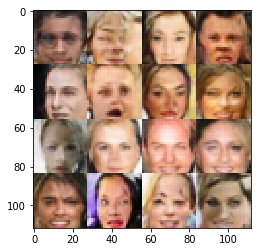

Epoch 13/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2215... Generator Loss: 1.2362
Epoch 13/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.4275... Generator Loss: 0.5093
Epoch 13/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1248... Generator Loss: 0.8178
Epoch 13/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.4463... Generator Loss: 0.4682
Epoch 13/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.1803... Generator Loss: 0.6732
Epoch 13/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.5870... Generator Loss: 0.4234
Epoch 13/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.5074... Generator Loss: 0.4672
Epoch 13/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.5885... Generator Loss: 0.4018
Epoch 13/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.0698... Generator Loss: 0.2281
Epoch 13/25...progress:44.97%....step:1700/3780... Discriminator

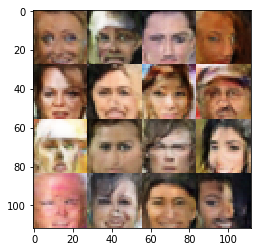

Epoch 13/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.8265... Generator Loss: 0.3185
Epoch 13/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8110... Generator Loss: 0.3007
Epoch 13/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.7698... Generator Loss: 0.3699
Epoch 13/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.2703... Generator Loss: 0.7545
Epoch 13/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0556... Generator Loss: 0.8233
Epoch 13/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.7940... Generator Loss: 0.1142
Epoch 13/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.2131... Generator Loss: 1.2521
Epoch 13/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.2482... Generator Loss: 0.2451
Epoch 13/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6582... Generator Loss: 0.4413
Epoch 13/25...progress:50.26%....step:1900/3780... Discriminator

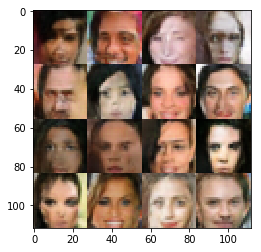

Epoch 13/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.3002... Generator Loss: 0.6498
Epoch 13/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.4981... Generator Loss: 0.4614
Epoch 13/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.4091... Generator Loss: 1.6819
Epoch 13/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.4750... Generator Loss: 0.5135
Epoch 13/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.3018... Generator Loss: 0.6866
Epoch 13/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3891... Generator Loss: 0.5474
Epoch 13/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.8488... Generator Loss: 0.3218
Epoch 13/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.5241... Generator Loss: 0.4378
Epoch 13/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.3544... Generator Loss: 0.9247
Epoch 13/25...progress:55.56%....step:2100/3780... Discriminator

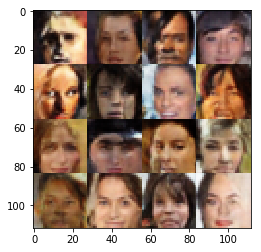

Epoch 13/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.5963... Generator Loss: 0.1529
Epoch 13/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.3615... Generator Loss: 0.5889
Epoch 13/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3877... Generator Loss: 0.5418
Epoch 13/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.4781... Generator Loss: 0.4412
Epoch 13/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.9977... Generator Loss: 0.2807
Epoch 13/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.9608... Generator Loss: 0.3912
Epoch 13/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9582... Generator Loss: 0.2734
Epoch 13/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.6427... Generator Loss: 0.4190
Epoch 13/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.0696... Generator Loss: 0.8140
Epoch 13/25...progress:60.85%....step:2300/3780... Discriminator

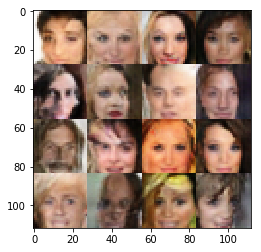

Epoch 13/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.0123... Generator Loss: 0.8944
Epoch 13/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.8966... Generator Loss: 0.3023
Epoch 13/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.3150... Generator Loss: 0.6034
Epoch 13/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4237... Generator Loss: 0.7502
Epoch 13/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5807... Generator Loss: 0.4146
Epoch 13/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.6960... Generator Loss: 0.3631
Epoch 13/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.7675... Generator Loss: 0.3653
Epoch 13/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.2055... Generator Loss: 0.7154
Epoch 13/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8172... Generator Loss: 1.6336
Epoch 13/25...progress:66.14%....step:2500/3780... Discriminator

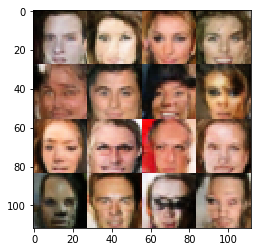

Epoch 13/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.8919... Generator Loss: 0.3016
Epoch 13/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.5510... Generator Loss: 0.4821
Epoch 13/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.5179... Generator Loss: 0.4689
Epoch 13/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.3363... Generator Loss: 1.1953
Epoch 13/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.0937... Generator Loss: 0.2318
Epoch 13/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.5152... Generator Loss: 0.5085
Epoch 13/25...progress:70.63%....step:2670/3780... Discriminator Loss: 2.0061... Generator Loss: 0.2473
Epoch 13/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6447... Generator Loss: 0.4171
Epoch 13/25...progress:71.16%....step:2690/3780... Discriminator Loss: 0.9447... Generator Loss: 0.9374
Epoch 13/25...progress:71.43%....step:2700/3780... Discriminator

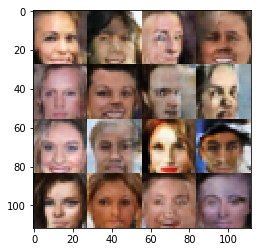

Epoch 13/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.2538... Generator Loss: 0.8754
Epoch 13/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.8207... Generator Loss: 0.3100
Epoch 13/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.3685... Generator Loss: 0.8218
Epoch 13/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.1285... Generator Loss: 0.8188
Epoch 13/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.8976... Generator Loss: 0.3104
Epoch 13/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.4164... Generator Loss: 0.5383
Epoch 13/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.8170... Generator Loss: 0.3477
Epoch 13/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.3113... Generator Loss: 0.6405
Epoch 13/25...progress:76.46%....step:2890/3780... Discriminator Loss: 2.0042... Generator Loss: 0.2943
Epoch 13/25...progress:76.72%....step:2900/3780... Discriminator

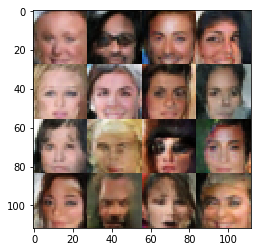

Epoch 13/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.1449... Generator Loss: 0.6956
Epoch 13/25...progress:79.89%....step:3020/3780... Discriminator Loss: 0.9719... Generator Loss: 0.9756
Epoch 13/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.3839... Generator Loss: 0.5672
Epoch 13/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.6205... Generator Loss: 0.4841
Epoch 13/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.4930... Generator Loss: 0.1609
Epoch 13/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.4270... Generator Loss: 0.4835
Epoch 13/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2063... Generator Loss: 0.7964
Epoch 13/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.1624... Generator Loss: 0.2619
Epoch 13/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.5087... Generator Loss: 0.4990
Epoch 13/25...progress:82.01%....step:3100/3780... Discriminator

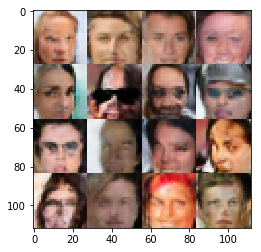

Epoch 13/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.6616... Generator Loss: 0.3754
Epoch 13/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.3055... Generator Loss: 0.2130
Epoch 13/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.5457... Generator Loss: 0.1585
Epoch 13/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.8256... Generator Loss: 0.3322
Epoch 13/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.3219... Generator Loss: 0.7604
Epoch 13/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.3246... Generator Loss: 0.1812
Epoch 13/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.2455... Generator Loss: 0.6139
Epoch 13/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.0127... Generator Loss: 1.3000
Epoch 13/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.4174... Generator Loss: 0.5828
Epoch 13/25...progress:87.30%....step:3300/3780... Discriminator

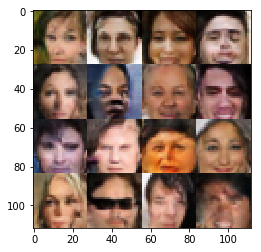

Epoch 13/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.9614... Generator Loss: 0.3019
Epoch 13/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.8575... Generator Loss: 0.3142
Epoch 13/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.4933... Generator Loss: 0.4854
Epoch 13/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.1789... Generator Loss: 0.7241
Epoch 13/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.0014... Generator Loss: 0.2621
Epoch 13/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.8141... Generator Loss: 0.3587
Epoch 13/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.3951... Generator Loss: 1.5589
Epoch 13/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.8276... Generator Loss: 0.3340
Epoch 13/25...progress:92.33%....step:3490/3780... Discriminator Loss: 2.0323... Generator Loss: 0.2470
Epoch 13/25...progress:92.59%....step:3500/3780... Discriminator

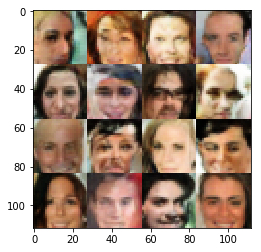

Epoch 13/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.7414... Generator Loss: 0.4357
Epoch 13/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.8109... Generator Loss: 0.3128
Epoch 13/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.7913... Generator Loss: 0.3369
Epoch 13/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.3905... Generator Loss: 0.5809
Epoch 13/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.2603... Generator Loss: 0.6909
Epoch 13/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.4980... Generator Loss: 0.4804
Epoch 13/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.7859... Generator Loss: 0.3558
Epoch 13/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.2224... Generator Loss: 0.2170
Epoch 13/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.1343... Generator Loss: 0.2263
Epoch 13/25...progress:97.88%....step:3700/3780... Discriminator

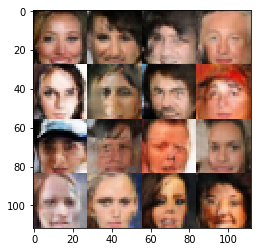

Epoch 14/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.7827... Generator Loss: 0.3139
Epoch 14/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.9936... Generator Loss: 0.3279
Epoch 14/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.9991... Generator Loss: 0.2656
Epoch 14/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.6449... Generator Loss: 0.4460
Epoch 14/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.1610... Generator Loss: 1.8870
Epoch 14/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.2416... Generator Loss: 0.2204
Epoch 14/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.1608... Generator Loss: 0.7254
Epoch 14/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.9359... Generator Loss: 0.2837
Epoch 14/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.3407... Generator Loss: 0.5608
Epoch 14/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.8802... Generator Lo

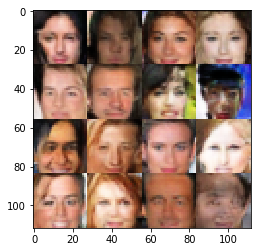

Epoch 14/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4946... Generator Loss: 0.4641
Epoch 14/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.1568... Generator Loss: 0.7292
Epoch 14/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.7531... Generator Loss: 0.3787
Epoch 14/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.6411... Generator Loss: 0.3843
Epoch 14/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.3493... Generator Loss: 0.5398
Epoch 14/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.4360... Generator Loss: 0.6485
Epoch 14/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.2998... Generator Loss: 0.6666
Epoch 14/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.6932... Generator Loss: 0.4231
Epoch 14/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2337... Generator Loss: 1.1572
Epoch 14/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.0890... Gen

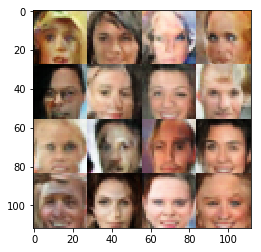

Epoch 14/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.5507... Generator Loss: 0.4618
Epoch 14/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2948... Generator Loss: 1.3892
Epoch 14/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.2977... Generator Loss: 0.8263
Epoch 14/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.3463... Generator Loss: 0.7785
Epoch 14/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.7936... Generator Loss: 0.3256
Epoch 14/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.0044... Generator Loss: 1.2737
Epoch 14/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.1930... Generator Loss: 0.7275
Epoch 14/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.7006... Generator Loss: 0.4146
Epoch 14/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.5975... Generator Loss: 0.4798
Epoch 14/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.7

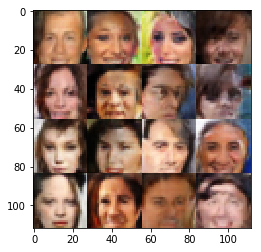

Epoch 14/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.5557... Generator Loss: 0.5183
Epoch 14/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.5042... Generator Loss: 0.4269
Epoch 14/25...progress:16.67%....step:630/3780... Discriminator Loss: 0.9711... Generator Loss: 0.9572
Epoch 14/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.8448... Generator Loss: 0.3414
Epoch 14/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.5519... Generator Loss: 0.4249
Epoch 14/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.5631... Generator Loss: 0.4383
Epoch 14/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5255... Generator Loss: 0.4677
Epoch 14/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.5980... Generator Loss: 0.1351
Epoch 14/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.7698... Generator Loss: 0.3295
Epoch 14/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.5

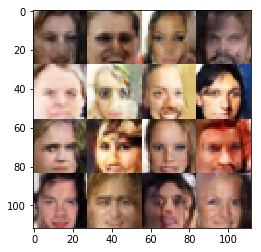

Epoch 14/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.6586... Generator Loss: 0.8330
Epoch 14/25...progress:21.69%....step:820/3780... Discriminator Loss: 2.3470... Generator Loss: 0.1859
Epoch 14/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.8007... Generator Loss: 1.7066
Epoch 14/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.4562... Generator Loss: 0.5210
Epoch 14/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.6309... Generator Loss: 0.4064
Epoch 14/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.8535... Generator Loss: 0.3006
Epoch 14/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.4241... Generator Loss: 0.6315
Epoch 14/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.6056... Generator Loss: 0.6268
Epoch 14/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.8505... Generator Loss: 0.3198
Epoch 14/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.4

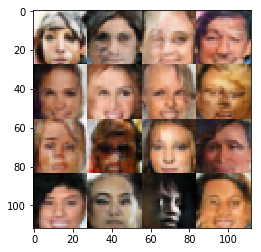

Epoch 14/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.2303... Generator Loss: 0.6275
Epoch 14/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.4968... Generator Loss: 0.1790
Epoch 14/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.6477... Generator Loss: 0.3900
Epoch 14/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2995... Generator Loss: 0.6062
Epoch 14/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.7244... Generator Loss: 0.3285
Epoch 14/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.0832... Generator Loss: 0.8706
Epoch 14/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1610... Generator Loss: 0.6978
Epoch 14/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.2469... Generator Loss: 0.6441
Epoch 14/25...progress:28.84%....step:1090/3780... Discriminator Loss: 2.3199... Generator Loss: 0.1710
Epoch 14/25...progress:29.10%....step:1100/3780... Discriminator

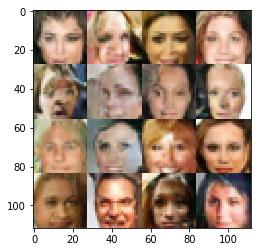

Epoch 14/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.5458... Generator Loss: 0.4859
Epoch 14/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.4382... Generator Loss: 0.5387
Epoch 14/25...progress:32.54%....step:1230/3780... Discriminator Loss: 0.9792... Generator Loss: 1.1061
Epoch 14/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.0002... Generator Loss: 1.1264
Epoch 14/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.7515... Generator Loss: 0.3536
Epoch 14/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.2190... Generator Loss: 0.8037
Epoch 14/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.8024... Generator Loss: 0.3273
Epoch 14/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.3522... Generator Loss: 0.5826
Epoch 14/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.7678... Generator Loss: 0.3481
Epoch 14/25...progress:34.39%....step:1300/3780... Discriminator

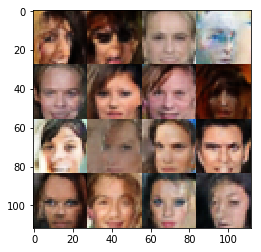

Epoch 14/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.7461... Generator Loss: 0.3574
Epoch 14/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2480... Generator Loss: 0.6071
Epoch 14/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.3117... Generator Loss: 0.5828
Epoch 14/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.1604... Generator Loss: 0.2169
Epoch 14/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1690... Generator Loss: 0.7124
Epoch 14/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.1329... Generator Loss: 0.2200
Epoch 14/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.0861... Generator Loss: 0.7675
Epoch 14/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.3273... Generator Loss: 0.5956
Epoch 14/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.3670... Generator Loss: 0.5961
Epoch 14/25...progress:39.68%....step:1500/3780... Discriminator

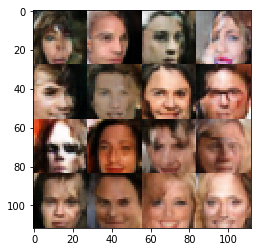

Epoch 14/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.4581... Generator Loss: 0.6087
Epoch 14/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.2584... Generator Loss: 0.6325
Epoch 14/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.8264... Generator Loss: 0.3229
Epoch 14/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.5989... Generator Loss: 0.5240
Epoch 14/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3236... Generator Loss: 0.5436
Epoch 14/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.4657... Generator Loss: 0.5056
Epoch 14/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.1129... Generator Loss: 0.7110
Epoch 14/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.2100... Generator Loss: 0.7928
Epoch 14/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.9067... Generator Loss: 0.2927
Epoch 14/25...progress:44.97%....step:1700/3780... Discriminator

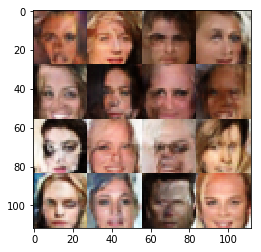

Epoch 14/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.5697... Generator Loss: 0.4511
Epoch 14/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.2269... Generator Loss: 0.2062
Epoch 14/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.8362... Generator Loss: 0.3479
Epoch 14/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5981... Generator Loss: 0.3848
Epoch 14/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0241... Generator Loss: 1.0562
Epoch 14/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.1372... Generator Loss: 0.2511
Epoch 14/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.5442... Generator Loss: 0.4274
Epoch 14/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.0743... Generator Loss: 0.2711
Epoch 14/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.3996... Generator Loss: 0.6819
Epoch 14/25...progress:50.26%....step:1900/3780... Discriminator

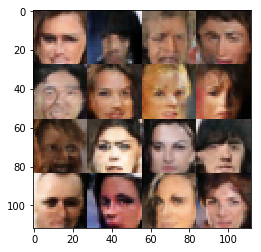

Epoch 14/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.4840... Generator Loss: 0.4824
Epoch 14/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.5361... Generator Loss: 0.5101
Epoch 14/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.5415... Generator Loss: 0.4707
Epoch 14/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.7643... Generator Loss: 0.3288
Epoch 14/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.5735... Generator Loss: 0.4600
Epoch 14/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.5692... Generator Loss: 0.4077
Epoch 14/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.2837... Generator Loss: 0.7140
Epoch 14/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.2248... Generator Loss: 0.6901
Epoch 14/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.1332... Generator Loss: 0.7380
Epoch 14/25...progress:55.56%....step:2100/3780... Discriminator

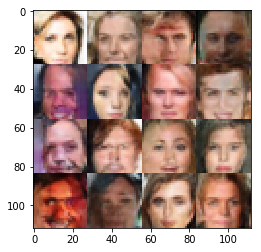

Epoch 14/25...progress:58.47%....step:2210/3780... Discriminator Loss: 1.9918... Generator Loss: 0.2604
Epoch 14/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.5169... Generator Loss: 0.5257
Epoch 14/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.4713... Generator Loss: 0.5061
Epoch 14/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.8911... Generator Loss: 0.2895
Epoch 14/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.6454... Generator Loss: 0.4108
Epoch 14/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.4614... Generator Loss: 0.7024
Epoch 14/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.8375... Generator Loss: 0.1103
Epoch 14/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.6610... Generator Loss: 0.4697
Epoch 14/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4568... Generator Loss: 1.0925
Epoch 14/25...progress:60.85%....step:2300/3780... Discriminator

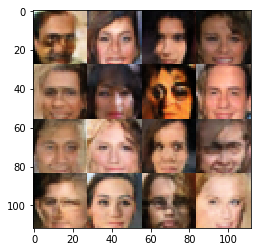

Epoch 14/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.4925... Generator Loss: 0.5140
Epoch 14/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.9176... Generator Loss: 0.3060
Epoch 14/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4643... Generator Loss: 0.5320
Epoch 14/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.7579... Generator Loss: 0.5184
Epoch 14/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.4561... Generator Loss: 0.5845
Epoch 14/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.2522... Generator Loss: 0.7570
Epoch 14/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.7384... Generator Loss: 0.3522
Epoch 14/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.6490... Generator Loss: 0.4313
Epoch 14/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.4323... Generator Loss: 0.5075
Epoch 14/25...progress:66.14%....step:2500/3780... Discriminator

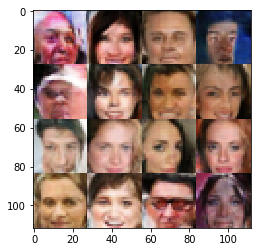

Epoch 14/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9223... Generator Loss: 0.3896
Epoch 14/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.7568... Generator Loss: 0.3645
Epoch 14/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.5758... Generator Loss: 0.4919
Epoch 14/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.6173... Generator Loss: 0.6878
Epoch 14/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7465... Generator Loss: 0.3681
Epoch 14/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9969... Generator Loss: 0.2608
Epoch 14/25...progress:70.63%....step:2670/3780... Discriminator Loss: 2.0800... Generator Loss: 0.2545
Epoch 14/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6302... Generator Loss: 0.4154
Epoch 14/25...progress:71.16%....step:2690/3780... Discriminator Loss: 0.9763... Generator Loss: 0.9372
Epoch 14/25...progress:71.43%....step:2700/3780... Discriminator

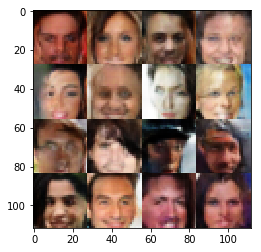

Epoch 14/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.8945... Generator Loss: 0.3130
Epoch 14/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.0820... Generator Loss: 0.9559
Epoch 14/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.4683... Generator Loss: 0.4646
Epoch 14/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.8515... Generator Loss: 0.3164
Epoch 14/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.0934... Generator Loss: 0.2392
Epoch 14/25...progress:75.66%....step:2860/3780... Discriminator Loss: 2.1210... Generator Loss: 0.2175
Epoch 14/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.6658... Generator Loss: 0.3574
Epoch 14/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.1196... Generator Loss: 1.5200
Epoch 14/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.1235... Generator Loss: 1.2683
Epoch 14/25...progress:76.72%....step:2900/3780... Discriminator

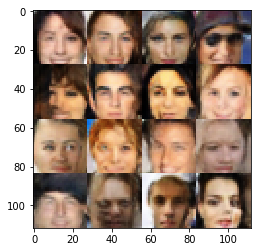

Epoch 14/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0493... Generator Loss: 0.9257
Epoch 14/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0662... Generator Loss: 0.8372
Epoch 14/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.6469... Generator Loss: 0.4290
Epoch 14/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.4609... Generator Loss: 0.4508
Epoch 14/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.1986... Generator Loss: 0.8586
Epoch 14/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.9375... Generator Loss: 0.2771
Epoch 14/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1358... Generator Loss: 0.8351
Epoch 14/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.8270... Generator Loss: 0.3331
Epoch 14/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.9364... Generator Loss: 0.2783
Epoch 14/25...progress:82.01%....step:3100/3780... Discriminator

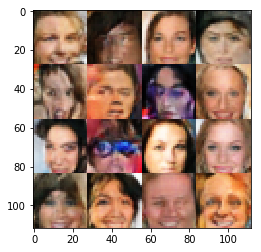

Epoch 14/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.9430... Generator Loss: 0.2622
Epoch 14/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.7482... Generator Loss: 0.3229
Epoch 14/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.3261... Generator Loss: 0.2246
Epoch 14/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.6643... Generator Loss: 0.4395
Epoch 14/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.5511... Generator Loss: 0.8278
Epoch 14/25...progress:86.24%....step:3260/3780... Discriminator Loss: 2.0222... Generator Loss: 0.2495
Epoch 14/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.0935... Generator Loss: 0.9851
Epoch 14/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.1152... Generator Loss: 0.8537
Epoch 14/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.2008... Generator Loss: 1.6184
Epoch 14/25...progress:87.30%....step:3300/3780... Discriminator

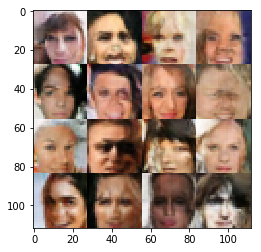

Epoch 14/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.3650... Generator Loss: 0.7694
Epoch 14/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.4277... Generator Loss: 0.5168
Epoch 14/25...progress:90.74%....step:3430/3780... Discriminator Loss: 2.3566... Generator Loss: 0.2075
Epoch 14/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.3316... Generator Loss: 0.6347
Epoch 14/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.8959... Generator Loss: 0.2798
Epoch 14/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.5736... Generator Loss: 0.4571
Epoch 14/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.4025... Generator Loss: 0.6685
Epoch 14/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.7895... Generator Loss: 0.3142
Epoch 14/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.7397... Generator Loss: 0.3785
Epoch 14/25...progress:92.59%....step:3500/3780... Discriminator

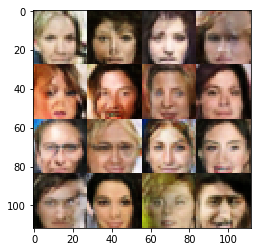

Epoch 14/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.2841... Generator Loss: 0.9102
Epoch 14/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.4014... Generator Loss: 0.5006
Epoch 14/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.8157... Generator Loss: 0.3260
Epoch 14/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.3141... Generator Loss: 0.5458
Epoch 14/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9145... Generator Loss: 1.0903
Epoch 14/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7759... Generator Loss: 0.3477
Epoch 14/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.0623... Generator Loss: 0.2801
Epoch 14/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.9697... Generator Loss: 0.1031
Epoch 14/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.2899... Generator Loss: 0.1931
Epoch 14/25...progress:97.88%....step:3700/3780... Discriminator

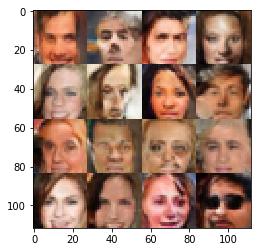

Epoch 15/25...progress:0.26%....step:10/3780... Discriminator Loss: 2.0251... Generator Loss: 0.2620
Epoch 15/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.7852... Generator Loss: 0.3823
Epoch 15/25...progress:0.79%....step:30/3780... Discriminator Loss: 0.9922... Generator Loss: 1.0218
Epoch 15/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.8916... Generator Loss: 0.3081
Epoch 15/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3224... Generator Loss: 0.9074
Epoch 15/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.8534... Generator Loss: 0.3270
Epoch 15/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.0877... Generator Loss: 0.7793
Epoch 15/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.5218... Generator Loss: 0.4450
Epoch 15/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.4316... Generator Loss: 0.5075
Epoch 15/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.6401... Generator Lo

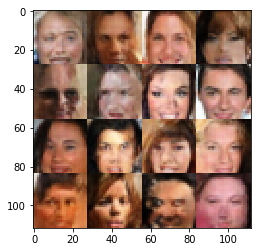

Epoch 15/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.3948... Generator Loss: 0.7799
Epoch 15/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.1104... Generator Loss: 0.7355
Epoch 15/25...progress:6.08%....step:230/3780... Discriminator Loss: 2.0192... Generator Loss: 0.2511
Epoch 15/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.1979... Generator Loss: 0.2312
Epoch 15/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.6019... Generator Loss: 0.4010
Epoch 15/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.2722... Generator Loss: 0.6972
Epoch 15/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.8176... Generator Loss: 0.3424
Epoch 15/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5585... Generator Loss: 0.4166
Epoch 15/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.6038... Generator Loss: 0.4060
Epoch 15/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.0031... Gen

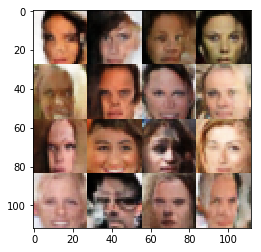

Epoch 15/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.4845... Generator Loss: 0.5327
Epoch 15/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.0488... Generator Loss: 1.2414
Epoch 15/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.1286... Generator Loss: 0.2368
Epoch 15/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.0989... Generator Loss: 1.0021
Epoch 15/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.9034... Generator Loss: 0.3279
Epoch 15/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.2720... Generator Loss: 0.7395
Epoch 15/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2278... Generator Loss: 0.7773
Epoch 15/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.9209... Generator Loss: 1.0167
Epoch 15/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.7454... Generator Loss: 0.3190
Epoch 15/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.3

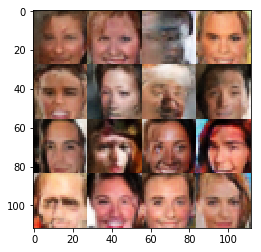

Epoch 15/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4200... Generator Loss: 0.6626
Epoch 15/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.7625... Generator Loss: 0.3461
Epoch 15/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.2478... Generator Loss: 0.6929
Epoch 15/25...progress:16.93%....step:640/3780... Discriminator Loss: 2.1121... Generator Loss: 0.2453
Epoch 15/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.2731... Generator Loss: 0.1950
Epoch 15/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.8620... Generator Loss: 0.3129
Epoch 15/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5511... Generator Loss: 0.5333
Epoch 15/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.6667... Generator Loss: 0.4015
Epoch 15/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.5076... Generator Loss: 0.4393
Epoch 15/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.5

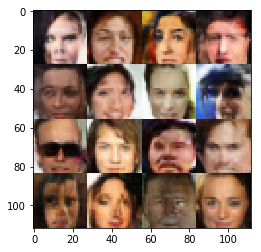

Epoch 15/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.6169... Generator Loss: 0.4030
Epoch 15/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.5326... Generator Loss: 0.4931
Epoch 15/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.0672... Generator Loss: 0.8765
Epoch 15/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.9345... Generator Loss: 0.2733
Epoch 15/25...progress:22.49%....step:850/3780... Discriminator Loss: 3.0633... Generator Loss: 0.0872
Epoch 15/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7389... Generator Loss: 0.3515
Epoch 15/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.1668... Generator Loss: 0.7017
Epoch 15/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.7565... Generator Loss: 0.3663
Epoch 15/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.0271... Generator Loss: 0.2696
Epoch 15/25...progress:23.81%....step:900/3780... Discriminator Loss: 2.0

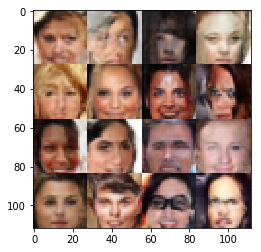

Epoch 15/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.7007... Generator Loss: 0.3952
Epoch 15/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.2412... Generator Loss: 0.1949
Epoch 15/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.7729... Generator Loss: 0.3647
Epoch 15/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.3061... Generator Loss: 0.8052
Epoch 15/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.5354... Generator Loss: 0.4009
Epoch 15/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.1816... Generator Loss: 0.7210
Epoch 15/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1435... Generator Loss: 1.3296
Epoch 15/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.6616... Generator Loss: 0.8556
Epoch 15/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.5957... Generator Loss: 0.4372
Epoch 15/25...progress:29.10%....step:1100/3780... Discriminator

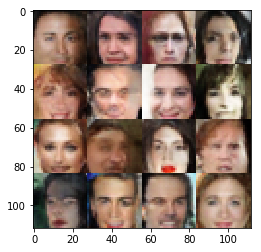

Epoch 15/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.6469... Generator Loss: 0.4060
Epoch 15/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3283... Generator Loss: 0.5908
Epoch 15/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.5830... Generator Loss: 0.5195
Epoch 15/25...progress:32.80%....step:1240/3780... Discriminator Loss: 0.9849... Generator Loss: 1.0034
Epoch 15/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.1105... Generator Loss: 0.8531
Epoch 15/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.6158... Generator Loss: 0.4158
Epoch 15/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.3793... Generator Loss: 0.5451
Epoch 15/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.3332... Generator Loss: 0.5499
Epoch 15/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.1590... Generator Loss: 0.8786
Epoch 15/25...progress:34.39%....step:1300/3780... Discriminator

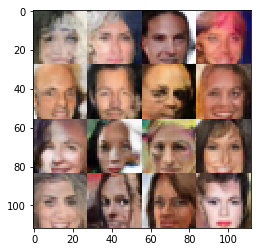

Epoch 15/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.3951... Generator Loss: 0.5680
Epoch 15/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.5573... Generator Loss: 0.4389
Epoch 15/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.8554... Generator Loss: 0.3485
Epoch 15/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.4216... Generator Loss: 0.6267
Epoch 15/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1887... Generator Loss: 0.6756
Epoch 15/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.2741... Generator Loss: 0.2082
Epoch 15/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.2183... Generator Loss: 0.7423
Epoch 15/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.8280... Generator Loss: 0.3511
Epoch 15/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2887... Generator Loss: 0.5844
Epoch 15/25...progress:39.68%....step:1500/3780... Discriminator

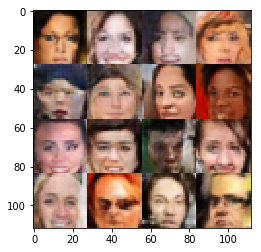

Epoch 15/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2803... Generator Loss: 0.6830
Epoch 15/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.3123... Generator Loss: 0.5879
Epoch 15/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.9226... Generator Loss: 0.2785
Epoch 15/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.2445... Generator Loss: 0.6937
Epoch 15/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.0919... Generator Loss: 0.8681
Epoch 15/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.9191... Generator Loss: 0.2931
Epoch 15/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.9974... Generator Loss: 1.0034
Epoch 15/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.7412... Generator Loss: 0.3131
Epoch 15/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.5458... Generator Loss: 0.1823
Epoch 15/25...progress:44.97%....step:1700/3780... Discriminator

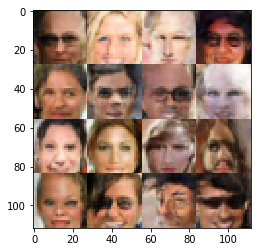

Epoch 15/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.8555... Generator Loss: 0.3133
Epoch 15/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.9949... Generator Loss: 0.2689
Epoch 15/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.5667... Generator Loss: 0.4015
Epoch 15/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.7761... Generator Loss: 0.3363
Epoch 15/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.4061... Generator Loss: 0.5491
Epoch 15/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.2925... Generator Loss: 0.1908
Epoch 15/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.6920... Generator Loss: 0.3953
Epoch 15/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.1193... Generator Loss: 0.2412
Epoch 15/25...progress:50.00%....step:1890/3780... Discriminator Loss: 2.2974... Generator Loss: 0.1885
Epoch 15/25...progress:50.26%....step:1900/3780... Discriminator

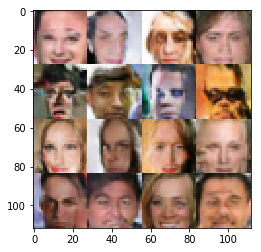

Epoch 15/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.6007... Generator Loss: 0.4498
Epoch 15/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.2422... Generator Loss: 0.6052
Epoch 15/25...progress:53.70%....step:2030/3780... Discriminator Loss: 2.0306... Generator Loss: 0.2654
Epoch 15/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.9637... Generator Loss: 0.2951
Epoch 15/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.2835... Generator Loss: 0.5986
Epoch 15/25...progress:54.50%....step:2060/3780... Discriminator Loss: 2.0022... Generator Loss: 2.1261
Epoch 15/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.2489... Generator Loss: 0.7097
Epoch 15/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.5907... Generator Loss: 0.4429
Epoch 15/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2042... Generator Loss: 0.8221
Epoch 15/25...progress:55.56%....step:2100/3780... Discriminator

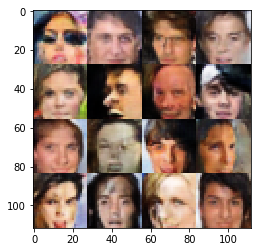

Epoch 15/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.3592... Generator Loss: 0.1837
Epoch 15/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.2859... Generator Loss: 0.7292
Epoch 15/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.2784... Generator Loss: 0.6386
Epoch 15/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.5021... Generator Loss: 0.4986
Epoch 15/25...progress:59.52%....step:2250/3780... Discriminator Loss: 2.1402... Generator Loss: 0.2205
Epoch 15/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.4334... Generator Loss: 0.6600
Epoch 15/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.5028... Generator Loss: 0.4469
Epoch 15/25...progress:60.32%....step:2280/3780... Discriminator Loss: 2.0712... Generator Loss: 0.2310
Epoch 15/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.2113... Generator Loss: 0.9107
Epoch 15/25...progress:60.85%....step:2300/3780... Discriminator

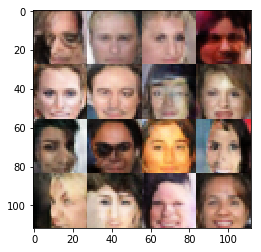

Epoch 15/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.2196... Generator Loss: 0.6988
Epoch 15/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.5871... Generator Loss: 0.4204
Epoch 15/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4745... Generator Loss: 0.5056
Epoch 15/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.3760... Generator Loss: 1.7611
Epoch 15/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.3376... Generator Loss: 0.6010
Epoch 15/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5122... Generator Loss: 0.4545
Epoch 15/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.6109... Generator Loss: 0.3784
Epoch 15/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.1986... Generator Loss: 0.7257
Epoch 15/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.0880... Generator Loss: 0.9721
Epoch 15/25...progress:66.14%....step:2500/3780... Discriminator

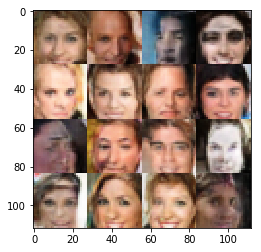

Epoch 15/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9547... Generator Loss: 0.3005
Epoch 15/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.4851... Generator Loss: 0.4527
Epoch 15/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.1496... Generator Loss: 0.2868
Epoch 15/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.6937... Generator Loss: 0.4125
Epoch 15/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.4556... Generator Loss: 0.1888
Epoch 15/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.7368... Generator Loss: 0.3460
Epoch 15/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.7748... Generator Loss: 0.3206
Epoch 15/25...progress:70.90%....step:2680/3780... Discriminator Loss: 2.0266... Generator Loss: 0.2591
Epoch 15/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1863... Generator Loss: 0.6962
Epoch 15/25...progress:71.43%....step:2700/3780... Discriminator

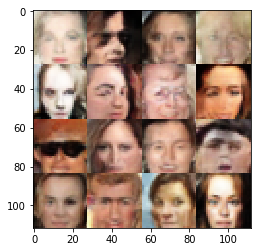

Epoch 15/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.6016... Generator Loss: 0.7429
Epoch 15/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4274... Generator Loss: 0.5224
Epoch 15/25...progress:74.87%....step:2830/3780... Discriminator Loss: 2.0926... Generator Loss: 0.2749
Epoch 15/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.4883... Generator Loss: 0.5493
Epoch 15/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.2910... Generator Loss: 0.7864
Epoch 15/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.7695... Generator Loss: 2.5607
Epoch 15/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.4225... Generator Loss: 0.5117
Epoch 15/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.3249... Generator Loss: 0.7597
Epoch 15/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.4758... Generator Loss: 0.6210
Epoch 15/25...progress:76.72%....step:2900/3780... Discriminator

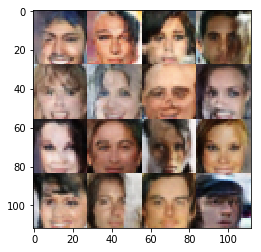

Epoch 15/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0380... Generator Loss: 0.8736
Epoch 15/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.2448... Generator Loss: 0.6124
Epoch 15/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.5731... Generator Loss: 0.4371
Epoch 15/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.9509... Generator Loss: 0.2792
Epoch 15/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.0012... Generator Loss: 0.2658
Epoch 15/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.9340... Generator Loss: 0.3133
Epoch 15/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.3082... Generator Loss: 0.6406
Epoch 15/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.2607... Generator Loss: 0.2284
Epoch 15/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.6330... Generator Loss: 0.4005
Epoch 15/25...progress:82.01%....step:3100/3780... Discriminator

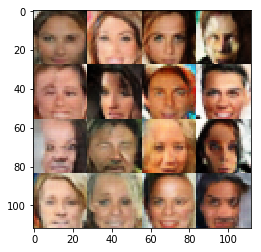

Epoch 15/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.8621... Generator Loss: 0.3032
Epoch 15/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.9366... Generator Loss: 0.2822
Epoch 15/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.7790... Generator Loss: 0.3365
Epoch 15/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.1558... Generator Loss: 1.0954
Epoch 15/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.3012... Generator Loss: 0.6949
Epoch 15/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.7780... Generator Loss: 0.3469
Epoch 15/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.3278... Generator Loss: 0.6310
Epoch 15/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.3989... Generator Loss: 0.5242
Epoch 15/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.7861... Generator Loss: 0.4112
Epoch 15/25...progress:87.30%....step:3300/3780... Discriminator

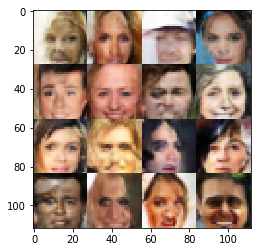

Epoch 15/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.2981... Generator Loss: 0.1947
Epoch 15/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.8291... Generator Loss: 0.2925
Epoch 15/25...progress:90.74%....step:3430/3780... Discriminator Loss: 2.0886... Generator Loss: 0.2708
Epoch 15/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.8511... Generator Loss: 0.3050
Epoch 15/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.0693... Generator Loss: 0.2751
Epoch 15/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.9349... Generator Loss: 0.2960
Epoch 15/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2336... Generator Loss: 0.8835
Epoch 15/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.4966... Generator Loss: 0.6088
Epoch 15/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.9247... Generator Loss: 0.3163
Epoch 15/25...progress:92.59%....step:3500/3780... Discriminator

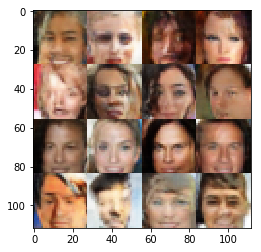

Epoch 15/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.2296... Generator Loss: 0.9258
Epoch 15/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.2185... Generator Loss: 0.6464
Epoch 15/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.0864... Generator Loss: 0.2368
Epoch 15/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.5995... Generator Loss: 0.4064
Epoch 15/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.2783... Generator Loss: 0.6298
Epoch 15/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.6683... Generator Loss: 0.4212
Epoch 15/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.1105... Generator Loss: 0.2496
Epoch 15/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.1660... Generator Loss: 0.2847
Epoch 15/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.5236... Generator Loss: 0.4714
Epoch 15/25...progress:97.88%....step:3700/3780... Discriminator

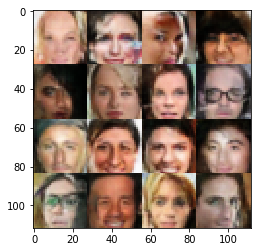

Epoch 16/25...progress:0.26%....step:10/3780... Discriminator Loss: 2.1609... Generator Loss: 0.2218
Epoch 16/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8028... Generator Loss: 0.3257
Epoch 16/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.7747... Generator Loss: 0.3628
Epoch 16/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9028... Generator Loss: 0.3657
Epoch 16/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3613... Generator Loss: 0.9206
Epoch 16/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.9125... Generator Loss: 0.2849
Epoch 16/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.2014... Generator Loss: 0.6855
Epoch 16/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.3143... Generator Loss: 0.2227
Epoch 16/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.2805... Generator Loss: 0.6848
Epoch 16/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.9225... Generator Lo

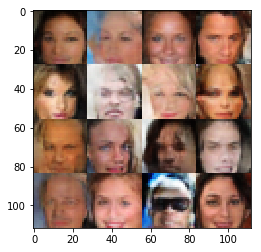

Epoch 16/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4674... Generator Loss: 0.5100
Epoch 16/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.3967... Generator Loss: 0.5932
Epoch 16/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.8815... Generator Loss: 0.3233
Epoch 16/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.0888... Generator Loss: 0.2468
Epoch 16/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.6329... Generator Loss: 0.4514
Epoch 16/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.2939... Generator Loss: 0.5823
Epoch 16/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.2439... Generator Loss: 0.2123
Epoch 16/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.2254... Generator Loss: 0.8377
Epoch 16/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.3759... Generator Loss: 0.6023
Epoch 16/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.7332... Gen

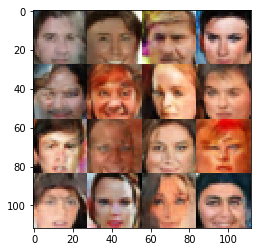

Epoch 16/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.6584... Generator Loss: 0.3592
Epoch 16/25...progress:11.11%....step:420/3780... Discriminator Loss: 0.9859... Generator Loss: 1.0733
Epoch 16/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.2272... Generator Loss: 0.1984
Epoch 16/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1254... Generator Loss: 0.9349
Epoch 16/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.3330... Generator Loss: 0.5868
Epoch 16/25...progress:12.17%....step:460/3780... Discriminator Loss: 0.8023... Generator Loss: 1.3302
Epoch 16/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2695... Generator Loss: 0.6609
Epoch 16/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.9913... Generator Loss: 0.9190
Epoch 16/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.1451... Generator Loss: 0.2439
Epoch 16/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.0

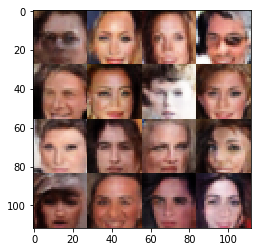

Epoch 16/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4637... Generator Loss: 0.7610
Epoch 16/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.0860... Generator Loss: 0.2577
Epoch 16/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.1955... Generator Loss: 0.8562
Epoch 16/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.8871... Generator Loss: 0.3038
Epoch 16/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.1580... Generator Loss: 0.2536
Epoch 16/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.7232... Generator Loss: 0.3880
Epoch 16/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.1503... Generator Loss: 1.0356
Epoch 16/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.3772... Generator Loss: 0.1679
Epoch 16/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.8997... Generator Loss: 0.2921
Epoch 16/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.1

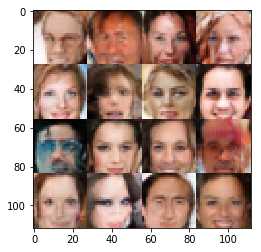

Epoch 16/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7693... Generator Loss: 0.7507
Epoch 16/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.6979... Generator Loss: 0.3939
Epoch 16/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1313... Generator Loss: 0.9332
Epoch 16/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.6821... Generator Loss: 0.4047
Epoch 16/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.4335... Generator Loss: 0.5095
Epoch 16/25...progress:22.75%....step:860/3780... Discriminator Loss: 2.2155... Generator Loss: 0.2420
Epoch 16/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.2979... Generator Loss: 0.5723
Epoch 16/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.3662... Generator Loss: 1.2855
Epoch 16/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.4900... Generator Loss: 0.1791
Epoch 16/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.7

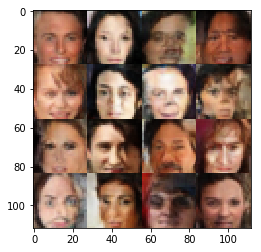

Epoch 16/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.0488... Generator Loss: 0.2422
Epoch 16/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.9457... Generator Loss: 0.1321
Epoch 16/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.2006... Generator Loss: 0.2493
Epoch 16/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2327... Generator Loss: 0.8052
Epoch 16/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.3399... Generator Loss: 0.2341
Epoch 16/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8988... Generator Loss: 1.0626
Epoch 16/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1128... Generator Loss: 0.8594
Epoch 16/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.0583... Generator Loss: 1.5155
Epoch 16/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.8288... Generator Loss: 0.3949
Epoch 16/25...progress:29.10%....step:1100/3780... Discriminator

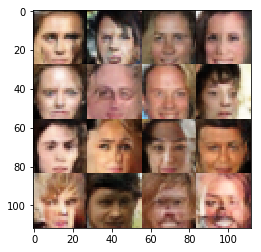

Epoch 16/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.4288... Generator Loss: 0.5208
Epoch 16/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.6992... Generator Loss: 0.4401
Epoch 16/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.2412... Generator Loss: 0.7931
Epoch 16/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.6299... Generator Loss: 0.4522
Epoch 16/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.0201... Generator Loss: 1.0689
Epoch 16/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.3134... Generator Loss: 0.6755
Epoch 16/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.3090... Generator Loss: 0.5852
Epoch 16/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1288... Generator Loss: 0.7275
Epoch 16/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3822... Generator Loss: 0.5824
Epoch 16/25...progress:34.39%....step:1300/3780... Discriminator

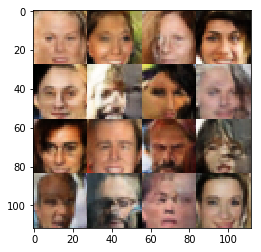

Epoch 16/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.6809... Generator Loss: 0.4100
Epoch 16/25...progress:37.57%....step:1420/3780... Discriminator Loss: 0.9914... Generator Loss: 1.1638
Epoch 16/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.2024... Generator Loss: 1.1336
Epoch 16/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.3453... Generator Loss: 0.6713
Epoch 16/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.0001... Generator Loss: 1.1677
Epoch 16/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.0758... Generator Loss: 0.2435
Epoch 16/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.6846... Generator Loss: 0.3881
Epoch 16/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.1587... Generator Loss: 0.8141
Epoch 16/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.6012... Generator Loss: 0.4067
Epoch 16/25...progress:39.68%....step:1500/3780... Discriminator

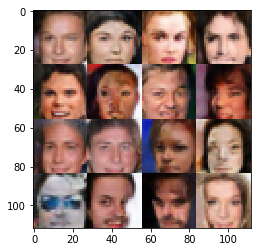

Epoch 16/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.3976... Generator Loss: 0.5985
Epoch 16/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.2999... Generator Loss: 0.6578
Epoch 16/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.2690... Generator Loss: 0.6691
Epoch 16/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.2462... Generator Loss: 0.7820
Epoch 16/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.3407... Generator Loss: 0.5521
Epoch 16/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.6776... Generator Loss: 0.4683
Epoch 16/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.1766... Generator Loss: 0.6899
Epoch 16/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.3595... Generator Loss: 0.5452
Epoch 16/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.7751... Generator Loss: 0.1290
Epoch 16/25...progress:44.97%....step:1700/3780... Discriminator

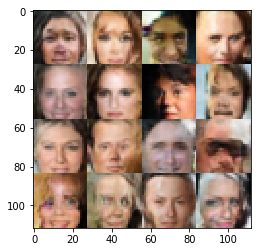

Epoch 16/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.2640... Generator Loss: 0.2080
Epoch 16/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.6952... Generator Loss: 0.3685
Epoch 16/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.8192... Generator Loss: 0.3834
Epoch 16/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4866... Generator Loss: 0.5398
Epoch 16/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.7735... Generator Loss: 1.2967
Epoch 16/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.4222... Generator Loss: 0.1747
Epoch 16/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.6174... Generator Loss: 0.4538
Epoch 16/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.6093... Generator Loss: 0.3964
Epoch 16/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6884... Generator Loss: 0.3730
Epoch 16/25...progress:50.26%....step:1900/3780... Discriminator

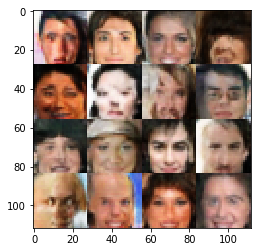

Epoch 16/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.3065... Generator Loss: 0.6205
Epoch 16/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6308... Generator Loss: 0.4338
Epoch 16/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.4171... Generator Loss: 0.6624
Epoch 16/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.2133... Generator Loss: 0.6771
Epoch 16/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.6780... Generator Loss: 0.3856
Epoch 16/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3965... Generator Loss: 0.5494
Epoch 16/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.9145... Generator Loss: 0.3109
Epoch 16/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.2208... Generator Loss: 0.7009
Epoch 16/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.2983... Generator Loss: 0.8259
Epoch 16/25...progress:55.56%....step:2100/3780... Discriminator

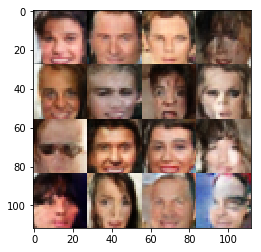

Epoch 16/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.1840... Generator Loss: 0.2310
Epoch 16/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.4958... Generator Loss: 0.5187
Epoch 16/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.2730... Generator Loss: 0.6680
Epoch 16/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.7141... Generator Loss: 0.3983
Epoch 16/25...progress:59.52%....step:2250/3780... Discriminator Loss: 2.1378... Generator Loss: 0.2294
Epoch 16/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5572... Generator Loss: 0.4437
Epoch 16/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.6919... Generator Loss: 0.1339
Epoch 16/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.9189... Generator Loss: 1.0194
Epoch 16/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.1830... Generator Loss: 0.8885
Epoch 16/25...progress:60.85%....step:2300/3780... Discriminator

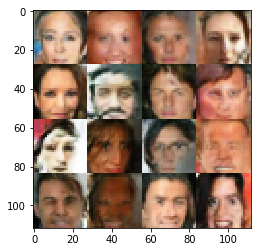

Epoch 16/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.2380... Generator Loss: 0.7227
Epoch 16/25...progress:64.02%....step:2420/3780... Discriminator Loss: 2.5725... Generator Loss: 0.1408
Epoch 16/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.3731... Generator Loss: 0.5960
Epoch 16/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.5695... Generator Loss: 0.6507
Epoch 16/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5892... Generator Loss: 0.4421
Epoch 16/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.3155... Generator Loss: 0.5713
Epoch 16/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.7454... Generator Loss: 0.3889
Epoch 16/25...progress:65.61%....step:2480/3780... Discriminator Loss: 0.9500... Generator Loss: 1.1606
Epoch 16/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9513... Generator Loss: 1.0386
Epoch 16/25...progress:66.14%....step:2500/3780... Discriminator

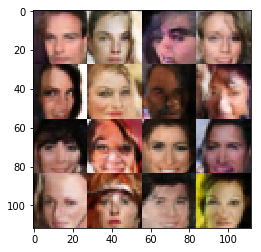

Epoch 16/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9953... Generator Loss: 0.3184
Epoch 16/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.6962... Generator Loss: 0.4436
Epoch 16/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.7494... Generator Loss: 0.3906
Epoch 16/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4182... Generator Loss: 0.5314
Epoch 16/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.9293... Generator Loss: 0.3433
Epoch 16/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.3690... Generator Loss: 0.2049
Epoch 16/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.7917... Generator Loss: 0.3876
Epoch 16/25...progress:70.90%....step:2680/3780... Discriminator Loss: 2.0278... Generator Loss: 0.2690
Epoch 16/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1627... Generator Loss: 0.6990
Epoch 16/25...progress:71.43%....step:2700/3780... Discriminator

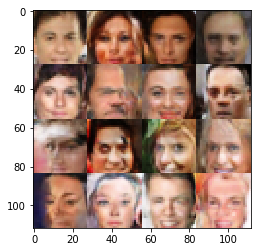

Epoch 16/25...progress:74.34%....step:2810/3780... Discriminator Loss: 2.1009... Generator Loss: 0.2540
Epoch 16/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4147... Generator Loss: 0.5189
Epoch 16/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.8843... Generator Loss: 0.3326
Epoch 16/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.4429... Generator Loss: 0.5368
Epoch 16/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.2171... Generator Loss: 0.2118
Epoch 16/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.4282... Generator Loss: 0.5161
Epoch 16/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.8483... Generator Loss: 0.3408
Epoch 16/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.3374... Generator Loss: 0.7916
Epoch 16/25...progress:76.46%....step:2890/3780... Discriminator Loss: 2.2860... Generator Loss: 0.2329
Epoch 16/25...progress:76.72%....step:2900/3780... Discriminator

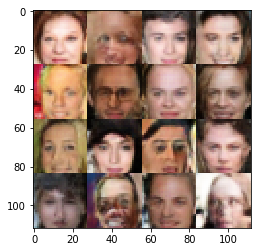

Epoch 16/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.6054... Generator Loss: 0.4261
Epoch 16/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.0424... Generator Loss: 0.9510
Epoch 16/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.3108... Generator Loss: 0.6961
Epoch 16/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.7031... Generator Loss: 0.3667
Epoch 16/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.6557... Generator Loss: 0.4031
Epoch 16/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.6985... Generator Loss: 0.4791
Epoch 16/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.7269... Generator Loss: 0.4598
Epoch 16/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.8260... Generator Loss: 0.3439
Epoch 16/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3654... Generator Loss: 0.5907
Epoch 16/25...progress:82.01%....step:3100/3780... Discriminator

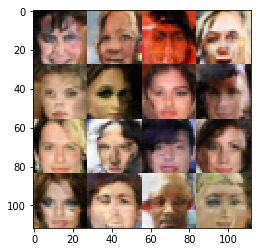

Epoch 16/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.8037... Generator Loss: 0.3404
Epoch 16/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.9527... Generator Loss: 0.2656
Epoch 16/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.3181... Generator Loss: 0.1872
Epoch 16/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.0951... Generator Loss: 0.2358
Epoch 16/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.6441... Generator Loss: 0.4167
Epoch 16/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.3554... Generator Loss: 0.8337
Epoch 16/25...progress:86.51%....step:3270/3780... Discriminator Loss: 2.1000... Generator Loss: 0.2381
Epoch 16/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2119... Generator Loss: 0.6946
Epoch 16/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.1942... Generator Loss: 0.6887
Epoch 16/25...progress:87.30%....step:3300/3780... Discriminator

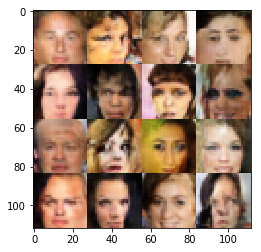

Epoch 16/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.1317... Generator Loss: 0.8351
Epoch 16/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.3309... Generator Loss: 0.5798
Epoch 16/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5577... Generator Loss: 0.5395
Epoch 16/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.3386... Generator Loss: 0.6110
Epoch 16/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.9772... Generator Loss: 0.2628
Epoch 16/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.3861... Generator Loss: 0.6391
Epoch 16/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2299... Generator Loss: 0.7702
Epoch 16/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.2944... Generator Loss: 0.6565
Epoch 16/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.4322... Generator Loss: 2.0027
Epoch 16/25...progress:92.59%....step:3500/3780... Discriminator

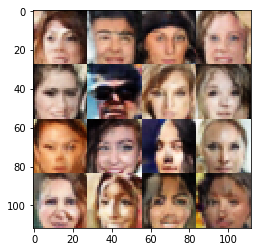

Epoch 16/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.3971... Generator Loss: 0.6717
Epoch 16/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.9873... Generator Loss: 0.3047
Epoch 16/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.3118... Generator Loss: 0.2017
Epoch 16/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.8497... Generator Loss: 0.2809
Epoch 16/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.8873... Generator Loss: 1.1312
Epoch 16/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.4329... Generator Loss: 0.5201
Epoch 16/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.6572... Generator Loss: 0.3840
Epoch 16/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.6652... Generator Loss: 0.3727
Epoch 16/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.6295... Generator Loss: 0.3675
Epoch 16/25...progress:97.88%....step:3700/3780... Discriminator

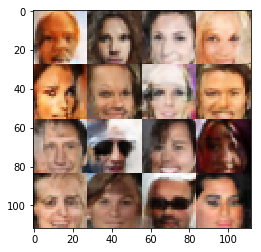

Epoch 17/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.4541... Generator Loss: 0.5283
Epoch 17/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.7264... Generator Loss: 0.4093
Epoch 17/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.4381... Generator Loss: 0.5691
Epoch 17/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9464... Generator Loss: 0.2964
Epoch 17/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.9854... Generator Loss: 1.9102
Epoch 17/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.0725... Generator Loss: 0.2407
Epoch 17/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.5035... Generator Loss: 0.4584
Epoch 17/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.0600... Generator Loss: 0.2648
Epoch 17/25...progress:2.38%....step:90/3780... Discriminator Loss: 2.4515... Generator Loss: 0.1758
Epoch 17/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.4659... Generator Lo

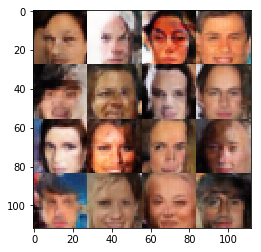

Epoch 17/25...progress:5.56%....step:210/3780... Discriminator Loss: 2.4594... Generator Loss: 0.1662
Epoch 17/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.9659... Generator Loss: 1.6366
Epoch 17/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.9146... Generator Loss: 0.3016
Epoch 17/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.6020... Generator Loss: 0.4127
Epoch 17/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.2140... Generator Loss: 0.7671
Epoch 17/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.5377... Generator Loss: 0.4879
Epoch 17/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.3309... Generator Loss: 0.1829
Epoch 17/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.3619... Generator Loss: 0.6175
Epoch 17/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2433... Generator Loss: 0.6544
Epoch 17/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.4124... Gen

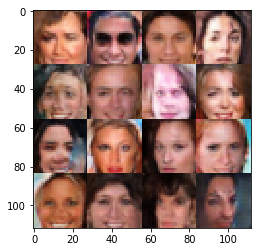

Epoch 17/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.3345... Generator Loss: 1.2544
Epoch 17/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.1495... Generator Loss: 0.8226
Epoch 17/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4966... Generator Loss: 0.5277
Epoch 17/25...progress:11.64%....step:440/3780... Discriminator Loss: 2.0933... Generator Loss: 1.9117
Epoch 17/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.9058... Generator Loss: 0.2776
Epoch 17/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.3434... Generator Loss: 0.6384
Epoch 17/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.4736... Generator Loss: 0.4728
Epoch 17/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.9982... Generator Loss: 1.0699
Epoch 17/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.2497... Generator Loss: 0.2173
Epoch 17/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.1

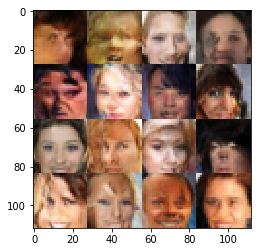

Epoch 17/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.6290... Generator Loss: 0.4534
Epoch 17/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.1084... Generator Loss: 0.2150
Epoch 17/25...progress:16.67%....step:630/3780... Discriminator Loss: 2.3441... Generator Loss: 0.2051
Epoch 17/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.7225... Generator Loss: 0.3666
Epoch 17/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.1416... Generator Loss: 0.2585
Epoch 17/25...progress:17.46%....step:660/3780... Discriminator Loss: 2.1043... Generator Loss: 0.2705
Epoch 17/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.2742... Generator Loss: 0.7943
Epoch 17/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.6055... Generator Loss: 0.1399
Epoch 17/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.4929... Generator Loss: 0.1506
Epoch 17/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.0

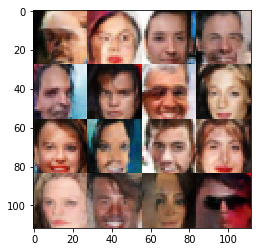

Epoch 17/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.6324... Generator Loss: 0.6742
Epoch 17/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.3487... Generator Loss: 0.5799
Epoch 17/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1353... Generator Loss: 0.7590
Epoch 17/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7892... Generator Loss: 0.3601
Epoch 17/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.3417... Generator Loss: 0.5736
Epoch 17/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.6086... Generator Loss: 0.3976
Epoch 17/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.1767... Generator Loss: 0.8900
Epoch 17/25...progress:23.28%....step:880/3780... Discriminator Loss: 2.1265... Generator Loss: 0.2386
Epoch 17/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.1229... Generator Loss: 0.2139
Epoch 17/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

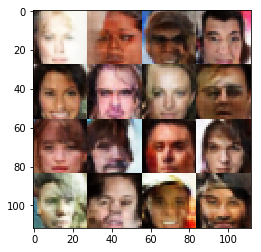

Epoch 17/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.9866... Generator Loss: 0.2743
Epoch 17/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.1815... Generator Loss: 0.2336
Epoch 17/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.6931... Generator Loss: 0.4193
Epoch 17/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.2412... Generator Loss: 0.9531
Epoch 17/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.4788... Generator Loss: 0.1862
Epoch 17/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.9033... Generator Loss: 1.0875
Epoch 17/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.0856... Generator Loss: 0.8353
Epoch 17/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.3521... Generator Loss: 0.5915
Epoch 17/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.8867... Generator Loss: 0.3002
Epoch 17/25...progress:29.10%....step:1100/3780... Discriminator

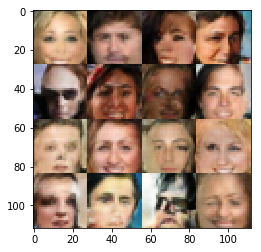

Epoch 17/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.7890... Generator Loss: 0.3465
Epoch 17/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3367... Generator Loss: 0.6871
Epoch 17/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.1555... Generator Loss: 0.7973
Epoch 17/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.6428... Generator Loss: 0.3868
Epoch 17/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.7258... Generator Loss: 0.3384
Epoch 17/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.4745... Generator Loss: 0.4775
Epoch 17/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.9814... Generator Loss: 0.2938
Epoch 17/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1771... Generator Loss: 0.7311
Epoch 17/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.8187... Generator Loss: 0.3358
Epoch 17/25...progress:34.39%....step:1300/3780... Discriminator

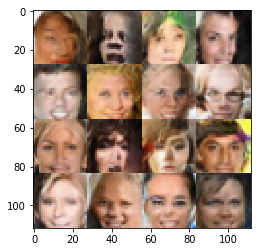

Epoch 17/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.9606... Generator Loss: 0.2841
Epoch 17/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0337... Generator Loss: 0.8514
Epoch 17/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.9532... Generator Loss: 0.2761
Epoch 17/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.9520... Generator Loss: 0.2763
Epoch 17/25...progress:38.36%....step:1450/3780... Discriminator Loss: 0.9871... Generator Loss: 1.0452
Epoch 17/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.9747... Generator Loss: 0.2849
Epoch 17/25...progress:38.89%....step:1470/3780... Discriminator Loss: 0.9609... Generator Loss: 0.9505
Epoch 17/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.4521... Generator Loss: 0.5354
Epoch 17/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2708... Generator Loss: 0.6901
Epoch 17/25...progress:39.68%....step:1500/3780... Discriminator

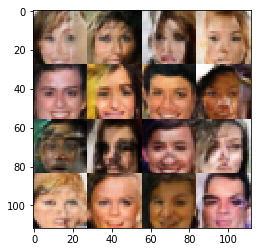

Epoch 17/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2401... Generator Loss: 0.9592
Epoch 17/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1414... Generator Loss: 0.7359
Epoch 17/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.9909... Generator Loss: 0.2932
Epoch 17/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.0893... Generator Loss: 0.9634
Epoch 17/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.9521... Generator Loss: 0.2944
Epoch 17/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.9760... Generator Loss: 0.3225
Epoch 17/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.0950... Generator Loss: 0.8929
Epoch 17/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.2403... Generator Loss: 0.6455
Epoch 17/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.5992... Generator Loss: 0.1438
Epoch 17/25...progress:44.97%....step:1700/3780... Discriminator

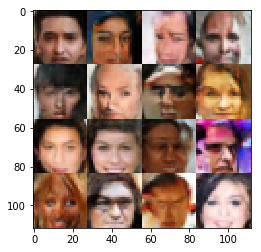

Epoch 17/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.3669... Generator Loss: 0.6094
Epoch 17/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8245... Generator Loss: 0.3100
Epoch 17/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.2914... Generator Loss: 0.1871
Epoch 17/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4744... Generator Loss: 0.5128
Epoch 17/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.9691... Generator Loss: 1.0773
Epoch 17/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.8764... Generator Loss: 0.3041
Epoch 17/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.4063... Generator Loss: 0.5319
Epoch 17/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.1055... Generator Loss: 0.2795
Epoch 17/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.1791... Generator Loss: 1.8205
Epoch 17/25...progress:50.26%....step:1900/3780... Discriminator

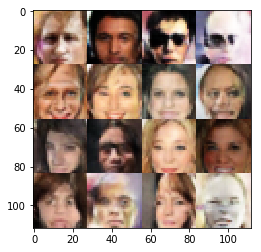

Epoch 17/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.5546... Generator Loss: 0.4450
Epoch 17/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6524... Generator Loss: 0.4250
Epoch 17/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.2448... Generator Loss: 1.2382
Epoch 17/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.1873... Generator Loss: 0.7000
Epoch 17/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.3819... Generator Loss: 0.6155
Epoch 17/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.7762... Generator Loss: 1.4606
Epoch 17/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.1325... Generator Loss: 0.7304
Epoch 17/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.4393... Generator Loss: 0.5560
Epoch 17/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.4257... Generator Loss: 0.5354
Epoch 17/25...progress:55.56%....step:2100/3780... Discriminator

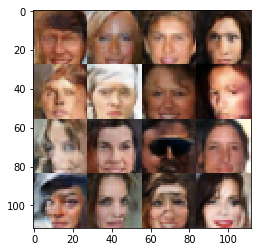

Epoch 17/25...progress:58.47%....step:2210/3780... Discriminator Loss: 1.7250... Generator Loss: 0.4111
Epoch 17/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.2302... Generator Loss: 0.7288
Epoch 17/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3144... Generator Loss: 0.7233
Epoch 17/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.7260... Generator Loss: 0.3368
Epoch 17/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.5800... Generator Loss: 0.4373
Epoch 17/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.8857... Generator Loss: 0.4250
Epoch 17/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.3821... Generator Loss: 0.1839
Epoch 17/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.4750... Generator Loss: 0.5041
Epoch 17/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4040... Generator Loss: 1.4785
Epoch 17/25...progress:60.85%....step:2300/3780... Discriminator

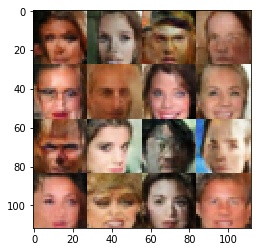

Epoch 17/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.4544... Generator Loss: 0.4948
Epoch 17/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.6803... Generator Loss: 0.4198
Epoch 17/25...progress:64.29%....step:2430/3780... Discriminator Loss: 2.5055... Generator Loss: 0.1526
Epoch 17/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4426... Generator Loss: 0.8150
Epoch 17/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.6225... Generator Loss: 0.4264
Epoch 17/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.6277... Generator Loss: 0.4409
Epoch 17/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.8687... Generator Loss: 0.3064
Epoch 17/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.1474... Generator Loss: 0.7466
Epoch 17/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8928... Generator Loss: 1.0553
Epoch 17/25...progress:66.14%....step:2500/3780... Discriminator

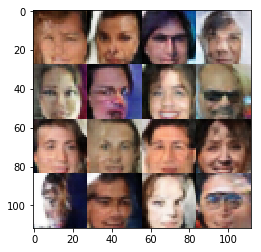

Epoch 17/25...progress:69.05%....step:2610/3780... Discriminator Loss: 2.2997... Generator Loss: 0.1960
Epoch 17/25...progress:69.31%....step:2620/3780... Discriminator Loss: 2.0474... Generator Loss: 0.2657
Epoch 17/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.3534... Generator Loss: 0.1787
Epoch 17/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.2578... Generator Loss: 0.9595
Epoch 17/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7513... Generator Loss: 0.3354
Epoch 17/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.7150... Generator Loss: 0.4070
Epoch 17/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.3459... Generator Loss: 0.6168
Epoch 17/25...progress:70.90%....step:2680/3780... Discriminator Loss: 2.1518... Generator Loss: 0.2217
Epoch 17/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.2289... Generator Loss: 1.0325
Epoch 17/25...progress:71.43%....step:2700/3780... Discriminator

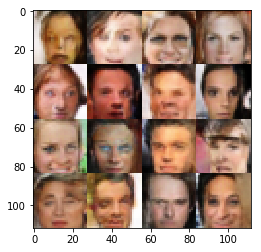

Epoch 17/25...progress:74.34%....step:2810/3780... Discriminator Loss: 2.4354... Generator Loss: 0.1680
Epoch 17/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.5479... Generator Loss: 0.4870
Epoch 17/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.0847... Generator Loss: 1.2637
Epoch 17/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.1363... Generator Loss: 1.0879
Epoch 17/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.5704... Generator Loss: 0.4199
Epoch 17/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.9148... Generator Loss: 0.2905
Epoch 17/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.7083... Generator Loss: 0.3958
Epoch 17/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.7186... Generator Loss: 0.3336
Epoch 17/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.6780... Generator Loss: 0.5272
Epoch 17/25...progress:76.72%....step:2900/3780... Discriminator

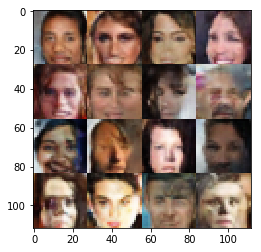

Epoch 17/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.2237... Generator Loss: 0.9494
Epoch 17/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.2368... Generator Loss: 0.6806
Epoch 17/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.6457... Generator Loss: 0.4745
Epoch 17/25...progress:80.42%....step:3040/3780... Discriminator Loss: 2.2552... Generator Loss: 0.1916
Epoch 17/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.0622... Generator Loss: 0.2561
Epoch 17/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.8760... Generator Loss: 0.3001
Epoch 17/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.0960... Generator Loss: 0.9131
Epoch 17/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0948... Generator Loss: 0.2610
Epoch 17/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.9187... Generator Loss: 0.3193
Epoch 17/25...progress:82.01%....step:3100/3780... Discriminator

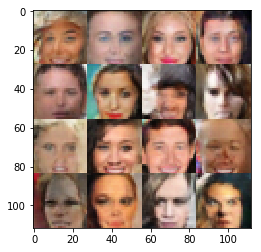

Epoch 17/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.6267... Generator Loss: 0.1434
Epoch 17/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.1557... Generator Loss: 0.2026
Epoch 17/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.6042... Generator Loss: 0.1515
Epoch 17/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.5571... Generator Loss: 0.4594
Epoch 17/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.1043... Generator Loss: 0.7776
Epoch 17/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.4388... Generator Loss: 0.5771
Epoch 17/25...progress:86.51%....step:3270/3780... Discriminator Loss: 2.3498... Generator Loss: 0.2028
Epoch 17/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2828... Generator Loss: 0.7346
Epoch 17/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.8444... Generator Loss: 0.3085
Epoch 17/25...progress:87.30%....step:3300/3780... Discriminator

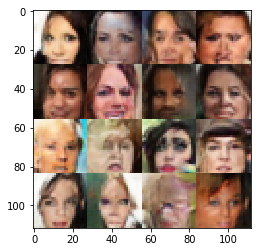

Epoch 17/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.9890... Generator Loss: 0.3227
Epoch 17/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.6114... Generator Loss: 0.3759
Epoch 17/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.9127... Generator Loss: 0.2844
Epoch 17/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.6509... Generator Loss: 0.6501
Epoch 17/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.6027... Generator Loss: 0.4329
Epoch 17/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.4541... Generator Loss: 0.5517
Epoch 17/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.6795... Generator Loss: 0.4453
Epoch 17/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.7654... Generator Loss: 0.3482
Epoch 17/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.8561... Generator Loss: 0.2887
Epoch 17/25...progress:92.59%....step:3500/3780... Discriminator

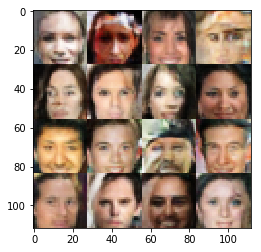

Epoch 17/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.5031... Generator Loss: 0.4809
Epoch 17/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.4772... Generator Loss: 0.5061
Epoch 17/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.0082... Generator Loss: 0.2664
Epoch 17/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.2136... Generator Loss: 0.2521
Epoch 17/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.1965... Generator Loss: 0.6512
Epoch 17/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7157... Generator Loss: 0.3695
Epoch 17/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.3750... Generator Loss: 0.1669
Epoch 17/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.6996... Generator Loss: 0.3876
Epoch 17/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.5527... Generator Loss: 0.5051
Epoch 17/25...progress:97.88%....step:3700/3780... Discriminator

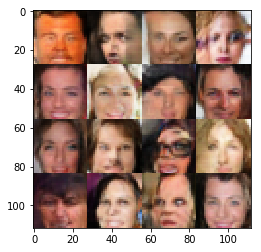

Epoch 18/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.5401... Generator Loss: 0.4153
Epoch 18/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.3399... Generator Loss: 0.5795
Epoch 18/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.4806... Generator Loss: 0.5303
Epoch 18/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9646... Generator Loss: 0.3052
Epoch 18/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3690... Generator Loss: 0.7031
Epoch 18/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.1886... Generator Loss: 0.2229
Epoch 18/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.6030... Generator Loss: 0.3692
Epoch 18/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.9716... Generator Loss: 0.3232
Epoch 18/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.3726... Generator Loss: 0.5788
Epoch 18/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.5620... Generator Lo

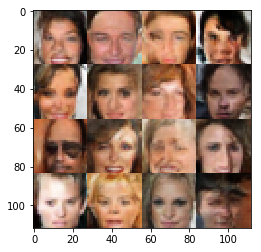

Epoch 18/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.6720... Generator Loss: 0.3980
Epoch 18/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.0347... Generator Loss: 0.9527
Epoch 18/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.5831... Generator Loss: 0.4561
Epoch 18/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.3973... Generator Loss: 0.7758
Epoch 18/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0282... Generator Loss: 0.9063
Epoch 18/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3841... Generator Loss: 1.5643
Epoch 18/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.9105... Generator Loss: 0.2611
Epoch 18/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7297... Generator Loss: 0.3578
Epoch 18/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.4745... Generator Loss: 0.5294
Epoch 18/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.7946... Gen

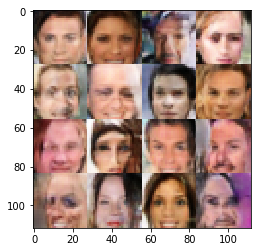

Epoch 18/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.3707... Generator Loss: 0.5395
Epoch 18/25...progress:11.11%....step:420/3780... Discriminator Loss: 0.9118... Generator Loss: 1.6195
Epoch 18/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4109... Generator Loss: 0.7311
Epoch 18/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1271... Generator Loss: 0.9608
Epoch 18/25...progress:11.90%....step:450/3780... Discriminator Loss: 2.3418... Generator Loss: 0.1863
Epoch 18/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.1673... Generator Loss: 1.2052
Epoch 18/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2853... Generator Loss: 0.5807
Epoch 18/25...progress:12.70%....step:480/3780... Discriminator Loss: 0.6629... Generator Loss: 2.5472
Epoch 18/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.2945... Generator Loss: 0.2329
Epoch 18/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.0

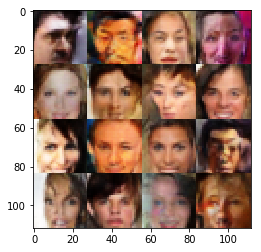

Epoch 18/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.9578... Generator Loss: 0.2874
Epoch 18/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.8617... Generator Loss: 0.3080
Epoch 18/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.5102... Generator Loss: 1.8713
Epoch 18/25...progress:16.93%....step:640/3780... Discriminator Loss: 2.0358... Generator Loss: 0.2654
Epoch 18/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.4700... Generator Loss: 0.5083
Epoch 18/25...progress:17.46%....step:660/3780... Discriminator Loss: 2.1920... Generator Loss: 0.2228
Epoch 18/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.5597... Generator Loss: 0.5619
Epoch 18/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.6312... Generator Loss: 0.1197
Epoch 18/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.0257... Generator Loss: 0.2611
Epoch 18/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.7

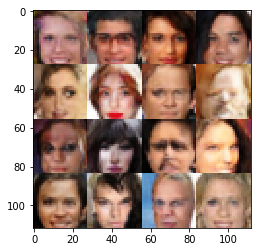

Epoch 18/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.9418... Generator Loss: 0.2848
Epoch 18/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.8056... Generator Loss: 0.3410
Epoch 18/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.2371... Generator Loss: 0.7383
Epoch 18/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.8779... Generator Loss: 0.2833
Epoch 18/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.7037... Generator Loss: 0.3643
Epoch 18/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.6644... Generator Loss: 0.3713
Epoch 18/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.6960... Generator Loss: 0.4138
Epoch 18/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.1408... Generator Loss: 1.0094
Epoch 18/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.3081... Generator Loss: 0.2059
Epoch 18/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

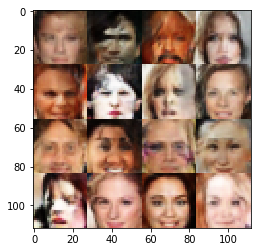

Epoch 18/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.1016... Generator Loss: 0.2339
Epoch 18/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.2135... Generator Loss: 0.2144
Epoch 18/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.8068... Generator Loss: 0.3490
Epoch 18/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.5800... Generator Loss: 0.4314
Epoch 18/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.2106... Generator Loss: 0.2276
Epoch 18/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.9482... Generator Loss: 1.0290
Epoch 18/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2146... Generator Loss: 0.6928
Epoch 18/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.0530... Generator Loss: 1.0023
Epoch 18/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.5361... Generator Loss: 0.4587
Epoch 18/25...progress:29.10%....step:1100/3780... Discriminator

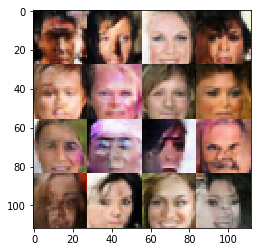

Epoch 18/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.3291... Generator Loss: 0.5713
Epoch 18/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.3423... Generator Loss: 0.5464
Epoch 18/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.3816... Generator Loss: 0.7174
Epoch 18/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.1870... Generator Loss: 0.7750
Epoch 18/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.4071... Generator Loss: 0.5505
Epoch 18/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.7217... Generator Loss: 0.3615
Epoch 18/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.0835... Generator Loss: 0.8362
Epoch 18/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.7987... Generator Loss: 0.3982
Epoch 18/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3448... Generator Loss: 0.6853
Epoch 18/25...progress:34.39%....step:1300/3780... Discriminator

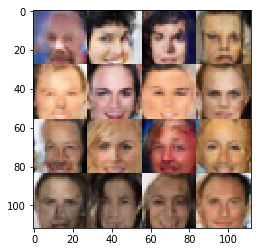

Epoch 18/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.1604... Generator Loss: 1.0313
Epoch 18/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.4007... Generator Loss: 0.5392
Epoch 18/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.6809... Generator Loss: 0.3976
Epoch 18/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.6282... Generator Loss: 0.4156
Epoch 18/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1760... Generator Loss: 0.7641
Epoch 18/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.7893... Generator Loss: 0.3228
Epoch 18/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1325... Generator Loss: 0.7410
Epoch 18/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.1262... Generator Loss: 1.0171
Epoch 18/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4055... Generator Loss: 0.5504
Epoch 18/25...progress:39.68%....step:1500/3780... Discriminator

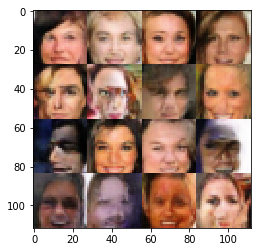

Epoch 18/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2499... Generator Loss: 0.7277
Epoch 18/25...progress:42.86%....step:1620/3780... Discriminator Loss: 0.9538... Generator Loss: 1.6454
Epoch 18/25...progress:43.12%....step:1630/3780... Discriminator Loss: 0.8061... Generator Loss: 1.6424
Epoch 18/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.2958... Generator Loss: 0.6717
Epoch 18/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.2785... Generator Loss: 0.7537
Epoch 18/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.9172... Generator Loss: 0.2888
Epoch 18/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.2892... Generator Loss: 0.6251
Epoch 18/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.5574... Generator Loss: 0.4334
Epoch 18/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.1581... Generator Loss: 0.2283
Epoch 18/25...progress:44.97%....step:1700/3780... Discriminator

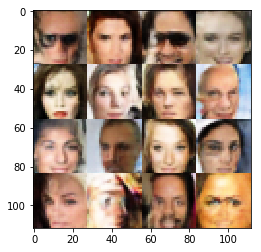

Epoch 18/25...progress:47.88%....step:1810/3780... Discriminator Loss: 0.9426... Generator Loss: 0.9686
Epoch 18/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.1565... Generator Loss: 0.2359
Epoch 18/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.3784... Generator Loss: 0.2073
Epoch 18/25...progress:48.68%....step:1840/3780... Discriminator Loss: 2.1435... Generator Loss: 0.2420
Epoch 18/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.9265... Generator Loss: 0.9707
Epoch 18/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0623... Generator Loss: 0.2542
Epoch 18/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3877... Generator Loss: 0.6405
Epoch 18/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.8765... Generator Loss: 0.3306
Epoch 18/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5602... Generator Loss: 0.5053
Epoch 18/25...progress:50.26%....step:1900/3780... Discriminator

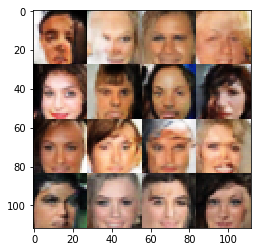

Epoch 18/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.0520... Generator Loss: 0.8672
Epoch 18/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.3684... Generator Loss: 0.5811
Epoch 18/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.1590... Generator Loss: 0.9808
Epoch 18/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.9159... Generator Loss: 0.3607
Epoch 18/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.9503... Generator Loss: 0.2758
Epoch 18/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3742... Generator Loss: 0.9654
Epoch 18/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.0513... Generator Loss: 0.9132
Epoch 18/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.0572... Generator Loss: 0.9685
Epoch 18/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.3751... Generator Loss: 1.3136
Epoch 18/25...progress:55.56%....step:2100/3780... Discriminator

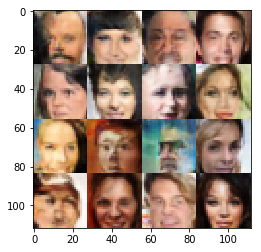

Epoch 18/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.3467... Generator Loss: 0.2184
Epoch 18/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.6882... Generator Loss: 0.3797
Epoch 18/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3549... Generator Loss: 0.5989
Epoch 18/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.5394... Generator Loss: 0.4616
Epoch 18/25...progress:59.52%....step:2250/3780... Discriminator Loss: 2.0741... Generator Loss: 0.2595
Epoch 18/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.3365... Generator Loss: 0.9248
Epoch 18/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.6240... Generator Loss: 0.1469
Epoch 18/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.6918... Generator Loss: 0.3831
Epoch 18/25...progress:60.58%....step:2290/3780... Discriminator Loss: 0.9919... Generator Loss: 1.7984
Epoch 18/25...progress:60.85%....step:2300/3780... Discriminator

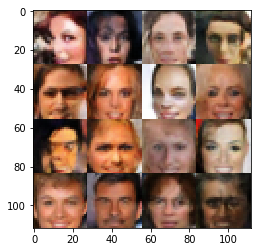

Epoch 18/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.3836... Generator Loss: 0.5449
Epoch 18/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.8663... Generator Loss: 0.3192
Epoch 18/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4889... Generator Loss: 0.4591
Epoch 18/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.3810... Generator Loss: 0.6048
Epoch 18/25...progress:64.81%....step:2450/3780... Discriminator Loss: 3.1541... Generator Loss: 0.0914
Epoch 18/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.3912... Generator Loss: 0.5888
Epoch 18/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.8234... Generator Loss: 0.3267
Epoch 18/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.4354... Generator Loss: 0.6384
Epoch 18/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9509... Generator Loss: 1.1221
Epoch 18/25...progress:66.14%....step:2500/3780... Discriminator

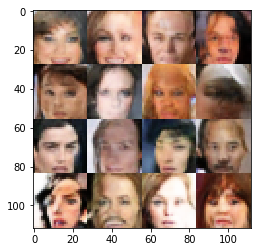

Epoch 18/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.6404... Generator Loss: 0.3877
Epoch 18/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.4570... Generator Loss: 0.4932
Epoch 18/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.6969... Generator Loss: 0.3844
Epoch 18/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.9015... Generator Loss: 0.3170
Epoch 18/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.9630... Generator Loss: 0.2641
Epoch 18/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.0804... Generator Loss: 0.2736
Epoch 18/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5336... Generator Loss: 0.4478
Epoch 18/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.9367... Generator Loss: 0.2786
Epoch 18/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1549... Generator Loss: 0.7609
Epoch 18/25...progress:71.43%....step:2700/3780... Discriminator

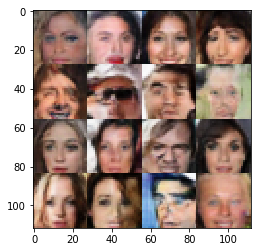

Epoch 18/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.7738... Generator Loss: 0.3786
Epoch 18/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.2200... Generator Loss: 0.6875
Epoch 18/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.4434... Generator Loss: 0.6081
Epoch 18/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.6504... Generator Loss: 0.4073
Epoch 18/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.8100... Generator Loss: 0.3018
Epoch 18/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.5347... Generator Loss: 0.4256
Epoch 18/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.2649... Generator Loss: 0.7209
Epoch 18/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.1887... Generator Loss: 0.7594
Epoch 18/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.5989... Generator Loss: 0.4175
Epoch 18/25...progress:76.72%....step:2900/3780... Discriminator

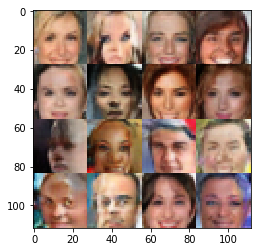

Epoch 18/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.0416... Generator Loss: 1.0576
Epoch 18/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.1321... Generator Loss: 0.8401
Epoch 18/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.7044... Generator Loss: 0.3582
Epoch 18/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.9049... Generator Loss: 0.2909
Epoch 18/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.5654... Generator Loss: 0.4456
Epoch 18/25...progress:80.95%....step:3060/3780... Discriminator Loss: 2.1314... Generator Loss: 0.2211
Epoch 18/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.0213... Generator Loss: 0.9101
Epoch 18/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.9209... Generator Loss: 0.3027
Epoch 18/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3676... Generator Loss: 0.6954
Epoch 18/25...progress:82.01%....step:3100/3780... Discriminator

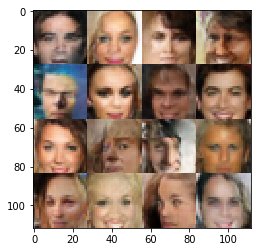

Epoch 18/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.8949... Generator Loss: 0.3068
Epoch 18/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.5737... Generator Loss: 0.1525
Epoch 18/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.3430... Generator Loss: 0.1797
Epoch 18/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.4861... Generator Loss: 0.1662
Epoch 18/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.6775... Generator Loss: 1.7032
Epoch 18/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.4438... Generator Loss: 1.1561
Epoch 18/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4906... Generator Loss: 0.4905
Epoch 18/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.1740... Generator Loss: 0.8217
Epoch 18/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.0095... Generator Loss: 1.0664
Epoch 18/25...progress:87.30%....step:3300/3780... Discriminator

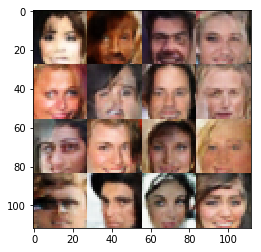

Epoch 18/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.4842... Generator Loss: 0.6007
Epoch 18/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.9342... Generator Loss: 0.2678
Epoch 18/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.4456... Generator Loss: 0.5967
Epoch 18/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.6605... Generator Loss: 0.4154
Epoch 18/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.4358... Generator Loss: 0.1657
Epoch 18/25...progress:91.53%....step:3460/3780... Discriminator Loss: 2.0403... Generator Loss: 0.3426
Epoch 18/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2845... Generator Loss: 0.7567
Epoch 18/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.9148... Generator Loss: 0.2924
Epoch 18/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.7849... Generator Loss: 0.3365
Epoch 18/25...progress:92.59%....step:3500/3780... Discriminator

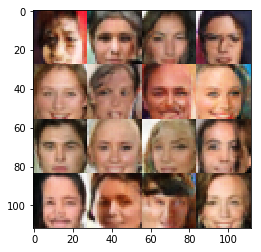

Epoch 18/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.4659... Generator Loss: 1.4163
Epoch 18/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.4095... Generator Loss: 0.4957
Epoch 18/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.1449... Generator Loss: 0.2093
Epoch 18/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.4926... Generator Loss: 0.4990
Epoch 18/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9201... Generator Loss: 1.0118
Epoch 18/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.7788... Generator Loss: 0.3875
Epoch 18/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.4446... Generator Loss: 0.1650
Epoch 18/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.7945... Generator Loss: 0.3584
Epoch 18/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.0852... Generator Loss: 0.2601
Epoch 18/25...progress:97.88%....step:3700/3780... Discriminator

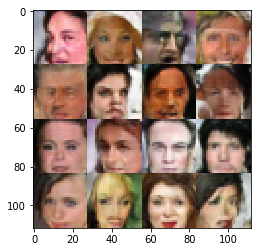

Epoch 19/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.7705... Generator Loss: 0.3560
Epoch 19/25...progress:0.53%....step:20/3780... Discriminator Loss: 2.3896... Generator Loss: 0.2082
Epoch 19/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.4902... Generator Loss: 0.4548
Epoch 19/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.5576... Generator Loss: 0.4423
Epoch 19/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.3742... Generator Loss: 0.8848
Epoch 19/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.5676... Generator Loss: 0.4219
Epoch 19/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.4496... Generator Loss: 0.4882
Epoch 19/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.4111... Generator Loss: 0.5807
Epoch 19/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.3383... Generator Loss: 0.5628
Epoch 19/25...progress:2.65%....step:100/3780... Discriminator Loss: 2.0375... Generator Lo

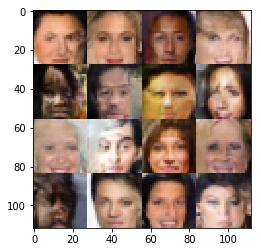

Epoch 19/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.2266... Generator Loss: 0.6367
Epoch 19/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.9623... Generator Loss: 1.0305
Epoch 19/25...progress:6.08%....step:230/3780... Discriminator Loss: 3.1230... Generator Loss: 0.0861
Epoch 19/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.8339... Generator Loss: 0.3042
Epoch 19/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.2040... Generator Loss: 0.6611
Epoch 19/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.6063... Generator Loss: 0.4651
Epoch 19/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.1962... Generator Loss: 0.2260
Epoch 19/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5565... Generator Loss: 0.8241
Epoch 19/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.1755... Generator Loss: 1.0127
Epoch 19/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.2134... Gen

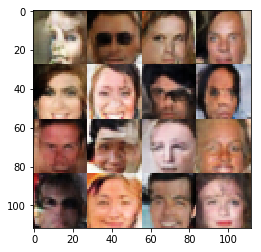

Epoch 19/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.9441... Generator Loss: 0.3300
Epoch 19/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2576... Generator Loss: 0.7174
Epoch 19/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.0629... Generator Loss: 0.2964
Epoch 19/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1929... Generator Loss: 0.8788
Epoch 19/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.5978... Generator Loss: 0.4085
Epoch 19/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.4787... Generator Loss: 0.4809
Epoch 19/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.1601... Generator Loss: 0.8055
Epoch 19/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0951... Generator Loss: 0.7712
Epoch 19/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.2652... Generator Loss: 0.2288
Epoch 19/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.3

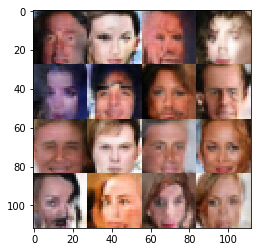

Epoch 19/25...progress:16.14%....step:610/3780... Discriminator Loss: 2.0727... Generator Loss: 0.2413
Epoch 19/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.7871... Generator Loss: 0.3516
Epoch 19/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.0984... Generator Loss: 0.7796
Epoch 19/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.5993... Generator Loss: 0.4215
Epoch 19/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.8521... Generator Loss: 0.3975
Epoch 19/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.7785... Generator Loss: 0.3559
Epoch 19/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.4546... Generator Loss: 0.5058
Epoch 19/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.0249... Generator Loss: 0.2524
Epoch 19/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.2295... Generator Loss: 0.1925
Epoch 19/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.9

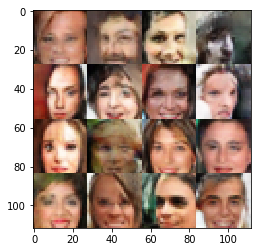

Epoch 19/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7162... Generator Loss: 0.3946
Epoch 19/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.7185... Generator Loss: 0.3432
Epoch 19/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.4884... Generator Loss: 0.4683
Epoch 19/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7614... Generator Loss: 0.3199
Epoch 19/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.4309... Generator Loss: 0.4922
Epoch 19/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7015... Generator Loss: 0.3674
Epoch 19/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.5403... Generator Loss: 0.4277
Epoch 19/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.5047... Generator Loss: 0.5684
Epoch 19/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.1750... Generator Loss: 0.2453
Epoch 19/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.9

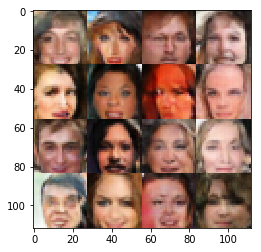

Epoch 19/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.7844... Generator Loss: 0.3377
Epoch 19/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.0962... Generator Loss: 0.2757
Epoch 19/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.0188... Generator Loss: 0.2627
Epoch 19/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.1140... Generator Loss: 0.7993
Epoch 19/25...progress:27.78%....step:1050/3780... Discriminator Loss: 2.4379... Generator Loss: 0.1750
Epoch 19/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.0458... Generator Loss: 0.9691
Epoch 19/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.5754... Generator Loss: 0.4551
Epoch 19/25...progress:28.57%....step:1080/3780... Discriminator Loss: 2.0080... Generator Loss: 0.3077
Epoch 19/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.8024... Generator Loss: 0.3642
Epoch 19/25...progress:29.10%....step:1100/3780... Discriminator

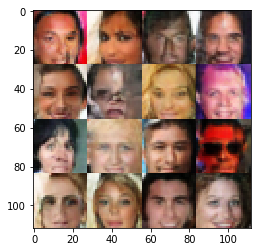

Epoch 19/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.8322... Generator Loss: 0.3793
Epoch 19/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.8231... Generator Loss: 0.3235
Epoch 19/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.3267... Generator Loss: 0.6016
Epoch 19/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.3330... Generator Loss: 0.6242
Epoch 19/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.3021... Generator Loss: 0.6231
Epoch 19/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.9484... Generator Loss: 0.2978
Epoch 19/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.5037... Generator Loss: 0.4808
Epoch 19/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.2208... Generator Loss: 0.6542
Epoch 19/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3143... Generator Loss: 0.6828
Epoch 19/25...progress:34.39%....step:1300/3780... Discriminator

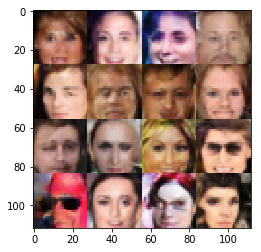

Epoch 19/25...progress:37.30%....step:1410/3780... Discriminator Loss: 2.1609... Generator Loss: 0.2480
Epoch 19/25...progress:37.57%....step:1420/3780... Discriminator Loss: 0.9567... Generator Loss: 1.6580
Epoch 19/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.4785... Generator Loss: 0.4928
Epoch 19/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.6937... Generator Loss: 0.1326
Epoch 19/25...progress:38.36%....step:1450/3780... Discriminator Loss: 0.8635... Generator Loss: 1.3516
Epoch 19/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.7619... Generator Loss: 0.1321
Epoch 19/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.2059... Generator Loss: 0.8976
Epoch 19/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.5252... Generator Loss: 0.4262
Epoch 19/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4958... Generator Loss: 0.5334
Epoch 19/25...progress:39.68%....step:1500/3780... Discriminator

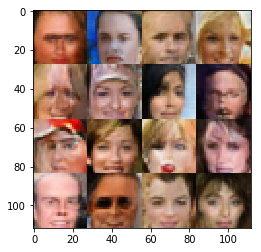

Epoch 19/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.4054... Generator Loss: 0.5598
Epoch 19/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.4890... Generator Loss: 0.4635
Epoch 19/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.3407... Generator Loss: 0.5781
Epoch 19/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.6158... Generator Loss: 0.3970
Epoch 19/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.7638... Generator Loss: 0.3522
Epoch 19/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.7492... Generator Loss: 0.3830
Epoch 19/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.2071... Generator Loss: 0.6882
Epoch 19/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.6046... Generator Loss: 0.4369
Epoch 19/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.3875... Generator Loss: 0.1726
Epoch 19/25...progress:44.97%....step:1700/3780... Discriminator

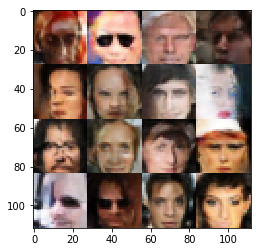

Epoch 19/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.8734... Generator Loss: 0.3196
Epoch 19/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.7965... Generator Loss: 0.3226
Epoch 19/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.1642... Generator Loss: 0.2391
Epoch 19/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.3088... Generator Loss: 0.6159
Epoch 19/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.7168... Generator Loss: 1.4842
Epoch 19/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.8526... Generator Loss: 0.3109
Epoch 19/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3644... Generator Loss: 0.5906
Epoch 19/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.9723... Generator Loss: 0.3275
Epoch 19/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.5976... Generator Loss: 0.3924
Epoch 19/25...progress:50.26%....step:1900/3780... Discriminator

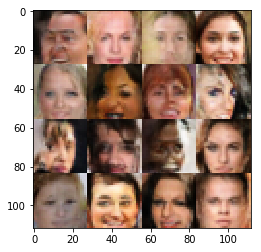

Epoch 19/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.6191... Generator Loss: 0.4682
Epoch 19/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6279... Generator Loss: 0.3988
Epoch 19/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.2977... Generator Loss: 0.7610
Epoch 19/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.6452... Generator Loss: 0.4538
Epoch 19/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.4415... Generator Loss: 0.5557
Epoch 19/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.5978... Generator Loss: 1.8604
Epoch 19/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.1569... Generator Loss: 0.7803
Epoch 19/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.7009... Generator Loss: 0.3868
Epoch 19/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.7284... Generator Loss: 0.3634
Epoch 19/25...progress:55.56%....step:2100/3780... Discriminator

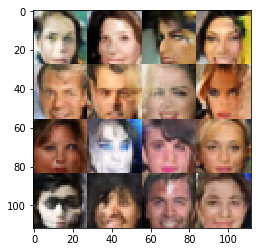

Epoch 19/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.2169... Generator Loss: 0.2214
Epoch 19/25...progress:58.73%....step:2220/3780... Discriminator Loss: 2.0098... Generator Loss: 0.2630
Epoch 19/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.3270... Generator Loss: 0.6031
Epoch 19/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.3169... Generator Loss: 0.6546
Epoch 19/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.9845... Generator Loss: 0.2919
Epoch 19/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.2876... Generator Loss: 0.8598
Epoch 19/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.0711... Generator Loss: 0.2523
Epoch 19/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.6198... Generator Loss: 0.3856
Epoch 19/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.5062... Generator Loss: 2.4538
Epoch 19/25...progress:60.85%....step:2300/3780... Discriminator

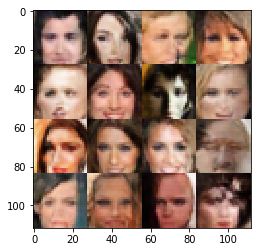

Epoch 19/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.0415... Generator Loss: 0.9060
Epoch 19/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.7859... Generator Loss: 0.3314
Epoch 19/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4469... Generator Loss: 0.5707
Epoch 19/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.2671... Generator Loss: 0.8381
Epoch 19/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.3100... Generator Loss: 0.6405
Epoch 19/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.8254... Generator Loss: 0.3626
Epoch 19/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.1827... Generator Loss: 0.2510
Epoch 19/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.2418... Generator Loss: 0.7339
Epoch 19/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9080... Generator Loss: 1.0371
Epoch 19/25...progress:66.14%....step:2500/3780... Discriminator

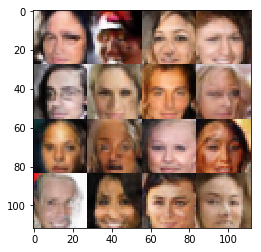

Epoch 19/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.8888... Generator Loss: 0.3143
Epoch 19/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.4431... Generator Loss: 0.5171
Epoch 19/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.0795... Generator Loss: 0.2471
Epoch 19/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.6936... Generator Loss: 0.4861
Epoch 19/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.4894... Generator Loss: 0.5147
Epoch 19/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.1602... Generator Loss: 0.2370
Epoch 19/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.4650... Generator Loss: 0.5101
Epoch 19/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.6668... Generator Loss: 0.3940
Epoch 19/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.2156... Generator Loss: 0.7426
Epoch 19/25...progress:71.43%....step:2700/3780... Discriminator

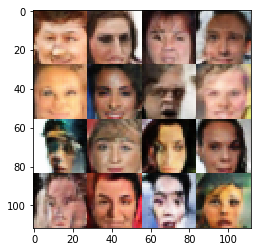

Epoch 19/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.7910... Generator Loss: 0.3548
Epoch 19/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.8780... Generator Loss: 0.3129
Epoch 19/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.0342... Generator Loss: 0.8616
Epoch 19/25...progress:75.13%....step:2840/3780... Discriminator Loss: 2.0555... Generator Loss: 0.2399
Epoch 19/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.9372... Generator Loss: 0.2799
Epoch 19/25...progress:75.66%....step:2860/3780... Discriminator Loss: 2.3942... Generator Loss: 0.2359
Epoch 19/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.3806... Generator Loss: 0.5722
Epoch 19/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.0104... Generator Loss: 1.1364
Epoch 19/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.4258... Generator Loss: 0.5053
Epoch 19/25...progress:76.72%....step:2900/3780... Discriminator

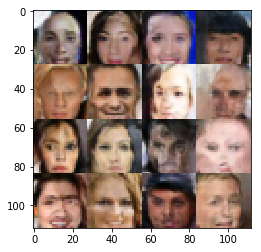

Epoch 19/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.8900... Generator Loss: 1.1133
Epoch 19/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.3193... Generator Loss: 0.6981
Epoch 19/25...progress:80.16%....step:3030/3780... Discriminator Loss: 2.3637... Generator Loss: 0.1715
Epoch 19/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.3669... Generator Loss: 0.7974
Epoch 19/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.7053... Generator Loss: 0.3903
Epoch 19/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.8275... Generator Loss: 0.3299
Epoch 19/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.3802... Generator Loss: 0.5552
Epoch 19/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.3424... Generator Loss: 0.2139
Epoch 19/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.6359... Generator Loss: 0.4187
Epoch 19/25...progress:82.01%....step:3100/3780... Discriminator

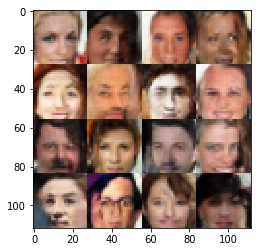

Epoch 19/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.0841... Generator Loss: 0.3215
Epoch 19/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.9735... Generator Loss: 0.2687
Epoch 19/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.9534... Generator Loss: 0.3218
Epoch 19/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.2931... Generator Loss: 0.7631
Epoch 19/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.7334... Generator Loss: 0.3690
Epoch 19/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.7961... Generator Loss: 0.3319
Epoch 19/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.3995... Generator Loss: 0.5357
Epoch 19/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.4856... Generator Loss: 0.4904
Epoch 19/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.3150... Generator Loss: 0.6243
Epoch 19/25...progress:87.30%....step:3300/3780... Discriminator

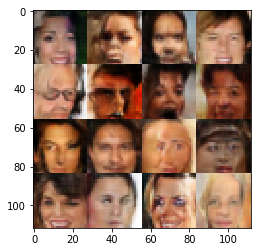

Epoch 19/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.2593... Generator Loss: 0.6846
Epoch 19/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.7485... Generator Loss: 0.3725
Epoch 19/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.1250... Generator Loss: 0.7908
Epoch 19/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.4791... Generator Loss: 0.4559
Epoch 19/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.6712... Generator Loss: 0.3939
Epoch 19/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.1732... Generator Loss: 0.7571
Epoch 19/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.1814... Generator Loss: 1.2697
Epoch 19/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.9694... Generator Loss: 0.2852
Epoch 19/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.6033... Generator Loss: 0.4626
Epoch 19/25...progress:92.59%....step:3500/3780... Discriminator

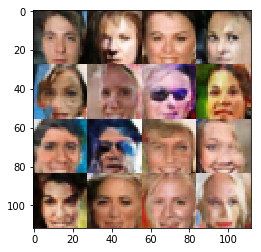

Epoch 19/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.6596... Generator Loss: 1.5945
Epoch 19/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.5964... Generator Loss: 0.4608
Epoch 19/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.8390... Generator Loss: 0.3278
Epoch 19/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.1090... Generator Loss: 0.2162
Epoch 19/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.2096... Generator Loss: 0.7058
Epoch 19/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.8569... Generator Loss: 0.3050
Epoch 19/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.1584... Generator Loss: 0.2533
Epoch 19/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.5021... Generator Loss: 0.4828
Epoch 19/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.8195... Generator Loss: 0.3128
Epoch 19/25...progress:97.88%....step:3700/3780... Discriminator

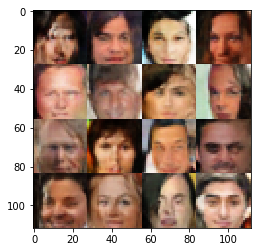

Epoch 20/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.2956... Generator Loss: 0.6568
Epoch 20/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.9658... Generator Loss: 0.3141
Epoch 20/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.4337... Generator Loss: 0.5690
Epoch 20/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.8057... Generator Loss: 0.3691
Epoch 20/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.2939... Generator Loss: 0.6959
Epoch 20/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.0877... Generator Loss: 0.2253
Epoch 20/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.5386... Generator Loss: 0.4589
Epoch 20/25...progress:2.12%....step:80/3780... Discriminator Loss: 2.2305... Generator Loss: 0.2167
Epoch 20/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.7606... Generator Loss: 0.3462
Epoch 20/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.7289... Generator Lo

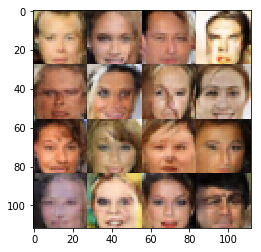

Epoch 20/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4419... Generator Loss: 0.6336
Epoch 20/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.4440... Generator Loss: 0.5156
Epoch 20/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.6105... Generator Loss: 0.4270
Epoch 20/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.5536... Generator Loss: 0.4386
Epoch 20/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0112... Generator Loss: 0.9068
Epoch 20/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.2183... Generator Loss: 0.7176
Epoch 20/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.5332... Generator Loss: 0.4424
Epoch 20/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5281... Generator Loss: 0.4740
Epoch 20/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.4293... Generator Loss: 0.5744
Epoch 20/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.1021... Gen

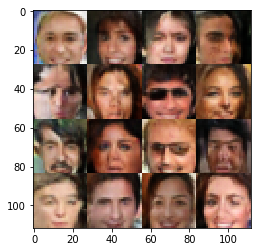

Epoch 20/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.6079... Generator Loss: 0.4359
Epoch 20/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2037... Generator Loss: 1.2728
Epoch 20/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.5304... Generator Loss: 0.5807
Epoch 20/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.7776... Generator Loss: 0.3368
Epoch 20/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.6651... Generator Loss: 0.3923
Epoch 20/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.2737... Generator Loss: 0.7244
Epoch 20/25...progress:12.43%....step:470/3780... Discriminator Loss: 2.6311... Generator Loss: 0.1935
Epoch 20/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.4448... Generator Loss: 0.4793
Epoch 20/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.2871... Generator Loss: 0.2175
Epoch 20/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.8

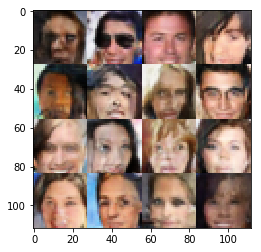

Epoch 20/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.6092... Generator Loss: 0.4892
Epoch 20/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.9780... Generator Loss: 0.2877
Epoch 20/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.1874... Generator Loss: 0.8438
Epoch 20/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.6738... Generator Loss: 0.3832
Epoch 20/25...progress:17.20%....step:650/3780... Discriminator Loss: 1.6497... Generator Loss: 0.5800
Epoch 20/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.2713... Generator Loss: 0.5954
Epoch 20/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.3339... Generator Loss: 1.0840
Epoch 20/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.8809... Generator Loss: 0.3369
Epoch 20/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.2716... Generator Loss: 0.2329
Epoch 20/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.3

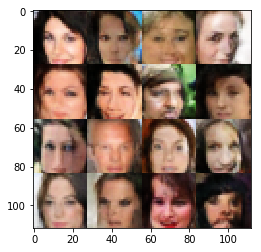

Epoch 20/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5381... Generator Loss: 0.6315
Epoch 20/25...progress:21.69%....step:820/3780... Discriminator Loss: 2.0687... Generator Loss: 0.3001
Epoch 20/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.1354... Generator Loss: 0.7909
Epoch 20/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.6245... Generator Loss: 0.4625
Epoch 20/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.6246... Generator Loss: 0.4117
Epoch 20/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.4695... Generator Loss: 0.5235
Epoch 20/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.5826... Generator Loss: 0.4517
Epoch 20/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.2583... Generator Loss: 1.0644
Epoch 20/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.2467... Generator Loss: 0.2662
Epoch 20/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.5

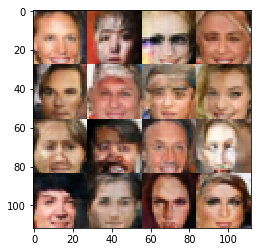

Epoch 20/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.2441... Generator Loss: 0.6503
Epoch 20/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.4187... Generator Loss: 0.1811
Epoch 20/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.6070... Generator Loss: 0.4317
Epoch 20/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.8768... Generator Loss: 0.3394
Epoch 20/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.5543... Generator Loss: 0.4261
Epoch 20/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.1099... Generator Loss: 0.8417
Epoch 20/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1544... Generator Loss: 0.8593
Epoch 20/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.9052... Generator Loss: 1.0710
Epoch 20/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.9732... Generator Loss: 0.2784
Epoch 20/25...progress:29.10%....step:1100/3780... Discriminator

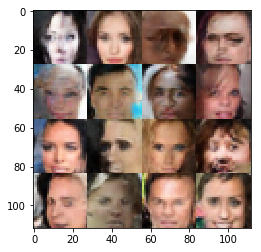

Epoch 20/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.7385... Generator Loss: 0.3792
Epoch 20/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.4043... Generator Loss: 0.5079
Epoch 20/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.3435... Generator Loss: 0.6279
Epoch 20/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.5287... Generator Loss: 0.4630
Epoch 20/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.4412... Generator Loss: 0.5189
Epoch 20/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.3210... Generator Loss: 0.6235
Epoch 20/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.2707... Generator Loss: 0.6005
Epoch 20/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1960... Generator Loss: 0.7456
Epoch 20/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.0224... Generator Loss: 1.8072
Epoch 20/25...progress:34.39%....step:1300/3780... Discriminator

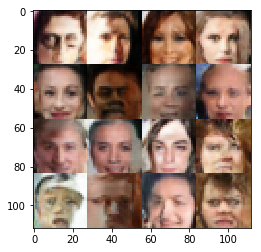

Epoch 20/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.0820... Generator Loss: 1.0143
Epoch 20/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.5051... Generator Loss: 0.4892
Epoch 20/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.7729... Generator Loss: 0.3378
Epoch 20/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.2365... Generator Loss: 0.2012
Epoch 20/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1872... Generator Loss: 0.7021
Epoch 20/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.9572... Generator Loss: 0.3540
Epoch 20/25...progress:38.89%....step:1470/3780... Discriminator Loss: 2.0510... Generator Loss: 0.3000
Epoch 20/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.7284... Generator Loss: 0.3892
Epoch 20/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.1318... Generator Loss: 0.8488
Epoch 20/25...progress:39.68%....step:1500/3780... Discriminator

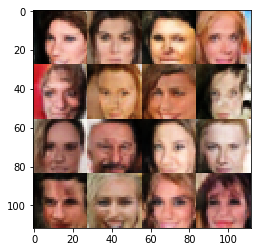

Epoch 20/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.2173... Generator Loss: 0.8145
Epoch 20/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.3718... Generator Loss: 0.5968
Epoch 20/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.0591... Generator Loss: 0.9410
Epoch 20/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.0639... Generator Loss: 1.4372
Epoch 20/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.2323... Generator Loss: 0.7946
Epoch 20/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.9095... Generator Loss: 0.3022
Epoch 20/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.8891... Generator Loss: 1.0968
Epoch 20/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4959... Generator Loss: 0.4809
Epoch 20/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.6374... Generator Loss: 0.1345
Epoch 20/25...progress:44.97%....step:1700/3780... Discriminator

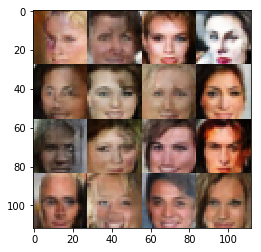

Epoch 20/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.7236... Generator Loss: 0.3900
Epoch 20/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.5026... Generator Loss: 0.5307
Epoch 20/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.4755... Generator Loss: 0.4849
Epoch 20/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.2519... Generator Loss: 0.7784
Epoch 20/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.9744... Generator Loss: 0.9920
Epoch 20/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.1707... Generator Loss: 0.2498
Epoch 20/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.5872... Generator Loss: 0.4033
Epoch 20/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.6900... Generator Loss: 0.4065
Epoch 20/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.3219... Generator Loss: 0.6783
Epoch 20/25...progress:50.26%....step:1900/3780... Discriminator

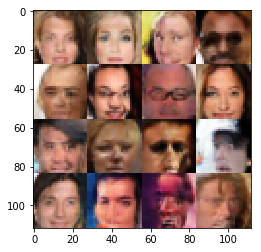

Epoch 20/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.5702... Generator Loss: 0.4264
Epoch 20/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6104... Generator Loss: 0.5065
Epoch 20/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.5066... Generator Loss: 0.4633
Epoch 20/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.3570... Generator Loss: 0.6334
Epoch 20/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.2974... Generator Loss: 0.6489
Epoch 20/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.2134... Generator Loss: 1.3758
Epoch 20/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.6695... Generator Loss: 0.4077
Epoch 20/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.6143... Generator Loss: 0.3974
Epoch 20/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.5726... Generator Loss: 0.4594
Epoch 20/25...progress:55.56%....step:2100/3780... Discriminator

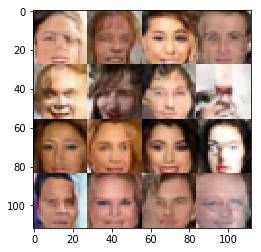

Epoch 20/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.8957... Generator Loss: 0.1166
Epoch 20/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.5289... Generator Loss: 0.5588
Epoch 20/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.5345... Generator Loss: 0.5585
Epoch 20/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.0887... Generator Loss: 0.8821
Epoch 20/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.4341... Generator Loss: 0.5132
Epoch 20/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.8338... Generator Loss: 0.3913
Epoch 20/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.7337... Generator Loss: 0.3788
Epoch 20/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.8734... Generator Loss: 0.3195
Epoch 20/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.0478... Generator Loss: 1.4996
Epoch 20/25...progress:60.85%....step:2300/3780... Discriminator

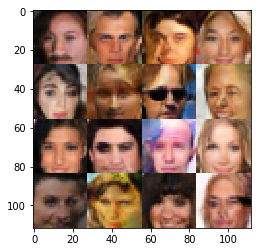

Epoch 20/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.3309... Generator Loss: 0.6242
Epoch 20/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.8367... Generator Loss: 0.3150
Epoch 20/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4150... Generator Loss: 0.5639
Epoch 20/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4130... Generator Loss: 0.6255
Epoch 20/25...progress:64.81%....step:2450/3780... Discriminator Loss: 2.7009... Generator Loss: 0.1209
Epoch 20/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5657... Generator Loss: 0.4791
Epoch 20/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.5087... Generator Loss: 0.1599
Epoch 20/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.4509... Generator Loss: 0.5186
Epoch 20/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8827... Generator Loss: 1.7476
Epoch 20/25...progress:66.14%....step:2500/3780... Discriminator

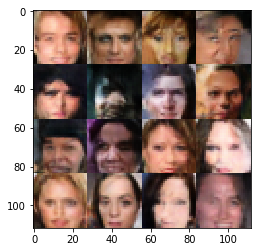

Epoch 20/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.7801... Generator Loss: 0.3157
Epoch 20/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.8313... Generator Loss: 0.3149
Epoch 20/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.0971... Generator Loss: 0.2561
Epoch 20/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.3447... Generator Loss: 0.8586
Epoch 20/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.4754... Generator Loss: 0.1914
Epoch 20/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.8947... Generator Loss: 0.1071
Epoch 20/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5289... Generator Loss: 0.4824
Epoch 20/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.9715... Generator Loss: 0.2755
Epoch 20/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.0401... Generator Loss: 0.9055
Epoch 20/25...progress:71.43%....step:2700/3780... Discriminator

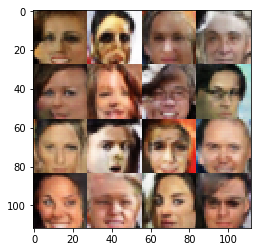

Epoch 20/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.9933... Generator Loss: 0.2745
Epoch 20/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.8997... Generator Loss: 0.2814
Epoch 20/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.5555... Generator Loss: 0.4612
Epoch 20/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.2525... Generator Loss: 0.8422
Epoch 20/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.3169... Generator Loss: 0.1958
Epoch 20/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.0482... Generator Loss: 1.0224
Epoch 20/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.5580... Generator Loss: 0.4977
Epoch 20/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.2065... Generator Loss: 0.8248
Epoch 20/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.3386... Generator Loss: 0.6068
Epoch 20/25...progress:76.72%....step:2900/3780... Discriminator

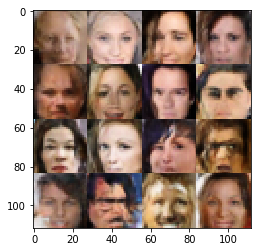

Epoch 20/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.2244... Generator Loss: 1.0820
Epoch 20/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.6710... Generator Loss: 0.3727
Epoch 20/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.2525... Generator Loss: 0.8197
Epoch 20/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8198... Generator Loss: 0.2994
Epoch 20/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.7485... Generator Loss: 0.3582
Epoch 20/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.5285... Generator Loss: 0.4704
Epoch 20/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.4435... Generator Loss: 1.2460
Epoch 20/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.0436... Generator Loss: 0.2799
Epoch 20/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.1787... Generator Loss: 0.7783
Epoch 20/25...progress:82.01%....step:3100/3780... Discriminator

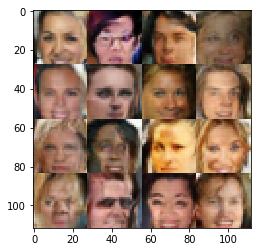

Epoch 20/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.0709... Generator Loss: 0.2855
Epoch 20/25...progress:85.19%....step:3220/3780... Discriminator Loss: 1.4335... Generator Loss: 0.5453
Epoch 20/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.8355... Generator Loss: 0.3071
Epoch 20/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.9158... Generator Loss: 0.3547
Epoch 20/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.2051... Generator Loss: 0.8055
Epoch 20/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.7993... Generator Loss: 0.3379
Epoch 20/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4979... Generator Loss: 0.6509
Epoch 20/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.4725... Generator Loss: 0.5608
Epoch 20/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.1570... Generator Loss: 0.8983
Epoch 20/25...progress:87.30%....step:3300/3780... Discriminator

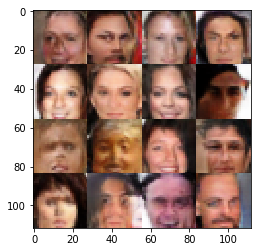

Epoch 20/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.1452... Generator Loss: 0.2364
Epoch 20/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.9509... Generator Loss: 0.3080
Epoch 20/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5994... Generator Loss: 0.3975
Epoch 20/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.2602... Generator Loss: 0.8267
Epoch 20/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.4532... Generator Loss: 0.5124
Epoch 20/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.7739... Generator Loss: 0.3927
Epoch 20/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.4656... Generator Loss: 0.6210
Epoch 20/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.8244... Generator Loss: 0.3315
Epoch 20/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.5901... Generator Loss: 0.4414
Epoch 20/25...progress:92.59%....step:3500/3780... Discriminator

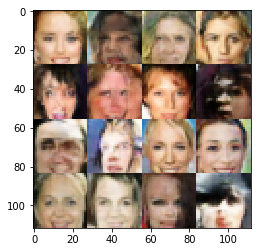

Epoch 20/25...progress:95.50%....step:3610/3780... Discriminator Loss: 2.0335... Generator Loss: 0.2901
Epoch 20/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.9037... Generator Loss: 0.3093
Epoch 20/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.2351... Generator Loss: 0.2094
Epoch 20/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.5616... Generator Loss: 0.4578
Epoch 20/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.5856... Generator Loss: 0.4872
Epoch 20/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.5367... Generator Loss: 0.4621
Epoch 20/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.6098... Generator Loss: 0.5016
Epoch 20/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.4293... Generator Loss: 0.1740
Epoch 20/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.9906... Generator Loss: 0.2854
Epoch 20/25...progress:97.88%....step:3700/3780... Discriminator

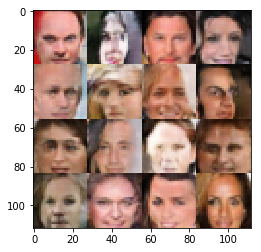

Epoch 21/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.8917... Generator Loss: 0.3006
Epoch 21/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.3436... Generator Loss: 0.6021
Epoch 21/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.9231... Generator Loss: 0.3290
Epoch 21/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.4027... Generator Loss: 0.5117
Epoch 21/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.4754... Generator Loss: 0.9400
Epoch 21/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.7521... Generator Loss: 0.3842
Epoch 21/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.6489... Generator Loss: 0.4872
Epoch 21/25...progress:2.12%....step:80/3780... Discriminator Loss: 0.9832... Generator Loss: 1.2484
Epoch 21/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.7792... Generator Loss: 0.3654
Epoch 21/25...progress:2.65%....step:100/3780... Discriminator Loss: 2.1861... Generator Lo

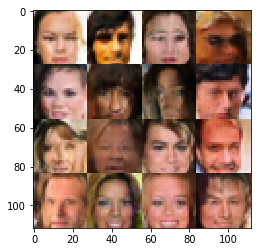

Epoch 21/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.5123... Generator Loss: 0.5992
Epoch 21/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.1828... Generator Loss: 0.6912
Epoch 21/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.4958... Generator Loss: 0.5029
Epoch 21/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.8648... Generator Loss: 0.3414
Epoch 21/25...progress:6.61%....step:250/3780... Discriminator Loss: 0.7771... Generator Loss: 1.3544
Epoch 21/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.2248... Generator Loss: 0.7281
Epoch 21/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.3945... Generator Loss: 0.4984
Epoch 21/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.5116... Generator Loss: 0.4636
Epoch 21/25...progress:7.67%....step:290/3780... Discriminator Loss: 0.9948... Generator Loss: 1.0458
Epoch 21/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.8768... Gen

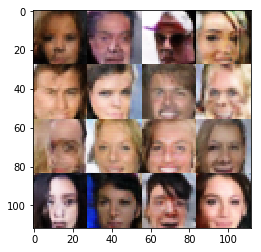

Epoch 21/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.3469... Generator Loss: 0.6420
Epoch 21/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.1024... Generator Loss: 1.2923
Epoch 21/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.8449... Generator Loss: 0.3164
Epoch 21/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.0204... Generator Loss: 1.0736
Epoch 21/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.8166... Generator Loss: 0.3114
Epoch 21/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.1314... Generator Loss: 1.3209
Epoch 21/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.2919... Generator Loss: 0.7609
Epoch 21/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0458... Generator Loss: 0.9072
Epoch 21/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.3349... Generator Loss: 0.1967
Epoch 21/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.0

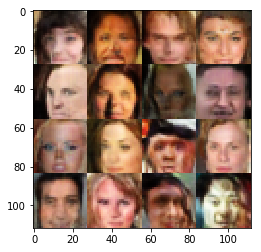

Epoch 21/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.8759... Generator Loss: 0.2898
Epoch 21/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.4380... Generator Loss: 0.2011
Epoch 21/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.5053... Generator Loss: 0.4719
Epoch 21/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.9122... Generator Loss: 0.2961
Epoch 21/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.7382... Generator Loss: 0.1227
Epoch 21/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.6755... Generator Loss: 0.3831
Epoch 21/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.3654... Generator Loss: 0.6324
Epoch 21/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.0870... Generator Loss: 0.2361
Epoch 21/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9416... Generator Loss: 0.3106
Epoch 21/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.4

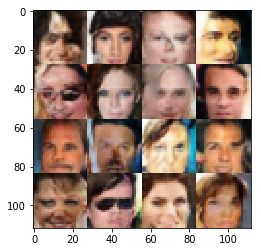

Epoch 21/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5671... Generator Loss: 1.5449
Epoch 21/25...progress:21.69%....step:820/3780... Discriminator Loss: 2.2240... Generator Loss: 0.2028
Epoch 21/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.9994... Generator Loss: 1.0300
Epoch 21/25...progress:22.22%....step:840/3780... Discriminator Loss: 2.1271... Generator Loss: 0.2241
Epoch 21/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.9658... Generator Loss: 0.2908
Epoch 21/25...progress:22.75%....step:860/3780... Discriminator Loss: 2.1586... Generator Loss: 0.2714
Epoch 21/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.0427... Generator Loss: 0.8698
Epoch 21/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.4149... Generator Loss: 0.6054
Epoch 21/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.1040... Generator Loss: 0.3169
Epoch 21/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.8

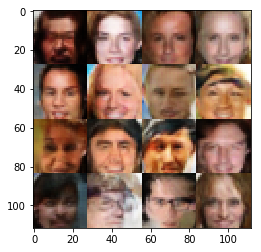

Epoch 21/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.6512... Generator Loss: 0.4262
Epoch 21/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.6878... Generator Loss: 0.4579
Epoch 21/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.4859... Generator Loss: 0.5255
Epoch 21/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.1342... Generator Loss: 1.0287
Epoch 21/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.6476... Generator Loss: 0.3820
Epoch 21/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8934... Generator Loss: 1.1386
Epoch 21/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.0245... Generator Loss: 1.3105
Epoch 21/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.1288... Generator Loss: 0.8625
Epoch 21/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3592... Generator Loss: 0.7313
Epoch 21/25...progress:29.10%....step:1100/3780... Discriminator

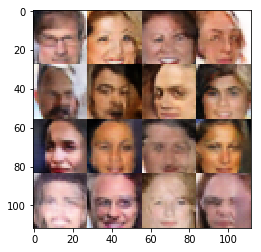

Epoch 21/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.7307... Generator Loss: 0.4028
Epoch 21/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.6879... Generator Loss: 0.4305
Epoch 21/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.8180... Generator Loss: 0.3552
Epoch 21/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.7914... Generator Loss: 0.3585
Epoch 21/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.6529... Generator Loss: 0.5118
Epoch 21/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.1371... Generator Loss: 0.8517
Epoch 21/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.6437... Generator Loss: 0.4277
Epoch 21/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1027... Generator Loss: 0.7992
Epoch 21/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.8347... Generator Loss: 0.3372
Epoch 21/25...progress:34.39%....step:1300/3780... Discriminator

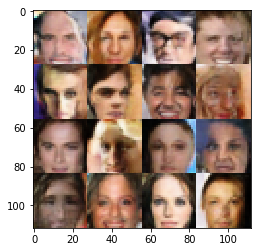

Epoch 21/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.9299... Generator Loss: 0.2717
Epoch 21/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.1853... Generator Loss: 0.6863
Epoch 21/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.6301... Generator Loss: 0.4297
Epoch 21/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.3582... Generator Loss: 0.2089
Epoch 21/25...progress:38.36%....step:1450/3780... Discriminator Loss: 0.9453... Generator Loss: 1.2646
Epoch 21/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.0151... Generator Loss: 0.2526
Epoch 21/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.0601... Generator Loss: 0.8742
Epoch 21/25...progress:39.15%....step:1480/3780... Discriminator Loss: 0.9865... Generator Loss: 1.0096
Epoch 21/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.2621... Generator Loss: 0.6229
Epoch 21/25...progress:39.68%....step:1500/3780... Discriminator

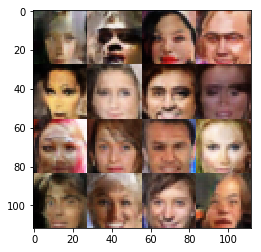

Epoch 21/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.9172... Generator Loss: 0.2816
Epoch 21/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.1409... Generator Loss: 1.1142
Epoch 21/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.3531... Generator Loss: 1.2199
Epoch 21/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.2889... Generator Loss: 0.5537
Epoch 21/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.0845... Generator Loss: 0.8507
Epoch 21/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.7630... Generator Loss: 0.3735
Epoch 21/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.2006... Generator Loss: 0.6948
Epoch 21/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.6830... Generator Loss: 0.3857
Epoch 21/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.2096... Generator Loss: 0.2046
Epoch 21/25...progress:44.97%....step:1700/3780... Discriminator

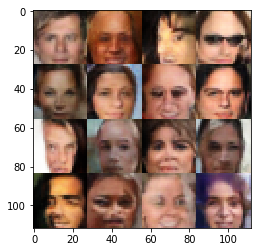

Epoch 21/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.0628... Generator Loss: 0.2461
Epoch 21/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.2029... Generator Loss: 1.0660
Epoch 21/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.2835... Generator Loss: 0.2102
Epoch 21/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5817... Generator Loss: 0.4342
Epoch 21/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.2227... Generator Loss: 0.6991
Epoch 21/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.7977... Generator Loss: 0.3459
Epoch 21/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.7788... Generator Loss: 0.3710
Epoch 21/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.9736... Generator Loss: 0.3657
Epoch 21/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.7687... Generator Loss: 0.3279
Epoch 21/25...progress:50.26%....step:1900/3780... Discriminator

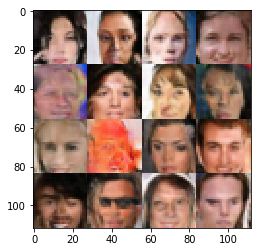

Epoch 21/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.5591... Generator Loss: 0.4836
Epoch 21/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.7107... Generator Loss: 0.4368
Epoch 21/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.3628... Generator Loss: 0.6164
Epoch 21/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.5941... Generator Loss: 0.4394
Epoch 21/25...progress:54.23%....step:2050/3780... Discriminator Loss: 2.1234... Generator Loss: 0.3926
Epoch 21/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.7629... Generator Loss: 0.4761
Epoch 21/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.3926... Generator Loss: 0.6239
Epoch 21/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.5426... Generator Loss: 0.4468
Epoch 21/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.4792... Generator Loss: 0.4797
Epoch 21/25...progress:55.56%....step:2100/3780... Discriminator

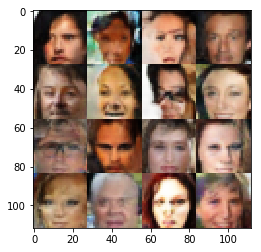

Epoch 21/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.4977... Generator Loss: 0.1692
Epoch 21/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.4142... Generator Loss: 0.5530
Epoch 21/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.4266... Generator Loss: 0.6422
Epoch 21/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.6188... Generator Loss: 0.3963
Epoch 21/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.9095... Generator Loss: 0.2769
Epoch 21/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.4522... Generator Loss: 0.5918
Epoch 21/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9996... Generator Loss: 0.2804
Epoch 21/25...progress:60.32%....step:2280/3780... Discriminator Loss: 2.3003... Generator Loss: 0.1963
Epoch 21/25...progress:60.58%....step:2290/3780... Discriminator Loss: 0.9020... Generator Loss: 1.3434
Epoch 21/25...progress:60.85%....step:2300/3780... Discriminator

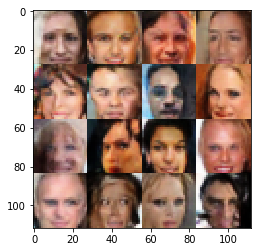

Epoch 21/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.1378... Generator Loss: 0.7899
Epoch 21/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.6166... Generator Loss: 0.4484
Epoch 21/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.1103... Generator Loss: 0.9445
Epoch 21/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.2957... Generator Loss: 1.0173
Epoch 21/25...progress:64.81%....step:2450/3780... Discriminator Loss: 2.5193... Generator Loss: 0.1730
Epoch 21/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.4250... Generator Loss: 0.7001
Epoch 21/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.7579... Generator Loss: 0.3871
Epoch 21/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.1048... Generator Loss: 0.7843
Epoch 21/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9293... Generator Loss: 1.3861
Epoch 21/25...progress:66.14%....step:2500/3780... Discriminator

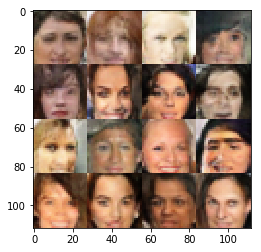

Epoch 21/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.7750... Generator Loss: 0.3721
Epoch 21/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.6672... Generator Loss: 0.3907
Epoch 21/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.6304... Generator Loss: 0.3934
Epoch 21/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.5701... Generator Loss: 0.5285
Epoch 21/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.3954... Generator Loss: 0.8557
Epoch 21/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.9028... Generator Loss: 0.3122
Epoch 21/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.1612... Generator Loss: 0.8718
Epoch 21/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.7879... Generator Loss: 0.3260
Epoch 21/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1972... Generator Loss: 0.7734
Epoch 21/25...progress:71.43%....step:2700/3780... Discriminator

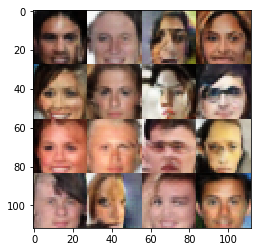

Epoch 21/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.3188... Generator Loss: 0.7416
Epoch 21/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4649... Generator Loss: 0.5226
Epoch 21/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.3319... Generator Loss: 0.6629
Epoch 21/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.5199... Generator Loss: 0.4783
Epoch 21/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.3336... Generator Loss: 0.7936
Epoch 21/25...progress:75.66%....step:2860/3780... Discriminator Loss: 2.7117... Generator Loss: 0.1333
Epoch 21/25...progress:75.93%....step:2870/3780... Discriminator Loss: 2.0851... Generator Loss: 0.2649
Epoch 21/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.7427... Generator Loss: 0.3800
Epoch 21/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.5269... Generator Loss: 0.5486
Epoch 21/25...progress:76.72%....step:2900/3780... Discriminator

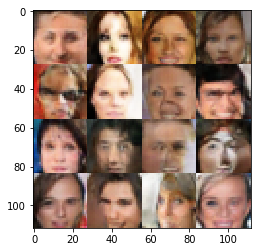

Epoch 21/25...progress:79.63%....step:3010/3780... Discriminator Loss: 0.9526... Generator Loss: 1.0524
Epoch 21/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.4053... Generator Loss: 0.5861
Epoch 21/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.4483... Generator Loss: 0.5023
Epoch 21/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.9046... Generator Loss: 0.2840
Epoch 21/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.7834... Generator Loss: 0.3438
Epoch 21/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.5604... Generator Loss: 0.4197
Epoch 21/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2005... Generator Loss: 0.8907
Epoch 21/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.4172... Generator Loss: 0.1902
Epoch 21/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.2427... Generator Loss: 0.6115
Epoch 21/25...progress:82.01%....step:3100/3780... Discriminator

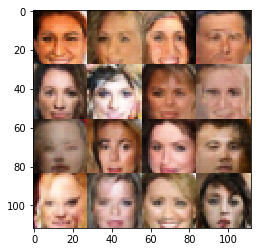

Epoch 21/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.2017... Generator Loss: 0.2297
Epoch 21/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.0290... Generator Loss: 0.2766
Epoch 21/25...progress:85.45%....step:3230/3780... Discriminator Loss: 1.9737... Generator Loss: 0.4189
Epoch 21/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.0097... Generator Loss: 0.2800
Epoch 21/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.3899... Generator Loss: 0.5586
Epoch 21/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.4591... Generator Loss: 0.4900
Epoch 21/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4268... Generator Loss: 0.5437
Epoch 21/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.4518... Generator Loss: 0.5404
Epoch 21/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.1826... Generator Loss: 0.7442
Epoch 21/25...progress:87.30%....step:3300/3780... Discriminator

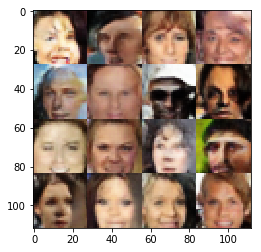

Epoch 21/25...progress:90.21%....step:3410/3780... Discriminator Loss: 2.2812... Generator Loss: 0.1909
Epoch 21/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.8919... Generator Loss: 0.3191
Epoch 21/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.6092... Generator Loss: 0.4510
Epoch 21/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.2972... Generator Loss: 0.8383
Epoch 21/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.9388... Generator Loss: 0.2972
Epoch 21/25...progress:91.53%....step:3460/3780... Discriminator Loss: 2.8972... Generator Loss: 0.1061
Epoch 21/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2985... Generator Loss: 0.7293
Epoch 21/25...progress:92.06%....step:3480/3780... Discriminator Loss: 2.0095... Generator Loss: 0.2617
Epoch 21/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.7998... Generator Loss: 0.3825
Epoch 21/25...progress:92.59%....step:3500/3780... Discriminator

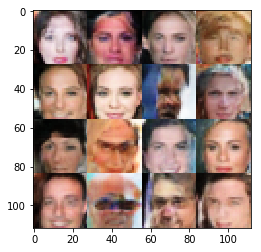

Epoch 21/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.6849... Generator Loss: 0.3973
Epoch 21/25...progress:95.77%....step:3620/3780... Discriminator Loss: 2.4993... Generator Loss: 0.1734
Epoch 21/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.3185... Generator Loss: 0.2027
Epoch 21/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.7167... Generator Loss: 0.3746
Epoch 21/25...progress:96.56%....step:3650/3780... Discriminator Loss: 0.9050... Generator Loss: 1.1527
Epoch 21/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.4829... Generator Loss: 0.4773
Epoch 21/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.6298... Generator Loss: 0.1450
Epoch 21/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.0300... Generator Loss: 0.2585
Epoch 21/25...progress:97.62%....step:3690/3780... Discriminator Loss: 1.5599... Generator Loss: 0.6620
Epoch 21/25...progress:97.88%....step:3700/3780... Discriminator

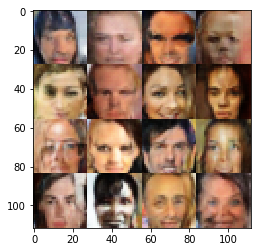

Epoch 22/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.9740... Generator Loss: 0.2811
Epoch 22/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.9492... Generator Loss: 0.3263
Epoch 22/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.7977... Generator Loss: 0.3444
Epoch 22/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.4829... Generator Loss: 0.5999
Epoch 22/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.7647... Generator Loss: 0.3534
Epoch 22/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.1331... Generator Loss: 0.2619
Epoch 22/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.6625... Generator Loss: 0.4282
Epoch 22/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.7742... Generator Loss: 0.3617
Epoch 22/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.6067... Generator Loss: 0.4281
Epoch 22/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.4047... Generator Lo

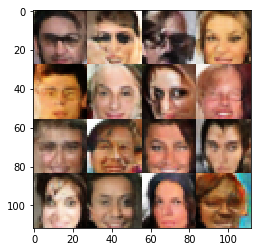

Epoch 22/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.4169... Generator Loss: 0.8160
Epoch 22/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.9544... Generator Loss: 1.0594
Epoch 22/25...progress:6.08%....step:230/3780... Discriminator Loss: 2.0233... Generator Loss: 0.2781
Epoch 22/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.6614... Generator Loss: 0.1628
Epoch 22/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0848... Generator Loss: 0.7734
Epoch 22/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.3017... Generator Loss: 0.7190
Epoch 22/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.6178... Generator Loss: 0.1599
Epoch 22/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7656... Generator Loss: 0.3661
Epoch 22/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.2053... Generator Loss: 0.7856
Epoch 22/25...progress:7.94%....step:300/3780... Discriminator Loss: 1.8809... Gen

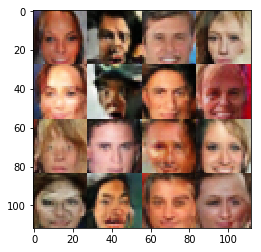

Epoch 22/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.4578... Generator Loss: 0.5830
Epoch 22/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.4230... Generator Loss: 0.5116
Epoch 22/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4351... Generator Loss: 0.5862
Epoch 22/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.0989... Generator Loss: 0.8131
Epoch 22/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.4654... Generator Loss: 0.4634
Epoch 22/25...progress:12.17%....step:460/3780... Discriminator Loss: 2.1246... Generator Loss: 2.3184
Epoch 22/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.1733... Generator Loss: 0.7376
Epoch 22/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.1392... Generator Loss: 0.8726
Epoch 22/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.3047... Generator Loss: 0.2557
Epoch 22/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.9

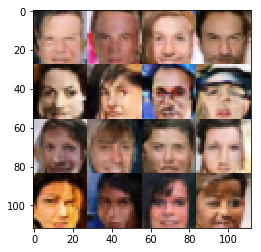

Epoch 22/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.3686... Generator Loss: 0.5957
Epoch 22/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.4735... Generator Loss: 0.2269
Epoch 22/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.5093... Generator Loss: 0.4879
Epoch 22/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.5140... Generator Loss: 0.5141
Epoch 22/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.3544... Generator Loss: 0.1847
Epoch 22/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.6780... Generator Loss: 0.4105
Epoch 22/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.2366... Generator Loss: 0.7310
Epoch 22/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.2214... Generator Loss: 0.2181
Epoch 22/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9898... Generator Loss: 0.2566
Epoch 22/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.1

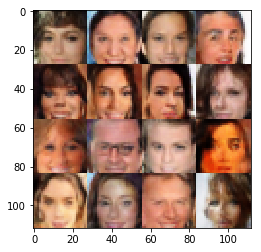

Epoch 22/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.7644... Generator Loss: 0.3278
Epoch 22/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.4375... Generator Loss: 0.6944
Epoch 22/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.0092... Generator Loss: 0.9054
Epoch 22/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.9137... Generator Loss: 0.2982
Epoch 22/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.2425... Generator Loss: 0.6461
Epoch 22/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.7867... Generator Loss: 0.3582
Epoch 22/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.3677... Generator Loss: 0.6484
Epoch 22/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.7605... Generator Loss: 0.3757
Epoch 22/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.3636... Generator Loss: 0.1882
Epoch 22/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.8

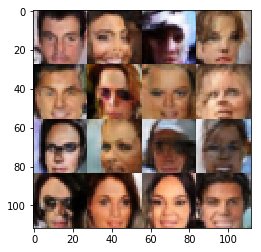

Epoch 22/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.7004... Generator Loss: 0.3580
Epoch 22/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.8563... Generator Loss: 0.3514
Epoch 22/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.3803... Generator Loss: 0.2237
Epoch 22/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.7764... Generator Loss: 0.4625
Epoch 22/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.8152... Generator Loss: 0.3676
Epoch 22/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.4855... Generator Loss: 0.4941
Epoch 22/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.2599... Generator Loss: 0.7631
Epoch 22/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.1620... Generator Loss: 0.7151
Epoch 22/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.4497... Generator Loss: 0.5719
Epoch 22/25...progress:29.10%....step:1100/3780... Discriminator

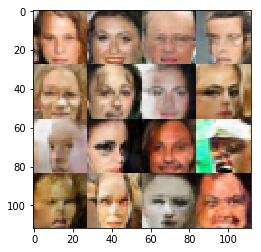

Epoch 22/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.7073... Generator Loss: 0.4112
Epoch 22/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.4874... Generator Loss: 0.5027
Epoch 22/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.1905... Generator Loss: 1.0570
Epoch 22/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.0778... Generator Loss: 0.7986
Epoch 22/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.4040... Generator Loss: 0.6056
Epoch 22/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.5777... Generator Loss: 0.4360
Epoch 22/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.5959... Generator Loss: 0.4279
Epoch 22/25...progress:33.86%....step:1280/3780... Discriminator Loss: 0.9244... Generator Loss: 1.0179
Epoch 22/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.8611... Generator Loss: 0.3337
Epoch 22/25...progress:34.39%....step:1300/3780... Discriminator

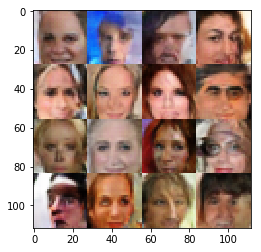

Epoch 22/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.5869... Generator Loss: 0.4881
Epoch 22/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2105... Generator Loss: 0.6808
Epoch 22/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.4944... Generator Loss: 0.5282
Epoch 22/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.0738... Generator Loss: 0.2278
Epoch 22/25...progress:38.36%....step:1450/3780... Discriminator Loss: 0.9892... Generator Loss: 0.9762
Epoch 22/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.6051... Generator Loss: 0.3911
Epoch 22/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1155... Generator Loss: 0.8365
Epoch 22/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.3204... Generator Loss: 0.6599
Epoch 22/25...progress:39.42%....step:1490/3780... Discriminator Loss: 2.0072... Generator Loss: 0.2610
Epoch 22/25...progress:39.68%....step:1500/3780... Discriminator

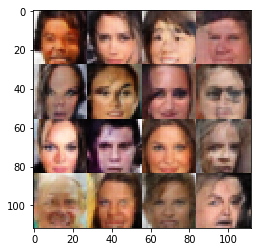

Epoch 22/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.3215... Generator Loss: 1.1204
Epoch 22/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.0664... Generator Loss: 1.0954
Epoch 22/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.1614... Generator Loss: 1.0472
Epoch 22/25...progress:43.39%....step:1640/3780... Discriminator Loss: 0.9305... Generator Loss: 1.0922
Epoch 22/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.6991... Generator Loss: 0.4448
Epoch 22/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.7910... Generator Loss: 0.3640
Epoch 22/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.0564... Generator Loss: 0.9914
Epoch 22/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4717... Generator Loss: 0.5112
Epoch 22/25...progress:44.71%....step:1690/3780... Discriminator Loss: 1.3437... Generator Loss: 0.6514
Epoch 22/25...progress:44.97%....step:1700/3780... Discriminator

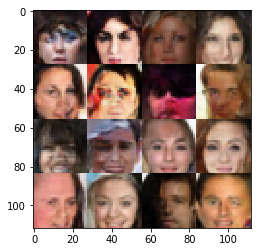

Epoch 22/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.4620... Generator Loss: 0.1977
Epoch 22/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.7039... Generator Loss: 0.3822
Epoch 22/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.1658... Generator Loss: 0.7744
Epoch 22/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.5473... Generator Loss: 0.4951
Epoch 22/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0846... Generator Loss: 0.9167
Epoch 22/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.3134... Generator Loss: 0.2274
Epoch 22/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3425... Generator Loss: 0.7660
Epoch 22/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.4394... Generator Loss: 0.5451
Epoch 22/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6512... Generator Loss: 0.5087
Epoch 22/25...progress:50.26%....step:1900/3780... Discriminator

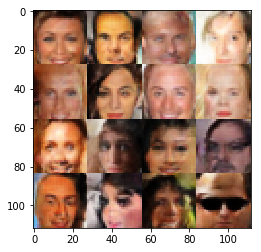

Epoch 22/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.4174... Generator Loss: 0.5666
Epoch 22/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.6723... Generator Loss: 0.4132
Epoch 22/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.2108... Generator Loss: 0.7222
Epoch 22/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.0108... Generator Loss: 0.8875
Epoch 22/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.3616... Generator Loss: 0.6078
Epoch 22/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3818... Generator Loss: 0.6303
Epoch 22/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.1948... Generator Loss: 0.6859
Epoch 22/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.5036... Generator Loss: 0.5172
Epoch 22/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.6265... Generator Loss: 0.8042
Epoch 22/25...progress:55.56%....step:2100/3780... Discriminator

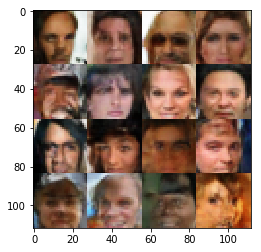

Epoch 22/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.4529... Generator Loss: 0.1928
Epoch 22/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.6221... Generator Loss: 0.3907
Epoch 22/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.2121... Generator Loss: 0.7475
Epoch 22/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.7860... Generator Loss: 0.3752
Epoch 22/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.9780... Generator Loss: 0.2996
Epoch 22/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5318... Generator Loss: 0.9878
Epoch 22/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9866... Generator Loss: 0.2712
Epoch 22/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.3187... Generator Loss: 0.7251
Epoch 22/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.1511... Generator Loss: 0.7834
Epoch 22/25...progress:60.85%....step:2300/3780... Discriminator

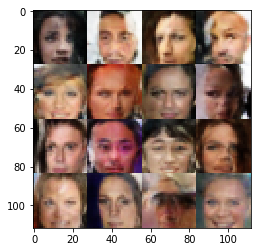

Epoch 22/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.2127... Generator Loss: 0.6692
Epoch 22/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.4534... Generator Loss: 0.5355
Epoch 22/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.3240... Generator Loss: 0.5999
Epoch 22/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.2223... Generator Loss: 1.8435
Epoch 22/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.6245... Generator Loss: 0.4416
Epoch 22/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.1587... Generator Loss: 0.7615
Epoch 22/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.2262... Generator Loss: 0.2199
Epoch 22/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.5017... Generator Loss: 0.5007
Epoch 22/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.1514... Generator Loss: 0.8120
Epoch 22/25...progress:66.14%....step:2500/3780... Discriminator

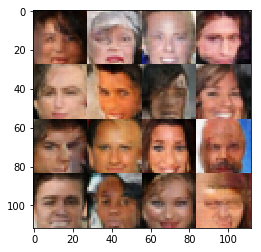

Epoch 22/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9712... Generator Loss: 0.2863
Epoch 22/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.9767... Generator Loss: 0.3145
Epoch 22/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.7572... Generator Loss: 0.3473
Epoch 22/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4333... Generator Loss: 0.9086
Epoch 22/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.7534... Generator Loss: 0.3821
Epoch 22/25...progress:70.37%....step:2660/3780... Discriminator Loss: 1.7912... Generator Loss: 0.4417
Epoch 22/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.3549... Generator Loss: 0.9749
Epoch 22/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.4782... Generator Loss: 0.5013
Epoch 22/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1903... Generator Loss: 0.6862
Epoch 22/25...progress:71.43%....step:2700/3780... Discriminator

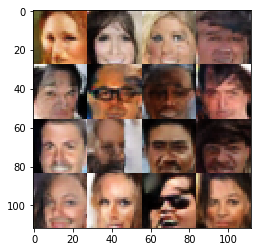

Epoch 22/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.3059... Generator Loss: 0.7016
Epoch 22/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.5459... Generator Loss: 0.4489
Epoch 22/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.5091... Generator Loss: 0.5003
Epoch 22/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.8230... Generator Loss: 0.3183
Epoch 22/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.3266... Generator Loss: 0.5966
Epoch 22/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.5972... Generator Loss: 0.4582
Epoch 22/25...progress:75.93%....step:2870/3780... Discriminator Loss: 2.5322... Generator Loss: 0.1746
Epoch 22/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.6275... Generator Loss: 0.4255
Epoch 22/25...progress:76.46%....step:2890/3780... Discriminator Loss: 1.8622... Generator Loss: 0.3605
Epoch 22/25...progress:76.72%....step:2900/3780... Discriminator

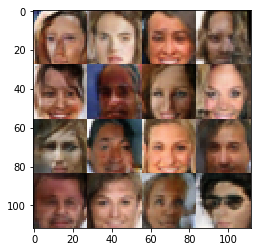

Epoch 22/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.5506... Generator Loss: 0.4369
Epoch 22/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.5925... Generator Loss: 0.4827
Epoch 22/25...progress:80.16%....step:3030/3780... Discriminator Loss: 2.4390... Generator Loss: 0.1753
Epoch 22/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.8956... Generator Loss: 0.3043
Epoch 22/25...progress:80.69%....step:3050/3780... Discriminator Loss: 2.0058... Generator Loss: 0.2716
Epoch 22/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.4805... Generator Loss: 0.7943
Epoch 22/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2317... Generator Loss: 0.7558
Epoch 22/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.2294... Generator Loss: 0.2139
Epoch 22/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.5752... Generator Loss: 0.4599
Epoch 22/25...progress:82.01%....step:3100/3780... Discriminator

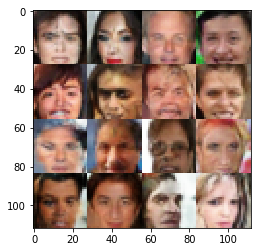

Epoch 22/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.5303... Generator Loss: 0.4487
Epoch 22/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.2688... Generator Loss: 0.2093
Epoch 22/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.8278... Generator Loss: 0.1254
Epoch 22/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.5210... Generator Loss: 0.5027
Epoch 22/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.8198... Generator Loss: 0.3604
Epoch 22/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.7898... Generator Loss: 0.3487
Epoch 22/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4603... Generator Loss: 0.5141
Epoch 22/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.5857... Generator Loss: 0.4249
Epoch 22/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.1721... Generator Loss: 0.7821
Epoch 22/25...progress:87.30%....step:3300/3780... Discriminator

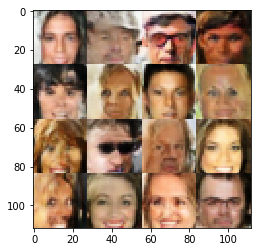

Epoch 22/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.4133... Generator Loss: 0.5382
Epoch 22/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.9097... Generator Loss: 0.3122
Epoch 22/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.9001... Generator Loss: 0.3256
Epoch 22/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.2125... Generator Loss: 0.7315
Epoch 22/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.2288... Generator Loss: 0.2660
Epoch 22/25...progress:91.53%....step:3460/3780... Discriminator Loss: 2.0423... Generator Loss: 0.2534
Epoch 22/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2515... Generator Loss: 0.8698
Epoch 22/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.1518... Generator Loss: 0.8698
Epoch 22/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.7374... Generator Loss: 0.3766
Epoch 22/25...progress:92.59%....step:3500/3780... Discriminator

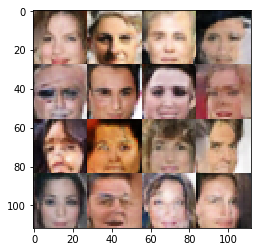

Epoch 22/25...progress:95.50%....step:3610/3780... Discriminator Loss: 2.0929... Generator Loss: 0.2774
Epoch 22/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.9817... Generator Loss: 0.2944
Epoch 22/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.9777... Generator Loss: 0.2679
Epoch 22/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.8405... Generator Loss: 0.3074
Epoch 22/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.1445... Generator Loss: 0.7452
Epoch 22/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.2728... Generator Loss: 0.1863
Epoch 22/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.4333... Generator Loss: 0.1770
Epoch 22/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.3982... Generator Loss: 0.1639
Epoch 22/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.0308... Generator Loss: 0.2690
Epoch 22/25...progress:97.88%....step:3700/3780... Discriminator

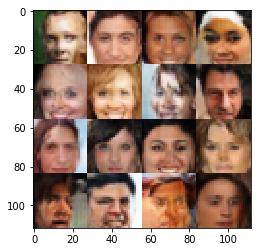

Epoch 23/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.9894... Generator Loss: 0.2927
Epoch 23/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.2133... Generator Loss: 0.7712
Epoch 23/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.3660... Generator Loss: 0.6337
Epoch 23/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.9553... Generator Loss: 0.3044
Epoch 23/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.1874... Generator Loss: 0.7635
Epoch 23/25...progress:1.59%....step:60/3780... Discriminator Loss: 2.1420... Generator Loss: 0.2443
Epoch 23/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.3429... Generator Loss: 0.5763
Epoch 23/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.3324... Generator Loss: 0.5874
Epoch 23/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.1065... Generator Loss: 0.9277
Epoch 23/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.9919... Generator Lo

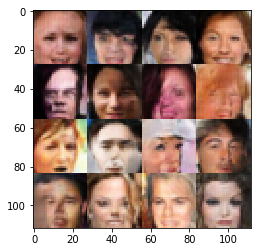

Epoch 23/25...progress:5.56%....step:210/3780... Discriminator Loss: 2.0395... Generator Loss: 0.3037
Epoch 23/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.1020... Generator Loss: 0.8480
Epoch 23/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.5334... Generator Loss: 0.5877
Epoch 23/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.3283... Generator Loss: 0.6141
Epoch 23/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.2625... Generator Loss: 0.7541
Epoch 23/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.2295... Generator Loss: 0.8499
Epoch 23/25...progress:7.14%....step:270/3780... Discriminator Loss: 1.4709... Generator Loss: 0.5432
Epoch 23/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7983... Generator Loss: 0.4547
Epoch 23/25...progress:7.67%....step:290/3780... Discriminator Loss: 2.1514... Generator Loss: 0.2325
Epoch 23/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.0950... Gen

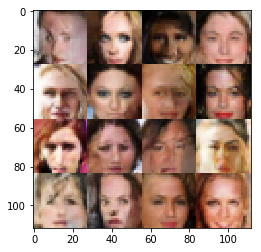

Epoch 23/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.9014... Generator Loss: 0.3196
Epoch 23/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2165... Generator Loss: 0.7856
Epoch 23/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4927... Generator Loss: 1.2161
Epoch 23/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.2963... Generator Loss: 0.7144
Epoch 23/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.4219... Generator Loss: 0.5168
Epoch 23/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.2129... Generator Loss: 1.2175
Epoch 23/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.8212... Generator Loss: 0.4336
Epoch 23/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.1098... Generator Loss: 0.7561
Epoch 23/25...progress:12.96%....step:490/3780... Discriminator Loss: 1.5956... Generator Loss: 0.4787
Epoch 23/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.0

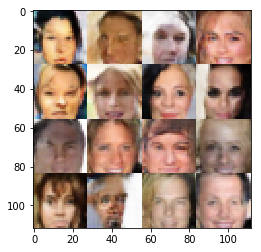

Epoch 23/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.3974... Generator Loss: 0.6518
Epoch 23/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.8959... Generator Loss: 0.3111
Epoch 23/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.3645... Generator Loss: 0.5553
Epoch 23/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.9329... Generator Loss: 0.3012
Epoch 23/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.3976... Generator Loss: 0.1832
Epoch 23/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.3757... Generator Loss: 0.6288
Epoch 23/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.8928... Generator Loss: 0.3147
Epoch 23/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.6931... Generator Loss: 0.1261
Epoch 23/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.9149... Generator Loss: 0.3112
Epoch 23/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.3

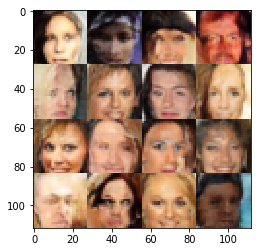

Epoch 23/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.3592... Generator Loss: 1.1658
Epoch 23/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.7407... Generator Loss: 0.3919
Epoch 23/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.9742... Generator Loss: 0.9876
Epoch 23/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.7209... Generator Loss: 0.3652
Epoch 23/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.3376... Generator Loss: 0.6111
Epoch 23/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.8234... Generator Loss: 0.3572
Epoch 23/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.0273... Generator Loss: 0.9988
Epoch 23/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.1946... Generator Loss: 1.0902
Epoch 23/25...progress:23.54%....step:890/3780... Discriminator Loss: 2.1816... Generator Loss: 0.2238
Epoch 23/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

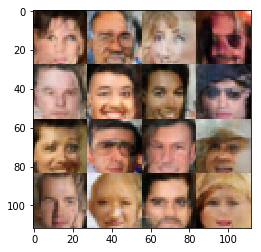

Epoch 23/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.6190... Generator Loss: 0.4605
Epoch 23/25...progress:26.98%....step:1020/3780... Discriminator Loss: 1.7591... Generator Loss: 0.3591
Epoch 23/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.0508... Generator Loss: 0.2712
Epoch 23/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.7746... Generator Loss: 0.3357
Epoch 23/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.2973... Generator Loss: 0.5973
Epoch 23/25...progress:28.04%....step:1060/3780... Discriminator Loss: 1.0737... Generator Loss: 0.9585
Epoch 23/25...progress:28.31%....step:1070/3780... Discriminator Loss: 0.9180... Generator Loss: 1.3317
Epoch 23/25...progress:28.57%....step:1080/3780... Discriminator Loss: 0.8656... Generator Loss: 1.0752
Epoch 23/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.4942... Generator Loss: 0.4952
Epoch 23/25...progress:29.10%....step:1100/3780... Discriminator

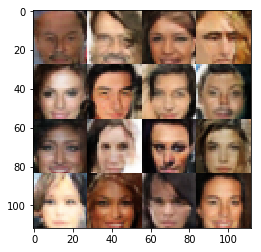

Epoch 23/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.8796... Generator Loss: 0.3021
Epoch 23/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.2710... Generator Loss: 0.6222
Epoch 23/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.5609... Generator Loss: 0.5666
Epoch 23/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.4555... Generator Loss: 0.5534
Epoch 23/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.4820... Generator Loss: 0.5125
Epoch 23/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.7406... Generator Loss: 0.3564
Epoch 23/25...progress:33.60%....step:1270/3780... Discriminator Loss: 2.1791... Generator Loss: 0.2675
Epoch 23/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.1802... Generator Loss: 0.7277
Epoch 23/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.4419... Generator Loss: 0.6890
Epoch 23/25...progress:34.39%....step:1300/3780... Discriminator

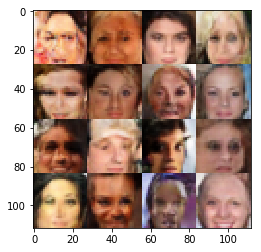

Epoch 23/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.9736... Generator Loss: 0.2804
Epoch 23/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2677... Generator Loss: 0.6265
Epoch 23/25...progress:37.83%....step:1430/3780... Discriminator Loss: 2.3358... Generator Loss: 0.1937
Epoch 23/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.2080... Generator Loss: 0.2126
Epoch 23/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.3135... Generator Loss: 0.6773
Epoch 23/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.4548... Generator Loss: 0.1807
Epoch 23/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1275... Generator Loss: 0.8092
Epoch 23/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.4890... Generator Loss: 0.4546
Epoch 23/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.6325... Generator Loss: 0.3783
Epoch 23/25...progress:39.68%....step:1500/3780... Discriminator

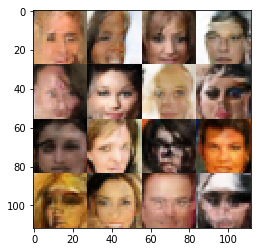

Epoch 23/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.3882... Generator Loss: 0.7095
Epoch 23/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.5217... Generator Loss: 0.5503
Epoch 23/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.2315... Generator Loss: 0.7614
Epoch 23/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.3629... Generator Loss: 0.5910
Epoch 23/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.4177... Generator Loss: 0.6432
Epoch 23/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.9153... Generator Loss: 0.3014
Epoch 23/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.9604... Generator Loss: 1.1266
Epoch 23/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.5219... Generator Loss: 0.4598
Epoch 23/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.0929... Generator Loss: 0.2693
Epoch 23/25...progress:44.97%....step:1700/3780... Discriminator

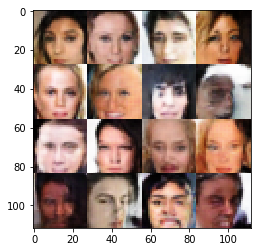

Epoch 23/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.8111... Generator Loss: 0.3511
Epoch 23/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.0554... Generator Loss: 0.2794
Epoch 23/25...progress:48.41%....step:1830/3780... Discriminator Loss: 1.4749... Generator Loss: 0.4984
Epoch 23/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.4556... Generator Loss: 0.4818
Epoch 23/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.8567... Generator Loss: 1.1261
Epoch 23/25...progress:49.21%....step:1860/3780... Discriminator Loss: 1.9763... Generator Loss: 0.3173
Epoch 23/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.9779... Generator Loss: 0.3212
Epoch 23/25...progress:49.74%....step:1880/3780... Discriminator Loss: 2.8862... Generator Loss: 0.1210
Epoch 23/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.4389... Generator Loss: 1.4815
Epoch 23/25...progress:50.26%....step:1900/3780... Discriminator

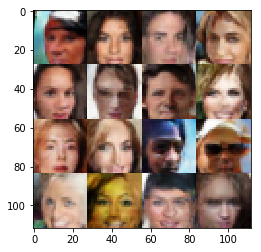

Epoch 23/25...progress:53.17%....step:2010/3780... Discriminator Loss: 0.9926... Generator Loss: 0.9961
Epoch 23/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.2014... Generator Loss: 0.8152
Epoch 23/25...progress:53.70%....step:2030/3780... Discriminator Loss: 2.0356... Generator Loss: 2.5162
Epoch 23/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.3576... Generator Loss: 0.6008
Epoch 23/25...progress:54.23%....step:2050/3780... Discriminator Loss: 2.3317... Generator Loss: 0.2005
Epoch 23/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3857... Generator Loss: 0.6183
Epoch 23/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.4215... Generator Loss: 0.5845
Epoch 23/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.4093... Generator Loss: 0.5921
Epoch 23/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.1675... Generator Loss: 0.7651
Epoch 23/25...progress:55.56%....step:2100/3780... Discriminator

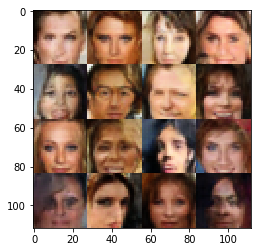

Epoch 23/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.4739... Generator Loss: 0.1760
Epoch 23/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.3745... Generator Loss: 0.5548
Epoch 23/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.2812... Generator Loss: 0.7560
Epoch 23/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.8560... Generator Loss: 0.3359
Epoch 23/25...progress:59.52%....step:2250/3780... Discriminator Loss: 2.1566... Generator Loss: 0.2489
Epoch 23/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.5336... Generator Loss: 0.6047
Epoch 23/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.7561... Generator Loss: 0.3474
Epoch 23/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.1942... Generator Loss: 0.7387
Epoch 23/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4797... Generator Loss: 0.6150
Epoch 23/25...progress:60.85%....step:2300/3780... Discriminator

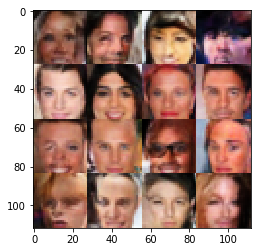

Epoch 23/25...progress:63.76%....step:2410/3780... Discriminator Loss: 0.9376... Generator Loss: 1.0101
Epoch 23/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.5591... Generator Loss: 0.5356
Epoch 23/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.4630... Generator Loss: 0.5348
Epoch 23/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.4097... Generator Loss: 0.6397
Epoch 23/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.0802... Generator Loss: 0.9117
Epoch 23/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.3362... Generator Loss: 0.6017
Epoch 23/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.4410... Generator Loss: 0.1641
Epoch 23/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.2196... Generator Loss: 0.6771
Epoch 23/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.9072... Generator Loss: 2.7636
Epoch 23/25...progress:66.14%....step:2500/3780... Discriminator

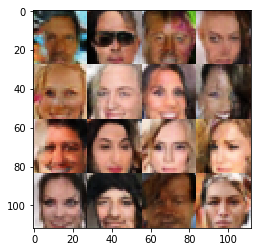

Epoch 23/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9321... Generator Loss: 0.3224
Epoch 23/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.8344... Generator Loss: 0.3798
Epoch 23/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.4987... Generator Loss: 0.1505
Epoch 23/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.7576... Generator Loss: 0.5136
Epoch 23/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.2270... Generator Loss: 0.2268
Epoch 23/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.2033... Generator Loss: 0.2272
Epoch 23/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.3037... Generator Loss: 0.6410
Epoch 23/25...progress:70.90%....step:2680/3780... Discriminator Loss: 2.2136... Generator Loss: 0.2128
Epoch 23/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.0205... Generator Loss: 0.9691
Epoch 23/25...progress:71.43%....step:2700/3780... Discriminator

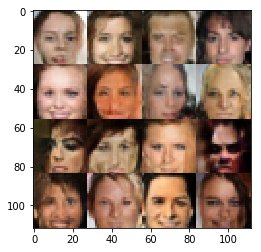

Epoch 23/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.6209... Generator Loss: 0.6334
Epoch 23/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4623... Generator Loss: 0.5217
Epoch 23/25...progress:74.87%....step:2830/3780... Discriminator Loss: 0.8675... Generator Loss: 1.9277
Epoch 23/25...progress:75.13%....step:2840/3780... Discriminator Loss: 2.2804... Generator Loss: 0.2400
Epoch 23/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.9316... Generator Loss: 0.2624
Epoch 23/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.6461... Generator Loss: 0.3967
Epoch 23/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.6415... Generator Loss: 0.4534
Epoch 23/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.3783... Generator Loss: 0.6838
Epoch 23/25...progress:76.46%....step:2890/3780... Discriminator Loss: 2.2421... Generator Loss: 0.2282
Epoch 23/25...progress:76.72%....step:2900/3780... Discriminator

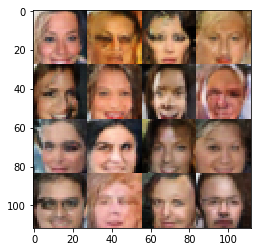

Epoch 23/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.4286... Generator Loss: 1.4534
Epoch 23/25...progress:79.89%....step:3020/3780... Discriminator Loss: 0.9661... Generator Loss: 0.9386
Epoch 23/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.3897... Generator Loss: 0.5640
Epoch 23/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.9222... Generator Loss: 0.3200
Epoch 23/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.1183... Generator Loss: 1.1000
Epoch 23/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.4086... Generator Loss: 0.5357
Epoch 23/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.2937... Generator Loss: 0.6869
Epoch 23/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.5593... Generator Loss: 0.4404
Epoch 23/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3994... Generator Loss: 0.5317
Epoch 23/25...progress:82.01%....step:3100/3780... Discriminator

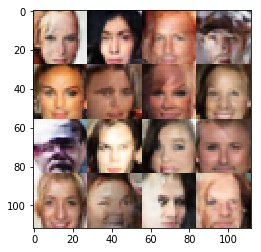

Epoch 23/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.6223... Generator Loss: 0.1473
Epoch 23/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.2337... Generator Loss: 0.2239
Epoch 23/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.4409... Generator Loss: 0.1701
Epoch 23/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.2103... Generator Loss: 0.8490
Epoch 23/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.4494... Generator Loss: 0.5647
Epoch 23/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.2149... Generator Loss: 1.1593
Epoch 23/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.7808... Generator Loss: 0.3288
Epoch 23/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.2745... Generator Loss: 0.6365
Epoch 23/25...progress:87.04%....step:3290/3780... Discriminator Loss: 0.8332... Generator Loss: 1.2474
Epoch 23/25...progress:87.30%....step:3300/3780... Discriminator

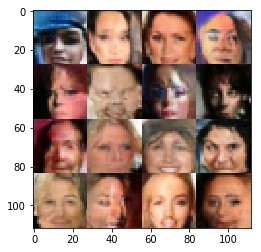

Epoch 23/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.7945... Generator Loss: 0.3422
Epoch 23/25...progress:90.48%....step:3420/3780... Discriminator Loss: 2.0762... Generator Loss: 0.2658
Epoch 23/25...progress:90.74%....step:3430/3780... Discriminator Loss: 2.2809... Generator Loss: 0.2517
Epoch 23/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.8785... Generator Loss: 0.3620
Epoch 23/25...progress:91.27%....step:3450/3780... Discriminator Loss: 2.1465... Generator Loss: 0.2691
Epoch 23/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.7930... Generator Loss: 0.3178
Epoch 23/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2072... Generator Loss: 1.4388
Epoch 23/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.2774... Generator Loss: 0.7049
Epoch 23/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.9936... Generator Loss: 0.2632
Epoch 23/25...progress:92.59%....step:3500/3780... Discriminator

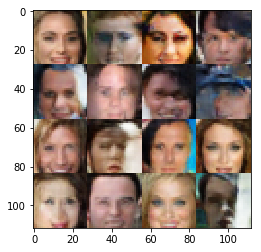

Epoch 23/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.5974... Generator Loss: 0.4298
Epoch 23/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.2147... Generator Loss: 0.6996
Epoch 23/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.0042... Generator Loss: 0.2649
Epoch 23/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.8880... Generator Loss: 0.3383
Epoch 23/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.4712... Generator Loss: 0.5318
Epoch 23/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.0321... Generator Loss: 0.2652
Epoch 23/25...progress:97.09%....step:3670/3780... Discriminator Loss: 2.2482... Generator Loss: 0.2244
Epoch 23/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.2395... Generator Loss: 0.2196
Epoch 23/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.4035... Generator Loss: 0.2060
Epoch 23/25...progress:97.88%....step:3700/3780... Discriminator

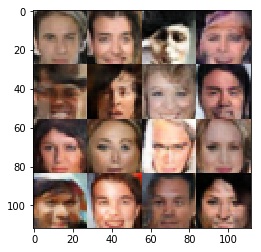

Epoch 24/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.7304... Generator Loss: 0.3596
Epoch 24/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8231... Generator Loss: 0.3614
Epoch 24/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.5258... Generator Loss: 0.4396
Epoch 24/25...progress:1.06%....step:40/3780... Discriminator Loss: 1.8366... Generator Loss: 0.3867
Epoch 24/25...progress:1.32%....step:50/3780... Discriminator Loss: 1.2152... Generator Loss: 0.7136
Epoch 24/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.4376... Generator Loss: 0.5567
Epoch 24/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.8409... Generator Loss: 0.3562
Epoch 24/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.7279... Generator Loss: 0.3705
Epoch 24/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.0664... Generator Loss: 1.0690
Epoch 24/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.3962... Generator Lo

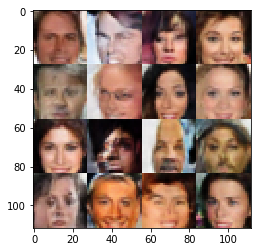

Epoch 24/25...progress:5.56%....step:210/3780... Discriminator Loss: 2.0794... Generator Loss: 0.2609
Epoch 24/25...progress:5.82%....step:220/3780... Discriminator Loss: 0.8968... Generator Loss: 1.5527
Epoch 24/25...progress:6.08%....step:230/3780... Discriminator Loss: 1.7146... Generator Loss: 0.3505
Epoch 24/25...progress:6.35%....step:240/3780... Discriminator Loss: 2.1303... Generator Loss: 0.2578
Epoch 24/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.0599... Generator Loss: 0.9202
Epoch 24/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.4025... Generator Loss: 0.6739
Epoch 24/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.2067... Generator Loss: 0.2439
Epoch 24/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.3074... Generator Loss: 0.6466
Epoch 24/25...progress:7.67%....step:290/3780... Discriminator Loss: 2.2404... Generator Loss: 0.2516
Epoch 24/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.0331... Gen

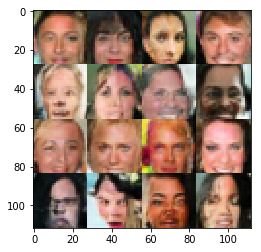

Epoch 24/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.8400... Generator Loss: 0.3721
Epoch 24/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.5131... Generator Loss: 1.7577
Epoch 24/25...progress:11.38%....step:430/3780... Discriminator Loss: 1.4314... Generator Loss: 0.6528
Epoch 24/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.1877... Generator Loss: 1.5473
Epoch 24/25...progress:11.90%....step:450/3780... Discriminator Loss: 2.3007... Generator Loss: 0.1796
Epoch 24/25...progress:12.17%....step:460/3780... Discriminator Loss: 0.9347... Generator Loss: 1.2985
Epoch 24/25...progress:12.43%....step:470/3780... Discriminator Loss: 0.8685... Generator Loss: 1.1149
Epoch 24/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.2970... Generator Loss: 0.6474
Epoch 24/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.5602... Generator Loss: 0.1992
Epoch 24/25...progress:13.23%....step:500/3780... Discriminator Loss: 2.1

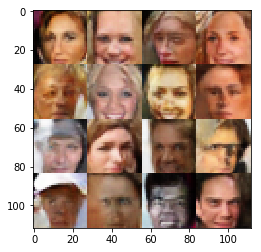

Epoch 24/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.9088... Generator Loss: 0.2963
Epoch 24/25...progress:16.40%....step:620/3780... Discriminator Loss: 2.2537... Generator Loss: 0.2236
Epoch 24/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.0611... Generator Loss: 0.8980
Epoch 24/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.1399... Generator Loss: 0.7068
Epoch 24/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.0316... Generator Loss: 0.3147
Epoch 24/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.8348... Generator Loss: 0.3213
Epoch 24/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.4760... Generator Loss: 0.5029
Epoch 24/25...progress:17.99%....step:680/3780... Discriminator Loss: 1.5923... Generator Loss: 0.5055
Epoch 24/25...progress:18.25%....step:690/3780... Discriminator Loss: 2.0321... Generator Loss: 0.2659
Epoch 24/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.7

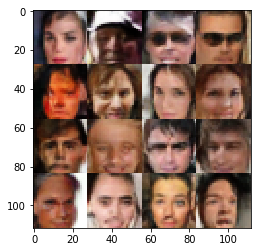

Epoch 24/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.5285... Generator Loss: 0.6419
Epoch 24/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.0759... Generator Loss: 1.0404
Epoch 24/25...progress:21.96%....step:830/3780... Discriminator Loss: 1.2630... Generator Loss: 0.9979
Epoch 24/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.9816... Generator Loss: 0.2671
Epoch 24/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.7768... Generator Loss: 0.3584
Epoch 24/25...progress:22.75%....step:860/3780... Discriminator Loss: 2.2785... Generator Loss: 0.2114
Epoch 24/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.6931... Generator Loss: 0.4940
Epoch 24/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.5392... Generator Loss: 0.7474
Epoch 24/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.7859... Generator Loss: 0.4076
Epoch 24/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.6

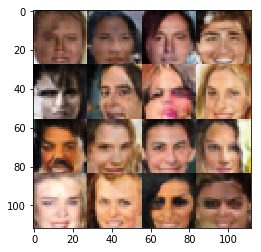

Epoch 24/25...progress:26.72%....step:1010/3780... Discriminator Loss: 2.4543... Generator Loss: 0.1914
Epoch 24/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.2935... Generator Loss: 0.1988
Epoch 24/25...progress:27.25%....step:1030/3780... Discriminator Loss: 2.2970... Generator Loss: 0.2458
Epoch 24/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.5005... Generator Loss: 0.4941
Epoch 24/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.7171... Generator Loss: 0.3503
Epoch 24/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8295... Generator Loss: 1.3362
Epoch 24/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1504... Generator Loss: 1.1899
Epoch 24/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.0294... Generator Loss: 0.8458
Epoch 24/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3147... Generator Loss: 0.6223
Epoch 24/25...progress:29.10%....step:1100/3780... Discriminator

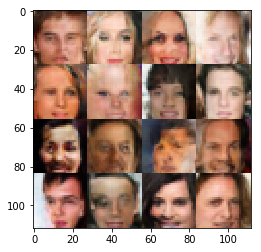

Epoch 24/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.4366... Generator Loss: 0.5004
Epoch 24/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.6203... Generator Loss: 0.4782
Epoch 24/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.7678... Generator Loss: 0.3384
Epoch 24/25...progress:32.80%....step:1240/3780... Discriminator Loss: 1.0965... Generator Loss: 0.8359
Epoch 24/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.2799... Generator Loss: 0.6667
Epoch 24/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.6566... Generator Loss: 0.3930
Epoch 24/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.3491... Generator Loss: 0.6283
Epoch 24/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.2866... Generator Loss: 0.6068
Epoch 24/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.2832... Generator Loss: 0.5714
Epoch 24/25...progress:34.39%....step:1300/3780... Discriminator

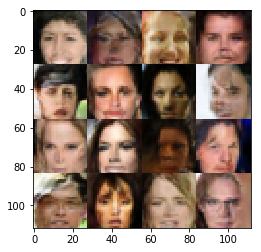

Epoch 24/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.3328... Generator Loss: 0.6332
Epoch 24/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.2335... Generator Loss: 0.6649
Epoch 24/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.5551... Generator Loss: 0.4851
Epoch 24/25...progress:38.10%....step:1440/3780... Discriminator Loss: 1.5072... Generator Loss: 0.4529
Epoch 24/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.3818... Generator Loss: 0.6018
Epoch 24/25...progress:38.62%....step:1460/3780... Discriminator Loss: 1.8527... Generator Loss: 0.3361
Epoch 24/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.1036... Generator Loss: 0.9458
Epoch 24/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.0734... Generator Loss: 1.5072
Epoch 24/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.6087... Generator Loss: 0.4484
Epoch 24/25...progress:39.68%....step:1500/3780... Discriminator

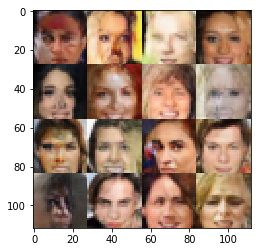

Epoch 24/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.5723... Generator Loss: 1.0627
Epoch 24/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.4113... Generator Loss: 0.5422
Epoch 24/25...progress:43.12%....step:1630/3780... Discriminator Loss: 1.3789... Generator Loss: 0.5673
Epoch 24/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.3301... Generator Loss: 0.6219
Epoch 24/25...progress:43.65%....step:1650/3780... Discriminator Loss: 1.9341... Generator Loss: 0.2750
Epoch 24/25...progress:43.92%....step:1660/3780... Discriminator Loss: 2.2766... Generator Loss: 0.2498
Epoch 24/25...progress:44.18%....step:1670/3780... Discriminator Loss: 1.0137... Generator Loss: 0.9099
Epoch 24/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.4734... Generator Loss: 0.5177
Epoch 24/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.0214... Generator Loss: 0.3022
Epoch 24/25...progress:44.97%....step:1700/3780... Discriminator

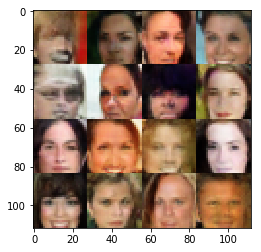

Epoch 24/25...progress:47.88%....step:1810/3780... Discriminator Loss: 1.4404... Generator Loss: 0.6516
Epoch 24/25...progress:48.15%....step:1820/3780... Discriminator Loss: 1.8906... Generator Loss: 0.3072
Epoch 24/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.8635... Generator Loss: 0.1229
Epoch 24/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.6944... Generator Loss: 0.4052
Epoch 24/25...progress:48.94%....step:1850/3780... Discriminator Loss: 0.8129... Generator Loss: 1.2043
Epoch 24/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.0062... Generator Loss: 0.2964
Epoch 24/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.5796... Generator Loss: 0.4327
Epoch 24/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.6689... Generator Loss: 0.4182
Epoch 24/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.6729... Generator Loss: 0.4221
Epoch 24/25...progress:50.26%....step:1900/3780... Discriminator

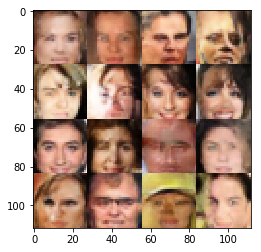

Epoch 24/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.4367... Generator Loss: 0.4805
Epoch 24/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.3329... Generator Loss: 0.6763
Epoch 24/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.5662... Generator Loss: 0.5108
Epoch 24/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.2651... Generator Loss: 0.6419
Epoch 24/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.9214... Generator Loss: 0.3086
Epoch 24/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.3311... Generator Loss: 0.5897
Epoch 24/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.2854... Generator Loss: 0.6600
Epoch 24/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.4017... Generator Loss: 0.5140
Epoch 24/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.7649... Generator Loss: 0.4225
Epoch 24/25...progress:55.56%....step:2100/3780... Discriminator

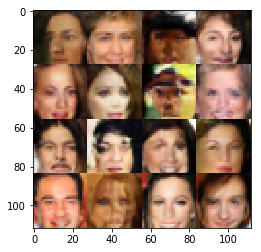

Epoch 24/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.4553... Generator Loss: 0.1768
Epoch 24/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.9770... Generator Loss: 0.2619
Epoch 24/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.4098... Generator Loss: 0.7622
Epoch 24/25...progress:59.26%....step:2240/3780... Discriminator Loss: 1.6921... Generator Loss: 0.4198
Epoch 24/25...progress:59.52%....step:2250/3780... Discriminator Loss: 1.6308... Generator Loss: 0.3878
Epoch 24/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.2735... Generator Loss: 0.9559
Epoch 24/25...progress:60.05%....step:2270/3780... Discriminator Loss: 2.0079... Generator Loss: 0.3020
Epoch 24/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.6384... Generator Loss: 0.4384
Epoch 24/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.4077... Generator Loss: 0.7190
Epoch 24/25...progress:60.85%....step:2300/3780... Discriminator

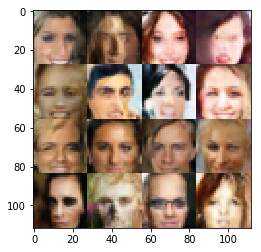

Epoch 24/25...progress:63.76%....step:2410/3780... Discriminator Loss: 1.1506... Generator Loss: 0.7345
Epoch 24/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.6413... Generator Loss: 0.4333
Epoch 24/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.2297... Generator Loss: 0.7681
Epoch 24/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.6170... Generator Loss: 0.5059
Epoch 24/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.5987... Generator Loss: 0.4478
Epoch 24/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.5732... Generator Loss: 0.4469
Epoch 24/25...progress:65.34%....step:2470/3780... Discriminator Loss: 1.0441... Generator Loss: 1.0500
Epoch 24/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.4302... Generator Loss: 0.5305
Epoch 24/25...progress:65.87%....step:2490/3780... Discriminator Loss: 1.0075... Generator Loss: 1.0971
Epoch 24/25...progress:66.14%....step:2500/3780... Discriminator

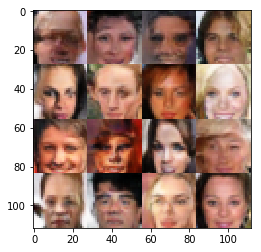

Epoch 24/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.9255... Generator Loss: 0.3373
Epoch 24/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.7559... Generator Loss: 0.3535
Epoch 24/25...progress:69.58%....step:2630/3780... Discriminator Loss: 1.6400... Generator Loss: 0.3803
Epoch 24/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4822... Generator Loss: 0.5760
Epoch 24/25...progress:70.11%....step:2650/3780... Discriminator Loss: 1.9787... Generator Loss: 0.2596
Epoch 24/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.0438... Generator Loss: 0.2470
Epoch 24/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5326... Generator Loss: 0.4572
Epoch 24/25...progress:70.90%....step:2680/3780... Discriminator Loss: 2.0239... Generator Loss: 0.2411
Epoch 24/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.0958... Generator Loss: 0.9141
Epoch 24/25...progress:71.43%....step:2700/3780... Discriminator

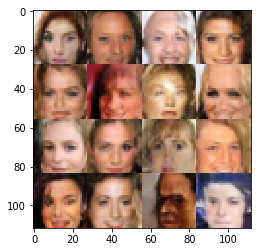

Epoch 24/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.4050... Generator Loss: 0.6354
Epoch 24/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4307... Generator Loss: 0.6138
Epoch 24/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.0400... Generator Loss: 0.9717
Epoch 24/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.1792... Generator Loss: 0.7649
Epoch 24/25...progress:75.40%....step:2850/3780... Discriminator Loss: 1.4662... Generator Loss: 0.5101
Epoch 24/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.6161... Generator Loss: 0.3943
Epoch 24/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.6836... Generator Loss: 0.4045
Epoch 24/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.8561... Generator Loss: 0.3439
Epoch 24/25...progress:76.46%....step:2890/3780... Discriminator Loss: 2.1137... Generator Loss: 0.2463
Epoch 24/25...progress:76.72%....step:2900/3780... Discriminator

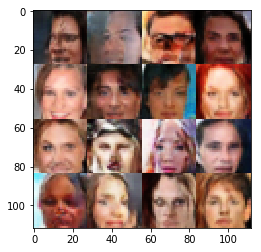

Epoch 24/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.1177... Generator Loss: 0.8310
Epoch 24/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.1918... Generator Loss: 0.7442
Epoch 24/25...progress:80.16%....step:3030/3780... Discriminator Loss: 2.3197... Generator Loss: 0.1935
Epoch 24/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.7794... Generator Loss: 0.4067
Epoch 24/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.9959... Generator Loss: 0.2831
Epoch 24/25...progress:80.95%....step:3060/3780... Discriminator Loss: 1.7112... Generator Loss: 0.3593
Epoch 24/25...progress:81.22%....step:3070/3780... Discriminator Loss: 0.9279... Generator Loss: 2.0017
Epoch 24/25...progress:81.48%....step:3080/3780... Discriminator Loss: 2.2931... Generator Loss: 0.1879
Epoch 24/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.3966... Generator Loss: 0.6954
Epoch 24/25...progress:82.01%....step:3100/3780... Discriminator

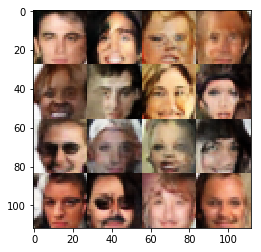

Epoch 24/25...progress:84.92%....step:3210/3780... Discriminator Loss: 1.9965... Generator Loss: 0.3279
Epoch 24/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.5087... Generator Loss: 0.1749
Epoch 24/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.6020... Generator Loss: 0.1749
Epoch 24/25...progress:85.71%....step:3240/3780... Discriminator Loss: 2.2981... Generator Loss: 0.2053
Epoch 24/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.5030... Generator Loss: 0.5104
Epoch 24/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.7554... Generator Loss: 0.3914
Epoch 24/25...progress:86.51%....step:3270/3780... Discriminator Loss: 2.3471... Generator Loss: 0.2027
Epoch 24/25...progress:86.77%....step:3280/3780... Discriminator Loss: 0.9459... Generator Loss: 1.6221
Epoch 24/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.2755... Generator Loss: 0.7803
Epoch 24/25...progress:87.30%....step:3300/3780... Discriminator

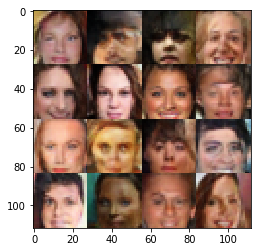

Epoch 24/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.9588... Generator Loss: 0.2992
Epoch 24/25...progress:90.48%....step:3420/3780... Discriminator Loss: 2.3265... Generator Loss: 0.1991
Epoch 24/25...progress:90.74%....step:3430/3780... Discriminator Loss: 1.5118... Generator Loss: 0.4531
Epoch 24/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.9238... Generator Loss: 0.2935
Epoch 24/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.6778... Generator Loss: 0.4087
Epoch 24/25...progress:91.53%....step:3460/3780... Discriminator Loss: 2.4282... Generator Loss: 0.1862
Epoch 24/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.2831... Generator Loss: 0.6385
Epoch 24/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.7396... Generator Loss: 0.3515
Epoch 24/25...progress:92.33%....step:3490/3780... Discriminator Loss: 2.0120... Generator Loss: 0.2518
Epoch 24/25...progress:92.59%....step:3500/3780... Discriminator

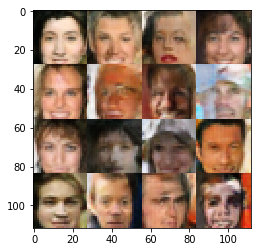

Epoch 24/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.3077... Generator Loss: 0.6872
Epoch 24/25...progress:95.77%....step:3620/3780... Discriminator Loss: 2.1321... Generator Loss: 0.2229
Epoch 24/25...progress:96.03%....step:3630/3780... Discriminator Loss: 2.5813... Generator Loss: 0.1460
Epoch 24/25...progress:96.30%....step:3640/3780... Discriminator Loss: 2.0597... Generator Loss: 0.3090
Epoch 24/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.2528... Generator Loss: 0.6771
Epoch 24/25...progress:96.83%....step:3660/3780... Discriminator Loss: 1.6708... Generator Loss: 0.3866
Epoch 24/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.8755... Generator Loss: 0.3367
Epoch 24/25...progress:97.35%....step:3680/3780... Discriminator Loss: 1.3511... Generator Loss: 0.6046
Epoch 24/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.0358... Generator Loss: 0.3006
Epoch 24/25...progress:97.88%....step:3700/3780... Discriminator

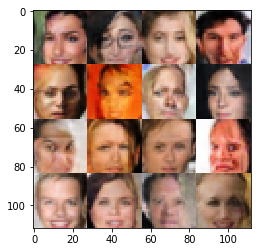

Epoch 25/25...progress:0.26%....step:10/3780... Discriminator Loss: 1.5363... Generator Loss: 0.4686
Epoch 25/25...progress:0.53%....step:20/3780... Discriminator Loss: 1.8925... Generator Loss: 0.3584
Epoch 25/25...progress:0.79%....step:30/3780... Discriminator Loss: 1.6055... Generator Loss: 0.4871
Epoch 25/25...progress:1.06%....step:40/3780... Discriminator Loss: 3.0077... Generator Loss: 0.1043
Epoch 25/25...progress:1.32%....step:50/3780... Discriminator Loss: 2.1492... Generator Loss: 0.2054
Epoch 25/25...progress:1.59%....step:60/3780... Discriminator Loss: 1.8599... Generator Loss: 0.3042
Epoch 25/25...progress:1.85%....step:70/3780... Discriminator Loss: 1.5692... Generator Loss: 0.4660
Epoch 25/25...progress:2.12%....step:80/3780... Discriminator Loss: 1.9438... Generator Loss: 0.2795
Epoch 25/25...progress:2.38%....step:90/3780... Discriminator Loss: 1.5424... Generator Loss: 0.4447
Epoch 25/25...progress:2.65%....step:100/3780... Discriminator Loss: 1.8743... Generator Lo

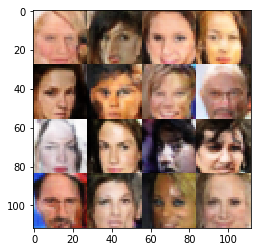

Epoch 25/25...progress:5.56%....step:210/3780... Discriminator Loss: 1.6516... Generator Loss: 0.3851
Epoch 25/25...progress:5.82%....step:220/3780... Discriminator Loss: 1.6879... Generator Loss: 0.3967
Epoch 25/25...progress:6.08%....step:230/3780... Discriminator Loss: 2.2439... Generator Loss: 0.2404
Epoch 25/25...progress:6.35%....step:240/3780... Discriminator Loss: 1.9178... Generator Loss: 0.3024
Epoch 25/25...progress:6.61%....step:250/3780... Discriminator Loss: 1.9145... Generator Loss: 0.3356
Epoch 25/25...progress:6.88%....step:260/3780... Discriminator Loss: 1.1228... Generator Loss: 0.9881
Epoch 25/25...progress:7.14%....step:270/3780... Discriminator Loss: 2.2799... Generator Loss: 0.2008
Epoch 25/25...progress:7.41%....step:280/3780... Discriminator Loss: 1.7878... Generator Loss: 0.3386
Epoch 25/25...progress:7.67%....step:290/3780... Discriminator Loss: 1.3168... Generator Loss: 0.6200
Epoch 25/25...progress:7.94%....step:300/3780... Discriminator Loss: 2.1594... Gen

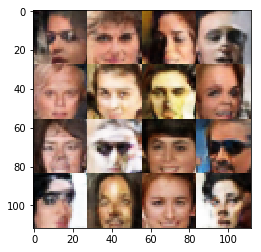

Epoch 25/25...progress:10.85%....step:410/3780... Discriminator Loss: 1.9597... Generator Loss: 0.3481
Epoch 25/25...progress:11.11%....step:420/3780... Discriminator Loss: 1.2016... Generator Loss: 1.3055
Epoch 25/25...progress:11.38%....step:430/3780... Discriminator Loss: 2.4023... Generator Loss: 0.2006
Epoch 25/25...progress:11.64%....step:440/3780... Discriminator Loss: 1.6507... Generator Loss: 0.3796
Epoch 25/25...progress:11.90%....step:450/3780... Discriminator Loss: 1.7931... Generator Loss: 0.3224
Epoch 25/25...progress:12.17%....step:460/3780... Discriminator Loss: 1.1794... Generator Loss: 0.8464
Epoch 25/25...progress:12.43%....step:470/3780... Discriminator Loss: 1.0265... Generator Loss: 0.8835
Epoch 25/25...progress:12.70%....step:480/3780... Discriminator Loss: 1.0739... Generator Loss: 0.9255
Epoch 25/25...progress:12.96%....step:490/3780... Discriminator Loss: 2.6541... Generator Loss: 0.1365
Epoch 25/25...progress:13.23%....step:500/3780... Discriminator Loss: 1.5

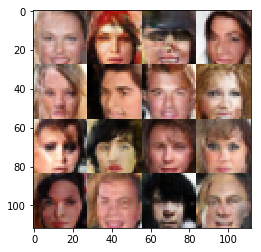

Epoch 25/25...progress:16.14%....step:610/3780... Discriminator Loss: 1.4014... Generator Loss: 0.7441
Epoch 25/25...progress:16.40%....step:620/3780... Discriminator Loss: 1.7951... Generator Loss: 0.3776
Epoch 25/25...progress:16.67%....step:630/3780... Discriminator Loss: 1.4154... Generator Loss: 0.5260
Epoch 25/25...progress:16.93%....step:640/3780... Discriminator Loss: 1.2559... Generator Loss: 0.6150
Epoch 25/25...progress:17.20%....step:650/3780... Discriminator Loss: 2.0730... Generator Loss: 0.3109
Epoch 25/25...progress:17.46%....step:660/3780... Discriminator Loss: 1.6321... Generator Loss: 0.4321
Epoch 25/25...progress:17.72%....step:670/3780... Discriminator Loss: 1.4337... Generator Loss: 0.5352
Epoch 25/25...progress:17.99%....step:680/3780... Discriminator Loss: 2.3523... Generator Loss: 0.1985
Epoch 25/25...progress:18.25%....step:690/3780... Discriminator Loss: 1.3628... Generator Loss: 0.7202
Epoch 25/25...progress:18.52%....step:700/3780... Discriminator Loss: 1.5

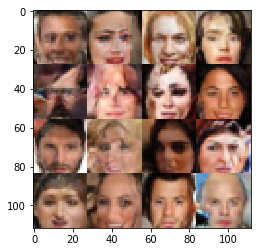

Epoch 25/25...progress:21.43%....step:810/3780... Discriminator Loss: 1.3914... Generator Loss: 0.8669
Epoch 25/25...progress:21.69%....step:820/3780... Discriminator Loss: 1.8384... Generator Loss: 0.3294
Epoch 25/25...progress:21.96%....step:830/3780... Discriminator Loss: 0.8858... Generator Loss: 1.2336
Epoch 25/25...progress:22.22%....step:840/3780... Discriminator Loss: 1.6775... Generator Loss: 0.4121
Epoch 25/25...progress:22.49%....step:850/3780... Discriminator Loss: 1.1903... Generator Loss: 0.6715
Epoch 25/25...progress:22.75%....step:860/3780... Discriminator Loss: 1.9292... Generator Loss: 0.3121
Epoch 25/25...progress:23.02%....step:870/3780... Discriminator Loss: 1.0373... Generator Loss: 0.9187
Epoch 25/25...progress:23.28%....step:880/3780... Discriminator Loss: 1.6973... Generator Loss: 0.3904
Epoch 25/25...progress:23.54%....step:890/3780... Discriminator Loss: 1.8755... Generator Loss: 0.3510
Epoch 25/25...progress:23.81%....step:900/3780... Discriminator Loss: 1.3

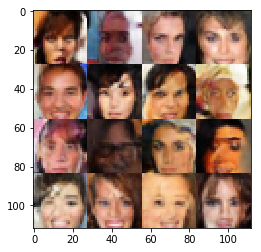

Epoch 25/25...progress:26.72%....step:1010/3780... Discriminator Loss: 1.8943... Generator Loss: 0.2826
Epoch 25/25...progress:26.98%....step:1020/3780... Discriminator Loss: 2.1668... Generator Loss: 0.2233
Epoch 25/25...progress:27.25%....step:1030/3780... Discriminator Loss: 1.2051... Generator Loss: 0.7240
Epoch 25/25...progress:27.51%....step:1040/3780... Discriminator Loss: 1.4061... Generator Loss: 0.6747
Epoch 25/25...progress:27.78%....step:1050/3780... Discriminator Loss: 1.4094... Generator Loss: 0.5296
Epoch 25/25...progress:28.04%....step:1060/3780... Discriminator Loss: 0.8679... Generator Loss: 1.1057
Epoch 25/25...progress:28.31%....step:1070/3780... Discriminator Loss: 1.1330... Generator Loss: 0.8388
Epoch 25/25...progress:28.57%....step:1080/3780... Discriminator Loss: 1.0018... Generator Loss: 1.2420
Epoch 25/25...progress:28.84%....step:1090/3780... Discriminator Loss: 1.3588... Generator Loss: 0.6663
Epoch 25/25...progress:29.10%....step:1100/3780... Discriminator

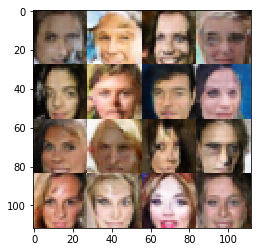

Epoch 25/25...progress:32.01%....step:1210/3780... Discriminator Loss: 1.3206... Generator Loss: 0.6965
Epoch 25/25...progress:32.28%....step:1220/3780... Discriminator Loss: 1.5061... Generator Loss: 0.5240
Epoch 25/25...progress:32.54%....step:1230/3780... Discriminator Loss: 1.6300... Generator Loss: 0.4642
Epoch 25/25...progress:32.80%....step:1240/3780... Discriminator Loss: 2.0043... Generator Loss: 0.2699
Epoch 25/25...progress:33.07%....step:1250/3780... Discriminator Loss: 1.9691... Generator Loss: 0.2822
Epoch 25/25...progress:33.33%....step:1260/3780... Discriminator Loss: 1.5242... Generator Loss: 0.5151
Epoch 25/25...progress:33.60%....step:1270/3780... Discriminator Loss: 1.0863... Generator Loss: 0.8069
Epoch 25/25...progress:33.86%....step:1280/3780... Discriminator Loss: 1.3819... Generator Loss: 0.6667
Epoch 25/25...progress:34.13%....step:1290/3780... Discriminator Loss: 1.3732... Generator Loss: 0.7362
Epoch 25/25...progress:34.39%....step:1300/3780... Discriminator

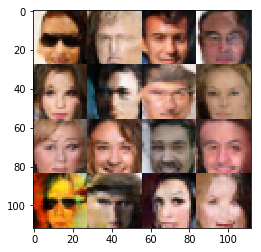

Epoch 25/25...progress:37.30%....step:1410/3780... Discriminator Loss: 1.4282... Generator Loss: 0.5673
Epoch 25/25...progress:37.57%....step:1420/3780... Discriminator Loss: 1.0571... Generator Loss: 1.0047
Epoch 25/25...progress:37.83%....step:1430/3780... Discriminator Loss: 1.4938... Generator Loss: 0.5003
Epoch 25/25...progress:38.10%....step:1440/3780... Discriminator Loss: 2.1023... Generator Loss: 0.3216
Epoch 25/25...progress:38.36%....step:1450/3780... Discriminator Loss: 1.1003... Generator Loss: 0.8760
Epoch 25/25...progress:38.62%....step:1460/3780... Discriminator Loss: 2.2192... Generator Loss: 0.2092
Epoch 25/25...progress:38.89%....step:1470/3780... Discriminator Loss: 1.2596... Generator Loss: 0.6238
Epoch 25/25...progress:39.15%....step:1480/3780... Discriminator Loss: 1.6344... Generator Loss: 0.4329
Epoch 25/25...progress:39.42%....step:1490/3780... Discriminator Loss: 1.4302... Generator Loss: 0.5194
Epoch 25/25...progress:39.68%....step:1500/3780... Discriminator

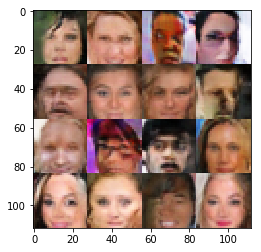

Epoch 25/25...progress:42.59%....step:1610/3780... Discriminator Loss: 1.1329... Generator Loss: 0.7565
Epoch 25/25...progress:42.86%....step:1620/3780... Discriminator Loss: 1.2991... Generator Loss: 0.6205
Epoch 25/25...progress:43.12%....step:1630/3780... Discriminator Loss: 0.9954... Generator Loss: 0.9928
Epoch 25/25...progress:43.39%....step:1640/3780... Discriminator Loss: 1.0464... Generator Loss: 0.9511
Epoch 25/25...progress:43.65%....step:1650/3780... Discriminator Loss: 2.0827... Generator Loss: 0.2896
Epoch 25/25...progress:43.92%....step:1660/3780... Discriminator Loss: 1.5380... Generator Loss: 0.4857
Epoch 25/25...progress:44.18%....step:1670/3780... Discriminator Loss: 0.8956... Generator Loss: 1.0735
Epoch 25/25...progress:44.44%....step:1680/3780... Discriminator Loss: 1.5991... Generator Loss: 0.4411
Epoch 25/25...progress:44.71%....step:1690/3780... Discriminator Loss: 2.4779... Generator Loss: 0.1687
Epoch 25/25...progress:44.97%....step:1700/3780... Discriminator

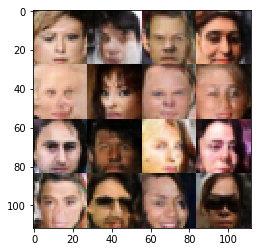

Epoch 25/25...progress:47.88%....step:1810/3780... Discriminator Loss: 2.6396... Generator Loss: 0.1578
Epoch 25/25...progress:48.15%....step:1820/3780... Discriminator Loss: 2.5384... Generator Loss: 0.1549
Epoch 25/25...progress:48.41%....step:1830/3780... Discriminator Loss: 2.3577... Generator Loss: 0.2048
Epoch 25/25...progress:48.68%....step:1840/3780... Discriminator Loss: 1.8071... Generator Loss: 0.3522
Epoch 25/25...progress:48.94%....step:1850/3780... Discriminator Loss: 1.0365... Generator Loss: 1.0068
Epoch 25/25...progress:49.21%....step:1860/3780... Discriminator Loss: 2.3126... Generator Loss: 0.2047
Epoch 25/25...progress:49.47%....step:1870/3780... Discriminator Loss: 1.3072... Generator Loss: 0.6510
Epoch 25/25...progress:49.74%....step:1880/3780... Discriminator Loss: 1.8716... Generator Loss: 0.3317
Epoch 25/25...progress:50.00%....step:1890/3780... Discriminator Loss: 1.7642... Generator Loss: 0.3352
Epoch 25/25...progress:50.26%....step:1900/3780... Discriminator

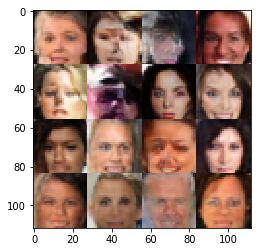

Epoch 25/25...progress:53.17%....step:2010/3780... Discriminator Loss: 1.5134... Generator Loss: 0.5155
Epoch 25/25...progress:53.44%....step:2020/3780... Discriminator Loss: 1.5556... Generator Loss: 0.4638
Epoch 25/25...progress:53.70%....step:2030/3780... Discriminator Loss: 1.4465... Generator Loss: 0.9605
Epoch 25/25...progress:53.97%....step:2040/3780... Discriminator Loss: 1.4055... Generator Loss: 0.6011
Epoch 25/25...progress:54.23%....step:2050/3780... Discriminator Loss: 1.5108... Generator Loss: 0.4676
Epoch 25/25...progress:54.50%....step:2060/3780... Discriminator Loss: 1.2294... Generator Loss: 0.7654
Epoch 25/25...progress:54.76%....step:2070/3780... Discriminator Loss: 1.1605... Generator Loss: 0.8175
Epoch 25/25...progress:55.03%....step:2080/3780... Discriminator Loss: 1.2686... Generator Loss: 0.6650
Epoch 25/25...progress:55.29%....step:2090/3780... Discriminator Loss: 1.4322... Generator Loss: 0.5163
Epoch 25/25...progress:55.56%....step:2100/3780... Discriminator

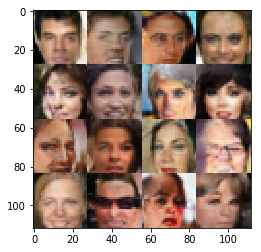

Epoch 25/25...progress:58.47%....step:2210/3780... Discriminator Loss: 2.2450... Generator Loss: 0.2021
Epoch 25/25...progress:58.73%....step:2220/3780... Discriminator Loss: 1.5118... Generator Loss: 0.4584
Epoch 25/25...progress:58.99%....step:2230/3780... Discriminator Loss: 1.5591... Generator Loss: 0.5350
Epoch 25/25...progress:59.26%....step:2240/3780... Discriminator Loss: 2.0679... Generator Loss: 0.2662
Epoch 25/25...progress:59.52%....step:2250/3780... Discriminator Loss: 2.2591... Generator Loss: 0.2266
Epoch 25/25...progress:59.79%....step:2260/3780... Discriminator Loss: 1.3168... Generator Loss: 1.0322
Epoch 25/25...progress:60.05%....step:2270/3780... Discriminator Loss: 1.9633... Generator Loss: 0.2968
Epoch 25/25...progress:60.32%....step:2280/3780... Discriminator Loss: 1.0300... Generator Loss: 1.0723
Epoch 25/25...progress:60.58%....step:2290/3780... Discriminator Loss: 1.0340... Generator Loss: 1.1134
Epoch 25/25...progress:60.85%....step:2300/3780... Discriminator

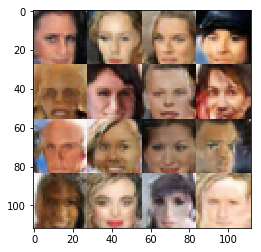

Epoch 25/25...progress:63.76%....step:2410/3780... Discriminator Loss: 2.1993... Generator Loss: 0.2995
Epoch 25/25...progress:64.02%....step:2420/3780... Discriminator Loss: 1.8215... Generator Loss: 0.3869
Epoch 25/25...progress:64.29%....step:2430/3780... Discriminator Loss: 1.2463... Generator Loss: 1.0011
Epoch 25/25...progress:64.55%....step:2440/3780... Discriminator Loss: 1.1516... Generator Loss: 1.0129
Epoch 25/25...progress:64.81%....step:2450/3780... Discriminator Loss: 1.3501... Generator Loss: 0.5904
Epoch 25/25...progress:65.08%....step:2460/3780... Discriminator Loss: 1.4478... Generator Loss: 0.5273
Epoch 25/25...progress:65.34%....step:2470/3780... Discriminator Loss: 2.1220... Generator Loss: 0.2111
Epoch 25/25...progress:65.61%....step:2480/3780... Discriminator Loss: 1.4115... Generator Loss: 0.4815
Epoch 25/25...progress:65.87%....step:2490/3780... Discriminator Loss: 0.8201... Generator Loss: 1.2042
Epoch 25/25...progress:66.14%....step:2500/3780... Discriminator

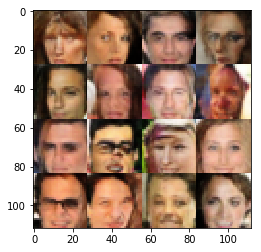

Epoch 25/25...progress:69.05%....step:2610/3780... Discriminator Loss: 1.7319... Generator Loss: 0.3713
Epoch 25/25...progress:69.31%....step:2620/3780... Discriminator Loss: 1.6440... Generator Loss: 0.4054
Epoch 25/25...progress:69.58%....step:2630/3780... Discriminator Loss: 2.3421... Generator Loss: 0.2060
Epoch 25/25...progress:69.84%....step:2640/3780... Discriminator Loss: 1.4712... Generator Loss: 0.5151
Epoch 25/25...progress:70.11%....step:2650/3780... Discriminator Loss: 2.1518... Generator Loss: 0.2274
Epoch 25/25...progress:70.37%....step:2660/3780... Discriminator Loss: 2.3170... Generator Loss: 0.2111
Epoch 25/25...progress:70.63%....step:2670/3780... Discriminator Loss: 1.5451... Generator Loss: 0.5625
Epoch 25/25...progress:70.90%....step:2680/3780... Discriminator Loss: 1.7327... Generator Loss: 0.3363
Epoch 25/25...progress:71.16%....step:2690/3780... Discriminator Loss: 1.1733... Generator Loss: 0.7217
Epoch 25/25...progress:71.43%....step:2700/3780... Discriminator

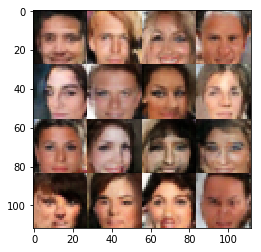

Epoch 25/25...progress:74.34%....step:2810/3780... Discriminator Loss: 1.9066... Generator Loss: 0.2818
Epoch 25/25...progress:74.60%....step:2820/3780... Discriminator Loss: 1.4594... Generator Loss: 0.5342
Epoch 25/25...progress:74.87%....step:2830/3780... Discriminator Loss: 1.0434... Generator Loss: 0.9510
Epoch 25/25...progress:75.13%....step:2840/3780... Discriminator Loss: 1.5269... Generator Loss: 0.4721
Epoch 25/25...progress:75.40%....step:2850/3780... Discriminator Loss: 2.0236... Generator Loss: 0.2779
Epoch 25/25...progress:75.66%....step:2860/3780... Discriminator Loss: 1.5216... Generator Loss: 0.4632
Epoch 25/25...progress:75.93%....step:2870/3780... Discriminator Loss: 1.7506... Generator Loss: 0.3420
Epoch 25/25...progress:76.19%....step:2880/3780... Discriminator Loss: 1.7915... Generator Loss: 0.3602
Epoch 25/25...progress:76.46%....step:2890/3780... Discriminator Loss: 0.9917... Generator Loss: 1.2679
Epoch 25/25...progress:76.72%....step:2900/3780... Discriminator

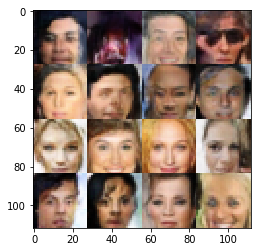

Epoch 25/25...progress:79.63%....step:3010/3780... Discriminator Loss: 1.4324... Generator Loss: 0.5850
Epoch 25/25...progress:79.89%....step:3020/3780... Discriminator Loss: 1.5953... Generator Loss: 0.5641
Epoch 25/25...progress:80.16%....step:3030/3780... Discriminator Loss: 1.8318... Generator Loss: 0.3261
Epoch 25/25...progress:80.42%....step:3040/3780... Discriminator Loss: 1.6510... Generator Loss: 0.4117
Epoch 25/25...progress:80.69%....step:3050/3780... Discriminator Loss: 1.8175... Generator Loss: 0.2926
Epoch 25/25...progress:80.95%....step:3060/3780... Discriminator Loss: 2.1172... Generator Loss: 0.2791
Epoch 25/25...progress:81.22%....step:3070/3780... Discriminator Loss: 1.1796... Generator Loss: 0.8110
Epoch 25/25...progress:81.48%....step:3080/3780... Discriminator Loss: 1.5436... Generator Loss: 0.4595
Epoch 25/25...progress:81.75%....step:3090/3780... Discriminator Loss: 1.8985... Generator Loss: 0.2975
Epoch 25/25...progress:82.01%....step:3100/3780... Discriminator

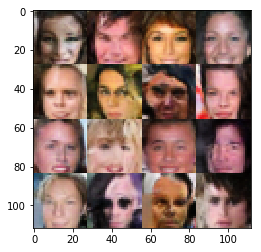

Epoch 25/25...progress:84.92%....step:3210/3780... Discriminator Loss: 2.4731... Generator Loss: 0.1875
Epoch 25/25...progress:85.19%....step:3220/3780... Discriminator Loss: 2.3371... Generator Loss: 0.1896
Epoch 25/25...progress:85.45%....step:3230/3780... Discriminator Loss: 2.8188... Generator Loss: 0.1267
Epoch 25/25...progress:85.71%....step:3240/3780... Discriminator Loss: 1.3711... Generator Loss: 0.6061
Epoch 25/25...progress:85.98%....step:3250/3780... Discriminator Loss: 1.8035... Generator Loss: 0.3665
Epoch 25/25...progress:86.24%....step:3260/3780... Discriminator Loss: 1.4644... Generator Loss: 0.6612
Epoch 25/25...progress:86.51%....step:3270/3780... Discriminator Loss: 1.4822... Generator Loss: 0.5044
Epoch 25/25...progress:86.77%....step:3280/3780... Discriminator Loss: 1.8700... Generator Loss: 0.3007
Epoch 25/25...progress:87.04%....step:3290/3780... Discriminator Loss: 1.2729... Generator Loss: 0.8149
Epoch 25/25...progress:87.30%....step:3300/3780... Discriminator

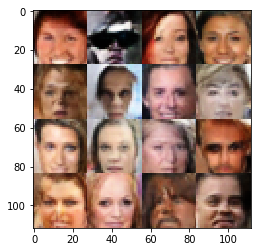

Epoch 25/25...progress:90.21%....step:3410/3780... Discriminator Loss: 1.3144... Generator Loss: 0.7309
Epoch 25/25...progress:90.48%....step:3420/3780... Discriminator Loss: 1.8321... Generator Loss: 0.3572
Epoch 25/25...progress:90.74%....step:3430/3780... Discriminator Loss: 2.3387... Generator Loss: 0.2530
Epoch 25/25...progress:91.01%....step:3440/3780... Discriminator Loss: 1.6179... Generator Loss: 0.4333
Epoch 25/25...progress:91.27%....step:3450/3780... Discriminator Loss: 1.8437... Generator Loss: 0.3191
Epoch 25/25...progress:91.53%....step:3460/3780... Discriminator Loss: 1.9084... Generator Loss: 0.2938
Epoch 25/25...progress:91.80%....step:3470/3780... Discriminator Loss: 1.8108... Generator Loss: 0.4123
Epoch 25/25...progress:92.06%....step:3480/3780... Discriminator Loss: 1.9755... Generator Loss: 0.3074
Epoch 25/25...progress:92.33%....step:3490/3780... Discriminator Loss: 1.5296... Generator Loss: 0.4800
Epoch 25/25...progress:92.59%....step:3500/3780... Discriminator

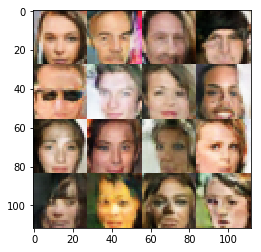

Epoch 25/25...progress:95.50%....step:3610/3780... Discriminator Loss: 1.3969... Generator Loss: 0.6592
Epoch 25/25...progress:95.77%....step:3620/3780... Discriminator Loss: 1.8144... Generator Loss: 0.3649
Epoch 25/25...progress:96.03%....step:3630/3780... Discriminator Loss: 1.9273... Generator Loss: 0.2968
Epoch 25/25...progress:96.30%....step:3640/3780... Discriminator Loss: 1.9340... Generator Loss: 0.3170
Epoch 25/25...progress:96.56%....step:3650/3780... Discriminator Loss: 1.0681... Generator Loss: 0.8697
Epoch 25/25...progress:96.83%....step:3660/3780... Discriminator Loss: 2.6305... Generator Loss: 0.1380
Epoch 25/25...progress:97.09%....step:3670/3780... Discriminator Loss: 1.7588... Generator Loss: 0.3425
Epoch 25/25...progress:97.35%....step:3680/3780... Discriminator Loss: 2.0837... Generator Loss: 0.2451
Epoch 25/25...progress:97.62%....step:3690/3780... Discriminator Loss: 2.0131... Generator Loss: 0.2778
Epoch 25/25...progress:97.88%....step:3700/3780... Discriminator

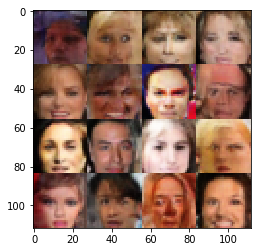

Last train discriminator Loss: 1.6514
Last train generator Loss: 0.4205


In [13]:
batch_size = 32 #64
z_dim = 200
learning_rate = 0.0005
beta1 = 0.1
#epochs = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.

In [14]:
print("Done!")

Done!
